In [1]:
%config InlineBackend.figure_format = "retina"

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

# Загрузка данных
## Сенсоры

In [5]:
import os
from datetime import datetime

DIR_PATH = "../Probe_Data/"

Data = pd.read_csv(os.path.join(DIR_PATH, "SensorsData_FebMarMay.csv"), index_col=0)
Data.index = np.array(
    ([datetime.strptime(d, '%Y-%m-%d %H:%M:%S') for d in Data.index]),
    dtype='datetime64[ns]')

stops_data = pd.read_csv(os.path.join(DIR_PATH, "Jan_to_Jun_StopLogs.csv"))
stops_data['start_datetime'] = stops_data.start_datetime.astype('datetime64[ns]')
stops_data['end_datetime'] = stops_data.end_datetime.astype('datetime64[ns]')

In [6]:
from sklearn.impute import SimpleImputer

Data.dropna(how='all', inplace=True)
imputer = SimpleImputer()
Data = pd.DataFrame(imputer.fit_transform(Data), index=Data.index, columns=Data.columns)

## Таргет

In [7]:
# Берем таргет из журнальных данных

Data['target'] = 0
Data['target_dscr'] = "Норма"

for start, end, dscr in stops_data[np.invert(stops_data.description.isin([
        "Технологические плановые : Межплавочный период",
        ]))]\
        [['start_datetime', 'end_datetime', 'description']].values:
    
    Data['target'][(Data.index >= start) & (Data.index <= end)] = 1
    Data['target_dscr'][(Data.index >= start) & (Data.index <= end)] = dscr

In [8]:
# Добавляем таргет по минимумам вибрации

Data["target"][(Data["Вибрация заднего подшипника двигателя (осевая)"] < 15.0)
             & (Data["Вибрация заднего подшипника двигателя (радиальная)"] < 15.0)] = 1

In [9]:

from copy import deepcopy

def SetShiftTarget(Data, delta):
    """
    Сдвигает изначальный таргет на delta шагов назад
    Шаг дискретизации по времени : 5 минут
    """
    Data["shift_target"] = deepcopy(Data.target.shift(-delta, fill_value=0).values)
    Data["shift_target"] = Data.shift_target.astype(int)
    return Data

# Смещаем на 240 шагов (здесь минут) = 4 часа

Data = SetShiftTarget(Data, 240)

In [10]:
# Уберем моменты останововок из обучаюшей выборки

Data_without_Stops = Data[Data.target != 1].copy()

In [11]:
X = Data_without_Stops.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y = Data_without_Stops['shift_target']

X_to_vis = Data.drop(['target', 'target_dscr', 'shift_target'], axis=1)
y_to_vis = Data['shift_target']

# Предобработка
## Генерация фичей
### Попарные корреляции

In [12]:
WINDOW_SIZE = 240

corr_X = X.rolling(window = WINDOW_SIZE).corr()

In [13]:
from itertools import product, combinations
from tqdm.notebook import tqdm

Sensors_Combs = list(combinations(X.columns, r=2))
CorrFeatures = pd.DataFrame()

for sens_1, sens_2 in tqdm(Sensors_Combs):

    # Выбираем из датафрейма, корреляцию за все время пары датчиков `sens_1` и `sens_2`
    corr_series = corr_X[sens_1].loc[:, sens_2]

    # Так как использовалась оконная функция в начале есть пропуски
    # Заполним их случайными величинами из диапазона [MIN, MAX] для данного ряда
    MAX, MIN = corr_series.max(), corr_series.min()
    fill_values = np.random.sample(size=WINDOW_SIZE) * (MAX - MIN) + MIN
    corr_series[:WINDOW_SIZE] = fill_values

    # Все такие новые колонки с попарными корреляциями датчиков
    # Будут начинаться с `Corr_`
    corr_series.name = '_'.join(['Corr', sens_1, sens_2])

    CorrFeatures = pd.concat([CorrFeatures, corr_series], axis=1)

### TDA

In [14]:
from ripser import Rips
from persim import PersImage

In [15]:
from tqdm.notebook import tqdm


def get_point_cloud(timeseries, window_size=120, window_step=4):
    PC = np.array([
        timeseries[i:i + window_size].to_list()
        for i in range(0,
                       len(timeseries) - window_size, window_step)
    ])
    return PC


def get_TDA_features(timeseries, window_size=240):

    TopologicalFeatures = []
    err_cnt = 0
    print(timeseries.name)
    for i in tqdm(range(0,
                        len(timeseries) - window_size),
                  total=len(timeseries) - window_size):

        PointCloud = get_point_cloud(timeseries=timeseries[i:i + window_size],
                                     window_size=36)

        rips = Rips(maxdim=1, coeff=2, verbose=False)
        T_Data = rips.fit_transform(PointCloud)[-1]

        try:
            Mean_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).mean()
            Std_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).std()
            Max_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).max()
            Min_LifeTime = (T_Data[:, 1] - T_Data[:, 0]).min()
        except:
            err_cnt += 1
            Mean_LifeTime, Std_LifeTime, Max_LifeTime, Min_LifeTime = np.nan, np.nan, np.nan, np.nan

        TopologicalFeatures.append(
            [Mean_LifeTime, Std_LifeTime, Max_LifeTime, Min_LifeTime])
    print(f"Errors : {err_cnt}")

    TopologicalFeatures = np.array(TopologicalFeatures)
    TopologicalFeatures = np.pad(TopologicalFeatures,
                                 pad_width=((window_size, 0), (0, 0)))

    return TopologicalFeatures

In [16]:
# from concurrent.futures import ProcessPoolExecutor

# Sensors_TS = [X[SensName] for SensName in Data.columns[:-3]]

# with ProcessPoolExecutor(max_workers=6) as executor:
#     TopologicalFeatures = list(executor.map(get_TDA_features, Sensors_TS))

In [14]:
# from itertools import product
# feature_columns = ["LT_mean", "LT_std", "LT_max", "LT_min"]
# TDA_Columns = [
#     f"{feature}_{SensName}"
#     for feature, SensName in product(feature_columns, Data.columns[:-3])
# ]

# TDA_Features = pd.DataFrame(np.concatenate(TopologicalFeatures, axis=1),
#                             columns=TDA_Columns,
#                             index=X.index)

#================================================================================#
#                             ЗАГРУЗКА ГОТОВЫХ                                   #
#================================================================================#

TDA_Features = pd.read_csv(os.path.join(DIR_PATH, "Jan_to_Jun_TDA_Features_Params_120_240.csv"), index_col=0)
TDA_Features.index = TDA_Features.index.astype("datetime64[ns]")

## Объединение признаков

In [15]:
# Есть ли пропуски
print(X.isna().sum(axis=0).sum())
print(CorrFeatures.isna().sum(axis=0).sum())
print(TDA_Features.isna().sum(axis=0).sum())

0
0
0


In [16]:
X = pd.concat([X, CorrFeatures, TDA_Features], axis=1)

In [17]:
print(X.isna().sum(axis=0).sum())

0


## Стандартизация

In [17]:
from sklearn.preprocessing import StandardScaler

ss = StandardScaler()
X = pd.DataFrame(ss.fit_transform(X),
                 index = X.index,
                 columns = X.columns)

# Модель

In [28]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.model_selection import cross_validate, train_test_split, GridSearchCV
from sklearn.metrics import jaccard_similarity_score as IoU
from sklearn.metrics import classification_report, roc_auc_score, f1_score, precision_recall_curve

In [62]:
import sklearn
print(*sorted(sklearn.metrics.SCORERS.keys()), sep='\n')

accuracy
adjusted_mutual_info_score
adjusted_rand_score
average_precision
balanced_accuracy
completeness_score
explained_variance
f1
f1_macro
f1_micro
f1_samples
f1_weighted
fowlkes_mallows_score
homogeneity_score
jaccard
jaccard_macro
jaccard_micro
jaccard_samples
jaccard_weighted
max_error
mutual_info_score
neg_brier_score
neg_log_loss
neg_mean_absolute_error
neg_mean_gamma_deviance
neg_mean_poisson_deviance
neg_mean_squared_error
neg_mean_squared_log_error
neg_median_absolute_error
neg_root_mean_squared_error
normalized_mutual_info_score
precision
precision_macro
precision_micro
precision_samples
precision_weighted
r2
recall
recall_macro
recall_micro
recall_samples
recall_weighted
roc_auc
roc_auc_ovo
roc_auc_ovo_weighted
roc_auc_ovr
roc_auc_ovr_weighted
v_measure_score


In [19]:
Val_X, Exam_X = X.loc[:"2020-03-30"], X.loc["2020-05":]
Val_y, Exam_y = y.loc[:"2020-03-30"], y.loc["2020-05":]

In [20]:
from sklearn.preprocessing import StandardScaler

ss = StandardScaler()
Val_X = pd.DataFrame(ss.fit_transform(Val_X),
                 index = Val_X.index,
                 columns = Val_X.columns)

Exam_X = pd.DataFrame(ss.fit_transform(Exam_X),
                      index = Exam_X.index,
                      columns = Exam_X.columns)

## SVM

In [79]:
from sklearn.svm import SVC, OneClassSVM, NuSVC

In [122]:
clf = SVC(C = 0.01,
          probability=True,
          random_state=21,
          gamma='auto')

In [123]:
clf.fit(Val_X, Val_y)

SVC(C=0.01, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='auto', kernel='rbf',
    max_iter=-1, probability=True, random_state=21, shrinking=True, tol=0.001,
    verbose=False)

In [124]:
Val_Preds = clf.predict_proba(Val_X)

In [125]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

sens_name_1 = Val_X.columns[12]
sens_name_2 = Val_X.columns[13]

Sens_1 = Val_X[sens_name_1].values
Sens_2 = Val_X[sens_name_2].values

Shifted_Target = Val_y.values

fig = go.Figure()
# fig.add_trace(go.Scatter(x=Val_X.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Shifted_Target, name="Target"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Val_Preds[:,1], name="Val Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)

In [134]:
precs, recs, thrs = precision_recall_curve(Val_y, Val_Preds[:,1])

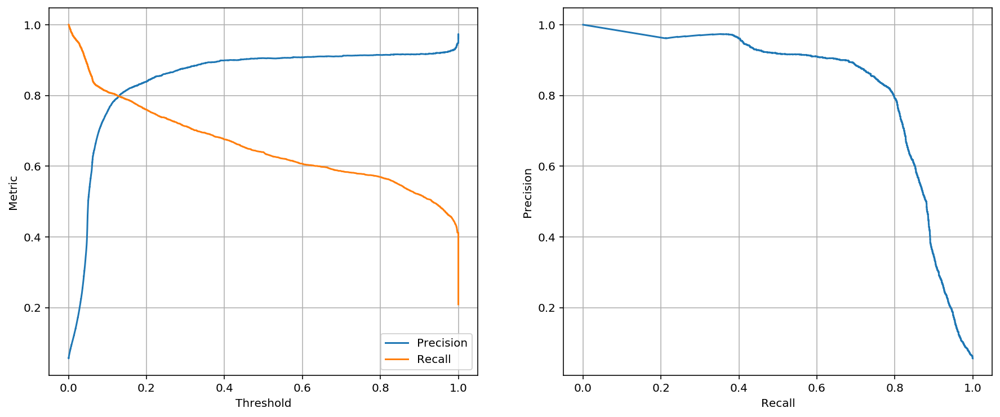

In [135]:
fig, axes = plt.subplots(1,2, figsize=(15,6))

axes[0].plot(thrs, precs[:-1], label='Precision')
axes[0].plot(thrs, recs[:-1], label="Recall")
axes[0].set(xlabel="Threshold", ylabel="Metric")
axes[0].legend()
axes[0].grid()

axes[1].plot(recs, precs)
axes[1].set(xlabel="Recall", ylabel="Precision")
axes[1].grid()

In [128]:
Exam_Preds = clf.predict_proba(Exam_X)

In [129]:
sens_name_1 = Exam_X.columns[12]
sens_name_2 = Exam_X.columns[13]

Sens_1 = Exam_X[sens_name_1].values
Sens_2 = Exam_X[sens_name_2].values

Shifted_Target = Exam_y.values

fig = go.Figure()
# fig.add_trace(go.Scatter(x=Exam_X.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Exam_X.index, y=Shifted_Target, name="Target"))
fig.add_trace(go.Scatter(x=Exam_X.index, y=Exam_Preds[:,1], name="Exam Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)

In [136]:
precs, recs, thrs = precision_recall_curve(Exam_y, Exam_Preds[:,1])

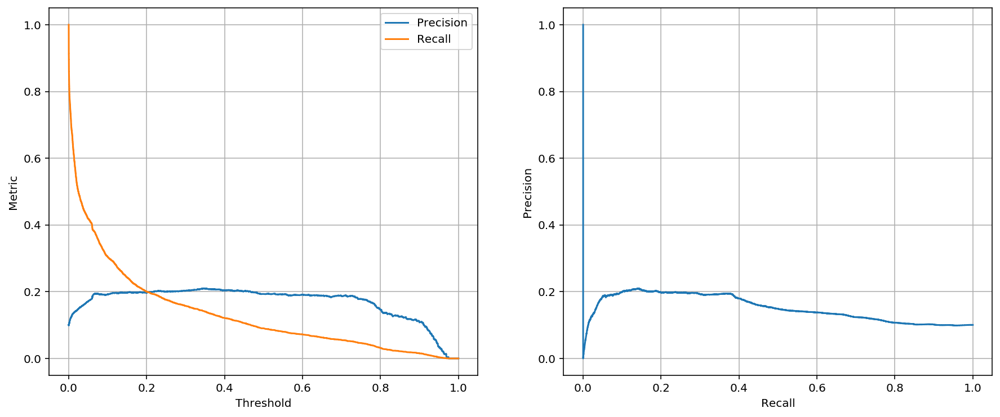

In [137]:
fig, axes = plt.subplots(1,2, figsize=(15,6))

axes[0].plot(thrs, precs[:-1], label='Precision')
axes[0].plot(thrs, recs[:-1], label="Recall")
axes[0].set(xlabel="Threshold", ylabel="Metric")
axes[0].legend()
axes[0].grid()

axes[1].plot(recs, precs)
axes[1].set(xlabel="Recall", ylabel="Precision")
axes[1].grid()

---

In [91]:
from ipywidgets import interact, interact_manual

@interact
def plot(SensName_1 = Val_X.columns,
         SensName_2 = Val_X.columns):
    sens0, sens1 = Val_X[SensName_1].values[2000:3000], Val_X[SensName_2].values[2000:3000]

    min0, max0, min1, max1 = sens0.min(), sens0.max(), sens1.min(), sens1.max()

    x0, x1 = np.meshgrid(np.linspace(min0, max0, 100), np.linspace(min1, max1, 100))
    x = np.array([x0, x1]).reshape(2, -1).T


    plt.figure(figsize=(14,12))
    plt.scatter(sens0, sens1, s=40, c=Val_y.values[2000:3000], marker="x")
    # plt.contourf(x0, x1, model.predict_proba(x)[:, 1].reshape(100, 100), np.linspace(0, 1, 5), alpha=0.2)

    plt.colorbar()
    # plt.xlim(-4, 4)
    # plt.ylim(-4, 4)
    plt.gca().set_aspect("equal", adjustable="box")

interactive(children=(Dropdown(description='SensName_1', options=('Температура обмотки статора А (датчик №1)',…

## RVM

In [100]:
from sklearn_rvm import EMRVC

In [107]:
clf = EMRVC(verbose=1)

In [108]:
clf.fit(Val_X[:5000:5], Val_y[:5000:5])

Iteration: 0
Alpha: [2.91242378e-03 9.43798415e+00 4.12107420e-02 ... 5.81064055e-01
 2.39862167e+00 1.57369352e+00]
Beta: 1e-06
Gamma: [0.96644521 0.2350965  0.04072545 ... 0.50034109 0.55293535 0.80030104]
m: [-18.21638009   0.15782778  -0.99409478 ...   0.92794253   0.48012719
   0.71312656]
Relevance Vectors: 1000

Iteration: 1
Alpha: [2.77282467e-03 8.68008210e+01 8.13220845e-03 3.21484019e-01
 4.72948475e+00 1.71086365e+01 1.00901938e+03 4.58944379e-01
 6.99985967e-01 4.46472215e+00 1.15815051e-02 3.39635918e-01
 4.73893503e-01 3.94771386e-02 2.42818079e-02 2.56877406e+01
 1.44983753e+00 4.62349312e-01 9.68535885e-01 5.24414350e+01
 1.73376027e+00 5.85178012e-01 1.72539582e-01 1.27063887e+00
 2.50975960e+02 3.63757548e+04 1.48964070e-02 5.76583924e-02
 1.40044884e-02 3.78940555e-01 2.48901496e-01 4.91420337e-03
 3.35273444e+03 1.11252991e-02 3.32572133e-01 9.14967158e-01
 9.23130984e+00 1.01432405e+01 3.21242254e-01 3.15039247e-01
 9.29155265e-02 1.44736972e-02 1.15732022e-02 5.6

Iteration: 2
Alpha: [2.67280193e-03 2.99534140e+02 6.13704297e-03 1.80459590e+00
 2.46396205e+01 1.03300723e+02 7.29322893e+03 4.08993059e+00
 4.56518169e+00 1.16704180e+02 4.79152479e-03 4.83647237e-01
 3.80919443e+00 1.13865972e-01 2.23594688e-02 2.33443010e+04
 5.20306451e+06 2.93507964e+00 2.87046885e+01 7.05156700e+03
 8.85143518e+01 1.24271340e+00 2.80577372e-01 7.27742560e+00
 2.28994521e+03 6.44549078e+05 1.26075601e-02 9.01806242e-02
 1.24719544e-02 2.65646291e+00 1.47636114e+00 1.97070001e-03
 7.81730637e+03 1.03747095e-02 2.24642799e+00 2.65054463e+00
 1.09777291e+01 1.43999467e+02 2.69025829e+00 1.87960441e+00
 1.81574636e-01 1.79632499e-02 6.35860615e-03 2.10456655e+00
 9.06581161e-01 3.04870008e-01 4.82412820e+01 2.39680004e+00
 2.19295097e+00 9.17514067e-01 4.57032549e+03 1.62371953e+02
 1.19587433e+04 2.43309179e+02 3.77642776e+00 3.11210823e-01
 2.08837469e-01 1.50247902e-01 3.28188944e-02 2.13641566e-02
 8.92456597e-02 4.45860479e-01 2.21844834e-01 1.13196605e-02
 1.2

Iteration: 3
Alpha: [2.65449971e-03 6.16341674e+03 5.55481614e-03 2.04697587e+01
 1.40468246e+02 2.50284300e+02 2.14685330e+04 2.42484645e+02
 1.86504494e+02 2.10950224e+04 2.75028140e-03 5.06294675e-01
 1.03107537e+02 8.23965614e-01 2.89224729e-02 1.19165327e+07
 7.89236728e+08 4.75923426e+01 2.19410773e+04 3.66291129e+04
 3.74784042e+04 1.69699651e+00 7.51473528e-01 3.39773872e+01
 8.08860332e+06 1.05466561e+08 1.64230195e-02 2.64703461e-01
 1.52424589e-02 5.89033620e+01 3.99403096e+01 1.65354561e-03
 1.92741448e+04 1.33142997e-02 1.09823733e+02 4.93100972e+00
 1.27969364e+01 1.08640580e+03 8.09342535e+01 2.24961275e+01
 7.26376996e-01 3.46751697e-02 4.05476337e-03 2.00394327e+01
 1.48857343e+01 2.90119286e-01 1.70325269e+02 1.20601067e+01
 9.03289760e+00 1.16312164e+02 1.33658121e+05 1.03456261e+03
 1.29248718e+05 2.02123464e+03 1.22515894e+01 6.59419189e-01
 7.51544094e-01 2.21548501e-01 3.59919950e-02 3.03359049e-02
 2.54606288e-01 8.26726253e-01 4.34514790e-01 1.54070356e-02
 1.8

Iteration: 4
Alpha: [2.69419734e-03 5.81872595e+02 6.46823980e-03 1.53560176e+01
 4.18967975e+03 2.18031911e+03 1.63729249e+01 3.41369144e+04
 3.24828522e+01 8.55968143e+02 4.99594596e-03 5.25372332e-01
 1.03206431e+03 9.66295969e+04 2.81733478e-02 5.95701002e+07
 4.69231763e+01 5.78926007e+01 5.04742667e+03 1.01945604e+02
 2.83507523e+00 3.21649200e+00 3.34191038e+01 6.71462509e+05
 1.41579251e-02 2.33523325e-01 1.36762966e-02 3.61839471e+01
 1.80338657e+01 2.15791999e-03 5.06272892e+03 1.16531216e-02
 7.33410387e+01 1.49775527e+01 1.19610539e+02 3.52738551e+03
 6.21965962e+01 7.96331490e+00 5.42176574e+00 2.22557392e-02
 6.89215132e-03 1.17799256e+01 5.05697000e+01 3.14217399e-01
 1.91747842e+03 1.03757901e+02 3.38198594e+03 2.74711837e+01
 1.70060456e+04 1.09049979e+03 1.70989978e+05 3.92415888e+02
 9.61926612e+01 8.43283112e-01 2.49027947e+00 1.91875740e-01
 3.65497494e-02 2.95813444e-02 2.24126158e-01 1.03725715e+00
 4.49255234e-01 1.73801740e-02 1.86518140e-02 5.57468575e-03
 1.0

Iteration: 5
Alpha: [2.69969692e-03 2.33854076e+06 5.95572143e-03 5.03777901e+01
 4.81635848e+02 2.20653674e+04 1.29156956e+02 2.51444895e+06
 8.99490137e+02 1.44375484e+07 3.02083143e-03 4.85748693e-01
 9.30347610e+03 5.64225220e+04 3.14383547e-02 2.66952412e+02
 1.50884577e+04 9.86315799e+04 3.35653337e+04 4.17227418e+00
 2.91246827e+01 5.30144058e+02 1.56813765e+06 1.74316410e-02
 3.40390540e-01 1.62897626e-02 1.90374935e+02 2.72549297e+02
 1.77266626e-03 1.98202666e+04 1.44550581e-02 3.70908214e+03
 6.36654484e+01 4.40936944e+02 5.03764697e+03 2.57661441e+03
 7.21187698e+01 7.52729569e+01 3.70836362e-02 4.42712647e-03
 1.20855215e+02 5.40293625e+02 3.11739191e-01 1.92361232e+03
 1.90307687e+02 1.13432751e+03 1.52605876e+04 2.49050965e+03
 2.10106587e+03 4.11515219e+05 5.31959005e+02 1.37968476e+02
 8.54662255e-01 9.40803443e+00 2.26602602e-01 3.75325877e-02
 3.19885298e-02 2.99657444e-01 1.05015279e+00 4.82088794e-01
 1.67200796e-02 2.04335971e-02 4.78791710e-03 1.00112077e-02
 1.2

Iteration: 6
Alpha: [2.70288881e-03 3.67731643e+05 6.34339603e-03 1.07582471e+02
 1.93918965e+04 3.85084740e+04 4.33022893e+01 3.42854681e+06
 1.08627743e+03 1.62856943e+07 4.86824240e-03 5.29077261e-01
 3.71862084e+04 3.30666298e+06 2.82086986e-02 4.03928627e+03
 8.01094218e+02 4.47937160e+08 6.70672208e+03 3.30794394e+00
 2.19654408e+01 1.38595848e+02 3.67927349e+08 1.40331515e-02
 2.37663116e-01 1.35227526e-02 4.12746926e+02 1.69494498e+05
 2.12744252e-03 4.43193672e+04 1.14513590e-02 1.60735752e+03
 5.36540050e+01 4.14667091e+02 6.46643409e+03 3.95785404e+07
 4.04654891e+01 5.32675183e+01 2.20792558e-02 6.74398948e-03
 4.13163679e+01 2.51690593e+02 3.17041465e-01 3.42052904e+03
 2.62897270e+02 2.64958781e+03 6.38906701e+02 8.51085760e+03
 2.56314855e+03 4.48808257e+05 7.76000007e+02 1.22332320e+02
 8.75320125e-01 5.69383069e+00 1.97039234e-01 3.72482264e-02
 3.06270762e-02 2.36291292e-01 1.05529637e+00 4.61709859e-01
 1.79253104e-02 1.92663641e-02 5.28218643e-03 1.00185887e-02
 1.1

Iteration: 7
Alpha: [2.70105520e-03 3.16945515e+05 6.07377022e-03 5.19046743e+01
 1.32845816e+03 9.80252731e+03 1.29998659e+02 9.54612022e+05
 1.14742803e+03 5.69681603e+08 3.09840493e-03 4.84906485e-01
 1.53315818e+04 6.93539050e+05 3.16475135e-02 7.95882221e+02
 8.95552292e+03 4.33569390e+05 4.15813593e+00 2.96430432e+01
 5.36967086e+02 1.76462456e-02 3.44022592e-01 1.65141909e-02
 2.10391776e+02 2.86794118e+04 1.80563847e-03 8.96615839e+04
 1.47383381e-02 5.78132975e+03 6.46173652e+01 4.56947888e+02
 1.23857916e+04 7.35255815e+01 7.78627536e+01 3.76458744e-02
 4.52890106e-03 1.23862057e+02 5.73878505e+02 3.12344766e-01
 3.06954562e+03 1.97270402e+02 1.73069407e+03 2.22048318e+04
 1.47282918e+04 2.61348363e+03 2.16319074e+07 5.67262619e+02
 1.36462088e+02 8.43691471e-01 9.29476660e+00 2.23276374e-01
 3.71099607e-02 3.16517361e-02 2.96203523e-01 1.04118263e+00
 4.73854259e-01 1.66725446e-02 2.03121970e-02 4.91787873e-03
 1.00138914e-02 1.22739491e-02 3.21916921e-02 1.19342889e-02
 3.1

Iteration: 8
Alpha: [2.78471908e-03 2.56658506e+08 6.45405578e-03 7.17782868e+02
 1.51228641e+02 2.74299703e+04 3.52208975e+02 1.54416372e+06
 2.48119400e+02 4.69458931e-03 3.10781998e-01 7.49305367e+02
 2.72677034e+06 4.52018843e-02 2.78858300e+05 5.65365638e+06
 1.36266880e+06 2.80152210e+00 3.52385441e+00 7.09935544e+01
 1.85715692e-02 3.20620469e+01 1.65538821e-02 3.25823936e+02
 1.90197852e+04 2.08495844e-03 8.69415577e+05 1.44304814e-02
 6.07294782e+04 6.79955614e+01 1.35216604e+03 2.20614583e+04
 3.76228951e+02 1.01213813e+02 4.80611765e-02 6.44457558e-03
 1.05273183e+03 8.87233025e+02 2.65177651e-01 5.90083615e+03
 2.89172282e+04 2.98074628e+02 4.06391920e+05 7.04892419e+04
 4.38958153e+03 2.13894757e+03 5.18939675e+03 1.75856508e+00
 1.65393508e+02 3.67278368e-01 3.77021379e-02 5.32084727e-02
 8.48331253e+00 1.39623175e+00 9.81524059e-01 2.66739535e-02
 3.19503628e-02 4.75649755e-03 1.02108881e-02 9.57670441e-03
 2.84415288e-02 1.22637371e-02 4.05041394e-02 1.15420876e+06
 1.0

Iteration: 9
Alpha: [2.79740904e-03 6.50975121e-03 6.35005524e+01 1.26695229e+04
 6.61014131e+04 5.16872903e+02 5.85857842e+03 3.36023622e-03
 2.76043235e-01 4.97378137e+03 1.26666844e+05 3.98375713e-02
 2.12507893e+06 1.78471200e+06 2.57492771e+00 1.18030236e+01
 3.16232129e+03 1.99125280e-02 4.90573377e+00 1.79501469e-02
 1.04223851e+04 2.63477059e+06 2.00369191e-03 1.43517294e+05
 1.68823292e-02 5.18091070e+04 9.31122793e+01 5.81094820e+02
 5.72847864e+04 2.03366692e+03 1.10691057e+03 4.71498719e-02
 4.94004488e-03 2.81814235e+01 1.14986655e+02 2.84420853e-01
 2.06823061e+03 6.64772014e+02 2.07188136e+02 6.56513637e+06
 4.10452818e+05 3.88129978e+03 6.15731210e+02 2.18168333e+03
 4.84761471e+00 6.19459559e+01 4.29780719e-01 4.07871778e-02
 5.39063869e-02 1.50739419e+01 2.46857002e+00 2.74704532e+00
 2.88308350e-02 3.52465934e-02 4.65469766e-03 1.02873723e-02
 1.13718506e-02 3.21299860e-02 1.24484514e-02 3.85434135e-02
 6.19899933e+05 5.50667866e+01 1.96110922e-02 1.25892723e+03
 1.6

Iteration: 10
Alpha: [2.80042029e-03 6.50732629e-03 1.69564056e+02 5.59455454e+02
 5.74226083e+03 1.00975876e+03 8.83221119e+00 4.70155599e-03
 2.99962025e-01 4.25952449e+03 3.56643922e+07 4.63072083e-02
 1.14847561e+07 2.72465229e+00 3.80561219e+04 1.11591786e+03
 1.87451613e-02 7.10414733e+01 1.68167230e-02 8.48750082e+02
 2.10936132e-03 7.16945786e+06 1.46535108e-02 2.91950596e+02
 4.31936485e+03 9.46374261e+02 1.33002722e+04 1.74342847e+03
 4.51692675e+02 4.92292596e-02 6.50265977e-03 1.38647365e+03
 6.13007853e+02 2.68949988e-01 8.47071713e+02 1.90841113e+03
 4.45011207e+02 1.02673887e+06 1.04181720e+03 1.36542505e+03
 4.40583116e+04 8.64175967e+00 2.72570149e+04 4.07391253e-01
 4.01625897e-02 5.69633490e-02 1.79684146e+02 2.52358308e+00
 2.54485629e+00 2.94481020e-02 3.56177262e-02 4.89737012e-03
 1.02916938e-02 1.00498684e-02 2.94433716e-02 1.25071065e-02
 4.13095184e-02 2.58932430e+06 2.20143375e+01 2.01005675e-02
 1.10678990e+05 1.65485084e+07 4.12414034e+03 1.15190447e+06
 2.

Iteration: 11
Alpha: [2.80147258e-03 6.57779331e-03 2.49201148e+03 1.19377196e+04
 4.91905617e+03 7.78664125e+02 1.02638064e+04 3.42892999e-03
 2.76438309e-01 3.27308396e+04 4.04116797e-02 6.78949718e+06
 2.60099491e+00 3.96749960e+05 2.42800444e+03 2.02402978e-02
 3.75214831e+03 1.81186229e-02 2.16108366e+05 2.03902377e-03
 4.27503481e+07 1.71599582e-02 5.15706869e+04 8.78943728e+03
 8.63997552e+02 4.29245734e+03 1.59373980e+07 2.91131645e+03
 4.78577321e-02 5.01996424e-03 4.64631550e+01 2.11712567e+03
 2.86854173e-01 1.64196302e+03 1.48454315e+04 8.04826483e+02
 7.00621547e+06 2.13144890e+03 5.15318508e+02 1.81724940e+04
 6.20694734e+00 5.07901729e+03 4.26833610e-01 4.04305450e-02
 5.51112746e-02 7.96005720e+02 2.49071890e+00 2.79815879e+00
 2.94615053e-02 3.58771129e-02 4.66265674e-03 1.02943339e-02
 1.12448199e-02 3.20105359e-02 1.25082739e-02 3.90832643e-02
 8.62863094e+07 1.32853152e+02 1.97497239e-02 1.99846606e+04
 1.53305149e+03 1.24962871e+08 2.13872425e+04 1.49226407e+00
 2.

 7.40829444e-07]
m: [-1.84506829e+01 -1.32094243e+00 -1.37780687e-05  8.70882062e-06
  1.88850612e-06  1.32457095e-05 -2.98573733e-05 -3.43723353e+00
  4.69863384e-02  3.84367798e-08 -2.92956778e-01  3.93074889e-09
  5.43412378e-03 -5.56253086e-08  5.51485554e-06 -7.70625424e-01
  2.27360746e-05 -7.41225781e-01 -6.00282655e-07 -4.89421373e+00
 -5.30789114e-01 -2.60477943e-06  9.66527123e-07  9.57714801e-06
  2.19397094e-07 -1.41788154e-07 -7.21386653e-06 -2.01995706e-01
 -2.13837660e+00  3.41156240e-05 -7.59295670e-06  3.33503449e-02
  1.28151837e-05 -1.37538384e-06  2.01516717e-05  1.10054888e-07
  1.27179331e-04  1.62885174e-04  1.69421042e-06  1.75573242e-02
  1.35845937e-05  2.83026494e-01  2.56431644e+00  1.95618420e+00
  2.82363949e-04  4.13065688e-02  3.55855261e-02  3.50471733e+00
  2.64589259e+00  1.02178770e+01  9.46341667e+00  4.50695607e+00
  1.75334536e+00  4.49527194e+00  1.82960023e+00  1.23043325e-03
  3.11602126e+00  1.02911333e-06  2.45015494e-05  5.76579467e-08
 -8.8

Iteration: 16
Alpha: [2.87379215e-03 6.38999344e-03 9.72595448e+03 1.54567529e+05
 2.45725018e+04 1.37801658e+03 2.90821681e+06 4.20267589e-03
 2.26390984e-01 1.55311019e-01 2.59295546e+00 7.77211122e+08
 5.46792952e+01 3.49393773e-02 5.83179622e+04 2.35890163e-02
 1.97615301e-03 2.62050199e-02 9.64267010e+05 1.20346628e+05
 9.95604469e+02 5.25197709e+07 6.63711564e+08 7.08985458e+02
 1.26574763e-01 6.02004561e-03 5.08383753e+00 2.22785812e+03
 2.12466090e-01 2.75602146e+03 8.05581632e+06 1.12164766e+03
 1.15296620e+07 8.40803533e+03 3.07081446e+03 4.85902494e+05
 7.35778299e+00 8.60178483e+03 5.71476517e-01 5.68602448e-02
 7.31664009e-02 1.78208018e+03 5.77696668e+00 7.22843432e+00
 4.24151962e-02 5.91410329e-02 3.89192657e-03 1.07020397e-02
 7.58125459e-03 2.97452803e-02 1.23983018e-02 9.26353212e-02
 5.57273437e+02 2.42348545e-02 9.58255005e+05 2.58413668e+04
 5.92520663e+07 1.91082677e+00 2.43629450e+00 5.22179758e+01
 1.31807780e-02 8.08025992e-02 9.38429285e-02 6.99738946e-02
 7.

Iteration: 17
Alpha: [2.89134818e-03 6.80539506e-03 1.23869080e+03 1.76460306e+04
 6.65727673e+03 1.03250888e+03 4.96003332e+07 3.63263607e-03
 2.28717996e-01 6.55576076e-02 2.36973826e+00 1.20763707e+02
 2.31897541e-02 6.78272436e+03 1.92467790e-02 2.18463285e-03
 1.92450849e-02 1.91434694e+06 6.77090899e+02 2.11045093e+02
 6.66926862e-02 5.31396825e-03 1.48457304e+04 2.62847557e+03
 2.47949695e-01 4.28022533e+03 6.25759712e+08 1.34705872e+03
 3.19343668e+08 1.86758268e+04 5.44935293e+02 2.49007173e+06
 1.47564248e+01 6.63260542e+05 6.41967373e-01 4.54467992e-02
 7.62989286e-02 5.07476042e+02 8.57209165e+00 1.53798305e+01
 4.24105795e-02 5.35064505e-02 4.00043460e-03 1.06624241e-02
 9.45566628e-03 3.08195731e-02 1.26951955e-02 5.41182256e-02
 1.61210796e+02 2.10693885e-02 1.82980200e+07 1.02809650e+05
 2.79656584e+00 3.13762505e+00 6.25784985e+00 1.40799080e-02
 7.67589320e-02 9.02923435e-02 6.08222581e-02 6.51482513e+03
 3.62768391e+03 1.14611542e-02 4.81247373e-02 1.93791719e+01
 4.

Iteration: 19
Alpha: [2.96139987e-03 6.76294114e-03 2.67354367e+05 1.29752659e+05
 3.09586301e+04 2.73918250e+03 3.74418627e-03 1.25249526e-01
 2.75585734e+03 1.51124505e+00 2.57194474e+01 6.07142356e-02
 1.32433439e+05 2.77738553e-02 2.15119479e-03 3.82741398e-02
 5.47585958e+08 9.77653341e+02 9.65608193e+01 1.38793274e+00
 5.56268645e-03 8.62397654e+01 8.48349910e+04 1.05297058e-01
 1.19747778e+04 4.60370621e+02 8.27356395e+04 2.59510806e+05
 2.80383173e+06 2.41878739e+01 1.32213532e+04 1.56254469e+00
 8.06119552e-02 8.14001570e-02 2.07728331e+03 5.66361199e+01
 2.36433823e+01 4.89088440e-02 8.53211165e-02 3.47129177e-03
 1.10044810e-02 7.22162892e-03 2.62355606e-02 1.21287522e-02
 4.41812814e-01 1.96426195e+03 2.58210913e-02 1.25612990e+05
 4.50204296e+00 3.90901401e+00 1.80305068e+02 1.30435843e-02
 8.03178611e-02 7.58758176e-02 1.05023470e-01 1.68584682e+03
 2.01051648e+05 9.74240272e-03 4.91073289e-02 1.26757131e+01
 5.22900365e-02 7.75500858e-01 1.81921464e+01 8.48713329e-02
 5.

Iteration: 20
Alpha: [2.97154740e-03 6.64824619e-03 6.79896736e+07 6.19204785e+03
 1.57073545e+04 1.85166775e+01 4.31116359e-03 1.81836770e-01
 1.11625870e+02 1.00235972e+00 8.03384426e+03 4.00490617e-02
 3.14258482e+07 2.49836521e-02 2.10295609e-03 2.92629173e-02
 1.49179903e+03 7.87623414e+01 2.44907944e+04 6.28808579e-03
 2.22705044e+04 2.92705976e+04 1.73697926e-01 1.55974925e+02
 8.06890228e+02 4.31325312e+05 1.26283366e+07 4.51445332e+07
 4.07542857e+01 4.48900239e+03 8.69741458e+00 6.61932988e-02
 8.44761946e-02 7.79087755e+02 7.01427080e+02 1.85939338e+03
 5.01867115e-02 7.43563714e-02 3.68411642e-03 1.09632252e-02
 7.41261142e-03 2.94624698e-02 1.24979038e-02 2.71399326e-01
 8.10649040e+01 2.43272073e-02 1.48338877e+05 2.24617911e+01
 1.86624838e+01 7.72117343e+01 1.36629624e-02 8.28539620e-02
 9.14785723e-02 8.45131266e-02 5.23677691e+04 9.62246526e+05
 1.01568147e-02 5.11286093e-02 1.68941353e+01 4.94313302e-02
 1.39774886e+00 4.08770369e+01 6.77172236e-02 6.05701062e-01
 6.

Iteration: 21
Alpha: [2.97104003e-03 6.78941883e-03 3.40799514e+08 2.60938944e+03
 2.92817043e+05 3.31666869e+01 3.80734750e-03 1.21257059e-01
 6.14560497e+03 1.15977014e+00 4.90304670e+02 6.44661878e-02
 2.85449319e-02 2.14849129e-03 4.07588082e-02 1.20199285e+02
 9.47112327e+01 4.41687637e+05 5.63030647e-03 5.41998472e+03
 8.22859402e+04 1.07758081e-01 1.23205216e+03 1.44002363e+02
 1.71122956e+06 3.79030438e+08 9.80609497e+01 4.10326537e+03
 5.38290496e+01 8.24157747e-02 8.25231352e-02 7.06919865e+02
 2.57706368e+03 1.48782687e+03 4.92964665e-02 8.65511000e-02
 3.55727448e-03 1.09554819e-02 7.27026476e-03 2.64333398e-02
 1.21222158e-02 5.55922777e-01 1.56467121e+02 2.62320598e-02
 3.10034895e+05 5.61771218e+01 3.93239149e+01 1.65543029e+02
 1.32628296e-02 8.17024733e-02 7.60335590e-02 1.06234365e-01
 3.08759719e+04 7.66312877e+05 9.83796258e-03 4.95516761e-02
 3.84605180e+01 5.23287732e-02 1.08290455e+00 1.36634828e+02
 8.72905696e-02 7.98085921e-01 7.88620244e+04 3.30146032e+03
 1.

Iteration: 24
Alpha: [2.92786907e-03 6.67584518e-03 1.94892742e+04 6.91757519e+01
 4.32018447e-03 5.94393194e-02 9.34008767e+04 8.70180822e-01
 2.79831919e+03 1.73714126e-01 3.46724001e-02 2.10880173e-03
 7.67383349e-02 1.01847661e+01 1.25650600e+04 1.32870909e+08
 6.35249265e-03 5.49320855e+05 5.10668790e-02 1.68556818e+02
 1.02803814e+01 9.12911164e+01 4.88678145e+03 1.73090494e+02
 1.50528071e-01 7.90293354e-02 8.23593545e+02 1.87093064e+04
 1.34225001e+04 4.90991346e-02 1.11978562e-01 3.25550955e-03
 1.08606899e-02 6.37441328e-03 2.69594913e-02 1.20723005e-02
 1.20597088e+01 8.65956623e+02 2.85053615e-02 1.79627749e+06
 4.06393797e+01 1.41191964e+02 8.29393869e+02 1.27039117e-02
 8.22025683e-02 6.12484933e-02 1.69819618e-01 2.65830830e+05
 5.80140317e+06 8.88021517e-03 4.70495414e-02 4.10348045e+02
 5.55048455e-02 2.65899495e+00 4.23700429e+02 1.79784597e-01
 2.63618009e+00 3.56659429e+05 1.09284076e+05 9.51908890e+07
 1.97911505e+02 7.80879987e+01 5.43694874e+03 5.90907766e+03
 7.

Iteration: 25
Alpha: [2.91426156e-03 6.97680921e-03 7.63996720e+03 7.57994785e+01
 4.00332675e-03 5.36151630e-02 3.56652987e+06 6.81001640e-01
 9.48491921e+01 9.94340509e-01 3.66715964e-02 2.22366690e-03
 1.22877755e-01 9.17634875e+00 1.43526436e+02 6.00718398e-03
 1.09603366e+06 4.96399581e-02 4.36019278e+02 1.22345638e+01
 2.19952057e+02 5.17305764e+03 1.03774544e+02 2.90469076e-01
 7.32290491e-02 9.12974309e+02 2.90223574e+04 1.41541460e+05
 4.82457428e-02 1.30235469e-01 3.20538719e-03 1.07816323e-02
 6.49177397e-03 2.66230431e-02 1.20792490e-02 1.38545268e+02
 3.35013948e+03 2.84439440e-02 1.05391135e+08 6.37875560e+01
 1.26091275e+02 9.87221659e+02 1.27511824e-02 8.14403585e-02
 5.85593454e-02 2.73638362e-01 3.76481187e+05 1.17846889e+08
 8.86564646e-03 4.55954981e-02 9.64870492e+02 5.54232462e-02
 2.87580080e+01 2.60527505e+03 5.26633255e-01 3.83511043e+01
 1.73349018e+06 5.81939585e+04 3.42779553e+08 4.35441347e+03
 3.14700225e+06 3.89083143e+06 1.52650880e+04 2.00459805e+08
 5.

Iteration: 28
Alpha: [2.82597047e-03 7.00940977e-03 4.02679613e+04 5.74492330e+01
 4.50261128e-03 2.82582728e-02 5.91798490e-01 4.36259585e+03
 2.26092714e+00 5.87318255e-02 2.15837043e-03 2.59260198e+00
 2.68198664e+01 3.32120064e+03 6.87311927e-03 2.38286588e-02
 6.13470355e+02 7.16901314e+01 1.44719582e+03 6.57676632e+03
 9.49743726e+02 8.89299871e-01 6.63276966e-02 9.41822818e+02
 2.87495947e+05 1.70654334e+06 4.68503597e-02 2.10001857e-01
 2.95050310e-03 1.05566061e-02 5.73447846e-03 2.99514326e-02
 1.18601311e-02 2.60687020e+05 5.97451394e+04 3.23194651e-02
 4.15926945e+02 3.12181460e+02 1.55715090e+03 1.19751507e-02
 9.42050991e-02 4.96418900e-02 4.11142291e-01 4.60267497e+06
 7.94028075e-03 4.55997623e-02 2.81060813e+03 6.07444406e-02
 9.64956749e+02 2.37955612e+04 1.03790237e+00 2.07134689e+02
 2.09052782e+07 6.53499237e+04 3.65883079e+04 7.48183130e+07
 1.29381235e+07 1.31361787e+05 5.62804227e-01 4.99714998e-02
 1.86831926e+00 1.42218117e-02 1.88358953e-02 1.30904915e+02
 8.

Iteration: 29
Alpha: [2.68724007e-03 9.45679559e-03 2.27625965e+05 9.28484555e+01
 5.81835265e-03 1.93175827e-02 4.53640427e-01 1.80337672e+04
 4.37370049e+00 1.56620773e-01 2.21288236e-03 9.84058589e+00
 9.76338082e+00 1.13489257e+05 9.05052385e-03 1.16622159e-02
 9.91192814e+02 5.90481445e+01 8.07585845e+03 7.37438805e+03
 3.67111457e+03 3.50562041e+00 5.95210008e-02 1.03776636e+03
 3.09385716e+06 4.91179207e+07 4.27258629e-02 2.88505276e-01
 2.27679873e-03 1.00319222e-02 4.89281320e-03 7.17322613e-02
 1.43131118e-02 2.23600707e+06 1.02164774e+06 4.68117452e-02
 8.82573175e+02 1.14216963e+03 8.50147418e+03 1.14099664e-02
 1.50604096e-01 5.22423720e-02 5.94874905e-01 1.18876992e+08
 6.43818359e-03 6.16749138e-02 1.00627231e+04 7.52267087e-02
 2.99429133e+04 8.11185461e+05 1.50739466e+01 6.48613267e+03
 1.86527038e+05 2.59663523e+05 6.86286020e+08 1.20227542e+06
 8.44480173e-01 6.06641469e-02 2.94570305e+00 1.55936815e-02
 2.22282310e-02 3.03806850e+02 8.57496408e-02 4.30901781e+00
 1.

Iteration: 30
Alpha: [2.68130328e-03 7.48163681e-03 4.88451221e+05 9.84183675e-01
 4.96425308e-03 2.35038531e-02 2.77751190e-01 1.08242605e+04
 2.45684424e+00 4.13130022e-01 2.29467739e-03 1.93678276e+01
 1.19540429e+01 2.22019976e+05 7.59580001e-03 1.82043837e-02
 1.94486542e+03 2.28174985e+01 9.66167256e+04 9.73975832e+03
 8.87502461e+03 7.98935796e+00 5.40947072e-02 2.27144408e+03
 1.88568675e+08 4.09172861e-02 4.74367732e-01 2.46244443e-03
 1.00006995e-02 4.97989850e-03 7.29942088e-02 1.34547034e-02
 4.05863505e+07 2.16285102e+07 4.80188308e-02 3.56810284e+03
 2.46662454e+04 4.14994805e+04 1.18366474e-02 2.37427538e-01
 5.01248293e-02 9.78371257e-01 7.15616260e-03 5.56891606e-02
 8.58925416e+03 7.37759297e-02 9.76396873e+05 2.82097436e+07
 1.47728129e+01 1.90517753e+04 4.48177327e+05 1.71074301e+06
 5.34457111e+06 1.33206607e+00 5.66380958e-02 6.15295057e+00
 1.58023505e-02 2.14795968e-02 3.70983591e+02 8.53384243e-02
 4.75047840e+00 1.89447271e-02 4.45655295e+06 1.14340307e+03
 1.

Iteration: 31
Alpha: [2.65583761e-03 9.88969566e-03 2.39539943e+07 9.65245507e-01
 6.15731629e-03 1.79596875e-02 2.52443160e-01 6.66803601e+02
 3.74747744e+00 9.02195143e-01 2.28038274e-03 1.04047632e+01
 1.37986669e+01 9.48569025e-03 1.06162205e-02 2.32706422e+03
 6.44535735e+00 3.71611817e+05 9.69122125e+03 2.53936567e+04
 1.18171097e+02 5.43927973e-02 2.21157334e+03 4.10395360e-02
 6.97813900e-01 2.33737744e-03 9.92441487e-03 4.90744088e-03
 1.09288097e-01 1.47907373e-02 5.82917196e-02 8.33088378e+03
 1.00090012e+05 2.05985476e+05 1.20026079e-02 2.56415396e-01
 5.26014398e-02 1.58366970e+00 6.60535201e-03 6.54591203e-02
 2.74583085e+04 7.96746411e-02 7.86988503e+07 1.60303278e+01
 4.43541464e+06 8.54943051e+05 1.50161089e+07 1.48462691e+08
 2.48035131e+00 6.47825603e-02 1.29794523e+01 1.64083537e-02
 2.35696501e-02 1.14727932e+03 8.59672897e-02 7.48043003e+00
 1.87836195e-02 4.23515424e+07 1.64566059e+03 2.44451213e+06
 6.60563711e-03 1.41674720e+03 1.32532425e+06 1.28602779e+08
 2.

Iteration: 34
Alpha: [2.54325228e-03 1.71040304e-02 1.41857205e+00 1.18828063e-02
 1.37566367e-02 1.99983295e-01 2.69639547e+03 1.23015442e+01
 2.38919175e+00 2.87498958e-03 7.36185835e+01 1.32100420e+01
 1.40145467e-02 5.34582076e-03 3.19274157e+03 7.29293259e+00
 2.16216313e+07 1.04342583e+04 1.06232354e+05 4.43884069e+02
 4.74337879e-02 2.67722925e+03 3.88950989e-02 1.08036313e+00
 1.86275214e-03 9.55375567e-03 4.50437780e-03 3.87906934e-01
 1.95581944e-02 1.00478831e-01 1.49000329e+04 4.35696113e+05
 1.14151469e-02 4.71255436e-01 5.28310825e-02 1.80973348e+00
 5.72290104e-03 9.21430927e-02 1.00533247e+05 8.66181382e-02
 4.32213910e+02 3.11799260e+08 1.74723108e+07 3.87924433e+00
 8.45147054e-02 2.25644292e+01 1.91646520e-02 2.81354727e-02
 2.75968903e+03 9.07628315e-02 1.10628567e+01 1.76298177e-02
 2.32732902e+03 5.23333314e+06 6.12592348e-03 4.91208919e+03
 9.76783557e+06 3.75073834e+07 2.32865190e+04 2.21752507e+02
 2.32580286e+03 5.73817867e-01 5.17751467e-01 1.31646189e-02
 8.

Iteration: 37
Alpha: [2.42280474e-03 3.02271420e-02 2.07509136e+00 2.59436999e-02
 1.11078913e-02 1.62492493e-01 1.12177450e+04 5.30872667e+01
 6.66896063e+00 4.18886390e-03 6.99072137e+02 1.42214921e+01
 2.09787021e-02 3.23551693e-03 4.29794823e+03 7.87308206e+00
 1.11351519e+04 4.13083926e+05 1.67445937e+03 4.16533414e-02
 3.42996818e+03 3.86880565e-02 1.77229124e+00 1.59962231e-03
 9.15198804e-03 4.32508023e-03 1.97565949e+00 2.72102479e-02
 1.88266321e-01 2.34742773e+04 2.06554486e+06 1.08810017e-02
 9.62197503e-01 5.54168028e-02 1.87672302e+00 5.41328041e-03
 1.45379523e-01 4.63788315e+05 9.60457035e-02 1.07755722e+04
 6.72098911e+00 1.21593473e-01 3.93061437e+01 2.21006939e-02
 3.30671415e-02 6.37794244e+03 1.00560769e-01 1.69881169e+01
 1.63012553e-02 3.58289722e+03 6.34888325e+07 5.64997943e-03
 2.83424170e+04 5.02486514e+04 5.90822735e+02 5.97779183e+03
 5.74818295e-01 5.00571082e-01 1.03452147e-02 2.56884892e+02
 2.02415289e+05 6.62530945e+05 4.10771698e+05 2.76161834e+01
 3.

Iteration: 39
Alpha: [2.14274970e-03 1.22757375e-01 5.09942857e+00 4.06032336e-01
 7.99100392e-03 1.23325114e-01 1.55284807e+06 3.87303023e+03
 2.44193969e+02 2.29799224e-02 9.54769595e+05 3.05003144e+01
 8.56054695e-02 3.21355263e-03 7.49373973e+03 1.18196820e+01
 1.23265605e+04 6.10716459e+06 2.89944119e+04 3.07430843e-02
 6.57234909e+03 4.19103808e-02 6.17451439e+00 1.27964839e-03
 8.20865216e-03 3.98640095e-03 1.32566979e+02 9.97692003e-02
 1.35897962e+00 4.65990380e+04 9.67012691e-03 5.61354802e+00
 6.64406581e-02 1.75501122e+00 5.14157734e-03 4.05180491e-01
 8.68984633e+07 1.18011309e-01 3.16996978e+06 3.60098638e+01
 4.17836386e-01 1.35635044e+02 3.31469129e-02 5.38331838e-02
 3.82293605e+04 1.59073044e-01 4.94430636e+01 1.31762099e-02
 1.39603153e+04 4.70793355e-03 4.12323525e+07 2.89803849e+05
 7.10354321e+03 7.28994614e+04 6.37547707e-01 5.04129408e-01
 6.28529325e-03 5.72679390e+03 3.48088885e+07 3.69755990e+08
 2.25344864e+06 1.14086746e+02 8.57324694e+03 1.47699380e+01
 1.

Iteration: 43
Alpha: [1.96500594e-03 4.38323755e-01 2.81911379e+01 9.20533936e+00
 6.80084411e-03 1.19725064e-01 4.67426735e+05 4.96393685e+03
 1.61130379e-01 1.68429964e+02 5.30806342e-01 2.89570025e-03
 1.95428249e+04 1.67249082e+01 1.46816393e+04 6.03419750e+05
 2.33595186e-02 1.58226114e+04 5.27819711e-02 3.07859464e+01
 1.15747621e-03 7.58837688e-03 3.81624229e-03 2.28879310e+04
 5.94831989e-01 2.14476410e+01 1.20564947e+05 8.79847427e-03
 4.25577072e+01 8.84403563e-02 1.55249238e+00 4.94028725e-03
 8.59519357e-01 1.41871818e-01 4.19882561e+02 1.99940501e+00
 3.59272985e+02 4.29986299e-02 7.80053569e-02 1.90037577e+05
 3.41818701e-01 2.14117648e+02 1.13189133e-02 9.50405572e+04
 4.22030931e-03 1.43295572e+08 1.63458969e+05 1.03814641e+00
 6.56846269e-01 4.63046532e-03 4.05484235e+05 8.30506018e+08
 1.02765348e+03 4.39029488e+04 1.39601093e+02 8.60544360e+00
 1.38171001e-03 2.97834146e+00 3.19772830e+00 3.97845829e+00
 7.77440728e+03 7.94776988e+06 8.63850524e-03 1.43176121e+01
 4.

Iteration: 45
Alpha: [1.85376050e-03 9.46898906e-01 1.07162089e+02 5.11746166e+02
 6.46756057e-03 1.52714303e-01 1.81101852e+05 1.38332498e+00
 2.64665732e+03 3.93806285e+00 2.75441950e-03 1.66997066e+05
 3.00856363e+01 1.81631730e+04 1.62203149e+07 1.78350400e-02
 4.66395647e+04 8.89121697e-02 2.54619584e+02 1.10079886e-03
 7.18560005e-03 3.83676622e-03 6.76757763e+06 4.87955551e+00
 5.42849137e+02 2.49469463e+05 8.44495109e-03 3.17188285e+02
 1.42381429e-01 1.62140255e+00 4.63039979e-03 1.85971550e+00
 1.90158168e-01 3.55948228e+03 9.33028334e+00 8.19741825e+02
 5.14764828e-02 1.04743709e-01 7.80953566e+05 9.33187793e-01
 1.06059697e+03 1.04221868e-02 9.14954455e+05 3.98789202e-03
 8.13095565e+06 1.83782198e+00 9.44012880e-01 3.86345722e-03
 2.82965368e+08 2.39452555e+04 4.23045918e+05 3.35968166e+03
 4.99952065e+01 1.38968976e-03 3.06121504e+01 5.97213241e+01
 7.31209880e+01 2.48705433e+05 8.46811902e-03 3.35448019e+01
 9.80671721e+04 2.08044271e+02 9.83487433e-02 2.93505257e-01
 1.

Iteration: 47
Alpha: [1.79090430e-03 2.31120451e+00 4.20564465e+02 4.20523790e+04
 6.21482712e-03 2.25285324e-01 1.11064166e+01 4.17316028e+04
 2.66643477e+01 2.68174757e-03 2.30691358e+08 6.90811649e+01
 2.59156003e+04 1.43918011e-02 1.88559323e+05 2.13100402e-01
 3.36153318e+03 1.05643259e-03 6.96536926e-03 4.07769474e-03
 5.71596041e+01 2.12856241e+04 5.44941069e+05 8.57299844e-03
 2.35216154e+03 2.81877470e-01 1.91403857e+00 4.27075501e-03
 3.92375339e+00 2.87796851e-01 3.06213024e+04 4.20838028e+01
 1.98816482e+03 5.97015609e-02 1.36671900e-01 3.20095148e+06
 3.04838283e+00 6.71354592e+03 1.00159904e-02 2.84993390e+07
 3.89016533e-03 3.80165804e+00 1.44584542e+00 3.51665845e-03
 7.68900700e+05 4.62042130e+06 1.17194433e+05 2.50226044e+02
 1.38786871e-03 2.12937244e+02 1.47519459e+03 1.60726796e+03
 9.03349684e+06 8.19136932e-03 7.60583825e+01 6.24971998e+07
 2.48042421e+04 1.98825713e-01 1.61666549e+00 7.95995423e+00
 2.42339903e+07 1.51131194e-02 2.98944898e+00 5.40728914e-03
 5.

Iteration: 59
Alpha: [1.75591658e-03 2.78292255e+00 1.67531853e+03 6.03677882e-03
 3.17831638e-01 9.12000784e+01 6.19765448e+05 2.21155273e+02
 2.72423321e-03 7.23711927e+01 3.99933251e+04 1.27476471e-02
 6.14984950e-01 1.01068044e-03 6.84188349e-03 4.58279492e-03
 8.13961850e+02 8.84504108e-03 1.81829258e+04 5.20564552e-01
 2.29065266e+00 4.00466068e-03 5.96546205e+00 4.10588960e-01
 1.81328453e+02 5.67826855e+03 6.79920809e-02 1.62976161e-01
 1.09388897e+01 8.69305000e+04 9.86237928e-03 3.86643030e-03
 1.00502443e+01 2.10610070e+00 3.36182186e-03 1.02540454e+03
 1.39062437e-03 1.30829437e+03 4.98544799e+05 7.98067739e-03
 1.65211680e+02 3.82221530e-01 7.57565762e+00 4.19763265e+01
 1.87748867e-02 3.11669336e+00 4.74965719e-03 5.34501764e+04
 2.44447902e+01 2.89373706e-01 4.80217053e-03 4.18085649e+04
 2.11985151e+05 3.70815234e-03 4.59716259e-03 2.97886833e-03
 8.89533889e-03 5.63287351e+03 1.17982515e-02 2.12773035e-03
 5.45718900e-04 1.43886379e-01 1.18305726e-02 5.92508905e+04
 9.

Iteration: 63
Alpha: [1.72174341e-03 4.91001573e+00 6.69793963e+03 6.09372374e-03
 5.80554020e-01 7.01028919e+02 1.68339146e+03 2.80489258e-03
 1.45878217e+02 7.02349510e+04 1.17198539e-02 2.76961511e+00
 9.34209899e-04 6.72147444e-03 5.65531781e-03 1.08360254e+04
 9.15790635e-03 1.34016771e+05 1.11256101e+00 2.73308108e+00
 3.78056145e-03 1.21919342e+01 6.48047545e-01 7.46403502e+02
 1.33180299e+04 7.93793303e-02 2.05421354e-01 4.14416516e+01
 8.09229656e+05 9.78595937e-03 3.85627048e-03 2.51114160e+01
 3.38949763e+00 3.19212320e-03 3.63785575e+03 1.40539423e-03
 6.81655528e+03 7.76414102e-03 3.87733328e+02 8.42407218e-01
 4.07361984e+01 2.54275527e+02 2.66675169e-02 4.21950953e+00
 4.12584243e-03 3.41547155e+04 2.00459933e+01 9.54585208e-01
 4.58246478e-03 1.49319811e+05 5.37765981e+08 3.80828115e-03
 4.19279182e-03 2.78417973e-03 1.35724347e-02 1.63906751e+04
 1.37476632e-02 2.17059783e-03 5.25860867e-04 1.40799678e-01
 1.14976837e-02 2.59447820e+05 6.44499843e-01 7.15634182e-04
 3.

Iteration: 66
Alpha: [1.71283360e-03 9.61233405e+00 7.00965506e+04 6.52050701e-03
 1.71376721e+00 1.21648935e+04 2.55722011e+04 3.07031432e-03
 4.71728590e+02 1.82690041e+05 1.13116876e-02 3.87342104e+01
 8.83761212e-04 6.68837249e-03 7.31994484e-03 4.60453127e+05
 9.21618398e-03 4.26864943e+06 3.70240957e+00 3.27545348e+00
 3.69225820e-03 3.68139439e+01 1.33305270e+00 5.24914382e+03
 4.17942475e+04 9.04360654e-02 2.58927910e-01 3.34405148e+02
 3.43487069e+07 9.80645643e-03 3.88877673e-03 1.07040686e+02
 7.12515961e+00 3.14703179e-03 1.93743986e+04 1.41987587e-03
 6.62024564e+04 7.65489370e-03 1.49256322e+03 2.65248779e+00
 4.17984915e+02 3.41471296e+03 4.41108093e-02 7.70564661e+00
 3.76143382e-03 1.84706800e+04 1.49111975e+01 7.05725474e+00
 4.48637087e-03 1.00391795e+06 4.23495812e-03 3.52853430e-03
 2.60873618e-03 2.74224117e-02 6.86436214e+04 1.55463266e-02
 2.14909493e-03 5.19427360e-04 1.45719809e-01 1.14541049e-02
 2.74340949e+06 3.72514767e-01 7.02661413e-04 1.43902627e+04
 1.

Iteration: 72
Alpha: [1.71173558e-03 1.89328653e+01 8.40527737e-03 9.42408764e+00
 8.68906766e+07 4.38482653e-03 3.05163344e+03 6.37940290e+05
 1.09430915e-02 2.16436971e+03 8.45841419e-04 6.68301472e-03
 9.09249925e-03 8.96844089e-03 1.70330133e+01 3.37125321e+00
 3.72990117e-03 1.63901390e+02 3.25751197e+00 5.89873930e+04
 1.84315070e+05 1.08136477e-01 3.55482041e-01 5.96596619e+03
 9.96284313e-03 4.01655892e-03 8.06125485e+02 2.00285744e+01
 3.17539096e-03 1.36967576e+05 1.45133998e-03 3.41571352e+06
 7.53793243e-03 1.12106529e+04 1.23143633e+01 8.78508048e+03
 1.17332605e+05 1.25975091e-01 2.13489109e+01 3.36795660e-03
 7.66480351e+03 1.04058572e+01 1.02301716e+02 4.53371654e-03
 5.70802057e-03 2.76876351e-03 2.47076491e-03 9.00037846e-02
 4.06543588e+05 1.75364252e-02 2.08061255e-03 5.09275074e-04
 1.45335571e-01 1.14020881e-02 1.79475181e-01 6.77893247e-04
 1.10482137e+05 4.74817898e+04 3.75394872e+04 7.73753195e-01
 3.57426415e+03 1.41719526e+06 2.73745232e+04 1.89639615e+03
 2.

Iteration: 76
Alpha: [1.73717069e-03 3.28799225e+01 1.41596459e-02 7.03886713e+01
 7.81083015e-03 3.06575758e+04 3.58992233e+06 1.08711381e-02
 1.78579414e+05 8.34006248e-04 6.77091317e-03 9.97018689e-03
 8.32607225e-03 7.31736209e+01 3.00528954e+00 4.01577434e-03
 7.68118913e+02 6.90335747e+00 4.84919798e+05 7.17249505e+05
 1.21853114e-01 4.72175907e-01 1.04594903e+05 1.02851328e-02
 4.23744951e-03 6.49645549e+03 6.56390779e+01 3.34871021e-03
 1.59204250e+06 1.48167013e-03 7.48034623e-03 1.27731361e+05
 7.23122429e+01 2.38833357e+05 1.20097765e+07 6.72721797e-01
 8.18788344e+01 3.19372634e-03 3.37975517e+03 9.36363831e+00
 1.19568417e+03 4.72216306e-03 9.43402631e-03 2.23660682e-03
 2.39001418e-03 3.53868591e-01 2.06664950e-02 1.93871027e-03
 5.01607439e-04 1.35826561e-01 1.15475794e-02 9.42657454e-02
 6.56041278e-04 2.77646582e+06 3.68626617e+05 2.38425103e+05
 2.52302542e+00 2.36839559e+04 2.92399007e+07 2.30027644e+05
 3.20397984e+03 4.71955819e+02 9.19018398e-01 1.01473664e+05
 6.

Iteration: 82
Alpha: [1.74645161e-03 3.29434913e+01 1.42913766e-02 7.08107850e+01
 7.93012580e-03 1.31282312e+05 1.08581365e-02 8.33516339e-04
 6.80238339e-03 9.97920780e-03 8.16846385e-03 7.35999641e+01
 3.00737463e+00 4.09103387e-03 7.82843498e+02 6.97929773e+00
 4.91841165e+07 1.23700472e-01 4.80117743e-01 2.22273577e+05
 1.03732143e-02 4.29688332e-03 6.76429606e+03 6.63187875e+01
 3.40006257e-03 1.48686605e-03 7.46958675e-03 3.16296135e+05
 7.25519198e+01 6.80359234e-01 8.22107767e+01 3.18065029e-03
 3.36246343e+03 9.34742995e+00 1.20820503e+03 4.75844884e-03
 9.90743352e-03 2.18244186e-03 2.37773353e-03 3.46291548e-01
 2.06895269e-02 1.90372854e-03 5.00466017e-04 1.35320035e-01
 1.16447244e-02 8.80439328e-02 6.52524164e-04 1.28336555e+06
 2.49034374e+00 2.64236641e+04 1.78846599e+06 3.30616271e+03
 4.85711243e+02 9.46581642e-01 4.67263674e+05 6.53237472e-01
 2.03441534e+05 1.61704140e+04 1.03286494e-02 2.08410364e-02
 1.10727476e+01]
Beta: 1e-06
Gamma: [9.69896134e-01 2.40967604e-

Iteration: 85
Alpha: [1.76360916e-03 4.77043031e+01 2.59607488e-02 3.82669286e+02
 1.26666104e-02 4.74423983e+08 1.09358339e-02 8.36688889e-04
 6.86334680e-03 9.77730365e-03 7.81584226e-03 1.99594582e+02
 2.57968747e+00 4.30430440e-03 2.46660366e+03 1.05045202e+01
 1.26227103e-01 5.64890422e-01 9.31048836e+05 1.05331997e-02
 4.40051346e-03 3.15525566e+04 1.77838159e+02 3.50619312e-03
 1.49585107e-03 7.44769830e-03 1.26674327e+06 3.26701745e+02
 3.59575034e+00 2.65877929e+02 3.15628926e-03 1.87850222e+03
 1.05563099e+01 6.09475296e+03 4.84820255e-03 1.46157235e-02
 2.01638009e-03 2.32560199e-03 1.06748447e+00 2.59411304e-02
 1.81977168e-03 4.98177568e-04 1.28624712e-01 1.17490844e-02
 6.87893492e-02 6.45603017e-04 1.03364464e+07 9.48920236e+00
 1.60102953e+05 7.69283807e+07 5.63467363e+03 7.82290864e+02
 9.36904184e-01 6.60874990e-01 1.02466193e+06 5.84406600e+04
 1.02787831e-02 2.26293829e-02 1.91761856e+01]
Beta: 1e-06
Gamma: [9.69680112e-01 2.11379325e-06 1.44831438e-02 1.08011844e-0

Iteration: 91
Alpha: [1.77865735e-03 6.03886564e+01 4.27339941e-02 1.27342086e+03
 1.76341959e-02 1.10138508e-02 8.42042168e-04 6.91661368e-03
 9.39682199e-03 7.55976482e-03 3.78805368e+02 2.30428155e+00
 4.48731030e-03 5.32406744e+03 1.30833510e+01 1.27282126e-01
 6.32260369e-01 3.52028023e+06 1.06644794e-02 4.48308337e-03
 8.98464880e+04 3.56223166e+02 3.59093732e-03 1.50138587e-03
 7.42831993e-03 6.04026519e+07 9.59136045e+02 1.30584403e+01
 6.18852334e+02 3.14844349e-03 1.29605621e+03 1.24840603e+01
 1.68201748e+04 4.92495143e-03 2.03978144e-02 1.93092711e-03
 2.27829187e-03 2.26934839e+00 3.22929990e-02 1.75079724e-03
 4.96398219e-04 1.23664226e-01 1.18518761e-02 5.98955699e-02
 6.40779446e-04 2.76256953e+01 7.04661321e+05 8.77027246e+03
 1.16839517e+03 9.71816151e-01 6.67336443e-01 1.48619413e+05
 9.97400606e-03 2.44795362e-02 2.91382626e+01]
Beta: 1e-06
Gamma: [9.69325880e-01 1.64871397e-06 9.06498341e-03 3.31242846e-07
 7.47441860e-03 8.13054331e-01 8.71590499e-01 9.41396115e-0

Iteration: 95
Alpha: [1.80030189e-03 7.52874681e+01 7.68667486e-02 4.56059461e+03
 2.51025783e-02 1.11506349e-02 8.51390746e-04 6.99297641e-03
 8.71410634e-03 7.21082238e-03 7.01793942e+02 2.04317513e+00
 4.76506983e-03 1.15958788e+04 1.56714498e+01 1.28677807e-01
 7.13032983e-01 1.08372183e-02 4.58941350e-03 2.58754067e+05
 7.35581714e+02 3.70542963e-03 1.50563247e-03 7.39255144e-03
 2.95428877e+03 5.36375690e+01 1.49344336e+03 3.14123091e-03
 8.97251972e+02 1.56061145e+01 4.38553553e+04 4.98754467e-03
 3.14064284e-02 1.86336518e-03 2.21947100e-03 4.72425947e+00
 4.36662665e-02 1.67370076e-03 4.93603865e-04 1.17184227e-01
 1.20145681e-02 5.06779442e-02 6.35066648e-04 9.22703166e+01
 4.34023036e+06 1.47912864e+04 1.89132284e+03 1.05142542e+00
 6.76193838e-01 4.23509368e+05 9.75442346e-03 2.73741379e-02
 4.69222060e+01]
Beta: 1e-06
Gamma: [9.68865561e-01 1.29293107e-06 5.24891424e-03 9.52986718e-08
 5.31738158e-03 8.12668096e-01 8.66729031e-01 9.40900467e-01
 1.35692207e-01 6.98688268e-

Iteration: 100
Alpha: [1.81241844e-03 8.37057491e+01 1.05967348e-01 8.79987270e+03
 2.99768079e-02 1.12356716e-02 8.59962074e-04 7.03468950e-03
 8.27019159e-03 7.04444743e-03 9.49521359e+02 1.92422050e+00
 4.91766588e-03 1.70915023e+04 1.69069127e+01 1.29527637e-01
 7.58922958e-01 1.09341821e-02 4.65083043e-03 1.20290809e+06
 1.06847364e+03 3.76867802e-03 1.50784937e-03 7.36105616e-03
 5.27191206e+03 1.13251209e+02 2.34774802e+03 3.13741078e-03
 7.49530888e+02 1.78452517e+01 7.02606200e+04 5.03841746e-03
 3.99352112e-02 1.84064078e-03 2.18260802e-03 6.78126916e+00
 5.22843809e-02 1.62982163e-03 4.91441819e-04 1.13607754e-01
 1.20981608e-02 4.70191675e-02 6.31352408e-04 1.77989962e+02
 1.96879841e+04 2.46584991e+03 1.10589987e+00 6.81025908e-01
 9.58435125e-03 2.91015354e-02 6.03834931e+01]
Beta: 1e-06
Gamma: [9.68520948e-01 9.34450431e-07 2.00264002e-03 1.32098558e-08
 3.14276819e-03 8.12530116e-01 8.55830130e-01 9.40471847e-01
 1.53202460e-01 7.09029050e-01 5.40981657e-06 1.03109830e-

Iteration: 105
Alpha: [1.82374256e-03 1.13271525e+02 2.94370663e-01 2.78256970e+05
 5.06928116e-02 1.13363668e-02 8.79864095e-04 7.07520850e-03
 7.14887485e-03 6.85334065e-03 2.29474259e+03 1.63024298e+00
 5.10061781e-03 5.13494082e+04 1.98463703e+01 1.29603101e-01
 8.93621819e-01 1.10195121e-02 4.70619205e-03 3.23699180e+03
 3.83097694e-03 1.50871133e-03 7.32814126e-03 3.13478088e+04
 1.18568887e+03 9.41218206e+03 3.13235380e-03 4.41830365e+02
 2.78960685e+01 2.75303699e+05 5.06889205e-03 7.97629751e-02
 1.81622824e-03 2.12423079e-03 2.01595749e+01 9.76294034e-02
 1.58014951e-03 4.89467974e-04 1.09765980e-01 1.21827744e-02
 4.29271416e-02 6.28164262e-04 1.49671252e+03 4.91242272e+04
 5.77422361e+03 1.31927343e+00 6.87511544e-01 9.18307056e-03
 3.46875371e-02 1.29799941e+02]
Beta: 1e-06
Gamma: [9.68412519e-01 8.40972500e-07 1.41737361e-03 3.99300915e-09
 2.62707364e-03 8.13697685e-01 8.50776719e-01 9.40391299e-01
 1.61350452e-01 7.14248392e-01 4.04982595e-06 1.09351370e-02
 7.65464683e

Iteration: 117
Alpha: [1.82642121e-03 1.14093917e+02 2.93472887e-01 5.05697437e-02
 1.13549285e-02 8.81306492e-04 7.08454364e-03 7.18809376e-03
 6.82459781e-03 1.29035239e+04 1.62999034e+00 5.13289310e-03
 1.99475743e+01 1.29572542e-01 8.92838303e-01 1.10392289e-02
 4.71858055e-03 3.84337557e-03 1.50864924e-03 7.32074361e-03
 4.18482829e+07 4.06742293e+04 4.78036892e+04 3.13078955e-03
 4.08520330e+02 2.78978313e+01 5.07889139e-03 7.86503173e-02
 1.81800407e-03 2.11644737e-03 2.01932269e+01 9.66850989e-02
 1.57153818e-03 4.88925965e-04 1.09172300e-01 1.22041595e-02
 4.25370491e-02 6.27352690e-04 4.37743823e+06 5.85751343e+05
 3.58654207e+05 1.31373535e+00 6.88419388e-01 9.19409536e-03
 3.46011358e-02 1.31201187e+02]
Beta: 1e-06
Gamma: [9.68295049e-01 6.85284983e-07 7.04197120e-04 1.86359366e-03
 8.13580989e-01 8.42019433e-01 9.40241802e-01 1.75052025e-01
 7.17518886e-01 6.23155637e-07 1.20885210e-02 7.62170898e-01
 3.06576839e-04 1.77367683e-01 2.49192172e-02 9.65552059e-01
 9.23108871e

Iteration: 125
Alpha: [1.83397771e-03 1.68113824e+02 1.20918084e+00 9.98582549e-02
 1.14322515e-02 9.14524027e-04 7.11125208e-03 5.92826379e-03
 6.69534125e-03 2.74320788e+04 1.36599269e+00 5.27302593e-03
 2.36401593e+01 1.29319006e-01 1.10195627e+00 1.10965781e-02
 4.76001373e-03 3.88873429e-03 1.50862606e-03 7.28895117e-03
 1.72610115e+06 2.05105518e+05 3.12372741e-03 2.07481657e+02
 5.35666694e+01 5.10092085e-03 2.16407125e-01 1.81609464e-03
 2.06129205e-03 8.24933103e+01 2.63137944e-01 1.53537599e-03
 4.86864487e-04 1.06249263e-01 1.22599268e-02 3.98533101e-02
 6.24585410e-04 1.81324576e+06 1.69381655e+00 6.94619591e-01
 8.82502736e-03 4.24303655e-02 3.58464862e+02]
Beta: 1e-06
Gamma: [9.68225116e-01 5.60971196e-07 3.46029710e-04 1.32550367e-03
 8.15233011e-01 8.31665589e-01 9.40179070e-01 1.91426855e-01
 7.21131705e-01 3.43112836e-07 1.32239051e-02 7.59968662e-01
 2.83746653e-04 1.77832836e-01 2.24832534e-02 9.65465112e-01
 9.22770798e-01 8.60164729e-01 9.45763050e-01 8.45408283e-

  1.01974203e-03  4.11522003e+00  1.01202357e+00  6.79914029e-05]
Relevance Vectors: 39

Iteration: 135
Alpha: [1.84181345e-03 2.49149142e+02 4.96956405e+00 1.88003245e-01
 1.15118122e-02 9.64175693e-04 7.13879454e-03 4.83163822e-03
 6.58104745e-03 9.50939446e+04 1.23640067e+00 5.40549382e-03
 2.79544623e+01 1.29867318e-01 1.34943292e+00 1.11598271e-02
 4.81161679e-03 3.94299798e-03 1.50889165e-03 7.26306453e-03
 3.11125971e-03 1.05367435e+02 1.05929042e+02 5.10841803e-03
 6.57692205e-01 1.83518059e-03 2.00990648e-03 3.13615861e+02
 8.55493071e-01 1.51086393e-03 4.84381320e-04 1.03693777e-01
 1.23208786e-02 3.75907869e-02 6.21608208e-04 2.21276640e+00
 7.00995967e-01 8.61911181e-03 4.97264465e-02 9.50562655e+02]
Beta: 1e-06
Gamma: [9.68101017e-01 3.76821605e-07 8.33327142e-05 6.93697858e-04
 8.17343673e-01 8.05894586e-01 9.40030861e-01 2.30830559e-01
 7.26289815e-01 1.00901858e-07 1.49114580e-02 7.55837409e-01
 2.43386780e-04 1.78075524e-01 1.84092034e-02 9.65291279e-01
 9.22064621e-01

  1.01119845e-03  4.23547916e+00  8.78721678e-01  2.14130885e-05]
Relevance Vectors: 39

Iteration: 140
Alpha: [1.84808873e-03 4.19951407e+02 2.72105456e+01 3.73976017e-01
 1.15712019e-02 1.04928898e-03 7.16081987e-03 3.75721552e-03
 6.47660329e-03 5.09311695e+05 1.26090760e+00 5.52284879e-03
 3.55269624e+01 1.31802494e-01 1.70937775e+00 1.12197646e-02
 4.87357808e-03 4.00640804e-03 1.50936697e-03 7.24584875e-03
 3.09099360e-03 4.60820435e+01 2.52372505e+02 5.10469486e-03
 2.87935528e+00 1.86821320e-03 1.95964153e-03 1.49985718e+03
 4.58753146e+00 1.49492896e-03 4.81454172e-04 1.01652000e-01
 1.23673349e-02 3.56197875e-02 6.18697702e-04 3.09658872e+00
 7.07890688e-01 8.49291748e-03 5.52406500e-02 2.89431100e+03]
Beta: 1e-06
Gamma: [9.68029037e-01 2.24009700e-07 1.48727140e-05 3.40064818e-04
 8.20366719e-01 7.65575385e-01 9.39931186e-01 2.89725447e-01
 7.31014661e-01 1.94489211e-08 1.51196883e-02 7.52592606e-01
 1.95581019e-04 1.76918297e-01 1.45847178e-02 9.65168292e-01
 9.21339147e-01

Iteration: 150
Alpha: [1.85246762e-03 1.08194176e+03 3.33382628e+02 8.55667591e-01
 1.15818418e-02 1.23189806e-03 7.17618875e-03 2.67783090e-03
 6.32459486e-03 1.89360951e+00 5.65925125e-03 5.87225486e+01
 1.38899222e-01 2.41538129e+00 1.12877516e-02 4.96989932e-03
 4.09871605e-03 1.50914101e-03 7.23072082e-03 3.05182284e-03
 1.27347269e+01 1.01975666e+03 5.09005005e-03 3.50948987e+01
 1.92861293e-03 1.88973072e-03 1.46594386e+04 1.00247779e+02
 1.47927669e-03 4.76579536e-04 9.98195261e-02 1.23965207e-02
 3.34185864e-02 6.14656681e-04 5.24647133e+00 7.17005347e-01
 8.55847280e-03 5.22823492e-02 1.29528270e+04]
Beta: 1e-06
Gamma: [9.68022053e-01 8.78592112e-08 1.16511132e-06 1.42261506e-04
 8.24999014e-01 6.92589628e-01 9.39892015e-01 3.88134170e-01
 7.37840225e-01 1.07197238e-02 7.49528257e-01 1.22621836e-04
 1.70866879e-01 1.04256750e-02 9.65086303e-01 9.20412953e-01
 8.55689982e-01 9.45317010e-01 8.46271365e-01 9.30563294e-01
 4.90771602e-04 1.82265801e-05 8.64078047e-01 9.53724324e-

Iteration: 155
Alpha: [1.85284439e-03 2.12357496e+03 1.37609720e+03 1.19276616e+00
 1.15481310e-02 1.39270621e-03 7.17755731e-03 2.21649299e-03
 6.22314899e-03 3.15745262e+00 5.73972208e-03 8.77303496e+01
 1.47263818e-01 2.95862022e+00 1.13236928e-02 5.03636061e-03
 4.15700002e-03 1.50848591e-03 7.22286536e-03 3.02263390e-03
 5.80642504e+00 2.43070777e+03 5.07816622e-03 1.80832968e+02
 1.97398615e-03 1.84318461e-03 5.31059570e+04 8.85533999e+02
 1.47000038e-03 4.72987840e-04 9.90897627e-02 1.23981792e-02
 3.22374699e-02 6.11903045e-04 7.34608157e+00 7.21781222e-01
 8.74235764e-03 4.49393313e-02 2.80190633e+04]
Beta: 1e-06
Gamma: [9.68059095e-01 4.51503696e-08 2.74423138e-07 9.90064888e-05
 8.27891832e-01 6.40064113e-01 9.39914867e-01 4.52828828e-01
 7.42390727e-01 6.72771988e-03 7.47941225e-01 8.40958330e-05
 1.63577477e-01 8.59422002e-03 9.65069203e-01 9.19884450e-01
 8.54709189e-01 9.45247430e-01 8.46214153e-01 9.30875523e-01
 1.07889349e-03 7.65388248e-06 8.64081385e-01 1.87674204e-

Iteration: 163
Alpha: [1.84975388e-03 7.29456899e+03 1.02010956e+04 1.46468693e+00
 1.14305544e-02 1.76892975e-03 7.16690611e-03 1.69162268e-03
 6.06341329e-03 1.14270566e+01 5.86792571e-03 1.95541466e+02
 1.69415146e-01 4.01237549e+00 1.13715663e-02 5.15272967e-03
 4.24952510e-03 1.50679268e-03 7.20957032e-03 2.97036238e-03
 1.69848267e+00 9.61571895e+03 5.05530396e-03 2.81763173e+03
 2.05737296e-03 1.76544410e-03 1.93524889e+06 4.54829885e+04
 1.45471118e-03 4.66401447e-04 9.84124521e-02 1.23861623e-02
 3.05705733e-02 6.07005349e-04 1.34046293e+01 7.27849515e-01
 9.33233296e-03 3.20614756e-02 7.90547195e+04]
Beta: 1e-06
Gamma: [9.68177311e-01 1.33639654e-08 3.52427481e-08 7.65259309e-05
 8.32421951e-01 5.45746121e-01 9.40021222e-01 5.57110923e-01
 7.49302674e-01 2.01223358e-03 7.45419009e-01 3.93029234e-05
 1.46429344e-01 6.46788883e-03 9.65084196e-01 9.19105076e-01
 8.53371252e-01 9.45191412e-01 8.46074165e-01 9.31475015e-01
 3.69705598e-03 1.93904928e-06 8.64203804e-01 1.23257100e-

Iteration: 169
Alpha: [1.84641651e-03 6.00384888e+04 2.41508609e+04 1.37092405e+00
 1.13395378e-02 2.06545908e-03 7.15535900e-03 1.48481988e-03
 5.98053032e-03 2.79890720e+01 5.93881477e-03 3.17975847e+02
 1.86871491e-01 4.64143515e+00 1.13913278e-02 5.21787697e-03
 4.29738816e-03 1.50525089e-03 7.19904523e-03 2.94014038e-03
 9.32973803e-01 1.89887068e+04 5.04150877e-03 1.18499872e+04
 2.10719203e-03 1.72323801e-03 5.80106975e+05 1.44632509e-03
 4.62425274e-04 9.80085500e-02 1.23807584e-02 2.97322745e-02
 6.03976607e-04 1.90401637e+01 7.29959509e-01 9.74320978e-03
 2.72656431e-02 1.26039719e+05]
Beta: 1e-06
Gamma: [9.68258902e-01 4.04977196e-09 1.44653534e-08 7.93714327e-05
 8.34837227e-01 4.90013030e-01 9.40104009e-01 6.12195982e-01
 7.52741665e-01 8.60550158e-04 7.43939502e-01 2.47286378e-05
 1.35069920e-01 5.65954835e-03 9.65105789e-01 9.18712554e-01
 8.52751731e-01 9.45188399e-01 8.46028619e-01 9.31840249e-01
 6.73714516e-03 9.84299157e-07 8.64310376e-01 2.97082115e-07
 6.96928157e

Iteration: 177
Alpha: [1.84173856e-03 1.10251111e+05 1.15825842e+00 1.12408354e-02
 2.40082259e-03 7.13916236e-03 1.33813007e-03 5.91079953e-03
 8.07548965e+01 5.99638375e-03 5.45746827e+02 2.06439834e-01
 5.27089514e+00 1.13994415e-02 5.27173778e-03 4.33219435e-03
 1.50323729e-03 7.18768009e-03 2.91289923e-03 5.20722988e-01
 3.76146754e+04 5.02823888e-03 5.17835974e+04 2.14985614e-03
 1.68960935e-03 1.43988315e-03 4.58735906e-04 9.74645706e-02
 1.23870022e-02 2.90836635e-02 6.01096508e-04 2.81427235e+01
 7.31399872e-01 1.01390666e-02 2.42471535e-02 2.01556421e+05]
Beta: 1e-06
Gamma: [9.68339393e-01 5.55693247e-09 9.15479278e-05 8.36876217e-01
 4.39767997e-01 9.40196328e-01 6.58090897e-01 7.55480046e-01
 3.11089081e-04 7.42754243e-01 1.46992093e-05 1.24125598e-01
 5.03701629e-03 9.65136545e-01 9.18428022e-01 8.52380505e-01
 9.45208252e-01 8.46011553e-01 9.32174880e-01 1.20690344e-02
 4.99284507e-07 8.64448416e-01 6.88080700e-08 6.91875415e-01
 7.06641891e-01 8.97687431e-01 9.72784537e-

Iteration: 183
Alpha: [1.83536360e-03 8.72740393e-01 1.11171451e-02 2.91517338e-03
 7.11708466e-03 1.19933933e-03 5.82875542e-03 2.82559826e+02
 6.06544311e-03 9.98938680e+02 2.32151160e-01 5.94965535e+00
 1.13986686e-02 5.32618777e-03 4.36540776e-03 1.49934152e-03
 7.16491140e-03 2.88114407e-03 2.93514390e-01 7.52342518e+04
 5.01117112e-03 2.38425184e+05 2.19722250e-03 1.65352270e-03
 1.43242126e-03 4.54212025e-04 9.62795198e-02 1.24172307e-02
 2.83165394e-02 5.97297707e-04 4.27828047e+01 7.31938498e-01
 1.05050212e-02 2.23584283e-02 2.49630759e+06]
Beta: 1e-06
Gamma: [9.68418908e-01 1.17979974e-04 8.39168837e-01 3.80471941e-01
 9.40301348e-01 7.08087294e-01 7.58602270e-01 9.35567550e-05
 7.41202670e-01 8.21899565e-06 1.12060873e-01 4.50659818e-03
 9.65169588e-01 9.18129870e-01 8.52019232e-01 9.45245896e-01
 8.46142971e-01 9.32568080e-01 2.13654915e-02 2.51627346e-07
 8.64582212e-01 1.51605751e-08 6.86085549e-01 7.11815960e-01
 8.97752320e-01 9.72910357e-01 8.08961711e-01 9.49734244e-

Iteration: 191
Alpha: [1.82689388e-03 5.95603895e-01 1.09898235e-02 3.49972210e-03
 7.08785725e-03 1.10246113e-03 5.75829948e-03 1.18413041e+03
 6.11724510e-03 1.93732831e+03 2.58756059e-01 6.52575306e+00
 1.13779429e-02 5.36038342e-03 4.37690430e-03 1.49424205e-03
 7.13892335e-03 2.85315537e-03 1.71497293e-01 1.55264134e+05
 4.99238024e-03 2.22791776e-03 1.63057336e-03 1.42767612e-03
 4.50086521e-04 9.46291081e-02 1.24875399e-02 2.77696349e-02
 5.93663004e-04 6.63955670e+01 7.31427706e-01 1.07636963e-02
 2.12511631e-02]
Beta: 1e-06
Gamma: [9.68480455e-01 1.68798229e-04 8.40985404e-01 3.30086367e-01
 9.40409222e-01 7.47282311e-01 7.61023244e-01 2.33227930e-05
 7.40054061e-01 4.32143678e-06 1.01628389e-01 4.13616296e-03
 9.65206815e-01 9.17973875e-01 8.51983603e-01 9.45303087e-01
 8.46331016e-01 9.32898790e-01 3.63884575e-02 1.23888070e-07
 8.64750222e-01 6.82192167e-01 7.15094050e-01 8.97778071e-01
 9.73016486e-01 8.09734875e-01 9.48531802e-01 6.19540284e-01
 9.84120128e-01 2.47000279e

Iteration: 198
Alpha: [1.81111646e-03 3.24318887e-01 1.07990309e-02 4.58033190e-03
 7.03339626e-03 9.97915258e-04 5.65375061e-03 2.35478080e+04
 6.18318225e-03 5.86287119e+03 2.95715305e-01 7.11005554e+00
 1.13125126e-02 5.37702919e-03 4.36376449e-03 1.48280555e-03
 7.08304979e-03 2.81432211e-03 9.13319220e-02 6.13544273e+05
 4.95864116e-03 2.25050345e-03 1.60986148e-03 1.42196891e-03
 4.44096592e-04 9.13689547e-02 1.26574771e-02 2.71490018e-02
 5.88016425e-04 1.17370435e+02 7.28393713e-01 1.09908300e-02
 2.02912693e-02]
Beta: 1e-06
Gamma: [9.68538519e-01 3.01141220e-04 8.43198126e-01 2.65291948e-01
 9.40571364e-01 7.93769122e-01 7.64357592e-01 1.24129801e-06
 7.38402237e-01 1.46417496e-06 8.97164383e-02 3.81026597e-03
 9.65268245e-01 9.17920624e-01 8.52274974e-01 9.45427072e-01
 8.46942745e-01 9.33333059e-01 6.74651991e-02 3.24968642e-08
 8.65024436e-01 6.78571775e-01 7.17978150e-01 8.97794111e-01
 9.73147595e-01 8.12082733e-01 9.45940055e-01 6.23347540e-01
 9.84110913e-01 1.40721273e

Iteration: 205
Alpha: [1.79272489e-03 2.11773673e-01 1.06246924e-02 5.57358631e-03
 6.97035309e-03 9.35807183e-04 5.56081207e-03 7.45518038e+05
 6.22940128e-03 3.20413576e+04 3.18865699e-01 7.34969119e+00
 1.12159436e-02 5.35911896e-03 4.32170068e-03 1.46860300e-03
 7.01860360e-03 2.78059603e-03 6.29337938e-02 6.51826421e+06
 4.92175597e-03 2.24696635e-03 1.60434386e-03 1.41839403e-03
 4.38659112e-04 8.78024134e-02 1.28699339e-02 2.68055722e-02
 5.82593091e-04 1.67756391e+02 7.23077366e-01 1.09838909e-02
 1.96923372e-02]
Beta: 1e-06
Gamma: [9.68588281e-01 6.09577435e-04 8.45377454e-01 2.04701078e-01
 9.40824323e-01 8.33681228e-01 7.67906502e-01 4.94625978e-08
 7.36631519e-01 1.89493698e-07 8.02306218e-02 3.65650852e-03
 9.65374021e-01 9.18164471e-01 8.53174730e-01 9.45696089e-01
 8.48080880e-01 9.33825959e-01 1.14895816e-01 5.59142233e-09
 8.65572862e-01 6.78008163e-01 7.18362875e-01 8.97842370e-01
 9.73289261e-01 8.15594094e-01 9.41765446e-01 6.25369751e-01
 9.84107999e-01 7.72648041e

Iteration: 218
Alpha: [1.76419187e-03 9.50402686e-02 1.03795830e-02 8.06808541e-03
 6.87079907e-03 8.61659807e-04 5.42553908e-03 6.28664450e-03
 2.22074516e+05 3.49410894e-01 7.34184967e+00 1.10451398e-02
 5.29277331e-03 4.22982244e-03 1.44484348e-03 6.91005580e-03
 2.73717919e-03 3.61895105e-02 4.86273407e-03 2.21017381e-03
 1.61402140e-03 1.41519251e-03 4.31570869e-04 8.25826024e-02
 1.32517382e-02 2.65761166e-02 5.75235249e-04 6.68938566e+02
 7.13967746e-01 1.10021440e-02 1.88207064e-02]
Beta: 1e-06
Gamma: [9.68576368e-01 9.86085518e-04 8.46481154e-01 1.61906827e-01
 9.40962537e-01 8.59938459e-01 7.70958867e-01 7.35249860e-01
 4.03398331e-08 7.55346563e-02 3.64441128e-03 9.65456545e-01
 9.18561710e-01 8.54358508e-01 9.45857122e-01 8.49350455e-01
 9.34078136e-01 1.63006424e-01 8.65917212e-01 6.79960148e-01
 7.16417219e-01 8.97841581e-01 9.73329415e-01 8.19746129e-01
 9.37734491e-01 6.24963780e-01 9.84055295e-01 2.45284667e-05
 6.86030092e-07 1.42279381e-01 1.44511785e-01]
m: [-2.3431

Iteration: 229
Alpha: [1.71178243e-03 2.80726708e-02 9.99364609e-03 1.38253361e-02
 6.68697722e-03 7.87448754e-04 5.21392237e-03 6.34632205e-03
 3.63128925e-01 6.53018938e+00 1.07062784e-02 5.12433539e-03
 4.03692879e-03 1.40037169e-03 6.71601908e-03 2.67040305e-03
 2.16507703e-02 4.75508321e-03 2.10704819e-03 1.65635376e-03
 1.41288752e-03 4.20331527e-04 7.49478505e-02 1.39174494e-02
 2.67272544e-02 5.63470582e-04 2.52376589e+03 6.95214217e-01
 1.08556610e-02 1.77962628e-02]
Beta: 1e-06
Gamma: [9.68644429e-01 3.26982488e-03 8.48477806e-01 9.80163380e-02
 9.41424000e-01 8.96725689e-01 7.76496727e-01 7.32949107e-01
 7.09687068e-02 3.98936834e-03 9.65754355e-01 9.19936502e-01
 8.57790912e-01 9.46418361e-01 8.52328320e-01 9.34696010e-01
 2.61909341e-01 8.67123418e-01 6.89195449e-01 7.08103184e-01
 8.97850404e-01 9.73439784e-01 8.28915922e-01 9.29195047e-01
 6.20017320e-01 9.83983686e-01 6.47578483e-06 6.85630585e-07
 1.45019954e-01 1.53635362e-01]
m: [-2.37880684e+01  3.41287560e-01  9.21

Iteration: 239
Alpha: [1.67948808e-03 4.87626156e-03 9.73947890e-03 3.22478660e-02
 6.57266509e-03 7.34402847e-04 5.06975504e-03 6.40326271e-03
 3.33947451e-01 4.71037219e+00 1.04738671e-02 4.98850673e-03
 3.90742120e-03 1.36889244e-03 6.60643219e-03 2.62214996e-03
 1.77439378e-02 4.66376294e-03 2.03827922e-03 1.68976472e-03
 1.41514279e-03 4.11963942e-04 7.05176032e-02 1.43306690e-02
 2.68482060e-02 5.56720025e-04 1.24322436e+04 6.82020511e-01
 1.01846486e-02 1.65176486e-02]
Beta: 1e-06
Gamma: [9.68637351e-01 1.85392569e-02 8.50114154e-01 4.31987483e-02
 9.41685850e-01 9.25647966e-01 7.81202988e-01 7.30875619e-01
 7.53966625e-02 5.39420992e-03 9.65928066e-01 9.20954445e-01
 8.59968558e-01 9.46695018e-01 8.53735943e-01 9.35122097e-01
 3.30686634e-01 8.68063885e-01 6.97379668e-01 7.00871687e-01
 8.97726831e-01 9.73446741e-01 8.34359401e-01 9.24648138e-01
 6.15672049e-01 9.83812386e-01 1.25490734e-06 6.86924137e-07
 1.30355612e-01 1.47280710e-01]
m: [-2.40155997e+01  1.94985856e+00  9.34

Iteration: 248
Alpha: [1.67715850e-03 2.65540771e-03 9.67174672e-03 7.62272378e-02
 6.56531164e-03 7.12282057e-04 4.99590854e-03 6.37389075e-03
 3.28091120e-01 3.66347254e+00 1.04523881e-02 4.98246228e-03
 3.90261405e-03 1.36540363e-03 6.62997708e-03 2.60480119e-03
 1.72856821e-02 4.61165116e-03 2.05672119e-03 1.65486635e-03
 1.41205292e-03 4.09426455e-04 7.25726493e-02 1.44208966e-02
 2.67457906e-02 5.58010447e-04 6.43769157e+04 6.79767930e-01
 1.52158921e-02 2.21108954e-02]
Beta: 1e-06
Gamma: [9.68726419e-01 4.62171034e-02 8.49260998e-01 1.90271565e-02
 9.41773450e-01 9.37664401e-01 7.80238914e-01 7.29241039e-01
 7.82236201e-02 7.05503951e-03 9.65868438e-01 9.20962625e-01
 8.60214491e-01 9.46311606e-01 8.51448911e-01 9.35267714e-01
 3.30402845e-01 8.67329423e-01 6.90737186e-01 7.03295999e-01
 8.95944628e-01 9.73550735e-01 8.43206561e-01 9.25552141e-01
 6.17319224e-01 9.83847592e-01 3.46130760e-07 6.88570398e-07
 2.56890047e-01 2.49567186e-01]
m: [-2.40333777e+01  4.17192578e+00  9.37

Iteration: 255
Alpha: [1.68168585e-03 2.65349993e-03 9.73791857e-03 1.47551981e-01
 6.57944331e-03 7.10152073e-04 5.07474470e-03 6.44261720e-03
 3.25732162e-01 2.99544513e+00 1.04771918e-02 4.97186629e-03
 3.89458978e-03 1.36807181e-03 6.64188064e-03 2.60912205e-03
 1.78718782e-02 4.64880328e-03 2.09720110e-03 1.66320219e-03
 1.42578123e-03 4.08306869e-04 6.78260009e-02 1.42874342e-02
 2.62625106e-02 5.55159922e-04 1.60110226e+05 6.79937609e-01
 9.02919388e-03 1.45423866e-02]
Beta: 1e-06
Gamma: [9.68441335e-01 4.76053782e-02 8.52290418e-01 9.55675734e-03
 9.41526806e-01 9.42842670e-01 7.83792134e-01 7.31038209e-01
 7.68154719e-02 8.39891689e-03 9.65808413e-01 9.20793046e-01
 8.59556792e-01 9.46601239e-01 8.52248536e-01 9.35372127e-01
 3.38511622e-01 8.68673561e-01 6.92992702e-01 7.06399131e-01
 8.97582916e-01 9.73422678e-01 8.34591241e-01 9.23663022e-01
 6.19140083e-01 9.83557781e-01 7.33623211e-08 6.89551531e-07
 7.13914980e-02 9.55321782e-02]
m: [-2.39974732e+01  4.23564241e+00  9.35

Iteration: 263
Alpha: [1.68178679e-03 2.65389063e-03 9.73224104e-03 3.23169925e-01
 6.57979826e-03 7.06681149e-04 5.07032685e-03 6.44887429e-03
 3.31633342e-01 2.43055441e+00 1.04758506e-02 4.97260679e-03
 3.89814707e-03 1.36732231e-03 6.63590426e-03 2.60759428e-03
 1.78754656e-02 4.64805793e-03 2.10013898e-03 1.66019375e-03
 1.42464568e-03 4.08039222e-04 6.77628626e-02 1.42860522e-02
 2.61864362e-02 5.54890480e-04 5.96180842e+05 6.78543250e-01
 9.02982633e-03 1.45368415e-02]
Beta: 1e-06
Gamma: [9.68438066e-01 4.77080579e-02 8.52474675e-01 4.38095761e-03
 9.41523600e-01 9.45378958e-01 7.83983989e-01 7.30864205e-01
 7.54430963e-02 1.03438970e-02 9.65805765e-01 9.20755158e-01
 8.59416723e-01 9.46598116e-01 8.52336443e-01 9.35396079e-01
 3.38439151e-01 8.68658790e-01 6.92566414e-01 7.06835912e-01
 8.97591872e-01 9.73430832e-01 8.34706538e-01 9.23668489e-01
 6.19795601e-01 9.83557158e-01 1.96949144e-08 6.91021849e-07
 7.12804589e-02 9.54179342e-02]
m: [-2.39967125e+01  4.23989573e+00  9.35

Iteration: 271
Alpha: [1.68185178e-03 2.65413186e-03 9.72999800e-03 7.11240882e-01
 6.58002537e-03 7.05056909e-04 5.06758188e-03 6.45243466e-03
 3.39396236e-01 1.97655933e+00 1.04740968e-02 4.97227119e-03
 3.90019235e-03 1.36678006e-03 6.63183672e-03 2.60684857e-03
 1.78749680e-02 4.64789312e-03 2.10133408e-03 1.65879536e-03
 1.42399983e-03 4.07902778e-04 6.77291724e-02 1.42857997e-02
 2.61481213e-02 5.54756418e-04 1.67968313e+07 6.77190561e-01
 9.02993058e-03 1.45370976e-02]
Beta: 1e-06
Gamma: [9.68435959e-01 4.77418805e-02 8.52559347e-01 1.99433996e-03
 9.41521570e-01 9.46544252e-01 7.84095323e-01 7.30758970e-01
 7.37011898e-02 1.27112985e-02 9.65803678e-01 9.20736759e-01
 8.59316067e-01 9.46596242e-01 8.52393014e-01 9.35406663e-01
 3.38457650e-01 8.68646061e-01 6.92391153e-01 7.07022555e-01
 8.97594415e-01 9.73435002e-01 8.34771888e-01 9.23669708e-01
 6.20118297e-01 9.83556744e-01 2.64407884e-09 6.92404064e-07
 7.12484379e-02 9.53708943e-02]
m: [-2.39962228e+01  4.24120565e+00  9.36

Iteration: 281
Alpha: [1.68165920e-03 2.65404304e-03 9.72762759e-03 1.57918195e+00
 6.57932591e-03 7.04244925e-04 5.06589519e-03 6.45328466e-03
 3.49962682e-01 1.61797115e+00 1.04706832e-02 4.97077090e-03
 3.90058696e-03 1.36624956e-03 6.62882851e-03 2.60628704e-03
 1.78638259e-02 4.64812938e-03 2.10153941e-03 1.65846963e-03
 1.42379207e-03 4.07811789e-04 6.77134796e-02 1.42855312e-02
 2.61440431e-02 5.54687275e-04 6.75695279e-01 9.02779516e-03
 1.45330132e-02]
Beta: 1e-06
Gamma: [9.68437763e-01 4.77689091e-02 8.52602893e-01 8.98887676e-04
 9.41524520e-01 9.47077647e-01 7.84143331e-01 7.30733193e-01
 7.14541000e-02 1.55180862e-02 9.65806052e-01 9.20744431e-01
 8.59265039e-01 9.46600386e-01 8.52429095e-01 9.35415627e-01
 3.38725888e-01 8.68642021e-01 6.92383497e-01 7.07037551e-01
 8.97590419e-01 9.73438084e-01 8.34776954e-01 9.23667071e-01
 6.20099216e-01 9.83556383e-01 6.93860287e-07 7.12416495e-02
 9.53673292e-02]
m: [-2.39976191e+01  4.24247703e+00  9.36203276e+00  2.38581426e-02
  1

Iteration: 290
Alpha: [1.67785696e-03 2.65425354e-03 9.65670027e-03 3.92692049e+00
 6.56783787e-03 7.00021622e-04 4.97853599e-03 6.39598381e-03
 3.68932557e-01 1.31244009e+00 1.04438378e-02 4.98192781e-03
 3.91742603e-03 1.36196118e-03 6.60218973e-03 2.59960654e-03
 1.73052609e-02 4.60974479e-03 2.06890987e-03 1.64143538e-03
 1.40684947e-03 4.08452824e-04 7.23432017e-02 1.44164507e-02
 2.64457141e-02 5.57017677e-04 6.73006266e-01 1.52636611e-02
 2.21731237e-02]
Beta: 1e-06
Gamma: [9.68708073e-01 4.63759689e-02 8.49954226e-01 3.75179327e-04
 9.41754421e-01 9.46893402e-01 7.80936386e-01 7.28570396e-01
 6.95170129e-02 1.96204190e-02 9.65850560e-01 9.20806016e-01
 8.59542351e-01 9.46287946e-01 8.51863322e-01 9.35338505e-01
 3.29902044e-01 8.67238282e-01 6.88781307e-01 7.05281439e-01
 8.95969941e-01 9.73579314e-01 8.43670993e-01 9.25575169e-01
 6.19933104e-01 9.83845841e-01 6.95731603e-07 2.58031028e-01
 2.50312601e-01]
m: [-2.40281474e+01  4.17999838e+00  9.38174486e+00  9.77447402e-03
  1

Iteration: 299
Alpha: [1.68221630e-03 2.65496954e-03 9.73216978e-03 9.43754548e+00
 6.58131110e-03 7.03584185e-04 5.06171085e-03 6.45831101e-03
 3.79945327e-01 1.03749926e+00 1.04647744e-02 4.96618898e-03
 3.90463654e-03 1.36489729e-03 6.61860237e-03 2.60623761e-03
 1.78687908e-02 4.64892951e-03 2.10149775e-03 1.65704511e-03
 1.42239022e-03 4.07747926e-04 6.76813255e-02 1.42878197e-02
 2.60949742e-02 5.54616152e-04 6.72681306e-01 9.03000922e-03
 1.45620128e-02]
Beta: 1e-06
Gamma: [9.68427751e-01 4.76595216e-02 8.52621887e-01 1.50555978e-04
 9.41512790e-01 9.47449740e-01 7.84279233e-01 7.30534720e-01
 6.57249730e-02 2.41399483e-02 9.65795701e-01 9.20708391e-01
 8.58967205e-01 9.46586855e-01 8.52565770e-01 9.35405972e-01
 3.38580053e-01 8.68589816e-01 6.92289099e-01 7.07177703e-01
 8.97586457e-01 9.73437636e-01 8.34897294e-01 9.23672432e-01
 6.20531457e-01 9.83554813e-01 6.97184847e-07 7.14164004e-02
 9.54192187e-02]
m: [-2.39935211e+01  4.23687729e+00  9.35995204e+00  3.99410496e-03
  1

Iteration: 307
Alpha: [1.68239841e-03 2.65535544e-03 9.73427223e-03 2.09445274e+01
 6.58195546e-03 7.03413286e-04 5.05974435e-03 6.45995358e-03
 3.98999363e-01 8.60053100e-01 1.04602015e-02 4.96260589e-03
 3.90611117e-03 1.36403442e-03 6.61272475e-03 2.60622010e-03
 1.78648815e-02 4.64941514e-03 2.10080636e-03 1.65679504e-03
 1.42174057e-03 4.07724467e-04 6.76671817e-02 1.42893552e-02
 2.60820105e-02 5.54596606e-04 6.71348417e-01 9.03004036e-03
 1.45760590e-02]
Beta: 1e-06
Gamma: [9.68423656e-01 4.75972399e-02 8.52622193e-01 6.78515629e-05
 9.41508413e-01 9.47493922e-01 7.84328092e-01 7.30454929e-01
 6.25270917e-02 2.90756026e-02 9.65792666e-01 9.20699391e-01
 8.58817132e-01 9.46581965e-01 8.52643445e-01 9.35400689e-01
 3.38652778e-01 8.68565362e-01 6.92333596e-01 7.07161400e-01
 8.97582226e-01 9.73436405e-01 8.34943944e-01 9.23671872e-01
 6.20622249e-01 9.83553660e-01 6.98629592e-07 7.15267540e-02
 9.54670371e-02]
m: [-2.39921717e+01  4.23380032e+00  9.35894286e+00  1.79988454e-03
  1

Iteration: 315
Alpha: [1.68260941e-03 2.65581505e-03 9.73680230e-03 4.65558432e+01
 6.58270228e-03 7.03252738e-04 5.05751646e-03 6.46176739e-03
 4.22993485e-01 7.18500139e-01 1.04547888e-02 4.95828547e-03
 3.90774466e-03 1.36301709e-03 6.60583531e-03 2.60621995e-03
 1.78598799e-02 4.64995312e-03 2.09987437e-03 1.65658139e-03
 1.42098657e-03 4.07701386e-04 6.76507993e-02 1.42912686e-02
 2.60680653e-02 5.54577339e-04 6.70069555e-01 9.03005178e-03
 1.45927412e-02]
Beta: 1e-06
Gamma: [9.68418812e-01 4.75224112e-02 8.52620248e-01 3.05294336e-05
 9.41503269e-01 9.47516708e-01 7.84381559e-01 7.30363608e-01
 5.89131640e-02 3.47405119e-02 9.65789292e-01 9.20689345e-01
 8.58643440e-01 9.46576241e-01 8.52735154e-01 9.35394041e-01
 3.38746751e-01 8.68537224e-01 6.92399401e-01 7.07129689e-01
 8.97577508e-01 9.73434619e-01 8.34998647e-01 9.23670556e-01
 6.20717841e-01 9.83552255e-01 7.00044947e-07 7.16591765e-02
 9.55250818e-02]
m: [-2.39906074e+01  4.23010491e+00  9.35771616e+00  8.09789749e-04
  1

Iteration: 323
Alpha: [1.68285059e-03 2.65636324e-03 9.73973711e-03 1.03663670e+02
 6.58355618e-03 7.03086551e-04 5.05501025e-03 6.46378669e-03
 4.53367165e-01 6.05679594e-01 1.04485369e-02 4.95323116e-03
 3.90955155e-03 1.36184212e-03 6.59790637e-03 2.60623154e-03
 1.78538405e-02 4.65053486e-03 2.09871479e-03 1.65638815e-03
 1.42012133e-03 4.07677612e-04 6.76318670e-02 1.42935569e-02
 2.60527446e-02 5.54557080e-04 6.68822813e-01 9.03003722e-03
 1.46120907e-02]
Beta: 1e-06
Gamma: [9.68413198e-01 4.74354775e-02 8.52616877e-01 1.37127717e-05
 9.41497340e-01 9.47530207e-01 7.84440678e-01 7.30259682e-01
 5.48931492e-02 4.11251545e-02 9.65785573e-01 9.20678059e-01
 8.58445549e-01 9.46569690e-01 8.52841525e-01 9.35386151e-01
 3.38860633e-01 8.68505330e-01 6.92484990e-01 7.07084218e-01
 8.97572367e-01 9.73432309e-01 8.35062125e-01 9.23668554e-01
 6.20821827e-01 9.83550599e-01 7.01452687e-07 7.18138584e-02
 9.55929263e-02]
m: [-2.39888186e+01  4.22579793e+00  9.35628771e+00  3.63705052e-04
  1

Iteration: 331
Alpha: [1.68311979e-03 2.65700549e-03 9.74304241e-03 2.31251001e+02
 6.58450970e-03 7.02908144e-04 5.05222981e-03 6.46601380e-03
 4.91991456e-01 5.15839386e-01 1.04414780e-02 4.94747047e-03
 3.91151883e-03 1.36051471e-03 6.58897899e-03 2.60625007e-03
 1.78467620e-02 4.65114890e-03 2.09733109e-03 1.65621582e-03
 1.41914778e-03 4.07652699e-04 6.76102796e-02 1.42962091e-02
 2.60360151e-02 5.54535221e-04 6.67578641e-01 9.02998903e-03
 1.46340123e-02]
Beta: 1e-06
Gamma: [9.68406839e-01 4.73373868e-02 8.52612439e-01 6.14790451e-06
 9.41490658e-01 9.47539845e-01 7.84505500e-01 7.30143277e-01
 5.05071371e-02 4.81733708e-02 9.65781535e-01 9.20665567e-01
 8.58224623e-01 9.46562372e-01 8.52962142e-01 9.35377095e-01
 3.38994471e-01 8.68469891e-01 6.92589777e-01 7.07025511e-01
 8.97566953e-01 9.73429483e-01 8.35134447e-01 9.23665809e-01
 6.20934732e-01 9.83548698e-01 7.02837304e-07 7.19901356e-02
 9.56698885e-02]
m: [-2.39868214e+01  4.22091621e+00  9.35467618e+00  1.63050354e-04
  1

Iteration: 339
Alpha: [1.68341281e-03 2.65774267e-03 9.74666755e-03 5.16889340e+02
 6.58554750e-03 7.02716220e-04 5.04920583e-03 6.46842650e-03
 5.41304678e-01 4.44365941e-01 1.04336951e-02 4.94106837e-03
 3.91361422e-03 1.35904980e-03 6.57915346e-03 2.60627413e-03
 1.78386825e-02 4.65177913e-03 2.09573465e-03 1.65606727e-03
 1.41807612e-03 4.07626631e-04 6.75861324e-02 1.42991992e-02
 2.60180419e-02 5.54511523e-04 6.66332810e-01 9.02988582e-03
 1.46582735e-02]
Beta: 1e-06
Gamma: [9.68399811e-01 4.72294205e-02 8.52607169e-01 2.75088446e-06
 9.41483287e-01 9.47548020e-01 7.84575459e-01 7.30015555e-01
 4.58287612e-02 5.57760983e-02 9.65777250e-01 9.20652072e-01
 8.57983616e-01 9.46554423e-01 8.53095918e-01 9.35367017e-01
 3.39147563e-01 8.68431393e-01 6.92713065e-01 7.06953868e-01
 8.97561393e-01 9.73426168e-01 8.35215105e-01 9.23662298e-01
 6.21055628e-01 9.83546575e-01 7.04267392e-07 7.21861240e-02
 9.57548768e-02]
m: [-2.39846466e+01  4.21551521e+00  9.35290744e+00  7.29520310e-05
  1

Iteration: 347
Alpha: [1.68372358e-03 2.65856735e-03 9.75053967e-03 1.15772943e+03
 6.58664873e-03 7.02512774e-04 5.04599156e-03 6.47098432e-03
 6.04496590e-01 3.87563726e-01 1.04253292e-02 4.93413827e-03
 3.91579139e-03 1.35747359e-03 6.56861531e-03 2.60630126e-03
 1.78296923e-02 4.65240877e-03 2.09394571e-03 1.65595163e-03
 1.41692668e-03 4.07599850e-04 6.75597807e-02 1.43024846e-02
 2.59991968e-02 5.54486340e-04 6.65060104e-01 9.02971852e-03
 1.46844603e-02]
Beta: 1e-06
Gamma: [9.68392248e-01 4.71140010e-02 8.52601182e-01 1.22834766e-06
 9.41475400e-01 9.47555726e-01 7.84649365e-01 7.29878707e-01
 4.09633947e-02 6.37721084e-02 9.65772822e-01 9.20637879e-01
 8.57727216e-01 9.46546034e-01 8.53240541e-01 9.35356106e-01
 3.39318537e-01 8.68390618e-01 6.92853642e-01 7.06869730e-01
 8.97555912e-01 9.73422407e-01 8.35302872e-01 9.23658012e-01
 6.21182074e-01 9.83544269e-01 7.05728553e-07 7.23987125e-02
 9.58463354e-02]
m: [-2.39823394e+01  4.20970804e+00  9.35101732e+00  3.25729517e-05
  1

  2.55369326e+00]
Relevance Vectors: 28

Iteration: 356
Alpha: [1.68004199e-03 2.66523325e-03 9.68362932e-03 2.92642533e+03
 6.57552171e-03 6.98589643e-04 4.96001978e-03 6.41515346e-03
 7.08354537e-01 3.42902809e-01 1.03917006e-02 4.93811202e-03
 3.93208602e-03 1.35208456e-03 6.53584213e-03 2.59985749e-03
 1.72756939e-02 4.61543055e-03 2.05995647e-03 1.64040230e-03
 1.40003386e-03 4.08217341e-04 7.19970010e-02 1.44325736e-02
 2.63011109e-02 5.56756631e-04 6.62579211e-01 1.50611978e-02
 2.20774791e-02]
Beta: 1e-06
Gamma: [9.68649811e-01 4.59897626e-02 8.50015338e-01 5.03553331e-07
 9.41695108e-01 9.47136318e-01 7.81550751e-01 7.27733500e-01
 3.57593542e-02 7.36799120e-02 9.65816206e-01 9.20703427e-01
 8.57838509e-01 9.46244014e-01 8.52813057e-01 9.35274798e-01
 3.31211293e-01 8.67003832e-01 6.89651422e-01 7.04930336e-01
 8.95982569e-01 9.73553233e-01 8.43782504e-01 9.25493733e-01
 6.20872249e-01 9.83820399e-01 7.07479232e-07 2.55133438e-01
 2.42781087e-01]
m: [-2.40117948e+01  4.1539741

Iteration: 363
Alpha: [1.68436557e-03 2.66042747e-03 9.75863034e-03 5.84426573e+03
 6.58892537e-03 7.02088859e-04 5.03930838e-03 6.47628935e-03
 7.90561855e-01 3.06730517e-01 1.04076499e-02 4.91934662e-03
 3.92014695e-03 1.35413829e-03 6.54641084e-03 2.60636276e-03
 1.78097201e-02 4.65357665e-03 2.08993879e-03 1.65583825e-03
 1.41450156e-03 4.07546623e-04 6.75026288e-02 1.43096446e-02
 2.59607253e-02 5.54433078e-04 6.62802134e-01 9.02918227e-03
 1.47401348e-02]
Beta: 1e-06
Gamma: [9.68376242e-01 4.68713106e-02 8.52587710e-01 2.43393270e-07
 9.41458849e-01 9.47570766e-01 7.84801746e-01 7.29590745e-01
 3.12010374e-02 8.01042905e-02 9.65764022e-01 9.20609007e-01
 8.57194078e-01 9.46528833e-01 8.53548975e-01 9.35332824e-01
 3.39700184e-01 8.68306374e-01 6.93175583e-01 7.06670021e-01
 8.97545867e-01 9.73413860e-01 8.35492143e-01 9.23647298e-01
 6.21439068e-01 9.83539327e-01 7.08376654e-07 7.28540752e-02
 9.60393081e-02]
m: [-2.39775704e+01  4.19738352e+00  9.34706629e+00  6.45341070e-06
  1

Iteration: 371
Alpha: [1.68467865e-03 2.66141522e-03 9.76262462e-03 1.31703486e+04
 6.59003612e-03 7.01879487e-04 5.03602300e-03 6.47888932e-03
 9.26162497e-01 2.78439861e-01 1.03988149e-02 4.91188385e-03
 3.92219916e-03 1.35246954e-03 6.53534884e-03 2.60639512e-03
 1.77992433e-02 4.65407939e-03 2.08782670e-03 1.65584593e-03
 1.41329220e-03 4.07521612e-04 6.74733159e-02 1.43133330e-02
 2.59421813e-02 5.54406375e-04 6.61661785e-01 9.02880803e-03
 1.47681381e-02]
Beta: 1e-06
Gamma: [9.68368241e-01 4.67507623e-02 8.52580633e-01 1.08016142e-07
 9.41450630e-01 9.47578037e-01 7.84876110e-01 7.29447391e-01
 2.65807938e-02 8.79842619e-02 9.65759913e-01 9.20595200e-01
 8.56932097e-01 9.46520530e-01 8.53704550e-01 9.35321094e-01
 3.39901740e-01 8.68265271e-01 6.93349056e-01 7.06559125e-01
 8.97541644e-01 9.73409297e-01 8.35588687e-01 9.23641103e-01
 6.21562323e-01 9.83536826e-01 7.09710393e-07 7.30846744e-02
 9.61354213e-02]
m: [-2.39752432e+01  4.19120445e+00  9.34511518e+00  2.86381986e-06
  1

Iteration: 379
Alpha: [1.68497448e-03 2.66240140e-03 9.76643516e-03 2.97345974e+04
 6.59108607e-03 7.01679138e-04 5.03288894e-03 6.48136526e-03
 1.10206849e+00 2.56087178e-01 1.03903030e-02 4.90465062e-03
 3.92409401e-03 1.35086081e-03 6.52471669e-03 2.60642637e-03
 1.77887996e-02 4.65450952e-03 2.08571574e-03 1.65589886e-03
 1.41212899e-03 4.07498431e-04 6.74445759e-02 1.43169567e-02
 2.59247650e-02 5.54380478e-04 6.60544178e-01 9.02837219e-03
 1.47952173e-02]
Beta: 1e-06
Gamma: [9.68360529e-01 4.66350634e-02 8.52573564e-01 4.78482023e-08
 9.41442752e-01 9.47584947e-01 7.84946697e-01 7.29309581e-01
 2.22957722e-02 9.53939859e-02 9.65756142e-01 9.20582332e-01
 8.56682683e-01 9.46512728e-01 8.53855294e-01 9.35309733e-01
 3.40103322e-01 8.68226340e-01 6.93524399e-01 7.06445012e-01
 8.97538091e-01 9.73404713e-01 8.35682970e-01 9.23634575e-01
 6.21677640e-01 9.83534395e-01 7.11021735e-07 7.33088584e-02
 9.62278614e-02]
m: [-2.39730430e+01  4.18523969e+00  9.34325319e+00  1.26853303e-06
  1

Iteration: 387
Alpha: [1.68524715e-03 2.66335646e-03 9.76997425e-03 6.72426663e+04
 6.59205452e-03 7.01492865e-04 5.02998310e-03 6.48365892e-03
 1.33080109e+00 2.38459833e-01 1.03823260e-02 4.89783106e-03
 3.92579644e-03 1.34935211e-03 6.51477364e-03 2.60645661e-03
 1.77787047e-02 4.65486370e-03 2.08366869e-03 1.65599046e-03
 1.41104115e-03 4.07477698e-04 6.74171820e-02 1.43204240e-02
 2.59088464e-02 5.54356221e-04 6.59409972e-01 9.02790822e-03
 1.48206681e-02]
Beta: 1e-06
Gamma: [9.68353301e-01 4.65267607e-02 8.52566696e-01 2.11600821e-08
 9.41435418e-01 9.47591351e-01 7.85011743e-01 7.29180768e-01
 1.84306372e-02 1.02175084e-01 9.65752785e-01 9.20570660e-01
 8.56451584e-01 9.46505587e-01 8.53997370e-01 9.35299019e-01
 3.40299286e-01 8.68190483e-01 6.93697113e-01 7.06330614e-01
 8.97535263e-01 9.73400242e-01 8.35772524e-01 9.23627928e-01
 6.21782546e-01 9.83532098e-01 7.12347321e-07 7.35205570e-02
 9.63142126e-02]
m: [-2.39710140e+01  4.17962748e+00  9.34152315e+00  5.60965576e-07
  1

Iteration: 395
Alpha: [1.68549172e-03 2.66425432e-03 9.77317601e-03 1.62976040e+05
 6.59292338e-03 7.01323932e-04 5.02735713e-03 6.48572720e-03
 1.62884731e+00 2.24588639e-01 1.03750412e-02 4.89156776e-03
 3.92728586e-03 1.34797337e-03 6.50571176e-03 2.60648462e-03
 1.77692138e-02 4.65514476e-03 2.08173858e-03 1.65611126e-03
 1.41004948e-03 4.07459554e-04 6.73917695e-02 1.43236480e-02
 2.58946679e-02 5.54333999e-04 6.58311923e-01 9.02742740e-03
 1.48439903e-02]
Beta: 1e-06
Gamma: [9.68346697e-01 4.64280811e-02 8.52560218e-01 9.34400401e-09
 9.41428746e-01 9.47597148e-01 7.85070180e-01 7.29063504e-01
 1.50334490e-02 1.08224278e-01 9.65749874e-01 9.20560353e-01
 8.56242923e-01 9.46499218e-01 8.54127835e-01 9.35289180e-01
 3.40484252e-01 8.68158298e-01 6.93861587e-01 7.06220126e-01
 8.97533085e-01 9.73396004e-01 8.35855315e-01 9.23621405e-01
 6.21875523e-01 9.83529981e-01 7.13627395e-07 7.37152865e-02
 9.63927700e-02]
m: [-2.39691931e+01  4.17448921e+00  9.33995737e+00  2.47706909e-07
  1

Iteration: 404
Alpha: [1.68127504e-03 2.67268557e-03 9.70591110e-03 6.57991035e-03
 6.97355003e-04 4.94047632e-03 6.43872329e-03 1.99238966e+00
 2.18050688e-01 1.03442844e-02 4.89702124e-03 3.94027790e-03
 1.34309414e-03 6.47619853e-03 2.59984626e-03 1.72009503e-02
 4.61578223e-03 2.04655233e-03 1.64255505e-03 1.39355671e-03
 4.07917785e-04 7.15276763e-02 1.44606247e-02 2.61751039e-02
 5.56292098e-04 6.56078485e-01 1.48456993e-02 2.19605413e-02]
Beta: 1e-06
Gamma: [9.68589619e-01 4.54994227e-02 8.50092400e-01 9.41641829e-01
 9.47199261e-01 7.82488813e-01 7.26901848e-01 1.25575697e-02
 1.13863807e-01 9.65791114e-01 9.20619025e-01 8.56457644e-01
 9.46225956e-01 8.53809638e-01 9.35209530e-01 3.34861422e-01
 8.66922470e-01 6.91233305e-01 7.04262231e-01 8.96106570e-01
 9.73518092e-01 8.43641181e-01 9.25210215e-01 6.21919856e-01
 9.83790422e-01 7.14935728e-07 2.53305906e-01 2.34302814e-01]
m: [-2.40022422e+01  4.12600568e+00  9.35869159e+00  1.19628102e+01
  3.68550351e+01 -1.25850544e+01 -1

Iteration: 413
Alpha: [1.68587155e-03 2.66581968e-03 9.77849355e-03 6.59427151e-03
 7.01024913e-04 5.02253198e-03 6.48977667e-03 2.52292324e+00
 2.04814289e-01 1.03621930e-02 4.88042347e-03 3.92955247e-03
 1.34553071e-03 6.48985388e-03 2.60648592e-03 1.77484922e-02
 4.65533883e-03 2.07777903e-03 1.65671130e-03 1.40833902e-03
 4.07424689e-04 6.73407495e-02 1.43300940e-02 2.58706750e-02
 5.54287231e-04 6.56215368e-01 9.02618636e-03 1.48841919e-02]
Beta: 1e-06
Gamma: [9.68335163e-01 4.62540637e-02 8.52547274e-01 9.41417471e-01
 9.47606876e-01 7.85187238e-01 7.28843251e-01 9.67696751e-03
 1.18170574e-01 9.65745666e-01 9.20544354e-01 8.55891648e-01
 9.46489231e-01 8.54360542e-01 9.35272401e-01 3.40913504e-01
 8.68106294e-01 6.94227729e-01 7.05956630e-01 8.97532069e-01
 9.73387960e-01 8.36015654e-01 9.23603247e-01 6.22030927e-01
 9.83526154e-01 7.16068889e-07 7.40548096e-02 9.65258699e-02]
m: [-2.39663501e+01  4.16543514e+00  9.33734661e+00  1.19483530e+01
  3.67663463e+01 -1.25033300e+01 -1

Iteration: 422
Alpha: [1.68215866e-03 2.67717513e-03 9.71171135e-03 6.58297866e-03
 6.97364651e-04 4.94200042e-03 6.43380852e-03 3.33519313e+00
 2.00556197e-01 1.03346841e-02 4.88769034e-03 3.94378813e-03
 1.34126478e-03 6.46473229e-03 2.60030963e-03 1.72268284e-02
 4.61913448e-03 2.04620961e-03 1.64177497e-03 1.39277269e-03
 4.08038291e-04 7.15990413e-02 1.44540210e-02 2.61735375e-02
 5.56493289e-04 6.53871072e-01 1.48396606e-02 2.19794086e-02]
Beta: 1e-06
Gamma: [9.68585956e-01 4.54962307e-02 8.50055970e-01 9.41632363e-01
 9.47199241e-01 7.82141368e-01 7.26862086e-01 7.48742518e-03
 1.23414056e-01 9.65788860e-01 9.20613224e-01 8.56133846e-01
 9.46204987e-01 8.53888016e-01 9.35200112e-01 3.33039253e-01
 8.66785748e-01 6.91066325e-01 7.04136883e-01 8.96022054e-01
 9.73514345e-01 8.43962867e-01 9.25374935e-01 6.21666573e-01
 9.83791559e-01 7.17682811e-07 2.52103611e-01 2.34729712e-01]
m: [-2.39958919e+01  4.12240000e+00  9.35569600e+00  1.19599618e+01
  3.68547797e+01 -1.25803197e+01 -1

Iteration: 429
Alpha: [1.68617865e-03 2.66701835e-03 9.78233531e-03 6.59536579e-03
 7.00839383e-04 5.01988577e-03 6.49158019e-03 4.06169041e+00
 1.93129530e-01 1.03537083e-02 4.87296480e-03 3.93119790e-03
 1.34392901e-03 6.47929261e-03 2.60657522e-03 1.77394317e-02
 4.65566853e-03 2.07563733e-03 1.65675093e-03 1.40716468e-03
 4.07413233e-04 6.73146551e-02 1.43335422e-02 2.58558280e-02
 5.54270061e-04 6.54038557e-01 9.02569161e-03 1.49124596e-02]
Beta: 1e-06
Gamma: [9.68327316e-01 4.61393344e-02 8.52539975e-01 9.41409413e-01
 9.47613697e-01 7.85233502e-01 7.28723177e-01 5.99927827e-03
 1.24968490e-01 9.65742478e-01 9.20532445e-01 8.55648474e-01
 9.46481431e-01 8.54514214e-01 9.35259960e-01 3.41072080e-01
 8.68068343e-01 6.94396999e-01 7.05848039e-01 8.97529604e-01
 9.73382459e-01 8.36104496e-01 9.23598847e-01 6.22126077e-01
 9.83523625e-01 7.18550131e-07 7.42918718e-02 9.66204587e-02]
m: [-2.39640704e+01  4.15933092e+00  9.33547296e+00  1.19473106e+01
  3.67713448e+01 -1.25069935e+01 -1

Iteration: 438
Alpha: [1.68239859e-03 2.67863372e-03 9.71500046e-03 6.58382524e-03
 6.97221478e-04 4.93994577e-03 6.43593194e-03 5.45182723e+00
 1.91577152e-01 1.03277857e-02 4.88145979e-03 3.94495168e-03
 1.33995427e-03 6.45619902e-03 2.60037028e-03 1.72200943e-02
 4.61942839e-03 2.04434629e-03 1.64206213e-03 1.39189882e-03
 4.08020052e-04 7.15496751e-02 1.44568011e-02 2.61596012e-02
 5.56461335e-04 6.51714346e-01 1.48129156e-02 2.19681577e-02]
Beta: 1e-06
Gamma: [9.68578229e-01 4.54320084e-02 8.50060267e-01 9.41624901e-01
 9.47206681e-01 7.82208048e-01 7.26759311e-01 4.57241988e-03
 1.28879581e-01 9.65786162e-01 9.20603815e-01 8.55936759e-01
 9.46200896e-01 8.54020792e-01 9.35190832e-01 3.33280239e-01
 8.66761592e-01 6.91260487e-01 7.04020916e-01 8.96028503e-01
 9.73509081e-01 8.43988582e-01 9.25359098e-01 6.21751550e-01
 9.83788027e-01 7.20149048e-07 2.51748590e-01 2.33768059e-01]
m: [-2.39940851e+01  4.11836764e+00  9.35413577e+00  1.19591455e+01
  3.68587084e+01 -1.25834721e+01 -1

Iteration: 447
Alpha: [1.68638275e-03 2.66791239e-03 9.78510450e-03 6.59609210e-03
 7.00691778e-04 5.01762386e-03 6.49334431e-03 7.14768501e+00
 1.85371583e-01 1.03471450e-02 4.86719794e-03 3.93230380e-03
 1.34268431e-03 6.47119599e-03 2.60660319e-03 1.77298814e-02
 4.65576924e-03 2.07368001e-03 1.65699833e-03 1.40628032e-03
 4.07399893e-04 6.72903555e-02 1.43366643e-02 2.58443997e-02
 5.54250082e-04 6.51593794e-01 9.02506716e-03 1.49336397e-02]
Beta: 1e-06
Gamma: [9.68321370e-01 4.60507408e-02 8.52533482e-01 9.41403536e-01
 9.47618721e-01 7.85282448e-01 7.28619040e-01 3.40390630e-03
 1.29916964e-01 9.65740433e-01 9.20524517e-01 8.55469216e-01
 9.46476234e-01 8.54634136e-01 9.35250901e-01 3.41261998e-01
 8.68041526e-01 6.94571326e-01 7.05725005e-01 8.97529166e-01
 9.73378093e-01 8.36182663e-01 9.23591290e-01 6.22198923e-01
 9.83521654e-01 7.21323629e-07 7.44715033e-02 9.66898888e-02]
m: [-2.39625466e+01  4.15463947e+00  9.33411635e+00  1.19466155e+01
  3.67753152e+01 -1.25102021e+01 -1

Iteration: 456
Alpha: [1.68256954e-03 2.67971001e-03 9.71738141e-03 6.58442847e-03
 6.97117115e-04 4.93844693e-03 6.43749014e-03 9.70150784e+00
 1.85637482e-01 1.03226909e-02 4.87682044e-03 3.94573992e-03
 1.33898484e-03 6.44991657e-03 2.60041368e-03 1.72146856e-02
 4.61959502e-03 2.04288054e-03 1.64233630e-03 1.39125928e-03
 4.08007464e-04 7.15126824e-02 1.44589541e-02 2.61497406e-02
 5.56437787e-04 6.49243776e-01 1.47932693e-02 2.19599694e-02]
Beta: 1e-06
Gamma: [9.68572517e-01 4.53838427e-02 8.50063097e-01 9.41619432e-01
 9.47212066e-01 7.82256750e-01 7.26683192e-01 2.56611651e-03
 1.32761014e-01 9.65784364e-01 9.20597208e-01 8.55794093e-01
 9.46198005e-01 8.54119374e-01 9.35183947e-01 3.33469530e-01
 8.66744631e-01 6.91415579e-01 7.03924629e-01 8.96033766e-01
 9.73505012e-01 8.44009278e-01 9.25346652e-01 6.21810883e-01
 9.83785397e-01 7.22954570e-07 2.51491105e-01 2.33062992e-01]
m: [-2.39927954e+01  4.11535727e+00  9.35300530e+00  1.19585629e+01
  3.68615721e+01 -1.25857733e+01 -1

Iteration: 465
Alpha: [1.68650656e-03 2.66847575e-03 9.78680001e-03 6.59653288e-03
 7.00601455e-04 5.01624521e-03 6.49441716e-03 1.28319398e+01
 1.80986155e-01 1.03430664e-02 4.86358199e-03 3.93294207e-03
 1.34190974e-03 6.46617558e-03 2.60662198e-03 1.77237067e-02
 4.65579710e-03 2.07240675e-03 1.65718946e-03 1.40573348e-03
 4.07392550e-04 6.72749520e-02 1.43386635e-02 2.58376119e-02
 5.54237995e-04 6.49114657e-01 9.02464783e-03 1.49467845e-02]
Beta: 1e-06
Gamma: [9.68317661e-01 4.59955449e-02 8.52529284e-01 9.41399895e-01
 9.47621784e-01 7.85311876e-01 7.28554702e-01 1.89423357e-03
 1.32886004e-01 9.65739293e-01 9.20519796e-01 8.55359646e-01
 9.46473068e-01 8.54709075e-01 9.35245217e-01 3.41385794e-01
 8.68025368e-01 6.94686527e-01 7.05642238e-01 8.97529202e-01
 9.73375238e-01 8.36231969e-01 9.23586153e-01 6.22241587e-01
 9.83520404e-01 7.24125010e-07 7.45834645e-02 9.67328011e-02]
m: [-2.39616211e+01  4.15171055e+00  9.33328479e+00  1.19461933e+01
  3.67777452e+01 -1.25121556e+01 -1

Iteration: 474
Alpha: [1.68267159e-03 2.68036424e-03 9.71880972e-03 6.58478844e-03
 6.97054970e-04 4.93755776e-03 6.43842024e-03 1.75348113e+01
 1.82297764e-01 1.03196038e-02 4.87398708e-03 3.94618685e-03
 1.33839672e-03 6.44611664e-03 2.60044157e-03 1.72112651e-02
 4.61967394e-03 2.04195576e-03 1.64252592e-03 1.39087273e-03
 4.08000599e-04 7.14900919e-02 1.44603013e-02 2.61439737e-02
 5.56423852e-04 6.46784807e-01 1.47813927e-02 2.19550581e-02]
Beta: 1e-06
Gamma: [9.68569046e-01 4.53543294e-02 8.50064709e-01 9.41616114e-01
 9.47215299e-01 7.82285533e-01 7.26637456e-01 1.41861163e-03
 1.35043814e-01 9.65783363e-01 9.20593332e-01 8.55708794e-01
 9.46196302e-01 8.54179420e-01 9.35179740e-01 3.33587887e-01
 8.66734646e-01 6.91513904e-01 7.03862257e-01 8.96037118e-01
 9.73502457e-01 8.44022328e-01 9.25338858e-01 6.21845153e-01
 9.83783791e-01 7.25739791e-07 2.51336212e-01 2.32637573e-01]
m: [-2.39920248e+01  4.11351682e+00  9.35232686e+00  1.19582150e+01
  3.68632781e+01 -1.25871380e+01 -1

Iteration: 483
Alpha: [1.68657896e-03 2.66881271e-03 9.78779667e-03 6.59679067e-03
 7.00548529e-04 5.01544099e-03 6.49504063e-03 2.33147387e+01
 1.78532498e-01 1.03406433e-02 4.86141911e-03 3.93330027e-03
 1.34144927e-03 6.46319787e-03 2.60663430e-03 1.77199463e-02
 4.65579795e-03 2.07162579e-03 1.65731881e-03 1.40540962e-03
 4.07388685e-04 6.72656938e-02 1.43398748e-02 2.58337258e-02
 5.54231032e-04 6.46606517e-01 9.02438173e-03 1.49545897e-02]
Beta: 1e-06
Gamma: [9.68315449e-01 4.59626578e-02 8.52526726e-01 9.41397732e-01
 9.47623577e-01 7.85328767e-01 7.28516768e-01 1.04194505e-03
 1.34604633e-01 9.65738672e-01 9.20517069e-01 8.55295323e-01
 9.46471205e-01 8.54753735e-01 9.35241809e-01 3.41461464e-01
 8.68015979e-01 6.94757879e-01 7.05590390e-01 8.97529358e-01
 9.73373479e-01 8.36261522e-01 9.23582928e-01 6.22265740e-01
 9.83519650e-01 7.26961910e-07 7.46501011e-02 9.67581782e-02]
m: [-2.39610794e+01  4.14996403e+00  9.33279559e+00  1.19459461e+01
  3.67791693e+01 -1.25132933e+01 -1

Iteration: 492
Alpha: [1.68273013e-03 2.68074674e-03 9.71963477e-03 6.58499519e-03
 6.97019001e-04 4.93704700e-03 6.43895208e-03 3.19855308e+01
 1.80436864e-01 1.03177969e-02 4.87231976e-03 3.94643311e-03
 1.33805241e-03 6.44389596e-03 2.60045837e-03 1.72091980e-02
 4.61970939e-03 2.04139795e-03 1.64264816e-03 1.39064764e-03
 4.07996838e-04 7.14768182e-02 1.44611034e-02 2.61407045e-02
 5.56415787e-04 6.44337319e-01 1.47744674e-02 2.19521954e-02]
Beta: 1e-06
Gamma: [9.68567012e-01 4.53369852e-02 8.50065577e-01 9.41614188e-01
 9.47217160e-01 7.82301946e-01 7.26610837e-01 7.77327685e-04
 1.36348319e-01 9.65782815e-01 9.20591125e-01 8.55659458e-01
 9.46195308e-01 8.54214618e-01 9.35177255e-01 3.33658670e-01
 8.66728989e-01 6.91573565e-01 7.03823860e-01 8.96039196e-01
 9.73500918e-01 8.44030180e-01 9.25334183e-01 6.21864317e-01
 9.83782844e-01 7.28576061e-07 2.51246393e-01 2.32389752e-01]
m: [-2.39915823e+01  4.11243679e+00  9.35193469e+00  1.19580150e+01
  3.68642655e+01 -1.25879212e+01 -1

Iteration: 501
Alpha: [1.68662036e-03 2.66900881e-03 9.78836725e-03 6.59693817e-03
 7.00518272e-04 5.01498217e-03 6.49539588e-03 4.26574145e+01
 1.77170594e-01 1.03392465e-02 4.86016570e-03 3.93349859e-03
 1.34118338e-03 6.46148201e-03 2.60664158e-03 1.77177399e-02
 4.65579433e-03 2.07116608e-03 1.65740018e-03 1.40522354e-03
 4.07386629e-04 6.72603034e-02 1.43405843e-02 2.58315358e-02
 5.54227107e-04 6.44208611e-01 9.02423419e-03 1.49590756e-02]
Beta: 1e-06
Gamma: [9.68314172e-01 4.59436884e-02 8.52525208e-01 9.41396489e-01
 9.47624598e-01 7.85338332e-01 7.28494946e-01 5.69292274e-04
 1.35576744e-01 9.65738339e-01 9.20515534e-01 8.55258560e-01
 9.46470139e-01 8.54779577e-01 9.35239832e-01 3.41506106e-01
 8.68010692e-01 6.94800231e-01 7.05559416e-01 8.97529514e-01
 9.73372436e-01 8.36278685e-01 9.23580991e-01 6.22279156e-01
 9.83519211e-01 7.29684083e-07 7.46884260e-02 9.67726964e-02]
m: [-2.39607696e+01  4.14895514e+00  9.33251526e+00  1.19458047e+01
  3.67799834e+01 -1.25139419e+01 -1

Iteration: 510
Alpha: [1.68276338e-03 2.68096466e-03 9.72010493e-03 6.58511269e-03
 6.96998666e-04 4.93676019e-03 6.43924995e-03 5.86536916e+01
 1.79407826e-01 1.03167680e-02 4.87136592e-03 3.94656863e-03
 1.33785609e-03 6.44263218e-03 2.60046822e-03 1.72080057e-02
 4.61972712e-03 2.04107586e-03 1.64272076e-03 1.39051974e-03
 4.07994847e-04 7.14692459e-02 1.44615664e-02 2.61388881e-02
 5.56411299e-04 6.41898170e-01 1.47705381e-02 2.19505864e-02]
Beta: 1e-06
Gamma: [9.68565851e-01 4.53270373e-02 8.50066081e-01 9.41613088e-01
 9.47218224e-01 7.82311138e-01 7.26595820e-01 4.23783306e-04
 1.37079909e-01 9.65782519e-01 9.20589882e-01 8.55631529e-01
 9.46194753e-01 8.54234749e-01 9.35175835e-01 3.33699437e-01
 8.66725816e-01 6.91607987e-01 7.03801531e-01 8.96040384e-01
 9.73500026e-01 8.44034704e-01 9.25331480e-01 6.21874931e-01
 9.83782303e-01 7.31299826e-07 2.51195932e-01 2.32248645e-01]
m: [-2.39913309e+01  4.11181846e+00  9.35171128e+00  1.19579014e+01
  3.68648240e+01 -1.25883608e+01 -1

Iteration: 518
Alpha: [1.68277297e-03 2.68102792e-03 9.72023971e-03 6.58514660e-03
 6.96992807e-04 4.93667725e-03 6.43933672e-03 7.68760136e+01
 1.79114109e-01 1.03164695e-02 4.87108853e-03 3.94660702e-03
 1.33779908e-03 6.44226497e-03 2.60047117e-03 1.72076521e-02
 4.61973160e-03 2.04098085e-03 1.64274284e-03 1.39048266e-03
 4.07994279e-04 7.14670384e-02 1.44617028e-02 2.61383603e-02
 5.56409994e-04 6.40817998e-01 1.47693975e-02 2.19501149e-02]
Beta: 1e-06
Gamma: [9.68565513e-01 4.53241361e-02 8.50066198e-01 9.41612770e-01
 9.47218528e-01 7.82313781e-01 7.26591467e-01 3.23306000e-04
 1.37290018e-01 9.65782435e-01 9.20589524e-01 8.55623464e-01
 9.46194592e-01 8.54240598e-01 9.35175424e-01 3.33711433e-01
 8.66724886e-01 6.91618156e-01 7.03794857e-01 8.96040729e-01
 9.73499764e-01 8.44036048e-01 9.25330686e-01 6.21877974e-01
 9.83782145e-01 7.32536106e-07 2.51181054e-01 2.32207977e-01]
m: [-2.39912583e+01  4.11163836e+00  9.35164710e+00  1.19578686e+01
  3.68649848e+01 -1.25884878e+01 -1

Iteration: 526
Alpha: [1.68278029e-03 2.68107652e-03 9.72034343e-03 6.58517241e-03
 6.96988317e-04 4.93661385e-03 6.43940301e-03 1.00804147e+02
 1.78889154e-01 1.03162390e-02 4.87087417e-03 3.94663596e-03
 1.33775516e-03 6.44198239e-03 2.60047349e-03 1.72073766e-02
 4.61973421e-03 2.04090680e-03 1.64276030e-03 1.39045405e-03
 4.07993865e-04 7.14653368e-02 1.44618083e-02 2.61379630e-02
 5.56408996e-04 6.39747962e-01 1.47685230e-02 2.19497587e-02]
Beta: 1e-06
Gamma: [9.68565254e-01 4.53218962e-02 8.50066299e-01 9.41612522e-01
 9.47218761e-01 7.82315798e-01 7.26588111e-01 2.46546913e-04
 1.37451313e-01 9.65782372e-01 9.20589254e-01 8.55617267e-01
 9.46194466e-01 8.54245102e-01 9.35175101e-01 3.33720768e-01
 8.66724206e-01 6.91626137e-01 7.03789645e-01 8.96041014e-01
 9.73499560e-01 8.44037089e-01 9.25330071e-01 6.21880253e-01
 9.83782023e-01 7.33764125e-07 2.51169988e-01 2.32176484e-01]
m: [-2.39912029e+01  4.11149950e+00  9.35159776e+00  1.19578436e+01
  3.68651081e+01 -1.25885848e+01 -1

Iteration: 534
Alpha: [1.68278599e-03 2.68111397e-03 9.72042442e-03 6.58519249e-03
 6.96984818e-04 4.93656464e-03 6.43945386e-03 1.32225075e+02
 1.78716921e-01 1.03160620e-02 4.87070932e-03 3.94665860e-03
 1.33772128e-03 6.44176501e-03 2.60047509e-03 1.72071695e-02
 4.61973704e-03 2.04085042e-03 1.64277352e-03 1.39043214e-03
 4.07993534e-04 7.14640311e-02 1.44618886e-02 2.61376541e-02
 5.56408234e-04 6.38717958e-01 1.47678448e-02 2.19494779e-02]
Beta: 1e-06
Gamma: [9.68565052e-01 4.53201908e-02 8.50066387e-01 9.41612328e-01
 9.47218944e-01 7.82317363e-01 7.26585537e-01 1.87950574e-04
 1.37575011e-01 9.65782323e-01 9.20589038e-01 8.55612486e-01
 9.46194371e-01 8.54248574e-01 9.35174857e-01 3.33727818e-01
 8.66723652e-01 6.91632151e-01 7.03785688e-01 8.96041218e-01
 9.73499404e-01 8.44037873e-01 9.25329597e-01 6.21882059e-01
 9.83781929e-01 7.35001696e-07 2.51161107e-01 2.32152353e-01]
m: [-2.39911598e+01  4.11139342e+00  9.35155928e+00  1.19578241e+01
  3.68652042e+01 -1.25886602e+01 -1

  4.20491052e+01  1.07449589e-03  4.12400878e+00  3.25206463e+00]
Relevance Vectors: 27

Iteration: 543
Alpha: [1.68665911e-03 2.66919374e-03 9.78890295e-03 6.59707619e-03
 7.00489900e-04 5.01455485e-03 6.49572476e-03 1.76847540e+02
 1.75916697e-01 1.03379187e-02 4.85896866e-03 3.93367818e-03
 1.34093084e-03 6.45985426e-03 2.60664936e-03 1.77155984e-02
 4.65578372e-03 2.07071771e-03 1.65748480e-03 1.40504716e-03
 4.07384915e-04 6.72551524e-02 1.43412685e-02 2.58295261e-02
 5.54223504e-04 6.38594502e-01 9.02408629e-03 1.49633291e-02]
Beta: 1e-06
Gamma: [9.68312957e-01 4.59256606e-02 8.52523721e-01 9.41395303e-01
 9.47625564e-01 7.85347121e-01 7.28474451e-01 1.37274992e-04
 1.36483225e-01 9.65738046e-01 9.20514109e-01 8.55223939e-01
 9.46469139e-01 8.54804201e-01 9.35237948e-01 3.41549417e-01
 8.68005734e-01 6.94841592e-01 7.05528896e-01 8.97529678e-01
 9.73371425e-01 8.36295066e-01 9.23579093e-01 6.22291369e-01
 9.83518789e-01 7.36114421e-07 7.47249687e-02 9.67865994e-02]
m: [-2.3960479

Iteration: 551
Alpha: [1.68666192e-03 2.66920991e-03 9.78894483e-03 6.59708634e-03
 7.00487591e-04 5.01452065e-03 6.49574932e-03 2.32083640e+02
 1.75821064e-01 1.03378144e-02 4.85887463e-03 3.93369156e-03
 1.34091095e-03 6.45972581e-03 2.60664977e-03 1.77154297e-02
 4.65578216e-03 2.07068328e-03 1.65749085e-03 1.40503344e-03
 4.07384740e-04 6.72547452e-02 1.43413198e-02 2.58293736e-02
 5.54223168e-04 6.37488787e-01 9.02406696e-03 1.49636597e-02]
Beta: 1e-06
Gamma: [9.68312860e-01 4.59241469e-02 8.52523637e-01 9.41395213e-01
 9.47625633e-01 7.85347751e-01 7.28472880e-01 1.04600794e-04
 1.36552826e-01 9.65738023e-01 9.20513998e-01 8.55221268e-01
 9.46469053e-01 8.54806120e-01 9.35237795e-01 3.41552799e-01
 8.68005353e-01 6.94844935e-01 7.05526400e-01 8.97529699e-01
 9.73371341e-01 8.36296333e-01 9.23578934e-01 6.22292263e-01
 9.83518755e-01 7.37391877e-07 7.47277595e-02 9.67876271e-02]
m: [-2.39604581e+01  4.14791643e+00  9.33223133e+00  1.19456624e+01
  3.67808089e+01 -1.25145928e+01 -1

Iteration: 560
Alpha: [1.68279672e-03 2.68118594e-03 9.72057634e-03 6.58523047e-03
 6.96978262e-04 4.93647215e-03 6.43955087e-03 3.19841184e+02
 1.78391417e-01 1.03157239e-02 4.87039397e-03 3.94670025e-03
 1.33765675e-03 6.44135040e-03 2.60047849e-03 1.72067632e-02
 4.61974041e-03 2.04074091e-03 1.64279969e-03 1.39039018e-03
 4.07992951e-04 7.14615301e-02 1.44620443e-02 2.61370782e-02
 5.56406789e-04 6.35200885e-01 1.47665612e-02 2.19489526e-02]
Beta: 1e-06
Gamma: [9.68564671e-01 4.53169110e-02 8.50066526e-01 9.41611968e-01
 9.47219287e-01 7.82320301e-01 7.26580642e-01 7.76933315e-05
 1.37809382e-01 9.65782234e-01 9.20588642e-01 8.55603427e-01
 9.46194188e-01 8.54255195e-01 9.35174385e-01 3.33741539e-01
 8.66722660e-01 6.91643934e-01 7.03777949e-01 8.96041631e-01
 9.73499102e-01 8.44039408e-01 9.25328690e-01 6.21885350e-01
 9.83781750e-01 7.39023517e-07 2.51144785e-01 2.32106171e-01]
m: [-2.39910786e+01  4.11118947e+00  9.35148697e+00  1.19577873e+01
  3.68653843e+01 -1.25888018e+01 -1

Iteration: 569
Alpha: [1.68666656e-03 2.66922972e-03 9.78900597e-03 6.59710273e-03
 7.00484466e-04 5.01447323e-03 6.49578726e-03 4.28015757e+02
 1.75680360e-01 1.03376630e-02 4.85873692e-03 3.93371170e-03
 1.34088209e-03 6.45954038e-03 2.60665092e-03 1.77151839e-02
 4.65578103e-03 2.07063042e-03 1.65750166e-03 1.40501320e-03
 4.07384608e-04 6.72541543e-02 1.43414011e-02 2.58291442e-02
 5.54222817e-04 6.35083778e-01 9.02405849e-03 1.49641475e-02]
Beta: 1e-06
Gamma: [9.68312722e-01 4.59221752e-02 8.52523432e-01 9.41395069e-01
 9.47625748e-01 7.85348777e-01 7.28470508e-01 5.67157399e-05
 1.36655280e-01 9.65737992e-01 9.20513837e-01 8.55217311e-01
 9.46468946e-01 8.54808968e-01 9.35237580e-01 3.41557840e-01
 8.68004790e-01 6.94849697e-01 7.05522898e-01 8.97529721e-01
 9.73371225e-01 8.36298230e-01 9.23578716e-01 6.22293681e-01
 9.83518707e-01 7.40186778e-07 7.47319608e-02 9.67892319e-02]
m: [-2.39604234e+01  4.14781199e+00  9.33220107e+00  1.19456467e+01
  3.67808932e+01 -1.25146601e+01 -1

Iteration: 578
Alpha: [1.68280022e-03 2.68120902e-03 9.72062663e-03 6.58524284e-03
 6.96976112e-04 4.93644228e-03 6.43958153e-03 5.90002867e+02
 1.78285776e-01 1.03156134e-02 4.87029075e-03 3.94671373e-03
 1.33763567e-03 6.44121534e-03 2.60047958e-03 1.72066300e-02
 4.61974148e-03 2.04070491e-03 1.64280851e-03 1.39037658e-03
 4.07992768e-04 7.14607086e-02 1.44620956e-02 2.61368930e-02
 5.56406325e-04 6.32807619e-01 1.47661327e-02 2.19487744e-02]
Beta: 1e-06
Gamma: [9.68564545e-01 4.53158491e-02 8.50066591e-01 9.41611846e-01
 9.47219400e-01 7.82321263e-01 7.26579022e-01 4.21163884e-05
 1.37885583e-01 9.65782205e-01 9.20588512e-01 8.55600469e-01
 9.46194130e-01 8.54257367e-01 9.35174229e-01 3.33746069e-01
 8.66722334e-01 6.91647829e-01 7.03775381e-01 8.96041774e-01
 9.73499003e-01 8.44039913e-01 9.25328386e-01 6.21886457e-01
 9.83781691e-01 7.41819318e-07 2.51139156e-01 2.32090996e-01]
m: [-2.39910521e+01  4.11112361e+00  9.35146314e+00  1.19577753e+01
  3.68654433e+01 -1.25888476e+01 -1

Iteration: 587
Alpha: [1.68666885e-03 2.66924225e-03 9.78904052e-03 6.59711101e-03
 7.00482546e-04 5.01444435e-03 6.49580835e-03 7.89691861e+02
 1.75603707e-01 1.03375785e-02 4.85866063e-03 3.93372232e-03
 1.34086588e-03 6.45943654e-03 2.60665099e-03 1.77150447e-02
 4.65578041e-03 2.07060290e-03 1.65750664e-03 1.40500226e-03
 4.07384444e-04 6.72538121e-02 1.43414440e-02 2.58290193e-02
 5.54222539e-04 6.32683299e-01 9.02404681e-03 1.49644133e-02]
Beta: 1e-06
Gamma: [9.68312645e-01 4.59210075e-02 8.52523374e-01 9.41394997e-01
 9.47625803e-01 7.85349318e-01 7.28469218e-01 3.07395065e-05
 1.36711125e-01 9.65737976e-01 9.20513752e-01 8.55215164e-01
 9.46468878e-01 8.54810530e-01 9.35237457e-01 3.41560729e-01
 8.68004501e-01 6.94852473e-01 7.05520839e-01 8.97529749e-01
 9.73371156e-01 8.36299287e-01 9.23578580e-01 6.22294403e-01
 9.83518679e-01 7.42995007e-07 7.47341687e-02 9.67900165e-02]
m: [-2.39604062e+01  4.14774953e+00  9.33218428e+00  1.19456387e+01
  3.67809447e+01 -1.25147005e+01 -1

Iteration: 596
Alpha: [1.68280209e-03 2.68122209e-03 9.72065291e-03 6.58524948e-03
 6.96974933e-04 4.93642571e-03 6.43959884e-03 1.08870142e+03
 1.78228217e-01 1.03155524e-02 4.87023367e-03 3.94672059e-03
 1.33762403e-03 6.44113996e-03 2.60048027e-03 1.72065521e-02
 4.61974178e-03 2.04068484e-03 1.64281334e-03 1.39036898e-03
 4.07992651e-04 7.14602519e-02 1.44621243e-02 2.61367867e-02
 5.56406043e-04 6.30414607e-01 1.47659051e-02 2.19486788e-02]
Beta: 1e-06
Gamma: [9.68564477e-01 4.53152475e-02 8.50066599e-01 9.41611781e-01
 9.47219458e-01 7.82321784e-01 7.26578137e-01 2.28238692e-05
 1.37927105e-01 9.65782190e-01 9.20588445e-01 8.55598859e-01
 9.46194096e-01 8.54258564e-01 9.35174145e-01 3.33748617e-01
 8.66722157e-01 6.91649972e-01 7.03773961e-01 8.96041846e-01
 9.73498948e-01 8.44040211e-01 9.25328220e-01 6.21887027e-01
 9.83781659e-01 7.44636000e-07 2.51136254e-01 2.32082793e-01]
m: [-2.39910379e+01  4.11108630e+00  9.35145054e+00  1.19577689e+01
  3.68654757e+01 -1.25888729e+01 -1

Iteration: 605
Alpha: [1.68667021e-03 2.66924859e-03 9.78905912e-03 6.59711589e-03
 7.00481576e-04 5.01442964e-03 6.49581958e-03 1.45731912e+03
 1.75561929e-01 1.03375329e-02 4.85861912e-03 3.93372829e-03
 1.34085714e-03 6.45938039e-03 2.60665126e-03 1.77149716e-02
 4.65577988e-03 2.07058738e-03 1.65750950e-03 1.40499611e-03
 4.07384397e-04 6.72536401e-02 1.43414678e-02 2.58289514e-02
 5.54222423e-04 6.30298314e-01 9.02404158e-03 1.49645613e-02]
Beta: 1e-06
Gamma: [9.68312602e-01 4.59203659e-02 8.52523319e-01 9.41394953e-01
 9.47625835e-01 7.85349613e-01 7.28468499e-01 1.66569326e-05
 1.36741594e-01 9.65737966e-01 9.20513703e-01 8.55213981e-01
 9.46468844e-01 8.54811381e-01 9.35237392e-01 3.41562172e-01
 8.68004327e-01 6.94853887e-01 7.05519798e-01 8.97529755e-01
 9.73371120e-01 8.36299852e-01 9.23578516e-01 6.22294820e-01
 9.83518664e-01 7.45807673e-07 7.47355251e-02 9.67905860e-02]
m: [-2.39603960e+01  4.14771562e+00  9.33217512e+00  1.19456340e+01
  3.67809708e+01 -1.25147212e+01 -1

Iteration: 614
Alpha: [1.68280312e-03 2.68122886e-03 9.72066709e-03 6.58525318e-03
 6.96974342e-04 4.93641649e-03 6.43961027e-03 2.00926296e+03
 1.78196825e-01 1.03155191e-02 4.87020247e-03 3.94672430e-03
 1.33761773e-03 6.44109945e-03 2.60048073e-03 1.72065068e-02
 4.61974111e-03 2.04067283e-03 1.64281639e-03 1.39036462e-03
 4.07992612e-04 7.14599936e-02 1.44621412e-02 2.61367284e-02
 5.56405897e-04 6.28042119e-01 1.47657744e-02 2.19486236e-02]
Beta: 1e-06
Gamma: [9.68564438e-01 4.53149260e-02 8.50066600e-01 9.41611740e-01
 9.47219491e-01 7.82322065e-01 7.26577671e-01 1.23668013e-05
 1.37949735e-01 9.65782181e-01 9.20588407e-01 8.55597978e-01
 9.46194079e-01 8.54259222e-01 9.35174096e-01 3.33750095e-01
 8.66722051e-01 6.91651279e-01 7.03773066e-01 8.96041884e-01
 9.73498918e-01 8.44040356e-01 9.25328124e-01 6.21887344e-01
 9.83781641e-01 7.47449218e-07 2.51134462e-01 2.32078276e-01]
m: [-2.39910301e+01  4.11106653e+00  9.35144373e+00  1.19577653e+01
  3.68654919e+01 -1.25888869e+01 -1

Iteration: 623
Alpha: [1.68667096e-03 2.66925221e-03 9.78906940e-03 6.59711856e-03
 7.00481045e-04 5.01442161e-03 6.49582586e-03 2.68971370e+03
 1.75539023e-01 1.03375078e-02 4.85859627e-03 3.93373168e-03
 1.34085234e-03 6.45934953e-03 2.60665141e-03 1.77149292e-02
 4.65577954e-03 2.07057825e-03 1.65751160e-03 1.40499284e-03
 4.07384373e-04 6.72535396e-02 1.43414815e-02 2.58289142e-02
 5.54222363e-04 6.27894142e-01 9.02403847e-03 1.49646426e-02]
Beta: 1e-06
Gamma: [9.68312579e-01 4.59200251e-02 8.52523289e-01 9.41394927e-01
 9.47625854e-01 7.85349780e-01 7.28468112e-01 9.02486985e-06
 1.36758295e-01 9.65737961e-01 9.20513673e-01 8.55213323e-01
 9.46468824e-01 8.54811847e-01 9.35237356e-01 3.41563062e-01
 8.68004236e-01 6.94854762e-01 7.05519126e-01 8.97529758e-01
 9.73371100e-01 8.36300166e-01 9.23578474e-01 6.22295049e-01
 9.83518656e-01 7.48663219e-07 7.47362132e-02 9.67908392e-02]
m: [-2.39603904e+01  4.14769741e+00  9.33217005e+00  1.19456314e+01
  3.67809851e+01 -1.25147326e+01 -1

Iteration: 632
Alpha: [1.68280370e-03 2.68123263e-03 9.72067510e-03 6.58525519e-03
 6.96973996e-04 4.93641176e-03 6.43961503e-03 3.70856317e+03
 1.78179797e-01 1.03155011e-02 4.87018560e-03 3.94672654e-03
 1.33761428e-03 6.44107750e-03 2.60048088e-03 1.72064864e-02
 4.61974140e-03 2.04066723e-03 1.64281762e-03 1.39036240e-03
 4.07992586e-04 7.14598651e-02 1.44621490e-02 2.61366996e-02
 5.56405826e-04 6.25610135e-01 1.47657085e-02 2.19485990e-02]
Beta: 1e-06
Gamma: [9.68564418e-01 4.53147576e-02 8.50066611e-01 9.41611720e-01
 9.47219508e-01 7.82322218e-01 7.26577415e-01 6.70017862e-06
 1.37962045e-01 9.65782177e-01 9.20588385e-01 8.55597495e-01
 9.46194068e-01 8.54259565e-01 9.35174071e-01 3.33750768e-01
 8.66722002e-01 6.91651851e-01 7.03772687e-01 8.96041899e-01
 9.73498901e-01 8.44040440e-01 9.25328079e-01 6.21887502e-01
 9.83781631e-01 7.50355105e-07 2.51133726e-01 2.32075793e-01]
m: [-2.39910258e+01  4.11105600e+00  9.35143993e+00  1.19577633e+01
  3.68655014e+01 -1.25888942e+01 -1

Iteration: 641
Alpha: [1.68667122e-03 2.66925397e-03 9.78907215e-03 6.59711904e-03
 7.00480928e-04 5.01442043e-03 6.49582764e-03 4.96463657e+03
 1.75526909e-01 1.03374934e-02 4.85858305e-03 3.93373177e-03
 1.34085003e-03 6.45933332e-03 2.60665218e-03 1.77149024e-02
 4.65577695e-03 2.07057174e-03 1.65751277e-03 1.40499044e-03
 4.07384411e-04 6.72534706e-02 1.43414875e-02 2.58288989e-02
 5.54222313e-04 6.25479227e-01 9.02404465e-03 1.49646824e-02]
Beta: 1e-06
Gamma: [9.68312564e-01 4.59198811e-02 8.52523260e-01 9.41394888e-01
 9.47625860e-01 7.85349824e-01 7.28467883e-01 4.88942706e-06
 1.36767217e-01 9.65737957e-01 9.20513668e-01 8.55212990e-01
 9.46468817e-01 8.54812111e-01 9.35237327e-01 3.41563323e-01
 8.68004189e-01 6.94855189e-01 7.05518870e-01 8.97529769e-01
 9.73371090e-01 8.36300322e-01 9.23578463e-01 6.22295145e-01
 9.83518651e-01 7.51555482e-07 7.47363641e-02 9.67908257e-02]
m: [-2.39603884e+01  4.14768955e+00  9.33216858e+00  1.19456308e+01
  3.67809883e+01 -1.25147344e+01 -1

Iteration: 650
Alpha: [1.68280406e-03 2.68123475e-03 9.72068026e-03 6.58525648e-03
 6.96973794e-04 4.93640883e-03 6.43961819e-03 6.84535507e+03
 1.78170560e-01 1.03154916e-02 4.87017664e-03 3.94672793e-03
 1.33761241e-03 6.44106548e-03 2.60048094e-03 1.72064777e-02
 4.61974169e-03 2.04066441e-03 1.64281815e-03 1.39036117e-03
 4.07992565e-04 7.14597928e-02 1.44621532e-02 2.61366801e-02
 5.56405782e-04 6.23230250e-01 1.47656688e-02 2.19485820e-02]
Beta: 1e-06
Gamma: [9.68564407e-01 4.53146611e-02 8.50066620e-01 9.41611705e-01
 9.47219521e-01 7.82322326e-01 7.26577261e-01 3.62990314e-06
 1.37968708e-01 9.65782174e-01 9.20588369e-01 8.55597223e-01
 9.46194064e-01 8.54259759e-01 9.35174059e-01 3.33751089e-01
 8.66721965e-01 6.91652133e-01 7.03772512e-01 8.96041908e-01
 9.73498892e-01 8.44040478e-01 9.25328056e-01 6.21887633e-01
 9.83781626e-01 7.53220948e-07 2.51133185e-01 2.32074382e-01]
m: [-2.39910230e+01  4.11105000e+00  9.35143750e+00  1.19577620e+01
  3.68655070e+01 -1.25888988e+01 -1

Iteration: 657
Alpha: [1.68667147e-03 2.66925499e-03 9.78907694e-03 6.59712044e-03
 7.00480617e-04 5.01441493e-03 6.49583140e-03 8.56064949e+03
 1.75520677e-01 1.03374871e-02 4.85857754e-03 3.93373379e-03
 1.34084845e-03 6.45932445e-03 2.60665154e-03 1.77148926e-02
 4.65577872e-03 2.07057120e-03 1.65751278e-03 1.40498998e-03
 4.07384342e-04 6.72534502e-02 1.43414925e-02 2.58288831e-02
 5.54222285e-04 6.23370815e-01 9.02403620e-03 1.49647054e-02]
Beta: 1e-06
Gamma: [9.68312560e-01 4.59197602e-02 8.52523267e-01 9.41394905e-01
 9.47625866e-01 7.85349923e-01 7.28467774e-01 2.83555497e-06
 1.36771668e-01 9.65737958e-01 9.20513658e-01 8.55212819e-01
 9.46468808e-01 8.54812229e-01 9.35237324e-01 3.41563819e-01
 8.68004174e-01 6.94855421e-01 7.05518678e-01 8.97529776e-01
 9.73371083e-01 8.36300439e-01 9.23578440e-01 6.22295225e-01
 9.83518650e-01 7.54096085e-07 7.47367409e-02 9.67910290e-02]
m: [-2.39603865e+01  4.14768330e+00  9.33216633e+00  1.19456296e+01
  3.67809966e+01 -1.25147420e+01 -1

Iteration: 663
Alpha: [1.68667156e-03 2.66925521e-03 9.78907797e-03 6.59712077e-03
 7.00480583e-04 5.01441427e-03 6.49583198e-03 1.05012509e+04
 1.75519065e-01 1.03374856e-02 4.85857616e-03 3.93373425e-03
 1.34084812e-03 6.45932246e-03 2.60665153e-03 1.77148907e-02
 4.65577891e-03 2.07057045e-03 1.65751312e-03 1.40498983e-03
 4.07384347e-04 6.72534487e-02 1.43414935e-02 2.58288813e-02
 5.54222296e-04 6.22570870e-01 9.02403891e-03 1.49647074e-02]
Beta: 1e-06
Gamma: [9.68312558e-01 4.59197172e-02 8.52523263e-01 9.41394901e-01
 9.47625868e-01 7.85349940e-01 7.28467740e-01 2.31155219e-06
 1.36772843e-01 9.65737957e-01 9.20513651e-01 8.55212763e-01
 9.46468807e-01 8.54812257e-01 9.35237323e-01 3.41563862e-01
 8.68004163e-01 6.94855498e-01 7.05518599e-01 8.97529771e-01
 9.73371082e-01 8.36300448e-01 9.23578437e-01 6.22295238e-01
 9.83518649e-01 7.55065183e-07 7.47367979e-02 9.67911149e-02]
m: [-2.39603859e+01  4.14768119e+00  9.33216583e+00  1.19456293e+01
  3.67809975e+01 -1.25147430e+01 -1

Iteration: 670
Alpha: [1.68280420e-03 2.68123631e-03 9.72068159e-03 6.58525700e-03
 6.96973706e-04 4.93640801e-03 6.43961845e-03 1.35262348e+04
 1.78165218e-01 1.03154858e-02 4.87017131e-03 3.94672854e-03
 1.33761133e-03 6.44105834e-03 2.60048106e-03 1.72064705e-02
 4.61974195e-03 2.04066200e-03 1.64281932e-03 1.39036071e-03
 4.07992556e-04 7.14597588e-02 1.44621557e-02 2.61366738e-02
 5.56405771e-04 6.20579094e-01 1.47656543e-02 2.19485808e-02]
Beta: 1e-06
Gamma: [9.68564401e-01 4.53146190e-02 8.50066609e-01 9.41611698e-01
 9.47219522e-01 7.82322318e-01 7.26577204e-01 1.83701761e-06
 1.37972567e-01 9.65782173e-01 9.20588367e-01 8.55597089e-01
 9.46194058e-01 8.54259872e-01 9.35174049e-01 3.33751370e-01
 8.66721950e-01 6.91652483e-01 7.03772260e-01 8.96041933e-01
 9.73498887e-01 8.44040513e-01 9.25328036e-01 6.21887684e-01
 9.83781624e-01 7.56437319e-07 2.51133095e-01 2.32073828e-01]
m: [-2.39910219e+01  4.11104688e+00  9.35143680e+00  1.19577615e+01
  3.68655094e+01 -1.25888998e+01 -1

Iteration: 677
Alpha: [1.68667150e-03 2.66925735e-03 9.78907911e-03 6.59712058e-03
 7.00480462e-04 5.01441299e-03 6.49583172e-03 1.69157370e+04
 1.75516528e-01 1.03374823e-02 4.85857359e-03 3.93373460e-03
 1.34084756e-03 6.45931920e-03 2.60665128e-03 1.77148791e-02
 4.65577847e-03 2.07056924e-03 1.65751328e-03 1.40498937e-03
 4.07384321e-04 6.72534315e-02 1.43414947e-02 2.58288771e-02
 5.54222247e-04 6.20724255e-01 9.02402796e-03 1.49647318e-02]
Beta: 1e-06
Gamma: [9.68312554e-01 4.59195968e-02 8.52523276e-01 9.41394895e-01
 9.47625868e-01 7.85349950e-01 7.28467684e-01 1.43500534e-06
 1.36774723e-01 9.65737956e-01 9.20513648e-01 8.55212693e-01
 9.46468804e-01 8.54812297e-01 9.35237315e-01 3.41563980e-01
 8.68004145e-01 6.94855571e-01 7.05518544e-01 8.97529770e-01
 9.73371078e-01 8.36300488e-01 9.23578432e-01 6.22295273e-01
 9.83518647e-01 7.57311286e-07 7.47369255e-02 9.67911235e-02]
m: [-2.39603863e+01  4.14767409e+00  9.33216535e+00  1.19456294e+01
  3.67810007e+01 -1.25147447e+01 -1

Iteration: 683
Alpha: [1.68667157e-03 2.66925564e-03 9.78907813e-03 6.59712078e-03
 7.00480525e-04 5.01441356e-03 6.49583262e-03 2.07504501e+04
 1.75515756e-01 1.03374814e-02 4.85857253e-03 3.93373426e-03
 1.34084747e-03 6.45931799e-03 2.60665165e-03 1.77148802e-02
 4.65577766e-03 2.07056849e-03 1.65751344e-03 1.40498919e-03
 4.07384344e-04 6.72534272e-02 1.43414955e-02 2.58288764e-02
 5.54222266e-04 6.19940793e-01 9.02403178e-03 1.49647272e-02]
Beta: 1e-06
Gamma: [9.68312554e-01 4.59196917e-02 8.52523241e-01 9.41394894e-01
 9.47625871e-01 7.85349964e-01 7.28467688e-01 1.16981389e-06
 1.36775287e-01 9.65737956e-01 9.20513649e-01 8.55212671e-01
 9.46468806e-01 8.54812324e-01 9.35237318e-01 3.41564018e-01
 8.68004131e-01 6.94855582e-01 7.05518535e-01 8.97529768e-01
 9.73371080e-01 8.36300503e-01 9.23578431e-01 6.22295260e-01
 9.83518648e-01 7.58268551e-07 7.47369298e-02 9.67911094e-02]
m: [-2.39603858e+01  4.14767969e+00  9.33216563e+00  1.19456292e+01
  3.67809991e+01 -1.25147441e+01 -1

  4.20491717e+01  1.10868638e-03  4.12406840e+00  3.25169350e+00]
Relevance Vectors: 27

Iteration: 691
Alpha: [1.68667170e-03 2.66925602e-03 9.78907988e-03 6.59712127e-03
 7.00480496e-04 5.01441296e-03 6.49583309e-03 2.72485655e+04
 1.75514861e-01 1.03374809e-02 4.85857185e-03 3.93373474e-03
 1.34084724e-03 6.45931702e-03 2.60665154e-03 1.77148853e-02
 4.65577895e-03 2.07056915e-03 1.65751325e-03 1.40498922e-03
 4.07384346e-04 6.72534307e-02 1.43414952e-02 2.58288767e-02
 5.54222288e-04 6.18902571e-01 9.02403604e-03 1.49647255e-02]
Beta: 1e-06
Gamma: [9.68312555e-01 4.59196812e-02 8.52523262e-01 9.41394893e-01
 9.47625871e-01 7.85349972e-01 7.28467666e-01 8.90841636e-07
 1.36775917e-01 9.65737957e-01 9.20513650e-01 8.55212651e-01
 9.46468805e-01 8.54812328e-01 9.35237318e-01 3.41563949e-01
 8.68004146e-01 6.94855611e-01 7.05518528e-01 8.97529777e-01
 9.73371078e-01 8.36300504e-01 9.23578434e-01 6.22295242e-01
 9.83518647e-01 7.59540276e-07 7.47368773e-02 9.67910627e-02]
m: [-2.3960384

Iteration: 697
Alpha: [1.68667165e-03 2.66925557e-03 9.78907992e-03 6.59712110e-03
 7.00480495e-04 5.01441282e-03 6.49583344e-03 3.34257483e+04
 1.75514297e-01 1.03374799e-02 4.85857105e-03 3.93373456e-03
 1.34084717e-03 6.45931603e-03 2.60665172e-03 1.77148810e-02
 4.65577739e-03 2.07056795e-03 1.65751343e-03 1.40498891e-03
 4.07384357e-04 6.72534238e-02 1.43414961e-02 2.58288762e-02
 5.54222273e-04 6.18129290e-01 9.02403074e-03 1.49647321e-02]
Beta: 1e-06
Gamma: [9.68312552e-01 4.59196456e-02 8.52523267e-01 9.41394888e-01
 9.47625870e-01 7.85349970e-01 7.28467650e-01 7.26211186e-07
 1.36776330e-01 9.65737954e-01 9.20513646e-01 8.55212626e-01
 9.46468802e-01 8.54812354e-01 9.35237312e-01 3.41564001e-01
 8.68004133e-01 6.94855702e-01 7.05518445e-01 8.97529775e-01
 9.73371078e-01 8.36300519e-01 9.23578429e-01 6.22295302e-01
 9.83518647e-01 7.60491679e-07 7.47369883e-02 9.67911498e-02]
m: [-2.39603852e+01  4.14767767e+00  9.33216492e+00  1.19456289e+01
  3.67809999e+01 -1.25147450e+01 -1

Iteration: 703
Alpha: [1.68667164e-03 2.66925580e-03 9.78907869e-03 6.59712124e-03
 7.00480507e-04 5.01441253e-03 6.49583466e-03 4.10032802e+04
 1.75513761e-01 1.03374792e-02 4.85857046e-03 3.93373466e-03
 1.34084702e-03 6.45931526e-03 2.60665168e-03 1.77148743e-02
 4.65577717e-03 2.07056674e-03 1.65751408e-03 1.40498875e-03
 4.07384353e-04 6.72534119e-02 1.43414974e-02 2.58288726e-02
 5.54222259e-04 6.17292724e-01 9.02403380e-03 1.49647317e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196379e-02 8.52523233e-01 9.41394895e-01
 9.47625869e-01 7.85349992e-01 7.28467625e-01 5.92004924e-07
 1.36776683e-01 9.65737955e-01 9.20513646e-01 8.55212613e-01
 9.46468802e-01 8.54812367e-01 9.35237311e-01 3.41564129e-01
 8.68004134e-01 6.94855779e-01 7.05518379e-01 8.97529772e-01
 9.73371077e-01 8.36300544e-01 9.23578424e-01 6.22295313e-01
 9.83518647e-01 7.61518763e-07 7.47369605e-02 9.67911108e-02]
m: [-2.39603852e+01  4.14767715e+00  9.33216532e+00  1.19456288e+01
  3.67809995e+01 -1.25147456e+01 -1

Iteration: 710
Alpha: [1.68280435e-03 2.68123657e-03 9.72068445e-03 6.58525761e-03
 6.96973600e-04 4.93640604e-03 6.43962118e-03 5.28150371e+04
 1.78160769e-01 1.03154812e-02 4.87016682e-03 3.94672936e-03
 1.33761045e-03 6.44105194e-03 2.60048129e-03 1.72064692e-02
 4.61974074e-03 2.04065943e-03 1.64281958e-03 1.39035960e-03
 4.07992555e-04 7.14597252e-02 1.44621578e-02 2.61366582e-02
 5.56405725e-04 6.15338457e-01 1.47656576e-02 2.19485737e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53144898e-02 8.50066633e-01 9.41611686e-01
 9.47219527e-01 7.82322377e-01 7.26577129e-01 4.70470105e-07
 1.37975735e-01 9.65782172e-01 9.20588358e-01 8.55596947e-01
 9.46194058e-01 8.54259993e-01 9.35174041e-01 3.33751542e-01
 8.66721925e-01 6.91652689e-01 7.03772097e-01 8.96041917e-01
 9.73498883e-01 8.44040559e-01 9.25328023e-01 6.21887766e-01
 9.83781621e-01 7.62880781e-07 2.51133203e-01 2.32073539e-01]
m: [-2.39910208e+01  4.11104083e+00  9.35143556e+00  1.19577609e+01
  3.68655123e+01 -1.25889028e+01 -1

Iteration: 717
Alpha: [1.68667176e-03 2.66925618e-03 9.78908088e-03 6.59712152e-03
 7.00480442e-04 5.01441266e-03 6.49583251e-03 6.60502389e+04
 1.75513128e-01 1.03374790e-02 4.85857014e-03 3.93373512e-03
 1.34084688e-03 6.45931468e-03 2.60665155e-03 1.77148820e-02
 4.65577911e-03 2.07056844e-03 1.65751351e-03 1.40498906e-03
 4.07384348e-04 6.72534313e-02 1.43414962e-02 2.58288766e-02
 5.54222297e-04 6.15476642e-01 9.02403476e-03 1.49647335e-02]
Beta: 1e-06
Gamma: [9.68312553e-01 4.59196422e-02 8.52523258e-01 9.41394888e-01
 9.47625875e-01 7.85349959e-01 7.28467681e-01 3.67510391e-07
 1.36777184e-01 9.65737957e-01 9.20513644e-01 8.55212592e-01
 9.46468802e-01 8.54812361e-01 9.35237317e-01 3.41563993e-01
 8.68004140e-01 6.94855668e-01 7.05518457e-01 8.97529765e-01
 9.73371077e-01 8.36300524e-01 9.23578434e-01 6.22295239e-01
 9.83518647e-01 7.63768012e-07 7.47370085e-02 9.67911443e-02]
m: [-2.39603844e+01  4.14767704e+00  9.33216441e+00  1.19456285e+01
  3.67810013e+01 -1.25147452e+01 -1

Iteration: 725
Alpha: [1.68667166e-03 2.66925672e-03 9.78907974e-03 6.59712100e-03
 7.00480453e-04 5.01441265e-03 6.49583319e-03 8.67345355e+04
 1.75512862e-01 1.03374779e-02 4.85856917e-03 3.93373443e-03
 1.34084677e-03 6.45931345e-03 2.60665166e-03 1.77148773e-02
 4.65577748e-03 2.07056734e-03 1.65751352e-03 1.40498867e-03
 4.07384338e-04 6.72534123e-02 1.43414964e-02 2.58288721e-02
 5.54222246e-04 6.14452710e-01 9.02403135e-03 1.49647329e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59195815e-02 8.52523251e-01 9.41394877e-01
 9.47625872e-01 7.85349971e-01 7.28467644e-01 2.79867069e-07
 1.36777351e-01 9.65737955e-01 9.20513647e-01 8.55212589e-01
 9.46468802e-01 8.54812390e-01 9.35237311e-01 3.41564067e-01
 8.68004119e-01 6.94855714e-01 7.05518416e-01 8.97529762e-01
 9.73371076e-01 8.36300538e-01 9.23578426e-01 6.22295276e-01
 9.83518646e-01 7.65044794e-07 7.47369623e-02 9.67910947e-02]
m: [-2.39603851e+01  4.14767388e+00  9.33216491e+00  1.19456289e+01
  3.67810010e+01 -1.25147453e+01 -1

Iteration: 733
Alpha: [1.68667175e-03 2.66925532e-03 9.78907973e-03 6.59712129e-03
 7.00480500e-04 5.01441388e-03 6.49583200e-03 1.13896423e+05
 1.75512718e-01 1.03374784e-02 4.85856953e-03 3.93373475e-03
 1.34084693e-03 6.45931407e-03 2.60665190e-03 1.77148809e-02
 4.65577807e-03 2.07056676e-03 1.65751403e-03 1.40498866e-03
 4.07384364e-04 6.72534249e-02 1.43414966e-02 2.58288714e-02
 5.54222283e-04 6.13463724e-01 9.02403176e-03 1.49647368e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196577e-02 8.52523233e-01 9.41394872e-01
 9.47625875e-01 7.85349970e-01 7.28467646e-01 2.13124702e-07
 1.36777506e-01 9.65737954e-01 9.20513642e-01 8.55212567e-01
 9.46468804e-01 8.54812391e-01 9.35237313e-01 3.41563989e-01
 8.68004117e-01 6.94855650e-01 7.05518463e-01 8.97529752e-01
 9.73371077e-01 8.36300530e-01 9.23578430e-01 6.22295311e-01
 9.83518646e-01 7.66333140e-07 7.47370182e-02 9.67911431e-02]
m: [-2.39603845e+01  4.14767841e+00  9.33216482e+00  1.19456286e+01
  3.67809998e+01 -1.25147437e+01 -1

Iteration: 741
Alpha: [1.68667174e-03 2.66925580e-03 9.78908052e-03 6.59712145e-03
 7.00480471e-04 5.01441273e-03 6.49583359e-03 1.49564314e+05
 1.75512601e-01 1.03374783e-02 4.85856945e-03 3.93373490e-03
 1.34084683e-03 6.45931402e-03 2.60665171e-03 1.77148797e-02
 4.65577792e-03 2.07056769e-03 1.65751338e-03 1.40498868e-03
 4.07384356e-04 6.72534156e-02 1.43414966e-02 2.58288726e-02
 5.54222273e-04 6.12389143e-01 9.02403328e-03 1.49647368e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196523e-02 8.52523251e-01 9.41394881e-01
 9.47625874e-01 7.85349976e-01 7.28467650e-01 1.62299018e-07
 1.36777562e-01 9.65737955e-01 9.20513643e-01 8.55212574e-01
 9.46468802e-01 8.54812373e-01 9.35237314e-01 3.41564048e-01
 8.68004116e-01 6.94855691e-01 7.05518425e-01 8.97529756e-01
 9.73371076e-01 8.36300529e-01 9.23578428e-01 6.22295281e-01
 9.83518646e-01 7.67619002e-07 7.47369316e-02 9.67910596e-02]
m: [-2.39603846e+01  4.14767780e+00  9.33216455e+00  1.19456285e+01
  3.67810006e+01 -1.25147452e+01 -1

Iteration: 749
Alpha: [1.68667172e-03 2.66925535e-03 9.78908038e-03 6.59712139e-03
 7.00480476e-04 5.01441240e-03 6.49583457e-03 1.96401819e+05
 1.75512350e-01 1.03374778e-02 4.85856896e-03 3.93373477e-03
 1.34084675e-03 6.45931335e-03 2.60665179e-03 1.77148768e-02
 4.65577744e-03 2.07056636e-03 1.65751418e-03 1.40498862e-03
 4.07384356e-04 6.72534094e-02 1.43414967e-02 2.58288728e-02
 5.54222267e-04 6.11373495e-01 9.02403157e-03 1.49647385e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196345e-02 8.52523259e-01 9.41394878e-01
 9.47625873e-01 7.85349978e-01 7.28467644e-01 1.23594235e-07
 1.36777705e-01 9.65737955e-01 9.20513644e-01 8.55212567e-01
 9.46468802e-01 8.54812398e-01 9.35237311e-01 3.41564033e-01
 8.68004119e-01 6.94855787e-01 7.05518351e-01 8.97529762e-01
 9.73371076e-01 8.36300536e-01 9.23578432e-01 6.22295295e-01
 9.83518646e-01 7.68894147e-07 7.47368930e-02 9.67910154e-02]
m: [-2.39603847e+01  4.14767734e+00  9.33216466e+00  1.19456286e+01
  3.67810004e+01 -1.25147456e+01 -1

  4.21262916e+01  1.12332499e-03  2.87784723e+00  2.54321623e+00]
Relevance Vectors: 27

Iteration: 758
Alpha: [1.68280443e-03 2.68123624e-03 9.72068366e-03 6.58525795e-03
 6.96973645e-04 4.93640693e-03 6.43962103e-03 2.70809880e+05
 1.78159669e-01 1.03154796e-02 4.87016507e-03 3.94672868e-03
 1.33761020e-03 6.44105025e-03 2.60048145e-03 1.72064719e-02
 4.61974076e-03 2.04065978e-03 1.64281904e-03 1.39035940e-03
 4.07992568e-04 7.14597192e-02 1.44621577e-02 2.61366608e-02
 5.56405740e-04 6.09189710e-01 1.47656456e-02 2.19485780e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145762e-02 8.50066581e-01 9.41611678e-01
 9.47219531e-01 7.82322423e-01 7.26577082e-01 9.17539684e-08
 1.37976529e-01 9.65782171e-01 9.20588357e-01 8.55596913e-01
 9.46194057e-01 8.54259996e-01 9.35174045e-01 3.33751531e-01
 8.66721920e-01 6.91652579e-01 7.03772183e-01 8.96041906e-01
 9.73498882e-01 8.44040563e-01 9.25328019e-01 6.21887710e-01
 9.83781621e-01 7.70580819e-07 2.51133146e-01 2.32073215e-01]
m: [-2.3991020

Iteration: 766
Alpha: [1.68280451e-03 2.68123633e-03 9.72068399e-03 6.58525825e-03
 6.96973654e-04 4.93640705e-03 6.43962107e-03 3.55617182e+05
 1.78159482e-01 1.03154797e-02 4.87016496e-03 3.94672892e-03
 1.33761017e-03 6.44104975e-03 2.60048152e-03 1.72064749e-02
 4.61974095e-03 2.04066002e-03 1.64281879e-03 1.39035931e-03
 4.07992570e-04 7.14597163e-02 1.44621575e-02 2.61366556e-02
 5.56405737e-04 6.08168997e-01 1.47656358e-02 2.19485670e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145428e-02 8.50066584e-01 9.41611675e-01
 9.47219529e-01 7.82322411e-01 7.26577079e-01 6.98725703e-08
 1.37976663e-01 9.65782170e-01 9.20588356e-01 8.55596903e-01
 9.46194056e-01 8.54260011e-01 9.35174042e-01 3.33751452e-01
 8.66721908e-01 6.91652532e-01 7.03772219e-01 8.96041909e-01
 9.73498882e-01 8.44040555e-01 9.25328021e-01 6.21887777e-01
 9.83781620e-01 7.71874145e-07 2.51132607e-01 2.32073269e-01]
m: [-2.39910196e+01  4.11104342e+00  9.35143551e+00  1.19577602e+01
  3.68655109e+01 -1.25889017e+01 -1

Iteration: 775
Alpha: [1.68667182e-03 2.66925674e-03 9.78908055e-03 6.59712182e-03
 7.00480478e-04 5.01441295e-03 6.49583307e-03 4.76079335e+05
 1.75512090e-01 1.03374777e-02 4.85856864e-03 3.93373490e-03
 1.34084670e-03 6.45931270e-03 2.60665186e-03 1.77148844e-02
 4.65577836e-03 2.07056797e-03 1.65751327e-03 1.40498861e-03
 4.07384356e-04 6.72534177e-02 1.43414956e-02 2.58288694e-02
 5.54222274e-04 6.08046413e-01 9.02403783e-03 1.49647329e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196518e-02 8.52523257e-01 9.41394876e-01
 9.47625870e-01 7.85349934e-01 7.28467644e-01 5.09875836e-08
 1.36777911e-01 9.65737956e-01 9.20513651e-01 8.55212581e-01
 9.46468800e-01 8.54812420e-01 9.35237303e-01 3.41563865e-01
 8.68004151e-01 6.94855747e-01 7.05518475e-01 8.97529788e-01
 9.73371075e-01 8.36300534e-01 9.23578436e-01 6.22295303e-01
 9.83518646e-01 7.73100619e-07 7.47368876e-02 9.67910576e-02]
m: [-2.39603839e+01  4.14767704e+00  9.33216456e+00  1.19456282e+01
  3.67810003e+01 -1.25147446e+01 -1

Iteration: 784
Alpha: [1.68280447e-03 2.68123751e-03 9.72068527e-03 6.58525809e-03
 6.96973596e-04 4.93640538e-03 6.43962274e-03 6.56445530e+05
 1.78159444e-01 1.03154800e-02 4.87016562e-03 3.94672964e-03
 1.33761015e-03 6.44105083e-03 2.60048111e-03 1.72064628e-02
 4.61974137e-03 2.04065958e-03 1.64281968e-03 1.39035965e-03
 4.07992554e-04 7.14596999e-02 1.44621593e-02 2.61366552e-02
 5.56405731e-04 6.05873728e-01 1.47656198e-02 2.19485590e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145395e-02 8.50066616e-01 9.41611670e-01
 9.47219529e-01 7.82322438e-01 7.26577048e-01 3.78521763e-08
 1.37976718e-01 9.65782170e-01 9.20588352e-01 8.55596899e-01
 9.46194055e-01 8.54259986e-01 9.35174042e-01 3.33751564e-01
 8.66721936e-01 6.91652702e-01 7.03772115e-01 8.96041935e-01
 9.73498881e-01 8.44040542e-01 9.25328024e-01 6.21887801e-01
 9.83781620e-01 7.74798443e-07 2.51132287e-01 2.32072914e-01]
m: [-2.39910199e+01  4.11104236e+00  9.35143507e+00  1.19577604e+01
  3.68655124e+01 -1.25889041e+01 -1

Iteration: 793
Alpha: [1.68667175e-03 2.66925652e-03 9.78908052e-03 6.59712142e-03
 7.00480481e-04 5.01441230e-03 6.49583501e-03 8.78810669e+05
 1.75511936e-01 1.03374773e-02 4.85856850e-03 3.93373492e-03
 1.34084663e-03 6.45931266e-03 2.60665177e-03 1.77148731e-02
 4.65577689e-03 2.07056571e-03 1.65751416e-03 1.40498829e-03
 4.07384366e-04 6.72534093e-02 1.43414988e-02 2.58288701e-02
 5.54222263e-04 6.05753298e-01 9.02402915e-03 1.49647421e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59195924e-02 8.52523251e-01 9.41394865e-01
 9.47625875e-01 7.85350001e-01 7.28467616e-01 2.76215654e-08
 1.36778007e-01 9.65737955e-01 9.20513644e-01 8.55212559e-01
 9.46468801e-01 8.54812406e-01 9.35237310e-01 3.41564165e-01
 8.68004108e-01 6.94855747e-01 7.05518395e-01 8.97529755e-01
 9.73371076e-01 8.36300558e-01 9.23578425e-01 6.22295322e-01
 9.83518646e-01 7.76041521e-07 7.47370908e-02 9.67912010e-02]
m: [-2.39603844e+01  4.14767452e+00  9.33216455e+00  1.19456285e+01
  3.67810003e+01 -1.25147459e+01 -1

  4.20491726e+01  1.13467085e-03  4.12406688e+00  3.25169104e+00]
Relevance Vectors: 27

Iteration: 801
Alpha: [1.68667177e-03 2.66925594e-03 9.78908091e-03 6.59712206e-03
 7.00480446e-04 5.01441245e-03 6.49583373e-03 1.15402088e+06
 1.75511916e-01 1.03374772e-02 4.85856830e-03 3.93373471e-03
 1.34084660e-03 6.45931207e-03 2.60665182e-03 1.77148728e-02
 4.65577742e-03 2.07056597e-03 1.65751427e-03 1.40498850e-03
 4.07384351e-04 6.72534116e-02 1.43414983e-02 2.58288712e-02
 5.54222265e-04 6.04727971e-01 9.02403282e-03 1.49647384e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196065e-02 8.52523256e-01 9.41394889e-01
 9.47625875e-01 7.85349981e-01 7.28467631e-01 2.10343915e-08
 1.36778039e-01 9.65737955e-01 9.20513643e-01 8.55212551e-01
 9.46468802e-01 8.54812414e-01 9.35237312e-01 3.41564109e-01
 8.68004104e-01 6.94855746e-01 7.05518374e-01 8.97529752e-01
 9.73371076e-01 8.36300547e-01 9.23578430e-01 6.22295308e-01
 9.83518646e-01 7.77341831e-07 7.47370470e-02 9.67911606e-02]
m: [-2.3960384

  4.20491720e+01  1.13658445e-03  4.12406700e+00  3.25169103e+00]
Relevance Vectors: 27

Iteration: 809
Alpha: [1.68667185e-03 2.66925661e-03 9.78908160e-03 6.59712197e-03
 7.00480428e-04 5.01441184e-03 6.49583402e-03 1.51541709e+06
 1.75511900e-01 1.03374778e-02 4.85856887e-03 3.93373545e-03
 1.34084660e-03 6.45931282e-03 2.60665158e-03 1.77148815e-02
 4.65577896e-03 2.07056790e-03 1.65751353e-03 1.40498875e-03
 4.07384349e-04 6.72534216e-02 1.43414971e-02 2.58288696e-02
 5.54222287e-04 6.03711307e-01 9.02403602e-03 1.49647381e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196289e-02 8.52523254e-01 9.41394870e-01
 9.47625874e-01 7.85349994e-01 7.28467608e-01 1.60181243e-08
 1.36778070e-01 9.65737955e-01 9.20513642e-01 8.55212551e-01
 9.46468801e-01 8.54812394e-01 9.35237314e-01 3.41564011e-01
 8.68004126e-01 6.94855720e-01 7.05518438e-01 8.97529774e-01
 9.73371075e-01 8.36300543e-01 9.23578430e-01 6.22295305e-01
 9.83518646e-01 7.78652762e-07 7.47370279e-02 9.67911537e-02]
m: [-2.3960383

Iteration: 822
Alpha: [1.68280447e-03 2.68123752e-03 9.72068560e-03 6.58525813e-03
 6.96973556e-04 4.93640545e-03 6.43962152e-03 2.39448151e+06
 1.78159428e-01 1.03154799e-02 4.87016556e-03 3.94672963e-03
 1.33761006e-03 6.44105051e-03 2.60048098e-03 1.72064646e-02
 4.61974235e-03 2.04066036e-03 1.64281955e-03 1.39035991e-03
 4.07992537e-04 7.14597052e-02 1.44621589e-02 2.61366582e-02
 5.56405737e-04 6.01022888e-01 1.47656236e-02 2.19485643e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145266e-02 8.50066621e-01 9.41611665e-01
 9.47219531e-01 7.82322437e-01 7.26577063e-01 1.03771484e-08
 1.37976750e-01 9.65782170e-01 9.20588354e-01 8.55596904e-01
 9.46194056e-01 8.54259999e-01 9.35174044e-01 3.33751623e-01
 8.66721925e-01 6.91652606e-01 7.03772176e-01 8.96041932e-01
 9.73498881e-01 8.44040549e-01 9.25328015e-01 6.21887787e-01
 9.83781620e-01 7.81051539e-07 2.51132498e-01 2.32072909e-01]
m: [-2.39910200e+01  4.11104178e+00  9.35143494e+00  1.19577603e+01
  3.68655135e+01 -1.25889040e+01 -1

Iteration: 829
Alpha: [1.68654693e-03 2.67153396e-03 9.78068371e-03 6.59645326e-03
 7.00342927e-04 5.00191356e-03 6.48606454e-03 2.87409073e+08
 1.76096780e-01 1.03365281e-02 4.85912904e-03 3.93506576e-03
 1.34068514e-03 6.45676419e-03 2.60636477e-03 1.75990131e-02
 4.65157086e-03 2.06502264e-03 1.65520723e-03 1.40367166e-03
 4.07404286e-04 6.77803083e-02 1.43485734e-02 2.59035015e-02
 5.54246165e-04 6.01335715e-01 9.65223956e-03 1.59953490e-02]
Beta: 1e-06
Gamma: [9.68240903e-01 4.59587684e-02 8.51791991e-01 9.41299496e-01
 9.47439780e-01 7.83392466e-01 7.27371914e-01 9.22684262e-10
 1.37233883e-01 9.65649279e-01 9.20619806e-01 8.55501831e-01
 9.46354782e-01 8.54475078e-01 9.35134355e-01 3.39330181e-01
 8.67219893e-01 6.92995671e-01 7.04536190e-01 8.96688520e-01
 9.73418667e-01 8.42852579e-01 9.24034088e-01 6.24093393e-01
 9.83561049e-01 7.81562323e-07 7.99398414e-02 1.03457018e-01]
m: [-2.39603846e+01  4.14767438e+00  9.33216461e+00  1.19456283e+01
  3.67810002e+01 -1.25147460e+01 -1

Iteration: 836
Alpha: [1.68237893e-03 2.68008416e-03 9.71886276e-03 6.58375398e-03
 6.96860072e-04 4.93418356e-03 6.44228002e-03 1.78303144e-01
 1.03133201e-02 4.86918033e-03 3.94537580e-03 1.33735383e-03
 6.44066843e-03 2.60002019e-03 1.71872899e-02 4.61884633e-03
 2.03890874e-03 1.64406268e-03 1.39038046e-03 4.07939573e-04
 7.14367620e-02 1.44643018e-02 2.61519137e-02 5.56346943e-04
 5.99645221e-01 1.47845882e-02 2.19646159e-02]
Beta: 1e-06
Gamma: [9.68566450e-01 4.52779614e-02 8.50078082e-01 9.41616756e-01
 9.47220946e-01 7.82494902e-01 7.26514154e-01 1.37827891e-01
 9.65787391e-01 9.20605156e-01 8.55632312e-01 9.46205216e-01
 8.54278708e-01 9.35180819e-01 3.34527175e-01 8.66766233e-01
 6.91962254e-01 7.03594210e-01 8.96070084e-01 9.73497659e-01
 8.43945769e-01 9.25286479e-01 6.21758605e-01 9.83780324e-01
 7.82668358e-07 2.52256812e-01 2.32066778e-01]
m: [-2.39940793e+01  4.11026693e+00  9.35237491e+00  1.19591585e+01
  3.68685427e+01 -1.25931260e+01 -1.06194635e+01 -8.79202807e-01


Iteration: 843
Alpha: [1.68662225e-03 2.66917574e-03 9.78880501e-03 6.59694263e-03
 7.00467642e-04 5.01414290e-03 6.49612664e-03 1.75504909e-01
 1.03371539e-02 4.85839075e-03 3.93355983e-03 1.34080163e-03
 6.45916186e-03 2.60659385e-03 1.77114524e-02 4.65568002e-03
 2.07027403e-03 1.65772080e-03 1.40500731e-03 4.07376339e-04
 6.72487049e-02 1.43419287e-02 2.58297226e-02 5.54213924e-04
 5.99867286e-01 9.02371555e-03 1.49637067e-02]
Beta: 1e-06
Gamma: [9.68312862e-01 4.59189766e-02 8.52523325e-01 9.41395500e-01
 9.47625784e-01 7.85362794e-01 7.28458647e-01 1.36776363e-01
 9.65738540e-01 9.20516059e-01 8.55217748e-01 9.46469866e-01
 8.54815651e-01 9.35238055e-01 3.41655584e-01 8.68006336e-01
 6.94900215e-01 7.05478790e-01 8.97530609e-01 9.73371156e-01
 8.36309042e-01 9.23573932e-01 6.22282151e-01 9.83518610e-01
 7.83621777e-07 7.47270172e-02 9.67836167e-02]
m: [-2.39607399e+01  4.14770948e+00  9.33229627e+00  1.19457944e+01
  3.67813356e+01 -1.25151841e+01 -1.05895022e+01 -8.82797113e-01


Iteration: 855
Alpha: [1.68667082e-03 2.66925726e-03 9.78908045e-03 6.59711845e-03
 7.00479548e-04 5.01439462e-03 6.49585291e-03 1.75494766e-01
 1.03374348e-02 4.85853037e-03 3.93372943e-03 1.34083887e-03
 6.45926886e-03 2.60665018e-03 1.77146734e-02 4.65576949e-03
 2.07053663e-03 1.65752903e-03 1.40498516e-03 4.07384167e-04
 6.72530892e-02 1.43415389e-02 2.58288739e-02 5.54221953e-04
 5.98298172e-01 9.02401741e-03 1.49648011e-02]
Beta: 1e-06
Gamma: [9.68312526e-01 4.59191001e-02 8.52523162e-01 9.41394862e-01
 9.47625877e-01 7.85350557e-01 7.28466792e-01 1.36789708e-01
 9.65737978e-01 9.20513690e-01 8.55212048e-01 9.46468809e-01
 8.54813138e-01 9.35237278e-01 3.41569034e-01 8.68004135e-01
 6.94859378e-01 7.05515289e-01 8.97529829e-01 9.73371036e-01
 8.36301332e-01 9.23578169e-01 6.22294998e-01 9.83518631e-01
 7.85670392e-07 7.47376763e-02 9.67913292e-02]
m: [-2.39603908e+01  4.14765172e+00  9.33216409e+00  1.19456311e+01
  3.67810248e+01 -1.25147724e+01 -1.05897845e+01 -8.82865687e-01


Iteration: 862
Alpha: [1.68280474e-03 2.68124152e-03 9.72069232e-03 6.58525910e-03
 6.96973198e-04 4.93639961e-03 6.43962908e-03 1.78146595e-01
 1.03154549e-02 4.87014037e-03 3.94672844e-03 1.33760532e-03
 6.44102248e-03 2.60048105e-03 1.72063982e-02 4.61973916e-03
 2.04064546e-03 1.64282628e-03 1.39035728e-03 4.07992565e-04
 7.14594982e-02 1.44621781e-02 2.61366511e-02 5.56405662e-04
 5.96385738e-01 1.47655509e-02 2.19485340e-02]
Beta: 1e-06
Gamma: [9.68564367e-01 4.53143060e-02 8.50066615e-01 9.41611637e-01
 9.47219546e-01 7.82322600e-01 7.26576723e-01 1.37985451e-01
 9.65782178e-01 9.20588347e-01 8.55596439e-01 9.46194049e-01
 8.54260488e-01 9.35174008e-01 3.33753572e-01 8.66721920e-01
 6.91654419e-01 7.03770736e-01 8.96041983e-01 9.73498850e-01
 8.44040777e-01 9.25327899e-01 6.21887767e-01 9.83781606e-01
 7.87124855e-07 2.51131747e-01 2.32070320e-01]
m: [-2.39910176e+01  4.11102870e+00  9.35143167e+00  1.19577592e+01
  3.68655232e+01 -1.25889128e+01 -1.06221065e+01 -8.80091645e-01


Iteration: 870
Alpha: [1.68280480e-03 2.68123994e-03 9.72069111e-03 6.58525934e-03
 6.96973352e-04 4.93640179e-03 6.43962680e-03 1.78150863e-01
 1.03154640e-02 4.87014907e-03 3.94672923e-03 1.33760699e-03
 6.44103236e-03 2.60048113e-03 1.72064310e-02 4.61974038e-03
 2.04065177e-03 1.64282287e-03 1.39035789e-03 4.07992582e-04
 7.14595759e-02 1.44621704e-02 2.61366503e-02 5.56405702e-04
 5.95329589e-01 1.47655876e-02 2.19485605e-02]
Beta: 1e-06
Gamma: [9.68564375e-01 4.53143554e-02 8.50066621e-01 9.41611642e-01
 9.47219541e-01 7.82322549e-01 7.26576824e-01 1.37982577e-01
 9.65782174e-01 9.20588343e-01 8.55596577e-01 9.46194049e-01
 8.54260318e-01 9.35174017e-01 3.33752658e-01 8.66721922e-01
 6.91653596e-01 7.03771451e-01 8.96041974e-01 9.73498860e-01
 8.44040681e-01 9.25327949e-01 6.21887806e-01 9.83781611e-01
 7.88521434e-07 2.51132635e-01 2.32070989e-01]
m: [-2.39910174e+01  4.11103215e+00  9.35143229e+00  1.19577590e+01
  3.68655191e+01 -1.25889096e+01 -1.06221091e+01 -8.80071937e-01


Iteration: 877
Alpha: [1.68667186e-03 2.66925809e-03 9.78908439e-03 6.59712196e-03
 7.00480240e-04 5.01440779e-03 6.49583867e-03 1.75506147e-01
 1.03374654e-02 4.85855687e-03 3.93373447e-03 1.34084440e-03
 6.45930004e-03 2.60665158e-03 1.77148550e-02 4.65577520e-03
 2.07056073e-03 1.65751548e-03 1.40498687e-03 4.07384385e-04
 6.72533682e-02 1.43415038e-02 2.58288746e-02 5.54222244e-04
 5.95438866e-01 9.02400848e-03 1.49647805e-02]
Beta: 1e-06
Gamma: [9.68312538e-01 4.59194001e-02 8.52523256e-01 9.41394844e-01
 9.47625877e-01 7.85350026e-01 7.28467480e-01 1.36782047e-01
 9.65737956e-01 9.20513636e-01 8.55212331e-01 9.46468791e-01
 8.54812613e-01 9.35237286e-01 3.41564655e-01 8.68004096e-01
 6.94856402e-01 7.05517868e-01 8.97529778e-01 9.73371062e-01
 8.36300717e-01 9.23578381e-01 6.22295337e-01 9.83518641e-01
 7.89471043e-07 7.47374302e-02 9.67913532e-02]
m: [-2.39603836e+01  4.14766463e+00  9.33216272e+00  1.19456278e+01
  3.67810067e+01 -1.25147518e+01 -1.05898011e+01 -8.82812341e-01


Iteration: 885
Alpha: [1.68667185e-03 2.66925654e-03 9.78908158e-03 6.59712225e-03
 7.00480345e-04 5.01441027e-03 6.49583629e-03 1.75508132e-01
 1.03374697e-02 4.85856091e-03 3.93373458e-03 1.34084519e-03
 6.45930374e-03 2.60665181e-03 1.77148522e-02 4.65577612e-03
 2.07056145e-03 1.65751602e-03 1.40498756e-03 4.07384366e-04
 6.72533711e-02 1.43415037e-02 2.58288682e-02 5.54222248e-04
 5.94395585e-01 9.02403283e-03 1.49647586e-02]
Beta: 1e-06
Gamma: [9.68312542e-01 4.59195017e-02 8.52523216e-01 9.41394860e-01
 9.47625872e-01 7.85350003e-01 7.28467521e-01 1.36780684e-01
 9.65737957e-01 9.20513642e-01 8.55212412e-01 9.46468796e-01
 8.54812556e-01 9.35237295e-01 3.41564545e-01 8.68004106e-01
 6.94856250e-01 7.05517977e-01 8.97529770e-01 9.73371066e-01
 8.36300658e-01 9.23578404e-01 6.22295308e-01 9.83518643e-01
 7.90825818e-07 7.47372210e-02 9.67912225e-02]
m: [-2.39603836e+01  4.14767041e+00  9.33216385e+00  1.19456277e+01
  3.67810038e+01 -1.25147485e+01 -1.05898034e+01 -8.82802951e-01


Iteration: 893
Alpha: [1.68667174e-03 2.66925716e-03 9.78908089e-03 6.59712163e-03
 7.00480373e-04 5.01441079e-03 6.49583565e-03 1.75509437e-01
 1.03374720e-02 4.85856349e-03 3.93373463e-03 1.34084567e-03
 6.45930676e-03 2.60665173e-03 1.77148578e-02 4.65577650e-03
 2.07056356e-03 1.65751506e-03 1.40498791e-03 4.07384354e-04
 6.72533785e-02 1.43415018e-02 2.58288672e-02 5.54222238e-04
 5.93365018e-01 9.02403038e-03 1.49647527e-02]
Beta: 1e-06
Gamma: [9.68312545e-01 4.59195163e-02 8.52523232e-01 9.41394851e-01
 9.47625873e-01 7.85350004e-01 7.28467552e-01 1.36779764e-01
 9.65737956e-01 9.20513641e-01 8.55212463e-01 9.46468797e-01
 8.54812497e-01 9.35237301e-01 3.41564511e-01 8.68004111e-01
 6.94856167e-01 7.05518041e-01 8.97529768e-01 9.73371069e-01
 8.36300632e-01 9.23578402e-01 6.22295285e-01 9.83518643e-01
 7.92230065e-07 7.47371290e-02 9.67911659e-02]
m: [-2.39603845e+01  4.14767059e+00  9.33216426e+00  1.19456282e+01
  3.67810031e+01 -1.25147478e+01 -1.05898041e+01 -8.82796699e-01


Iteration: 901
Alpha: [1.68667169e-03 2.66925605e-03 9.78907982e-03 6.59712116e-03
 7.00480433e-04 5.01441082e-03 6.49583706e-03 1.75510180e-01
 1.03374734e-02 4.85856501e-03 3.93373468e-03 1.34084599e-03
 6.45930920e-03 2.60665168e-03 1.77148617e-02 4.65577649e-03
 2.07056315e-03 1.65751550e-03 1.40498798e-03 4.07384366e-04
 6.72533858e-02 1.43415001e-02 2.58288689e-02 5.54222249e-04
 5.92330422e-01 9.02403685e-03 1.49647460e-02]
Beta: 1e-06
Gamma: [9.68312545e-01 4.59195751e-02 8.52523221e-01 9.41394836e-01
 9.47625870e-01 7.85350022e-01 7.28467547e-01 1.36779231e-01
 9.65737955e-01 9.20513643e-01 8.55212492e-01 9.46468800e-01
 8.54812459e-01 9.35237303e-01 3.41564362e-01 8.68004117e-01
 6.94856069e-01 7.05518132e-01 8.97529770e-01 9.73371071e-01
 8.36300604e-01 9.23578408e-01 6.22295293e-01 9.83518644e-01
 7.93616352e-07 7.47370744e-02 9.67911518e-02]
m: [-2.39603848e+01  4.14767411e+00  9.33216472e+00  1.19456285e+01
  3.67810015e+01 -1.25147479e+01 -1.05898029e+01 -8.82793112e-01


Iteration: 910
Alpha: [1.68280441e-03 2.68123781e-03 9.72068492e-03 6.58525806e-03
 6.96973563e-04 4.93640482e-03 6.43962353e-03 1.78158155e-01
 1.03154769e-02 4.87016268e-03 3.94672898e-03 1.33760964e-03
 6.44104757e-03 2.60048118e-03 1.72064507e-02 4.61974058e-03
 2.04065763e-03 1.64282054e-03 1.39035933e-03 4.07992549e-04
 7.14596678e-02 1.44621621e-02 2.61366544e-02 5.56405704e-04
 5.90153019e-01 1.47656080e-02 2.19485512e-02]
Beta: 1e-06
Gamma: [9.68564389e-01 4.53145023e-02 8.50066611e-01 9.41611647e-01
 9.47219526e-01 7.82322446e-01 7.26577005e-01 1.37977583e-01
 9.65782171e-01 9.20588360e-01 8.55596875e-01 9.46194054e-01
 8.54260053e-01 9.35174032e-01 3.33751911e-01 8.66721945e-01
 6.91652960e-01 7.03771928e-01 8.96041951e-01 9.73498878e-01
 8.44040581e-01 9.25328003e-01 6.21887781e-01 9.83781618e-01
 7.95437721e-07 2.51132140e-01 2.32072577e-01]
m: [-2.39910203e+01  4.11104045e+00  9.35143521e+00  1.19577602e+01
  3.68655132e+01 -1.25889049e+01 -1.06221131e+01 -8.80038002e-01


Iteration: 919
Alpha: [1.68667174e-03 2.66925625e-03 9.78907921e-03 6.59712187e-03
 7.00480475e-04 5.01441174e-03 6.49583608e-03 1.75511072e-01
 1.03374752e-02 4.85856641e-03 3.93373441e-03 1.34084632e-03
 6.45931027e-03 2.60665190e-03 1.77148661e-02 4.65577611e-03
 2.07056399e-03 1.65751503e-03 1.40498808e-03 4.07384357e-04
 6.72533887e-02 1.43414994e-02 2.58288672e-02 5.54222239e-04
 5.89949255e-01 9.02403564e-03 1.49647388e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196169e-02 8.52523225e-01 9.41394858e-01
 9.47625866e-01 7.85349979e-01 7.28467576e-01 1.36778634e-01
 9.65737955e-01 9.20513650e-01 8.55212541e-01 9.46468799e-01
 8.54812460e-01 9.35237297e-01 3.41564196e-01 8.68004133e-01
 6.94856039e-01 7.05518201e-01 8.97529782e-01 9.73371073e-01
 8.36300590e-01 9.23578419e-01 6.22295330e-01 9.83518645e-01
 7.96783015e-07 7.47369577e-02 9.67910899e-02]
m: [-2.39603845e+01  4.14767584e+00  9.33216503e+00  1.19456280e+01
  3.67810003e+01 -1.25147465e+01 -1.05898039e+01 -8.82788940e-01


Iteration: 928
Alpha: [1.68280440e-03 2.68123763e-03 9.72068505e-03 6.58525804e-03
 6.96973563e-04 4.93640474e-03 6.43962348e-03 1.78158746e-01
 1.03154781e-02 4.87016398e-03 3.94672916e-03 1.33760984e-03
 6.44104915e-03 2.60048106e-03 1.72064538e-02 4.61974101e-03
 2.04065840e-03 1.64282032e-03 1.39035954e-03 4.07992546e-04
 7.14596810e-02 1.44621611e-02 2.61366570e-02 5.56405716e-04
 5.87786192e-01 1.47656136e-02 2.19485552e-02]
Beta: 1e-06
Gamma: [9.68564390e-01 4.53145232e-02 8.50066614e-01 9.41611645e-01
 9.47219528e-01 7.82322464e-01 7.26577013e-01 1.37977185e-01
 9.65782171e-01 9.20588357e-01 8.55596888e-01 9.46194056e-01
 8.54260020e-01 9.35174039e-01 3.33751847e-01 8.66721938e-01
 6.91652866e-01 7.03771989e-01 8.96041943e-01 9.73498879e-01
 8.44040561e-01 9.25328006e-01 6.21887756e-01 9.83781619e-01
 7.98640715e-07 2.51132300e-01 2.32072672e-01]
m: [-2.39910204e+01  4.11104153e+00  9.35143517e+00  1.19577602e+01
  3.68655133e+01 -1.25889051e+01 -1.06221132e+01 -8.80035270e-01


Iteration: 937
Alpha: [1.68667175e-03 2.66925596e-03 9.78908006e-03 6.59712193e-03
 7.00480446e-04 5.01441114e-03 6.49583637e-03 1.75511501e-01
 1.03374763e-02 4.85856761e-03 3.93373484e-03 1.34084643e-03
 6.45931174e-03 2.60665164e-03 1.77148684e-02 4.65577692e-03
 2.07056487e-03 1.65751482e-03 1.40498834e-03 4.07384353e-04
 6.72534014e-02 1.43414992e-02 2.58288703e-02 5.54222258e-04
 5.87637429e-01 9.02403436e-03 1.49647398e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196132e-02 8.52523228e-01 9.41394856e-01
 9.47625870e-01 7.85350026e-01 7.28467568e-01 1.36778365e-01
 9.65737955e-01 9.20513644e-01 8.55212537e-01 9.46468801e-01
 8.54812410e-01 9.35237309e-01 3.41564215e-01 8.68004113e-01
 6.94855900e-01 7.05518266e-01 8.97529767e-01 9.73371074e-01
 8.36300570e-01 9.23578422e-01 6.22295303e-01 9.83518645e-01
 7.99929765e-07 7.47370432e-02 9.67911559e-02]
m: [-2.39603845e+01  4.14767590e+00  9.33216464e+00  1.19456279e+01
  3.67810011e+01 -1.25147476e+01 -1.05898036e+01 -8.82786995e-01


Iteration: 946
Alpha: [1.68280445e-03 2.68123718e-03 9.72068561e-03 6.58525822e-03
 6.96973562e-04 4.93640486e-03 6.43962318e-03 1.78158730e-01
 1.03154784e-02 4.87016404e-03 3.94672937e-03 1.33760990e-03
 6.44104853e-03 2.60048131e-03 1.72064641e-02 4.61974032e-03
 2.04065859e-03 1.64281951e-03 1.39035908e-03 4.07992553e-04
 7.14596941e-02 1.44621600e-02 2.61366502e-02 5.56405700e-04
 5.85532541e-01 1.47656484e-02 2.19485742e-02]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53144723e-02 8.50066630e-01 9.41611643e-01
 9.47219526e-01 7.82322444e-01 7.26577014e-01 1.37977185e-01
 9.65782170e-01 9.20588356e-01 8.55596886e-01 9.46194055e-01
 8.54260038e-01 9.35174034e-01 3.33751711e-01 8.66721928e-01
 6.91652748e-01 7.03772093e-01 8.96041933e-01 9.73498879e-01
 8.44040602e-01 9.25328009e-01 6.21887823e-01 9.83781620e-01
 8.01714612e-07 2.51133220e-01 2.32073082e-01]
m: [-2.39910200e+01  4.11103957e+00  9.35143498e+00  1.19577601e+01
  3.68655132e+01 -1.25889048e+01 -1.06221135e+01 -8.80035312e-01


Iteration: 955
Alpha: [1.68667171e-03 2.66925708e-03 9.78907947e-03 6.59712160e-03
 7.00480474e-04 5.01441211e-03 6.49583518e-03 1.75511518e-01
 1.03374760e-02 4.85856731e-03 3.93373451e-03 1.34084649e-03
 6.45931121e-03 2.60665189e-03 1.77148738e-02 4.65577653e-03
 2.07056609e-03 1.65751369e-03 1.40498814e-03 4.07384351e-04
 6.72533954e-02 1.43414973e-02 2.58288643e-02 5.54222229e-04
 5.85354507e-01 9.02403381e-03 1.49647385e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196097e-02 8.52523241e-01 9.41394843e-01
 9.47625867e-01 7.85349976e-01 7.28467593e-01 1.36778312e-01
 9.65737954e-01 9.20513649e-01 8.55212556e-01 9.46468800e-01
 8.54812442e-01 9.35237300e-01 3.41564057e-01 8.68004131e-01
 6.94855903e-01 7.05518318e-01 8.97529780e-01 9.73371074e-01
 8.36300571e-01 9.23578422e-01 6.22295328e-01 9.83518645e-01
 8.03071653e-07 7.47369205e-02 9.67910629e-02]
m: [-2.39603847e+01  4.14767488e+00  9.33216499e+00  1.19456282e+01
  3.67810003e+01 -1.25147460e+01 -1.05898048e+01 -8.82786782e-01


Iteration: 964
Alpha: [1.68280437e-03 2.68123765e-03 9.72068435e-03 6.58525792e-03
 6.96973580e-04 4.93640494e-03 6.43962342e-03 1.78158908e-01
 1.03154784e-02 4.87016428e-03 3.94672916e-03 1.33760991e-03
 6.44104952e-03 2.60048106e-03 1.72064533e-02 4.61974090e-03
 2.04065825e-03 1.64282046e-03 1.39035958e-03 4.07992546e-04
 7.14596809e-02 1.44621609e-02 2.61366567e-02 5.56405714e-04
 5.83218345e-01 1.47656080e-02 2.19485482e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145387e-02 8.50066612e-01 9.41611642e-01
 9.47219526e-01 7.82322450e-01 7.26577019e-01 1.37977075e-01
 9.65782171e-01 9.20588358e-01 8.55596897e-01 9.46194055e-01
 8.54260007e-01 9.35174038e-01 3.33751837e-01 8.66721938e-01
 6.91652902e-01 7.03771959e-01 8.96041945e-01 9.73498879e-01
 8.44040560e-01 9.25328010e-01 6.21887767e-01 9.83781619e-01
 8.04895809e-07 2.51132089e-01 2.32072660e-01]
m: [-2.39910206e+01  4.11104222e+00  9.35143549e+00  1.19577603e+01
  3.68655127e+01 -1.25889047e+01 -1.06221133e+01 -8.80034523e-01


Iteration: 973
Alpha: [1.68667174e-03 2.66925600e-03 9.78907998e-03 6.59712194e-03
 7.00480445e-04 5.01441116e-03 6.49583635e-03 1.75511637e-01
 1.03374765e-02 4.85856783e-03 3.93373480e-03 1.34084648e-03
 6.45931195e-03 2.60665164e-03 1.77148693e-02 4.65577690e-03
 2.07056516e-03 1.65751460e-03 1.40498833e-03 4.07384348e-04
 6.72534005e-02 1.43414990e-02 2.58288692e-02 5.54222252e-04
 5.83049750e-01 9.02403488e-03 1.49647386e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196265e-02 8.52523228e-01 9.41394850e-01
 9.47625870e-01 7.85350027e-01 7.28467571e-01 1.36778267e-01
 9.65737955e-01 9.20513643e-01 8.55212542e-01 9.46468801e-01
 8.54812409e-01 9.35237309e-01 3.41564198e-01 8.68004114e-01
 6.94855860e-01 7.05518309e-01 8.97529768e-01 9.73371074e-01
 8.36300569e-01 9.23578422e-01 6.22295315e-01 9.83518645e-01
 8.06219758e-07 7.47370182e-02 9.67911421e-02]
m: [-2.39603845e+01  4.14767647e+00  9.33216467e+00  1.19456279e+01
  3.67810012e+01 -1.25147476e+01 -1.05898037e+01 -8.82786335e-01


Iteration: 982
Alpha: [1.68280438e-03 2.68123759e-03 9.72068458e-03 6.58525797e-03
 6.96973572e-04 4.93640464e-03 6.43962386e-03 1.78158993e-01
 1.03154785e-02 4.87016444e-03 3.94672917e-03 1.33760991e-03
 6.44104959e-03 2.60048102e-03 1.72064533e-02 4.61974091e-03
 2.04065849e-03 1.64282027e-03 1.39035955e-03 4.07992539e-04
 7.14596770e-02 1.44621611e-02 2.61366542e-02 5.56405705e-04
 5.80938564e-01 1.47656062e-02 2.19485467e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145374e-02 8.50066613e-01 9.41611639e-01
 9.47219526e-01 7.82322466e-01 7.26577001e-01 1.37977013e-01
 9.65782171e-01 9.20588357e-01 8.55596899e-01 9.46194055e-01
 8.54260003e-01 9.35174040e-01 3.33751832e-01 8.66721937e-01
 6.91652859e-01 7.03771995e-01 8.96041944e-01 9.73498879e-01
 8.44040578e-01 9.25328010e-01 6.21887788e-01 9.83781619e-01
 8.08054469e-07 2.51132034e-01 2.32072627e-01]
m: [-2.39910206e+01  4.11104221e+00  9.35143539e+00  1.19577603e+01
  3.68655130e+01 -1.25889053e+01 -1.06221128e+01 -8.80034113e-01


Iteration: 991
Alpha: [1.68667173e-03 2.66925595e-03 9.78908004e-03 6.59712192e-03
 7.00480436e-04 5.01441128e-03 6.49583593e-03 1.75511694e-01
 1.03374765e-02 4.85856777e-03 3.93373463e-03 1.34084648e-03
 6.45931192e-03 2.60665164e-03 1.77148694e-02 4.65577695e-03
 2.07056560e-03 1.65751426e-03 1.40498830e-03 4.07384343e-04
 6.72533987e-02 1.43414988e-02 2.58288692e-02 5.54222245e-04
 5.80790240e-01 9.02403471e-03 1.49647391e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196343e-02 8.52523232e-01 9.41394847e-01
 9.47625871e-01 7.85350021e-01 7.28467584e-01 1.36778230e-01
 9.65737955e-01 9.20513645e-01 8.55212548e-01 9.46468802e-01
 8.54812410e-01 9.35237310e-01 3.41564199e-01 8.68004113e-01
 6.94855787e-01 7.05518375e-01 8.97529767e-01 9.73371074e-01
 8.36300576e-01 9.23578422e-01 6.22295313e-01 9.83518645e-01
 8.09363340e-07 7.47370047e-02 9.67911191e-02]
m: [-2.39603846e+01  4.14767686e+00  9.33216467e+00  1.19456279e+01
  3.67810014e+01 -1.25147474e+01 -1.05898041e+01 -8.82786072e-01


Iteration: 1000
Alpha: [1.68280443e-03 2.68123716e-03 9.72068494e-03 6.58525818e-03
 6.96973599e-04 4.93640500e-03 6.43962348e-03 1.78159161e-01
 1.03154791e-02 4.87016498e-03 3.94672943e-03 1.33761001e-03
 6.44105076e-03 2.60048098e-03 1.72064596e-02 4.61974152e-03
 2.04065910e-03 1.64282008e-03 1.39035966e-03 4.07992561e-04
 7.14596982e-02 1.44621602e-02 2.61366605e-02 5.56405742e-04
 5.78669995e-01 1.47656315e-02 2.19485725e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145482e-02 8.50066621e-01 9.41611635e-01
 9.47219527e-01 7.82322442e-01 7.26577037e-01 1.37976911e-01
 9.65782171e-01 9.20588359e-01 8.55596909e-01 9.46194054e-01
 8.54259996e-01 9.35174037e-01 3.33751736e-01 8.66721950e-01
 6.91652802e-01 7.03772051e-01 8.96041944e-01 9.73498881e-01
 8.44040587e-01 9.25328014e-01 6.21887776e-01 9.83781620e-01
 8.11222468e-07 2.51132918e-01 2.32072851e-01]
m: [-2.39910202e+01  4.11104303e+00  9.35143525e+00  1.19577601e+01
  3.68655123e+01 -1.25889046e+01 -1.06221134e+01 -8.80033372e-01

  1.18611857e-03  4.12406702e+00  3.25169313e+00]
Relevance Vectors: 26

Iteration: 1009
Alpha: [1.68667163e-03 2.66925559e-03 9.78907916e-03 6.59712109e-03
 7.00480479e-04 5.01441167e-03 6.49583649e-03 1.75511793e-01
 1.03374765e-02 4.85856808e-03 3.93373468e-03 1.34084661e-03
 6.45931258e-03 2.60665175e-03 1.77148712e-02 4.65577656e-03
 2.07056481e-03 1.65751476e-03 1.40498826e-03 4.07384355e-04
 6.72533970e-02 1.43414972e-02 2.58288673e-02 5.54222237e-04
 5.78501649e-01 9.02404157e-03 1.49647302e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196099e-02 8.52523229e-01 9.41394820e-01
 9.47625872e-01 7.85350012e-01 7.28467605e-01 1.36778107e-01
 9.65737954e-01 9.20513645e-01 8.55212556e-01 9.46468801e-01
 8.54812415e-01 9.35237304e-01 3.41564123e-01 8.68004134e-01
 6.94855916e-01 7.05518293e-01 8.97529775e-01 9.73371075e-01
 8.36300555e-01 9.23578419e-01 6.22295322e-01 9.83518645e-01
 8.12587684e-07 7.47368958e-02 9.67911106e-02]
m: [-2.39603853e+01  4.14767605e+00  9.33216507e+00  1.1945

Iteration: 1017
Alpha: [1.68667171e-03 2.66925590e-03 9.78907976e-03 6.59712189e-03
 7.00480445e-04 5.01441126e-03 6.49583616e-03 1.75511823e-01
 1.03374767e-02 4.85856811e-03 3.93373470e-03 1.34084653e-03
 6.45931235e-03 2.60665161e-03 1.77148689e-02 4.65577699e-03
 2.07056535e-03 1.65751458e-03 1.40498841e-03 4.07384343e-04
 6.72533995e-02 1.43414988e-02 2.58288703e-02 5.54222249e-04
 5.77518142e-01 9.02403453e-03 1.49647377e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196328e-02 8.52523230e-01 9.41394843e-01
 9.47625870e-01 7.85350026e-01 7.28467582e-01 1.36778136e-01
 9.65737955e-01 9.20513645e-01 8.55212552e-01 9.46468802e-01
 8.54812402e-01 9.35237311e-01 3.41564218e-01 8.68004114e-01
 6.94855842e-01 7.05518318e-01 8.97529767e-01 9.73371075e-01
 8.36300570e-01 9.23578421e-01 6.22295302e-01 9.83518645e-01
 8.13942459e-07 7.47369833e-02 9.67911048e-02]
m: [-2.39603847e+01  4.14767684e+00  9.33216479e+00  1.19456279e+01
  3.67810012e+01 -1.25147474e+01 -1.05898039e+01 -8.82785447e-01

Iteration: 1026
Alpha: [1.68280436e-03 2.68123763e-03 9.72068454e-03 6.58525800e-03
 6.96973565e-04 4.93640491e-03 6.43962301e-03 1.78159187e-01
 1.03154788e-02 4.87016478e-03 3.94672917e-03 1.33760994e-03
 6.44104977e-03 2.60048100e-03 1.72064554e-02 4.61974130e-03
 2.04065871e-03 1.64282045e-03 1.39035977e-03 4.07992534e-04
 7.14596895e-02 1.44621607e-02 2.61366585e-02 5.56405715e-04
 5.75416545e-01 1.47656229e-02 2.19485639e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145331e-02 8.50066617e-01 9.41611629e-01
 9.47219527e-01 7.82322460e-01 7.26577020e-01 1.37976881e-01
 9.65782171e-01 9.20588360e-01 8.55596911e-01 9.46194056e-01
 8.54260013e-01 9.35174039e-01 3.33751869e-01 8.66721952e-01
 6.91652877e-01 7.03771994e-01 8.96041954e-01 9.73498880e-01
 8.44040572e-01 9.25328003e-01 6.21887768e-01 9.83781620e-01
 8.15809137e-07 2.51132588e-01 2.32072864e-01]
m: [-2.39910207e+01  4.11104199e+00  9.35143543e+00  1.19577602e+01
  3.68655132e+01 -1.25889049e+01 -1.06221137e+01 -8.80033213e-01

Iteration: 1034
Alpha: [1.68280443e-03 2.68123690e-03 9.72068504e-03 6.58525825e-03
 6.96973593e-04 4.93640517e-03 6.43962311e-03 1.78159094e-01
 1.03154790e-02 4.87016471e-03 3.94672933e-03 1.33760997e-03
 6.44105027e-03 2.60048103e-03 1.72064612e-02 4.61974149e-03
 2.04065949e-03 1.64281965e-03 1.39035953e-03 4.07992557e-04
 7.14596967e-02 1.44621598e-02 2.61366589e-02 5.56405730e-04
 5.74433130e-01 1.47656260e-02 2.19485652e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145076e-02 8.50066624e-01 9.41611629e-01
 9.47219527e-01 7.82322432e-01 7.26577046e-01 1.37976957e-01
 9.65782171e-01 9.20588360e-01 8.55596908e-01 9.46194054e-01
 8.54260014e-01 9.35174035e-01 3.33751689e-01 8.66721955e-01
 6.91652729e-01 7.03772127e-01 8.96041945e-01 9.73498881e-01
 8.44040575e-01 9.25328017e-01 6.21887801e-01 9.83781620e-01
 8.17205791e-07 2.51132584e-01 2.32072934e-01]
m: [-2.39910202e+01  4.11104139e+00  9.35143523e+00  1.19577600e+01
  3.68655124e+01 -1.25889043e+01 -1.06221138e+01 -8.80033683e-01

Iteration: 1042
Alpha: [1.68280443e-03 2.68123733e-03 9.72068493e-03 6.58525826e-03
 6.96973575e-04 4.93640556e-03 6.43962166e-03 1.78159159e-01
 1.03154792e-02 4.87016494e-03 3.94672939e-03 1.33761004e-03
 6.44104986e-03 2.60048117e-03 1.72064602e-02 4.61974141e-03
 2.04065934e-03 1.64281997e-03 1.39035973e-03 4.07992546e-04
 7.14596958e-02 1.44621599e-02 2.61366564e-02 5.56405726e-04
 5.73428757e-01 1.47656191e-02 2.19485611e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145272e-02 8.50066619e-01 9.41611625e-01
 9.47219526e-01 7.82322427e-01 7.26577026e-01 1.37976920e-01
 9.65782171e-01 9.20588361e-01 8.55596912e-01 9.46194056e-01
 8.54260016e-01 9.35174037e-01 3.33751692e-01 8.66721952e-01
 6.91652788e-01 7.03772082e-01 8.96041957e-01 9.73498880e-01
 8.44040570e-01 9.25328015e-01 6.21887787e-01 9.83781620e-01
 8.18637121e-07 2.51132371e-01 2.32072890e-01]
m: [-2.39910202e+01  4.11104194e+00  9.35143525e+00  1.19577599e+01
  3.68655129e+01 -1.25889038e+01 -1.06221148e+01 -8.80033406e-01

Iteration: 1050
Alpha: [1.68280441e-03 2.68123741e-03 9.72068542e-03 6.58525823e-03
 6.96973565e-04 4.93640495e-03 6.43962310e-03 1.78159099e-01
 1.03154790e-02 4.87016474e-03 3.94672932e-03 1.33761003e-03
 6.44104959e-03 2.60048124e-03 1.72064631e-02 4.61974043e-03
 2.04065850e-03 1.64281987e-03 1.39035931e-03 4.07992551e-04
 7.14596978e-02 1.44621598e-02 2.61366542e-02 5.56405713e-04
 5.72450919e-01 1.47656367e-02 2.19485589e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145390e-02 8.50066630e-01 9.41611625e-01
 9.47219528e-01 7.82322448e-01 7.26577032e-01 1.37976931e-01
 9.65782171e-01 9.20588358e-01 8.55596903e-01 9.46194056e-01
 8.54260013e-01 9.35174039e-01 3.33751743e-01 8.66721931e-01
 6.91652800e-01 7.03772034e-01 8.96041930e-01 9.73498880e-01
 8.44040583e-01 9.25328006e-01 6.21887773e-01 9.83781620e-01
 8.20035385e-07 2.51132698e-01 2.32073128e-01]
m: [-2.39910203e+01  4.11104242e+00  9.35143508e+00  1.19577599e+01
  3.68655132e+01 -1.25889047e+01 -1.06221137e+01 -8.80033587e-01

Iteration: 1058
Alpha: [1.68280438e-03 2.68123718e-03 9.72068473e-03 6.58525808e-03
 6.96973583e-04 4.93640464e-03 6.43962404e-03 1.78159094e-01
 1.03154788e-02 4.87016471e-03 3.94672930e-03 1.33760994e-03
 6.44105041e-03 2.60048091e-03 1.72064567e-02 4.61974137e-03
 2.04065880e-03 1.64282025e-03 1.39035963e-03 4.07992549e-04
 7.14596889e-02 1.44621606e-02 2.61366595e-02 5.56405727e-04
 5.71452767e-01 1.47656168e-02 2.19485552e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145545e-02 8.50066622e-01 9.41611626e-01
 9.47219527e-01 7.82322462e-01 7.26577022e-01 1.37976950e-01
 9.65782172e-01 9.20588359e-01 8.55596909e-01 9.46194055e-01
 8.54260000e-01 9.35174039e-01 3.33751832e-01 8.66721950e-01
 6.91652853e-01 7.03772017e-01 8.96041950e-01 9.73498880e-01
 8.44040579e-01 9.25328009e-01 6.21887784e-01 9.83781620e-01
 8.21467922e-07 2.51132325e-01 2.32072826e-01]
m: [-2.39910205e+01  4.11104330e+00  9.35143536e+00  1.19577601e+01
  3.68655127e+01 -1.25889052e+01 -1.06221128e+01 -8.80033662e-01

Iteration: 1066
Alpha: [1.68280439e-03 2.68123720e-03 9.72068471e-03 6.58525810e-03
 6.96973590e-04 4.93640447e-03 6.43962447e-03 1.78159161e-01
 1.03154790e-02 4.87016499e-03 3.94672947e-03 1.33760996e-03
 6.44105080e-03 2.60048086e-03 1.72064568e-02 4.61974148e-03
 2.04065852e-03 1.64282059e-03 1.39035973e-03 4.07992553e-04
 7.14596931e-02 1.44621605e-02 2.61366609e-02 5.56405738e-04
 5.70438691e-01 1.47656180e-02 2.19485558e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145508e-02 8.50066620e-01 9.41611625e-01
 9.47219527e-01 7.82322475e-01 7.26577007e-01 1.37976906e-01
 9.65782172e-01 9.20588358e-01 8.55596908e-01 9.46194055e-01
 8.54259988e-01 9.35174041e-01 3.33751822e-01 8.66721949e-01
 6.91652907e-01 7.03771956e-01 8.96041948e-01 9.73498880e-01
 8.44040574e-01 9.25328011e-01 6.21887767e-01 9.83781620e-01
 8.22928249e-07 2.51132309e-01 2.32072900e-01]
m: [-2.39910205e+01  4.11104311e+00  9.35143536e+00  1.19577601e+01
  3.68655125e+01 -1.25889055e+01 -1.06221124e+01 -8.80033357e-01

Iteration: 1075
Alpha: [1.68667164e-03 2.66925590e-03 9.78907836e-03 6.59712122e-03
 7.00480515e-04 5.01441201e-03 6.49583646e-03 1.75511738e-01
 1.03374764e-02 4.85856789e-03 3.93373459e-03 1.34084663e-03
 6.45931240e-03 2.60665186e-03 1.77148716e-02 4.65577632e-03
 2.07056451e-03 1.65751488e-03 1.40498820e-03 4.07384363e-04
 6.72533968e-02 1.43414971e-02 2.58288664e-02 5.54222239e-04
 5.70253162e-01 9.02403901e-03 1.49647347e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196300e-02 8.52523224e-01 9.41394807e-01
 9.47625866e-01 7.85349984e-01 7.28467593e-01 1.36778136e-01
 9.65737954e-01 9.20513649e-01 8.55212564e-01 9.46468801e-01
 8.54812430e-01 9.35237299e-01 3.41564064e-01 8.68004138e-01
 6.94855966e-01 7.05518260e-01 8.97529778e-01 9.73371075e-01
 8.36300558e-01 9.23578421e-01 6.22295336e-01 9.83518645e-01
 8.24341589e-07 7.47369236e-02 9.67910836e-02]
m: [-2.39603852e+01  4.14767671e+00  9.33216543e+00  1.19456283e+01
  3.67809992e+01 -1.25147462e+01 -1.05898037e+01 -8.82785660e-01

Iteration: 1084
Alpha: [1.68280437e-03 2.68123666e-03 9.72068539e-03 6.58525806e-03
 6.96973561e-04 4.93640404e-03 6.43962445e-03 1.78159232e-01
 1.03154789e-02 4.87016497e-03 3.94672943e-03 1.33760994e-03
 6.44105121e-03 2.60048072e-03 1.72064620e-02 4.61974168e-03
 2.04065945e-03 1.64281985e-03 1.39035964e-03 4.07992559e-04
 7.14597188e-02 1.44621583e-02 2.61366687e-02 5.56405751e-04
 5.68200926e-01 1.47656668e-02 2.19486115e-02]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145119e-02 8.50066627e-01 9.41611623e-01
 9.47219531e-01 7.82322521e-01 7.26576993e-01 1.37976874e-01
 9.65782174e-01 9.20588361e-01 8.55596909e-01 9.46194057e-01
 8.54259971e-01 9.35174047e-01 3.33751574e-01 8.66721962e-01
 6.91652746e-01 7.03772114e-01 8.96041946e-01 9.73498881e-01
 8.44040582e-01 9.25328026e-01 6.21887673e-01 9.83781621e-01
 8.26169171e-07 2.51134357e-01 2.32073009e-01]
m: [-2.39910207e+01  4.11104176e+00  9.35143507e+00  1.19577601e+01
  3.68655134e+01 -1.25889065e+01 -1.06221123e+01 -8.80033078e-01

Iteration: 1093
Alpha: [1.68667161e-03 2.66925548e-03 9.78907896e-03 6.59712111e-03
 7.00480463e-04 5.01441134e-03 6.49583652e-03 1.75511824e-01
 1.03374764e-02 4.85856815e-03 3.93373469e-03 1.34084659e-03
 6.45931267e-03 2.60665165e-03 1.77148687e-02 4.65577676e-03
 2.07056492e-03 1.65751474e-03 1.40498831e-03 4.07384350e-04
 6.72533991e-02 1.43414980e-02 2.58288684e-02 5.54222239e-04
 5.68079675e-01 9.02403736e-03 1.49647370e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196069e-02 8.52523226e-01 9.41394805e-01
 9.47625870e-01 7.85350022e-01 7.28467589e-01 1.36778093e-01
 9.65737954e-01 9.20513645e-01 8.55212554e-01 9.46468802e-01
 8.54812410e-01 9.35237307e-01 3.41564213e-01 8.68004125e-01
 6.94855876e-01 7.05518299e-01 8.97529766e-01 9.73371075e-01
 8.36300561e-01 9.23578419e-01 6.22295323e-01 9.83518645e-01
 8.27495193e-07 7.47370259e-02 9.67911480e-02]
m: [-2.39603854e+01  4.14767599e+00  9.33216515e+00  1.19456284e+01
  3.67810007e+01 -1.25147473e+01 -1.05898037e+01 -8.82785305e-01

Iteration: 1101
Alpha: [1.68667170e-03 2.66925609e-03 9.78907863e-03 6.59712198e-03
 7.00480497e-04 5.01441210e-03 6.49583574e-03 1.75511746e-01
 1.03374765e-02 4.85856769e-03 3.93373439e-03 1.34084657e-03
 6.45931175e-03 2.60665191e-03 1.77148693e-02 4.65577619e-03
 2.07056467e-03 1.65751475e-03 1.40498822e-03 4.07384355e-04
 6.72533962e-02 1.43414984e-02 2.58288678e-02 5.54222239e-04
 5.67050641e-01 9.02403561e-03 1.49647350e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196348e-02 8.52523226e-01 9.41394827e-01
 9.47625865e-01 7.85349969e-01 7.28467599e-01 1.36778166e-01
 9.65737955e-01 9.20513652e-01 8.55212569e-01 9.46468800e-01
 8.54812437e-01 9.35237299e-01 3.41564121e-01 8.68004137e-01
 6.94855969e-01 7.05518263e-01 8.97529781e-01 9.73371074e-01
 8.36300568e-01 9.23578424e-01 6.22295334e-01 9.83518645e-01
 8.28966056e-07 7.47369472e-02 9.67911005e-02]
m: [-2.39603848e+01  4.14767678e+00  9.33216531e+00  1.19456277e+01
  3.67809997e+01 -1.25147459e+01 -1.05898044e+01 -8.82785736e-01

Iteration: 1109
Alpha: [1.68667168e-03 2.66925669e-03 9.78907979e-03 6.59712168e-03
 7.00480443e-04 5.01441115e-03 6.49583605e-03 1.75511782e-01
 1.03374766e-02 4.85856818e-03 3.93373489e-03 1.34084652e-03
 6.45931229e-03 2.60665159e-03 1.77148708e-02 4.65577707e-03
 2.07056598e-03 1.65751413e-03 1.40498841e-03 4.07384347e-04
 6.72534060e-02 1.43414982e-02 2.58288686e-02 5.54222248e-04
 5.66079208e-01 9.02403163e-03 1.49647395e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195823e-02 8.52523238e-01 9.41394817e-01
 9.47625869e-01 7.85350031e-01 7.28467563e-01 1.36778149e-01
 9.65737955e-01 9.20513643e-01 8.55212549e-01 9.46468802e-01
 8.54812397e-01 9.35237312e-01 3.41564197e-01 8.68004117e-01
 6.94855908e-01 7.05518253e-01 8.97529767e-01 9.73371074e-01
 8.36300558e-01 9.23578420e-01 6.22295291e-01 9.83518645e-01
 8.30416722e-07 7.47370728e-02 9.67911916e-02]
m: [-2.39603850e+01  4.14767394e+00  9.33216482e+00  1.19456279e+01
  3.67810012e+01 -1.25147476e+01 -1.05898038e+01 -8.82785589e-01

Iteration: 1117
Alpha: [1.68667167e-03 2.66925666e-03 9.78907977e-03 6.59712166e-03
 7.00480447e-04 5.01441135e-03 6.49583584e-03 1.75511813e-01
 1.03374766e-02 4.85856814e-03 3.93373476e-03 1.34084654e-03
 6.45931229e-03 2.60665163e-03 1.77148703e-02 4.65577704e-03
 2.07056602e-03 1.65751411e-03 1.40498843e-03 4.07384346e-04
 6.72534013e-02 1.43414983e-02 2.58288685e-02 5.54222244e-04
 5.65076536e-01 9.02403200e-03 1.49647389e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195856e-02 8.52523240e-01 9.41394815e-01
 9.47625870e-01 7.85350023e-01 7.28467574e-01 1.36778124e-01
 9.65737955e-01 9.20513645e-01 8.55212555e-01 9.46468802e-01
 8.54812400e-01 9.35237310e-01 3.41564227e-01 8.68004120e-01
 6.94855909e-01 7.05518257e-01 8.97529769e-01 9.73371075e-01
 8.36300565e-01 9.23578417e-01 6.22295286e-01 9.83518645e-01
 8.31890207e-07 7.47370085e-02 9.67911306e-02]
m: [-2.39603850e+01  4.14767411e+00  9.33216484e+00  1.19456279e+01
  3.67810011e+01 -1.25147473e+01 -1.05898041e+01 -8.82785432e-01

Iteration: 1131
Alpha: [1.68667163e-03 2.66925564e-03 9.78907952e-03 6.59712152e-03
 7.00480434e-04 5.01441133e-03 6.49583558e-03 1.75511778e-01
 1.03374763e-02 4.85856790e-03 3.93373454e-03 1.34084651e-03
 6.45931205e-03 2.60665164e-03 1.77148678e-02 4.65577674e-03
 2.07056585e-03 1.65751407e-03 1.40498835e-03 4.07384341e-04
 6.72533994e-02 1.43414990e-02 2.58288697e-02 5.54222237e-04
 5.63347828e-01 9.02402937e-03 1.49647403e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195988e-02 8.52523241e-01 9.41394812e-01
 9.47625870e-01 7.85350016e-01 7.28467582e-01 1.36778125e-01
 9.65737955e-01 9.20513646e-01 8.55212560e-01 9.46468801e-01
 8.54812414e-01 9.35237307e-01 3.41564322e-01 8.68004126e-01
 6.94855935e-01 7.05518241e-01 8.97529767e-01 9.73371075e-01
 8.36300581e-01 9.23578412e-01 6.22295309e-01 9.83518646e-01
 8.34443015e-07 7.47370774e-02 9.67911838e-02]
m: [-2.39603853e+01  4.14767550e+00  9.33216497e+00  1.19456280e+01
  3.67810014e+01 -1.25147473e+01 -1.05898044e+01 -8.82785523e-01

Iteration: 1140
Alpha: [1.68280435e-03 2.68123756e-03 9.72068426e-03 6.58525808e-03
 6.96973577e-04 4.93640477e-03 6.43962374e-03 1.78159045e-01
 1.03154785e-02 4.87016451e-03 3.94672914e-03 1.33760994e-03
 6.44104977e-03 2.60048104e-03 1.72064531e-02 4.61974081e-03
 2.04065833e-03 1.64282040e-03 1.39035956e-03 4.07992542e-04
 7.14596798e-02 1.44621609e-02 2.61366564e-02 5.56405708e-04
 5.61314115e-01 1.47656108e-02 2.19485504e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145407e-02 8.50066614e-01 9.41611611e-01
 9.47219526e-01 7.82322465e-01 7.26577011e-01 1.37976979e-01
 9.65782171e-01 9.20588357e-01 8.55596901e-01 9.46194055e-01
 8.54260004e-01 9.35174039e-01 3.33751858e-01 8.66721943e-01
 6.91652895e-01 7.03771975e-01 8.96041949e-01 9.73498879e-01
 8.44040554e-01 9.25328008e-01 6.21887773e-01 9.83781619e-01
 8.36305320e-07 2.51132178e-01 2.32072706e-01]
m: [-2.39910208e+01  4.11104238e+00  9.35143555e+00  1.19577600e+01
  3.68655128e+01 -1.25889051e+01 -1.06221130e+01 -8.80033875e-01

Iteration: 1148
Alpha: [1.68280434e-03 2.68123733e-03 9.72068495e-03 6.58525809e-03
 6.96973547e-04 4.93640444e-03 6.43962374e-03 1.78159119e-01
 1.03154786e-02 4.87016462e-03 3.94672915e-03 1.33760998e-03
 6.44104951e-03 2.60048113e-03 1.72064578e-02 4.61974029e-03
 2.04065789e-03 1.64282035e-03 1.39035938e-03 4.07992540e-04
 7.14596920e-02 1.44621607e-02 2.61366556e-02 5.56405703e-04
 5.60299989e-01 1.47656387e-02 2.19485605e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145393e-02 8.50066628e-01 9.41611608e-01
 9.47219527e-01 7.82322472e-01 7.26577014e-01 1.37976907e-01
 9.65782171e-01 9.20588360e-01 8.55596910e-01 9.46194058e-01
 8.54260014e-01 9.35174040e-01 3.33751897e-01 8.66721934e-01
 6.91652896e-01 7.03771944e-01 8.96041931e-01 9.73498880e-01
 8.44040597e-01 9.25327998e-01 6.21887755e-01 9.83781620e-01
 8.37819082e-07 2.51132793e-01 2.32073169e-01]
m: [-2.39910209e+01  4.11104249e+00  9.35143529e+00  1.19577600e+01
  3.68655136e+01 -1.25889056e+01 -1.06221130e+01 -8.80033466e-01

Iteration: 1156
Alpha: [1.68280438e-03 2.68123729e-03 9.72068511e-03 6.58525823e-03
 6.96973555e-04 4.93640478e-03 6.43962315e-03 1.78159098e-01
 1.03154787e-02 4.87016463e-03 3.94672921e-03 1.33760995e-03
 6.44104985e-03 2.60048100e-03 1.72064557e-02 4.61974125e-03
 2.04065905e-03 1.64281997e-03 1.39035961e-03 4.07992539e-04
 7.14596876e-02 1.44621605e-02 2.61366576e-02 5.56405713e-04
 5.59342130e-01 1.47656194e-02 2.19485604e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145099e-02 8.50066619e-01 9.41611607e-01
 9.47219529e-01 7.82322467e-01 7.26577027e-01 1.37976951e-01
 9.65782171e-01 9.20588358e-01 8.55596904e-01 9.46194056e-01
 8.54260004e-01 9.35174041e-01 3.33751780e-01 8.66721935e-01
 6.91652767e-01 7.03772061e-01 8.96041936e-01 9.73498880e-01
 8.44040563e-01 9.25328013e-01 6.21887766e-01 9.83781619e-01
 8.39253981e-07 2.51132484e-01 2.32072753e-01]
m: [-2.39910205e+01  4.11104119e+00  9.35143516e+00  1.19577598e+01
  3.68655135e+01 -1.25889051e+01 -1.06221136e+01 -8.80033658e-01

Iteration: 1164
Alpha: [1.68280442e-03 2.68123716e-03 9.72068519e-03 6.58525839e-03
 6.96973583e-04 4.93640487e-03 6.43962353e-03 1.78159144e-01
 1.03154790e-02 4.87016485e-03 3.94672934e-03 1.33760997e-03
 6.44105057e-03 2.60048095e-03 1.72064594e-02 4.61974158e-03
 2.04065922e-03 1.64282001e-03 1.39035966e-03 4.07992554e-04
 7.14596960e-02 1.44621602e-02 2.61366608e-02 5.56405738e-04
 5.58370336e-01 1.47656232e-02 2.19485621e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145463e-02 8.50066623e-01 9.41611604e-01
 9.47219529e-01 7.82322453e-01 7.26577038e-01 1.37976920e-01
 9.65782171e-01 9.20588360e-01 8.55596909e-01 9.46194056e-01
 8.54260004e-01 9.35174039e-01 3.33751759e-01 8.66721949e-01
 6.91652788e-01 7.03772067e-01 8.96041946e-01 9.73498881e-01
 8.44040572e-01 9.25328011e-01 6.21887767e-01 9.83781620e-01
 8.40714704e-07 2.51132505e-01 2.32072901e-01]
m: [-2.39910203e+01  4.11104294e+00  9.35143515e+00  1.19577597e+01
  3.68655127e+01 -1.25889049e+01 -1.06221134e+01 -8.80033443e-01

 8.41722342e-07 7.47371282e-02 9.67912396e-02]
m: [-2.39603852e+01  4.14767583e+00  9.33216504e+00  1.19456277e+01
  3.67810014e+01 -1.25147474e+01 -1.05898043e+01 -8.82785311e-01
  9.66546145e+00  1.37645310e+01 -1.47446701e+01 -2.65683899e+01
  1.15038341e+01  1.89417565e+01  4.39104036e+00 -1.36541694e+01
  1.83190939e+01  2.06313071e+01 -2.52749095e+01 -4.88812590e+01
  3.52633925e+00  8.02490241e+00 -4.90846418e+00  4.21262926e+01
  1.22769064e-03  2.87784971e+00  2.54321814e+00]
Relevance Vectors: 26

Iteration: 1172
Alpha: [1.68280432e-03 2.68123741e-03 9.72068439e-03 6.58525807e-03
 6.96973561e-04 4.93640475e-03 6.43962336e-03 1.78159233e-01
 1.03154787e-02 4.87016475e-03 3.94672901e-03 1.33760998e-03
 6.44105007e-03 2.60048101e-03 1.72064522e-02 4.61974095e-03
 2.04065856e-03 1.64282034e-03 1.39035965e-03 4.07992536e-04
 7.14596834e-02 1.44621611e-02 2.61366589e-02 5.56405709e-04
 5.57394102e-01 1.47656195e-02 2.19485590e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145386e-02 8

Iteration: 1179
Alpha: [1.68667172e-03 2.66925616e-03 9.78907961e-03 6.59712189e-03
 7.00480483e-04 5.01441241e-03 6.49583482e-03 1.75511715e-01
 1.03374765e-02 4.85856767e-03 3.93373447e-03 1.34084657e-03
 6.45931188e-03 2.60665188e-03 1.77148775e-02 4.65577667e-03
 2.07056670e-03 1.65751331e-03 1.40498817e-03 4.07384354e-04
 6.72533976e-02 1.43414966e-02 2.58288665e-02 5.54222235e-04
 5.57521062e-01 9.02403273e-03 1.49647381e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196421e-02 8.52523250e-01 9.41394803e-01
 9.47625868e-01 7.85349972e-01 7.28467604e-01 1.36778162e-01
 9.65737954e-01 9.20513649e-01 8.55212563e-01 9.46468800e-01
 8.54812431e-01 9.35237302e-01 3.41564017e-01 8.68004132e-01
 6.94855832e-01 7.05518382e-01 8.97529778e-01 9.73371075e-01
 8.36300569e-01 9.23578422e-01 6.22295336e-01 9.83518645e-01
 8.43164046e-07 7.47368744e-02 9.67910203e-02]
m: [-2.39603847e+01  4.14767706e+00  9.33216497e+00  1.19456276e+01
  3.67810001e+01 -1.25147456e+01 -1.05898052e+01 -8.82785798e-01

Iteration: 1187
Alpha: [1.68667172e-03 2.66925577e-03 9.78907971e-03 6.59712213e-03
 7.00480443e-04 5.01441154e-03 6.49583548e-03 1.75511737e-01
 1.03374765e-02 4.85856785e-03 3.93373461e-03 1.34084652e-03
 6.45931182e-03 2.60665173e-03 1.77148693e-02 4.65577671e-03
 2.07056552e-03 1.65751421e-03 1.40498824e-03 4.07384345e-04
 6.72534017e-02 1.43414990e-02 2.58288683e-02 5.54222241e-04
 5.56566619e-01 9.02403419e-03 1.49647392e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196148e-02 8.52523229e-01 9.41394812e-01
 9.47625870e-01 7.85349998e-01 7.28467601e-01 1.36778197e-01
 9.65737955e-01 9.20513645e-01 8.55212551e-01 9.46468800e-01
 8.54812420e-01 9.35237305e-01 3.41564191e-01 8.68004120e-01
 6.94855798e-01 7.05518377e-01 8.97529768e-01 9.73371074e-01
 8.36300569e-01 9.23578424e-01 6.22295336e-01 9.83518646e-01
 8.44582238e-07 7.47370759e-02 9.67911888e-02]
m: [-2.39603847e+01  4.14767613e+00  9.33216481e+00  1.19456275e+01
  3.67810012e+01 -1.25147469e+01 -1.05898046e+01 -8.82785860e-01

Iteration: 1194
Alpha: [1.68280435e-03 2.68123573e-03 9.72068447e-03 6.58525819e-03
 6.96973526e-04 4.93640449e-03 6.43962251e-03 1.78159154e-01
 1.03154789e-02 4.87016502e-03 3.94672955e-03 1.33760996e-03
 6.44104975e-03 2.60048098e-03 1.72064558e-02 4.61974171e-03
 2.04065890e-03 1.64282059e-03 1.39035993e-03 4.07992522e-04
 7.14596950e-02 1.44621606e-02 2.61366569e-02 5.56405720e-04
 5.54784131e-01 1.47656343e-02 2.19485750e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145939e-02 8.50066617e-01 9.41611603e-01
 9.47219524e-01 7.82322436e-01 7.26577032e-01 1.37976926e-01
 9.65782172e-01 9.20588361e-01 8.55596917e-01 9.46194054e-01
 8.54260014e-01 9.35174037e-01 3.33751886e-01 8.66721964e-01
 6.91652905e-01 7.03771985e-01 8.96041962e-01 9.73498879e-01
 8.44040584e-01 9.25328003e-01 6.21887757e-01 9.83781620e-01
 8.46148227e-07 2.51133071e-01 2.32072869e-01]
m: [-2.39910208e+01  4.11104620e+00  9.35143546e+00  1.19577598e+01
  3.68655141e+01 -1.25889052e+01 -1.06221142e+01 -8.80033439e-01

Iteration: 1203
Alpha: [1.68667170e-03 2.66925602e-03 9.78907888e-03 6.59712208e-03
 7.00480487e-04 5.01441194e-03 6.49583585e-03 1.75511776e-01
 1.03374765e-02 4.85856778e-03 3.93373444e-03 1.34084656e-03
 6.45931188e-03 2.60665185e-03 1.77148689e-02 4.65577636e-03
 2.07056469e-03 1.65751484e-03 1.40498828e-03 4.07384351e-04
 6.72533960e-02 1.43414984e-02 2.58288685e-02 5.54222240e-04
 5.54616223e-01 9.02403556e-03 1.49647349e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196324e-02 8.52523229e-01 9.41394809e-01
 9.47625866e-01 7.85349981e-01 7.28467595e-01 1.36778150e-01
 9.65737955e-01 9.20513651e-01 8.55212567e-01 9.46468801e-01
 8.54812432e-01 9.35237301e-01 3.41564142e-01 8.68004133e-01
 6.94855968e-01 7.05518251e-01 8.97529778e-01 9.73371075e-01
 8.36300569e-01 9.23578423e-01 6.22295324e-01 9.83518645e-01
 8.47558262e-07 7.47369347e-02 9.67910865e-02]
m: [-2.39603848e+01  4.14767672e+00  9.33216521e+00  1.19456275e+01
  3.67810000e+01 -1.25147462e+01 -1.05898042e+01 -8.82785606e-01

Iteration: 1212
Alpha: [1.68280444e-03 2.68123724e-03 9.72068474e-03 6.58525846e-03
 6.96973612e-04 4.93640488e-03 6.43962403e-03 1.78159115e-01
 1.03154790e-02 4.87016481e-03 3.94672942e-03 1.33760997e-03
 6.44105045e-03 2.60048099e-03 1.72064608e-02 4.61974137e-03
 2.04065900e-03 1.64282003e-03 1.39035958e-03 4.07992560e-04
 7.14596956e-02 1.44621595e-02 2.61366575e-02 5.56405735e-04
 5.52614551e-01 1.47656132e-02 2.19485510e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145402e-02 8.50066618e-01 9.41611598e-01
 9.47219525e-01 7.82322441e-01 7.26577009e-01 1.37976940e-01
 9.65782172e-01 9.20588362e-01 8.55596912e-01 9.46194053e-01
 8.54259995e-01 9.35174036e-01 3.33751615e-01 8.66721950e-01
 6.91652819e-01 7.03772039e-01 8.96041949e-01 9.73498880e-01
 8.44040597e-01 9.25328026e-01 6.21887792e-01 9.83781620e-01
 8.49471232e-07 2.51132035e-01 2.32072924e-01]
m: [-2.39910202e+01  4.11104261e+00  9.35143533e+00  1.19577596e+01
  3.68655119e+01 -1.25889048e+01 -1.06221127e+01 -8.80033579e-01

Iteration: 1221
Alpha: [1.68667170e-03 2.66925601e-03 9.78907876e-03 6.59712211e-03
 7.00480483e-04 5.01441190e-03 6.49583573e-03 1.75511753e-01
 1.03374764e-02 4.85856771e-03 3.93373441e-03 1.34084655e-03
 6.45931178e-03 2.60665185e-03 1.77148691e-02 4.65577628e-03
 2.07056484e-03 1.65751462e-03 1.40498821e-03 4.07384352e-04
 6.72533994e-02 1.43414984e-02 2.58288683e-02 5.54222240e-04
 5.52462430e-01 9.02403537e-03 1.49647355e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196323e-02 8.52523227e-01 9.41394806e-01
 9.47625865e-01 7.85349979e-01 7.28467593e-01 1.36778166e-01
 9.65737955e-01 9.20513651e-01 8.55212566e-01 9.46468800e-01
 8.54812433e-01 9.35237301e-01 3.41564117e-01 8.68004133e-01
 6.94855933e-01 7.05518286e-01 8.97529779e-01 9.73371074e-01
 8.36300567e-01 9.23578425e-01 6.22295330e-01 9.83518645e-01
 8.50860229e-07 7.47369997e-02 9.67911484e-02]
m: [-2.39603848e+01  4.14767673e+00  9.33216525e+00  1.19456275e+01
  3.67810001e+01 -1.25147463e+01 -1.05898043e+01 -8.82785718e-01

Iteration: 1228
Alpha: [1.68280436e-03 2.68123510e-03 9.72068501e-03 6.58525815e-03
 6.96973471e-04 4.93640434e-03 6.43962140e-03 1.78159244e-01
 1.03154790e-02 4.87016509e-03 3.94672950e-03 1.33760992e-03
 6.44104962e-03 2.60048083e-03 1.72064553e-02 4.61974238e-03
 2.04065987e-03 1.64282005e-03 1.39036001e-03 4.07992500e-04
 7.14596954e-02 1.44621602e-02 2.61366570e-02 5.56405710e-04
 5.50688145e-01 1.47656247e-02 2.19485653e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145596e-02 8.50066610e-01 9.41611590e-01
 9.47219527e-01 7.82322435e-01 7.26577044e-01 1.37976881e-01
 9.65782172e-01 9.20588357e-01 8.55596908e-01 9.46194056e-01
 8.54260013e-01 9.35174042e-01 3.33751816e-01 8.66721949e-01
 6.91652742e-01 7.03772097e-01 8.96041946e-01 9.73498879e-01
 8.44040580e-01 9.25328009e-01 6.21887777e-01 9.83781620e-01
 8.52450589e-07 2.51132611e-01 2.32072917e-01]
m: [-2.39910207e+01  4.11104512e+00  9.35143516e+00  1.19577598e+01
  3.68655157e+01 -1.25889054e+01 -1.06221152e+01 -8.80033072e-01

Iteration: 1235
Alpha: [1.68667164e-03 2.66925553e-03 9.78907902e-03 6.59712191e-03
 7.00480442e-04 5.01441129e-03 6.49583595e-03 1.75511919e-01
 1.03374765e-02 4.85856810e-03 3.93373446e-03 1.34084655e-03
 6.45931221e-03 2.60665164e-03 1.77148636e-02 4.65577660e-03
 2.07056485e-03 1.65751484e-03 1.40498839e-03 4.07384338e-04
 6.72533968e-02 1.43414999e-02 2.58288704e-02 5.54222237e-04
 5.50758282e-01 9.02403302e-03 1.49647375e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196052e-02 8.52523227e-01 9.41394804e-01
 9.47625869e-01 7.85350011e-01 7.28467594e-01 1.36778062e-01
 9.65737955e-01 9.20513648e-01 8.55212565e-01 9.46468801e-01
 8.54812412e-01 9.35237307e-01 3.41564354e-01 8.68004125e-01
 6.94855915e-01 7.05518260e-01 8.97529767e-01 9.73371075e-01
 8.36300579e-01 9.23578416e-01 6.22295310e-01 9.83518646e-01
 8.53492874e-07 7.47370671e-02 9.67911783e-02]
m: [-2.39603852e+01  4.14767587e+00  9.33216513e+00  1.19456276e+01
  3.67810012e+01 -1.25147473e+01 -1.05898042e+01 -8.82784964e-01

Iteration: 1242
Alpha: [1.68280440e-03 2.68123699e-03 9.72068513e-03 6.58525839e-03
 6.96973582e-04 4.93640550e-03 6.43962196e-03 1.78159333e-01
 1.03154795e-02 4.87016542e-03 3.94672947e-03 1.33761008e-03
 6.44105128e-03 2.60048094e-03 1.72064585e-02 4.61974206e-03
 2.04065933e-03 1.64282027e-03 1.39035993e-03 4.07992557e-04
 7.14597045e-02 1.44621604e-02 2.61366654e-02 5.56405756e-04
 5.49025234e-01 1.47656297e-02 2.19485699e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145354e-02 8.50066622e-01 9.41611592e-01
 9.47219532e-01 7.82322406e-01 7.26577102e-01 1.37976798e-01
 9.65782171e-01 9.20588355e-01 8.55596907e-01 9.46194056e-01
 8.54259997e-01 9.35174040e-01 3.33751820e-01 8.66721940e-01
 6.91652776e-01 7.03772026e-01 8.96041930e-01 9.73498882e-01
 8.44040571e-01 9.25328010e-01 6.21887734e-01 9.83781620e-01
 8.55024693e-07 2.51132867e-01 2.32072842e-01]
m: [-2.39910204e+01  4.11104257e+00  9.35143517e+00  1.19577596e+01
  3.68655128e+01 -1.25889037e+01 -1.06221151e+01 -8.80032588e-01

Iteration: 1251
Alpha: [1.68667169e-03 2.66925582e-03 9.78907962e-03 6.59712211e-03
 7.00480447e-04 5.01441126e-03 6.49583613e-03 1.75511955e-01
 1.03374770e-02 4.85856841e-03 3.93373474e-03 1.34084657e-03
 6.45931274e-03 2.60665158e-03 1.77148679e-02 4.65577705e-03
 2.07056512e-03 1.65751487e-03 1.40498852e-03 4.07384344e-04
 6.72534029e-02 1.43414989e-02 2.58288719e-02 5.54222256e-04
 5.48830416e-01 9.02403409e-03 1.49647368e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196306e-02 8.52523230e-01 9.41394801e-01
 9.47625870e-01 7.85350026e-01 7.28467584e-01 1.36778046e-01
 9.65737955e-01 9.20513645e-01 8.55212557e-01 9.46468803e-01
 8.54812395e-01 9.35237312e-01 3.41564243e-01 8.68004114e-01
 6.94855889e-01 7.05518263e-01 8.97529765e-01 9.73371075e-01
 8.36300562e-01 9.23578421e-01 6.22295287e-01 9.83518645e-01
 8.56492432e-07 7.47370104e-02 9.67911359e-02]
m: [-2.39603849e+01  4.14767680e+00  9.33216486e+00  1.19456274e+01
  3.67810011e+01 -1.25147474e+01 -1.05898039e+01 -8.82784824e-01

Iteration: 1258
Alpha: [1.68280432e-03 2.68123663e-03 9.72068548e-03 6.58525830e-03
 6.96973501e-04 4.93640460e-03 6.43962173e-03 1.78159457e-01
 1.03154793e-02 4.87016546e-03 3.94672949e-03 1.33761000e-03
 6.44105035e-03 2.60048084e-03 1.72064543e-02 4.61974189e-03
 2.04065911e-03 1.64282059e-03 1.39036005e-03 4.07992516e-04
 7.14596984e-02 1.44621604e-02 2.61366622e-02 5.56405721e-04
 5.47043775e-01 1.47656277e-02 2.19485648e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145304e-02 8.50066639e-01 9.41611594e-01
 9.47219530e-01 7.82322464e-01 7.26577020e-01 1.37976778e-01
 9.65782172e-01 9.20588359e-01 8.55596916e-01 9.46194058e-01
 8.54260004e-01 9.35174044e-01 3.33751874e-01 8.66721949e-01
 6.91652859e-01 7.03771996e-01 8.96041952e-01 9.73498881e-01
 8.44040571e-01 9.25328006e-01 6.21887762e-01 9.83781620e-01
 8.58105375e-07 2.51132681e-01 2.32072985e-01]
m: [-2.39910210e+01  4.11104263e+00  9.35143510e+00  1.19577597e+01
  3.68655149e+01 -1.25889053e+01 -1.06221147e+01 -8.80032218e-01

Iteration: 1266
Alpha: [1.68280437e-03 2.68123671e-03 9.72068523e-03 6.58525819e-03
 6.96973502e-04 4.93640482e-03 6.43962114e-03 1.78159352e-01
 1.03154795e-02 4.87016549e-03 3.94672965e-03 1.33761001e-03
 6.44104995e-03 2.60048091e-03 1.72064535e-02 4.61974211e-03
 2.04065929e-03 1.64282047e-03 1.39036003e-03 4.07992513e-04
 7.14596972e-02 1.44621608e-02 2.61366566e-02 5.56405718e-04
 5.46077804e-01 1.47656257e-02 2.19485600e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145470e-02 8.50066627e-01 9.41611583e-01
 9.47219526e-01 7.82322459e-01 7.26576993e-01 1.37976773e-01
 9.65782172e-01 9.20588357e-01 8.55596914e-01 9.46194055e-01
 8.54259994e-01 9.35174043e-01 3.33751818e-01 8.66721951e-01
 6.91652843e-01 7.03772019e-01 8.96041956e-01 9.73498880e-01
 8.44040577e-01 9.25328016e-01 6.21887782e-01 9.83781620e-01
 8.59641236e-07 2.51132506e-01 2.32073044e-01]
m: [-2.39910207e+01  4.11104332e+00  9.35143515e+00  1.19577597e+01
  3.68655148e+01 -1.25889050e+01 -1.06221150e+01 -8.80032462e-01

Iteration: 1274
Alpha: [1.68280431e-03 2.68123484e-03 9.72068488e-03 6.58525799e-03
 6.96973470e-04 4.93640361e-03 6.43962268e-03 1.78159533e-01
 1.03154792e-02 4.87016547e-03 3.94672944e-03 1.33760997e-03
 6.44105071e-03 2.60048065e-03 1.72064598e-02 4.61974217e-03
 2.04066030e-03 1.64281966e-03 1.39035993e-03 4.07992508e-04
 7.14597182e-02 1.44621580e-02 2.61366642e-02 5.56405721e-04
 5.45116890e-01 1.47656660e-02 2.19486114e-02]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145686e-02 8.50066613e-01 9.41611584e-01
 9.47219527e-01 7.82322509e-01 7.26576988e-01 1.37976692e-01
 9.65782174e-01 9.20588361e-01 8.55596921e-01 9.46194058e-01
 8.54259972e-01 9.35174048e-01 3.33751593e-01 8.66721971e-01
 6.91652685e-01 7.03772187e-01 8.96041959e-01 9.73498879e-01
 8.44040578e-01 9.25328026e-01 6.21887680e-01 9.83781621e-01
 8.61161119e-07 2.51134377e-01 2.32073003e-01]
m: [-2.39910211e+01  4.11104573e+00  9.35143524e+00  1.19577599e+01
  3.68655157e+01 -1.25889069e+01 -1.06221137e+01 -8.80031758e-01

  1.25906510e-03  4.12406638e+00  3.25169165e+00]
Relevance Vectors: 26

Iteration: 1283
Alpha: [1.68667169e-03 2.66925576e-03 9.78907937e-03 6.59712216e-03
 7.00480459e-04 5.01441132e-03 6.49583613e-03 1.75512049e-01
 1.03374772e-02 4.85856863e-03 3.93373479e-03 1.34084662e-03
 6.45931299e-03 2.60665160e-03 1.77148691e-02 4.65577698e-03
 2.07056522e-03 1.65751476e-03 1.40498849e-03 4.07384349e-04
 6.72534083e-02 1.43414986e-02 2.58288723e-02 5.54222260e-04
 5.44968914e-01 9.02403374e-03 1.49647366e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196249e-02 8.52523228e-01 9.41394795e-01
 9.47625869e-01 7.85350020e-01 7.28467583e-01 1.36777985e-01
 9.65737955e-01 9.20513645e-01 8.55212560e-01 9.46468802e-01
 8.54812389e-01 9.35237312e-01 3.41564199e-01 8.68004117e-01
 6.94855871e-01 7.05518284e-01 8.97529766e-01 9.73371075e-01
 8.36300552e-01 9.23578424e-01 6.22295288e-01 9.83518646e-01
 8.62561950e-07 7.47370606e-02 9.67911877e-02]
m: [-2.39603849e+01  4.14767659e+00  9.33216497e+00  1.1945

Iteration: 1297
Alpha: [1.68667156e-03 2.66925689e-03 9.78908066e-03 6.59712143e-03
 7.00480389e-04 5.01441013e-03 6.49583681e-03 1.75512087e-01
 1.03374768e-02 4.85856882e-03 3.93373502e-03 1.34084659e-03
 6.45931414e-03 2.60665123e-03 1.77148788e-02 4.65577695e-03
 2.07056640e-03 1.65751393e-03 1.40498856e-03 4.07384340e-04
 6.72534147e-02 1.43414959e-02 2.58288804e-02 5.54222249e-04
 5.43316802e-01 9.02401203e-03 1.49647448e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195877e-02 8.52523271e-01 9.41394778e-01
 9.47625875e-01 7.85350001e-01 7.28467682e-01 1.36777940e-01
 9.65737954e-01 9.20513641e-01 8.55212558e-01 9.46468802e-01
 8.54812399e-01 9.35237307e-01 3.41564207e-01 8.68004105e-01
 6.94855852e-01 7.05518262e-01 8.97529754e-01 9.73371077e-01
 8.36300549e-01 9.23578407e-01 6.22295328e-01 9.83518646e-01
 8.65207606e-07 7.47369997e-02 9.67911425e-02]
m: [-2.39603858e+01  4.14767403e+00  9.33216458e+00  1.19456279e+01
  3.67810027e+01 -1.25147486e+01 -1.05898041e+01 -8.82784148e-01

Iteration: 1305
Alpha: [1.68667168e-03 2.66925570e-03 9.78907964e-03 6.59712217e-03
 7.00480435e-04 5.01441143e-03 6.49583551e-03 1.75512108e-01
 1.03374771e-02 4.85856853e-03 3.93373458e-03 1.34084662e-03
 6.45931264e-03 2.60665165e-03 1.77148696e-02 4.65577691e-03
 2.07056592e-03 1.65751411e-03 1.40498837e-03 4.07384336e-04
 6.72534032e-02 1.43414986e-02 2.58288690e-02 5.54222238e-04
 5.42357716e-01 9.02403386e-03 1.49647376e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196330e-02 8.52523231e-01 9.41394790e-01
 9.47625871e-01 7.85350011e-01 7.28467607e-01 1.36777940e-01
 9.65737955e-01 9.20513646e-01 8.55212565e-01 9.46468802e-01
 8.54812406e-01 9.35237309e-01 3.41564201e-01 8.68004117e-01
 6.94855753e-01 7.05518404e-01 8.97529765e-01 9.73371076e-01
 8.36300565e-01 9.23578424e-01 6.22295327e-01 9.83518646e-01
 8.66713713e-07 7.47370534e-02 9.67911703e-02]
m: [-2.39603849e+01  4.14767700e+00  9.33216485e+00  1.19456273e+01
  3.67810014e+01 -1.25147471e+01 -1.05898046e+01 -8.82784097e-01

Iteration: 1314
Alpha: [1.68280437e-03 2.68123670e-03 9.72068518e-03 6.58525824e-03
 6.96973511e-04 4.93640542e-03 6.43961999e-03 1.78159641e-01
 1.03154799e-02 4.87016591e-03 3.94672951e-03 1.33761013e-03
 6.44105059e-03 2.60048096e-03 1.72064573e-02 4.61974230e-03
 2.04066017e-03 1.64281989e-03 1.39036006e-03 4.07992516e-04
 7.14597069e-02 1.44621597e-02 2.61366591e-02 5.56405725e-04
 5.40401631e-01 1.47656264e-02 2.19485591e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145705e-02 8.50066629e-01 9.41611575e-01
 9.47219527e-01 7.82322423e-01 7.26577036e-01 1.37976583e-01
 9.65782172e-01 9.20588359e-01 8.55596929e-01 9.46194055e-01
 8.54259984e-01 9.35174044e-01 3.33751705e-01 8.66721948e-01
 6.91652711e-01 7.03772129e-01 8.96041951e-01 9.73498881e-01
 8.44040569e-01 9.25328023e-01 6.21887756e-01 9.83781620e-01
 8.68670563e-07 2.51132464e-01 2.32073107e-01]
m: [-2.39910207e+01  4.11104439e+00  9.35143518e+00  1.19577596e+01
  3.68655146e+01 -1.25889039e+01 -1.06221163e+01 -8.80031142e-01

Iteration: 1323
Alpha: [1.68667172e-03 2.66925632e-03 9.78908019e-03 6.59712230e-03
 7.00480424e-04 5.01441168e-03 6.49583491e-03 1.75512229e-01
 1.03374778e-02 4.85856909e-03 3.93373493e-03 1.34084669e-03
 6.45931325e-03 2.60665158e-03 1.77148735e-02 4.65577755e-03
 2.07056627e-03 1.65751421e-03 1.40498862e-03 4.07384330e-04
 6.72534083e-02 1.43414976e-02 2.58288697e-02 5.54222252e-04
 5.40274709e-01 9.02403498e-03 1.49647366e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59197046e-02 8.52523238e-01 9.41394787e-01
 9.47625875e-01 7.85350013e-01 7.28467640e-01 1.36777866e-01
 9.65737954e-01 9.20513642e-01 8.55212557e-01 9.46468802e-01
 8.54812399e-01 9.35237312e-01 3.41564106e-01 8.68004106e-01
 6.94855713e-01 7.05518390e-01 8.97529749e-01 9.73371077e-01
 8.36300545e-01 9.23578428e-01 6.22295335e-01 9.83518646e-01
 8.70057072e-07 7.47369713e-02 9.67911023e-02]
m: [-2.39603847e+01  4.14767975e+00  9.33216463e+00  1.19456272e+01
  3.67810018e+01 -1.25147468e+01 -1.05898053e+01 -8.82783552e-01

Iteration: 1331
Alpha: [1.68667165e-03 2.66925621e-03 9.78907943e-03 6.59712207e-03
 7.00480416e-04 5.01441135e-03 6.49583519e-03 1.75512272e-01
 1.03374775e-02 4.85856908e-03 3.93373480e-03 1.34084667e-03
 6.45931323e-03 2.60665153e-03 1.77148677e-02 4.65577732e-03
 2.07056552e-03 1.65751476e-03 1.40498867e-03 4.07384325e-04
 6.72534088e-02 1.43414987e-02 2.58288718e-02 5.54222250e-04
 5.39322388e-01 9.02403341e-03 1.49647359e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196955e-02 8.52523232e-01 9.41394786e-01
 9.47625873e-01 7.85350014e-01 7.28467632e-01 1.36777829e-01
 9.65737955e-01 9.20513644e-01 8.55212566e-01 9.46468803e-01
 8.54812401e-01 9.35237313e-01 3.41564260e-01 8.68004108e-01
 6.94855826e-01 7.05518282e-01 8.97529749e-01 9.73371077e-01
 8.36300545e-01 9.23578423e-01 6.22295320e-01 9.83518646e-01
 8.71594966e-07 7.47370734e-02 9.67912006e-02]
m: [-2.39603852e+01  4.14767943e+00  9.33216496e+00  1.19456274e+01
  3.67810020e+01 -1.25147472e+01 -1.05898051e+01 -8.82783325e-01

Iteration: 1340
Alpha: [1.68280436e-03 2.68123670e-03 9.72068576e-03 6.58525851e-03
 6.96973514e-04 4.93640504e-03 6.43962101e-03 1.78159753e-01
 1.03154800e-02 4.87016609e-03 3.94672958e-03 1.33761014e-03
 6.44105115e-03 2.60048087e-03 1.72064600e-02 4.61974212e-03
 2.04066017e-03 1.64281986e-03 1.39036005e-03 4.07992522e-04
 7.14597100e-02 1.44621591e-02 2.61366621e-02 5.56405729e-04
 5.37350340e-01 1.47656347e-02 2.19485716e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145566e-02 8.50066644e-01 9.41611580e-01
 9.47219530e-01 7.82322445e-01 7.26577044e-01 1.37976583e-01
 9.65782172e-01 9.20588358e-01 8.55596924e-01 9.46194057e-01
 8.54259987e-01 9.35174044e-01 3.33751705e-01 8.66721948e-01
 6.91652691e-01 7.03772137e-01 8.96041945e-01 9.73498881e-01
 8.44040565e-01 9.25328016e-01 6.21887761e-01 9.83781620e-01
 8.73586637e-07 2.51132888e-01 2.32073052e-01]
m: [-2.39910207e+01  4.11104376e+00  9.35143499e+00  1.19577594e+01
  3.68655146e+01 -1.25889046e+01 -1.06221155e+01 -8.80030865e-01

Iteration: 1349
Alpha: [1.68667162e-03 2.66925694e-03 9.78907966e-03 6.59712176e-03
 7.00480413e-04 5.01441105e-03 6.49583567e-03 1.75512370e-01
 1.03374776e-02 4.85856929e-03 3.93373488e-03 1.34084669e-03
 6.45931335e-03 2.60665150e-03 1.77148710e-02 4.65577733e-03
 2.07056652e-03 1.65751402e-03 1.40498863e-03 4.07384323e-04
 6.72534090e-02 1.43414976e-02 2.58288684e-02 5.54222237e-04
 5.37198788e-01 9.02403204e-03 1.49647351e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196500e-02 8.52523245e-01 9.41394774e-01
 9.47625873e-01 7.85350044e-01 7.28467600e-01 1.36777739e-01
 9.65737954e-01 9.20513643e-01 8.55212568e-01 9.46468803e-01
 8.54812392e-01 9.35237315e-01 3.41564211e-01 8.68004115e-01
 6.94855851e-01 7.05518281e-01 8.97529758e-01 9.73371077e-01
 8.36300546e-01 9.23578420e-01 6.22295310e-01 9.83518646e-01
 8.75060989e-07 7.47370534e-02 9.67911994e-02]
m: [-2.39603854e+01  4.14767680e+00  9.33216492e+00  1.19456276e+01
  3.67810020e+01 -1.25147478e+01 -1.05898044e+01 -8.82782786e-01

Iteration: 1357
Alpha: [1.68667160e-03 2.66925604e-03 9.78907913e-03 6.59712142e-03
 7.00480442e-04 5.01441170e-03 6.49583537e-03 1.75512260e-01
 1.03374774e-02 4.85856909e-03 3.93373481e-03 1.34084673e-03
 6.45931383e-03 2.60665153e-03 1.77148721e-02 4.65577747e-03
 2.07056596e-03 1.65751441e-03 1.40498860e-03 4.07384335e-04
 6.72534060e-02 1.43414968e-02 2.58288708e-02 5.54222246e-04
 5.36249932e-01 9.02403705e-03 1.49647359e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59197002e-02 8.52523235e-01 9.41394757e-01
 9.47625874e-01 7.85350014e-01 7.28467646e-01 1.36777801e-01
 9.65737954e-01 9.20513643e-01 8.55212563e-01 9.46468804e-01
 8.54812395e-01 9.35237313e-01 3.41564150e-01 8.68004111e-01
 6.94855734e-01 7.05518375e-01 8.97529750e-01 9.73371077e-01
 8.36300544e-01 9.23578420e-01 6.22295300e-01 9.83518646e-01
 8.76612168e-07 7.47369590e-02 9.67910889e-02]
m: [-2.39603855e+01  4.14767977e+00  9.33216512e+00  1.19456278e+01
  3.67810013e+01 -1.25147468e+01 -1.05898050e+01 -8.82783266e-01

Iteration: 1366
Alpha: [1.68280434e-03 2.68123675e-03 9.72068479e-03 6.58525823e-03
 6.96973518e-04 4.93640526e-03 6.43962048e-03 1.78159731e-01
 1.03154801e-02 4.87016614e-03 3.94672956e-03 1.33761015e-03
 6.44105087e-03 2.60048092e-03 1.72064563e-02 4.61974221e-03
 2.04065971e-03 1.64282030e-03 1.39036013e-03 4.07992516e-04
 7.14597075e-02 1.44621599e-02 2.61366600e-02 5.56405728e-04
 5.34286671e-01 1.47656289e-02 2.19485608e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145687e-02 8.50066625e-01 9.41611566e-01
 9.47219526e-01 7.82322432e-01 7.26577031e-01 1.37976517e-01
 9.65782172e-01 9.20588359e-01 8.55596932e-01 9.46194056e-01
 8.54259980e-01 9.35174044e-01 3.33751763e-01 8.66721951e-01
 6.91652792e-01 7.03772053e-01 8.96041952e-01 9.73498881e-01
 8.44040568e-01 9.25328019e-01 6.21887752e-01 9.83781620e-01
 8.78612643e-07 2.51132536e-01 2.32073162e-01]
m: [-2.39910209e+01  4.11104427e+00  9.35143535e+00  1.19577596e+01
  3.68655144e+01 -1.25889042e+01 -1.06221158e+01 -8.80030710e-01

Iteration: 1375
Alpha: [1.68667168e-03 2.66925616e-03 9.78907972e-03 6.59712225e-03
 7.00480432e-04 5.01441166e-03 6.49583516e-03 1.75512318e-01
 1.03374777e-02 4.85856911e-03 3.93373476e-03 1.34084670e-03
 6.45931333e-03 2.60665157e-03 1.77148710e-02 4.65577742e-03
 2.07056618e-03 1.65751428e-03 1.40498862e-03 4.07384326e-04
 6.72534006e-02 1.43414981e-02 2.58288691e-02 5.54222241e-04
 5.34125336e-01 9.02403489e-03 1.49647358e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196962e-02 8.52523238e-01 9.41394777e-01
 9.47625873e-01 7.85350011e-01 7.28467632e-01 1.36777796e-01
 9.65737954e-01 9.20513643e-01 8.55212567e-01 9.46468804e-01
 8.54812398e-01 9.35237313e-01 3.41564204e-01 8.68004107e-01
 6.94855733e-01 7.05518381e-01 8.97529754e-01 9.73371077e-01
 8.36300559e-01 9.23578422e-01 6.22295334e-01 9.83518646e-01
 8.80076557e-07 7.47369216e-02 9.67910535e-02]
m: [-2.39603849e+01  4.14767950e+00  9.33216486e+00  1.19456272e+01
  3.67810015e+01 -1.25147468e+01 -1.05898051e+01 -8.82783103e-01

Iteration: 1384
Alpha: [1.68280440e-03 2.68123552e-03 9.72068517e-03 6.58525844e-03
 6.96973501e-04 4.93640412e-03 6.43962242e-03 1.78159865e-01
 1.03154805e-02 4.87016640e-03 3.94672973e-03 1.33761015e-03
 6.44105129e-03 2.60048078e-03 1.72064609e-02 4.61974223e-03
 2.04066015e-03 1.64281982e-03 1.39036000e-03 4.07992507e-04
 7.14597067e-02 1.44621591e-02 2.61366568e-02 5.56405722e-04
 5.32142077e-01 1.47656232e-02 2.19485571e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145946e-02 8.50066612e-01 9.41611557e-01
 9.47219526e-01 7.82322426e-01 7.26577059e-01 1.37976469e-01
 9.65782171e-01 9.20588359e-01 8.55596934e-01 9.46194056e-01
 8.54259978e-01 9.35174044e-01 3.33751625e-01 8.66721938e-01
 6.91652690e-01 7.03772112e-01 8.96041934e-01 9.73498881e-01
 8.44040583e-01 9.25328023e-01 6.21887757e-01 9.83781620e-01
 8.82089972e-07 2.51132302e-01 2.32073063e-01]
m: [-2.39910204e+01  4.11104639e+00  9.35143509e+00  1.19577593e+01
  3.68655149e+01 -1.25889056e+01 -1.06221144e+01 -8.80030226e-01

Iteration: 1393
Alpha: [1.68667166e-03 2.66925617e-03 9.78907951e-03 6.59712219e-03
 7.00480427e-04 5.01441156e-03 6.49583511e-03 1.75512367e-01
 1.03374778e-02 4.85856927e-03 3.93373481e-03 1.34084672e-03
 6.45931357e-03 2.60665153e-03 1.77148695e-02 4.65577739e-03
 2.07056578e-03 1.65751464e-03 1.40498871e-03 4.07384329e-04
 6.72534089e-02 1.43414982e-02 2.58288725e-02 5.54222254e-04
 5.31965046e-01 9.02403365e-03 1.49647353e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196982e-02 8.52523236e-01 9.41394774e-01
 9.47625873e-01 7.85350015e-01 7.28467640e-01 1.36777764e-01
 9.65737954e-01 9.20513643e-01 8.55212568e-01 9.46468803e-01
 8.54812393e-01 9.35237313e-01 3.41564212e-01 8.68004111e-01
 6.94855799e-01 7.05518310e-01 8.97529751e-01 9.73371077e-01
 8.36300545e-01 9.23578422e-01 6.22295299e-01 9.83518646e-01
 8.83650138e-07 7.47370136e-02 9.67911434e-02]
m: [-2.39603851e+01  4.14767958e+00  9.33216495e+00  1.19456272e+01
  3.67810017e+01 -1.25147470e+01 -1.05898052e+01 -8.82782879e-01

Iteration: 1402
Alpha: [1.68280430e-03 2.68123620e-03 9.72068582e-03 6.58525837e-03
 6.96973496e-04 4.93640405e-03 6.43962249e-03 1.78159796e-01
 1.03154798e-02 4.87016609e-03 3.94672963e-03 1.33761007e-03
 6.44105154e-03 2.60048063e-03 1.72064617e-02 4.61974207e-03
 2.04066024e-03 1.64281976e-03 1.39035999e-03 4.07992523e-04
 7.14597240e-02 1.44621576e-02 2.61366669e-02 5.56405731e-04
 5.30032864e-01 1.47656671e-02 2.19486087e-02]
Beta: 1e-06
Gamma: [9.68564397e-01 4.53145039e-02 8.50066648e-01 9.41611570e-01
 9.47219531e-01 7.82322521e-01 7.26576988e-01 1.37976554e-01
 9.65782174e-01 9.20588359e-01 8.55596923e-01 9.46194059e-01
 8.54259957e-01 9.35174052e-01 3.33751573e-01 8.66721961e-01
 6.91652676e-01 7.03772171e-01 8.96041951e-01 9.73498882e-01
 8.44040578e-01 9.25328027e-01 6.21887690e-01 9.83781622e-01
 8.85646987e-07 2.51134320e-01 2.32073083e-01]
m: [-2.39910212e+01  4.11104175e+00  9.35143498e+00  1.19577595e+01
  3.68655151e+01 -1.25889064e+01 -1.06221139e+01 -8.80030667e-01

Iteration: 1411
Alpha: [1.68667157e-03 2.66925547e-03 9.78907907e-03 6.59712137e-03
 7.00480442e-04 5.01441218e-03 6.49583451e-03 1.75512286e-01
 1.03374772e-02 4.85856898e-03 3.93373461e-03 1.34084675e-03
 6.45931371e-03 2.60665158e-03 1.77148717e-02 4.65577757e-03
 2.07056607e-03 1.65751440e-03 1.40498865e-03 4.07384332e-04
 6.72534014e-02 1.43414966e-02 2.58288723e-02 5.54222240e-04
 5.29901228e-01 9.02403868e-03 1.49647324e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196515e-02 8.52523236e-01 9.41394747e-01
 9.47625876e-01 7.85349989e-01 7.28467678e-01 1.36777777e-01
 9.65737954e-01 9.20513645e-01 8.55212569e-01 9.46468805e-01
 8.54812403e-01 9.35237312e-01 3.41564189e-01 8.68004112e-01
 6.94855731e-01 7.05518379e-01 8.97529751e-01 9.73371078e-01
 8.36300540e-01 9.23578419e-01 6.22295291e-01 9.83518646e-01
 8.87114695e-07 7.47368599e-02 9.67910229e-02]
m: [-2.39603858e+01  4.14767801e+00  9.33216516e+00  1.19456278e+01
  3.67810014e+01 -1.25147460e+01 -1.05898059e+01 -8.82783121e-01

Iteration: 1420
Alpha: [1.68280438e-03 2.68123679e-03 9.72068524e-03 6.58525845e-03
 6.96973512e-04 4.93640469e-03 6.43962163e-03 1.78159616e-01
 1.03154801e-02 4.87016611e-03 3.94672984e-03 1.33761009e-03
 6.44105061e-03 2.60048086e-03 1.72064590e-02 4.61974226e-03
 2.04065960e-03 1.64282034e-03 1.39036007e-03 4.07992514e-04
 7.14597050e-02 1.44621596e-02 2.61366566e-02 5.56405722e-04
 5.27997722e-01 1.47656271e-02 2.19485597e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145415e-02 8.50066624e-01 9.41611555e-01
 9.47219527e-01 7.82322470e-01 7.26576996e-01 1.37976598e-01
 9.65782172e-01 9.20588356e-01 8.55596919e-01 9.46194056e-01
 8.54259983e-01 9.35174045e-01 3.33751718e-01 8.66721948e-01
 6.91652800e-01 7.03772047e-01 8.96041952e-01 9.73498881e-01
 8.44040570e-01 9.25328019e-01 6.21887795e-01 9.83781620e-01
 8.89077635e-07 2.51132503e-01 2.32073082e-01]
m: [-2.39910206e+01  4.11104300e+00  9.35143513e+00  1.19577593e+01
  3.68655146e+01 -1.25889052e+01 -1.06221146e+01 -8.80031251e-01

Iteration: 1429
Alpha: [1.68667161e-03 2.66925687e-03 9.78908091e-03 6.59712178e-03
 7.00480402e-04 5.01441029e-03 6.49583668e-03 1.75512306e-01
 1.03374776e-02 4.85856944e-03 3.93373531e-03 1.34084670e-03
 6.45931479e-03 2.60665123e-03 1.77148845e-02 4.65577712e-03
 2.07056719e-03 1.65751339e-03 1.40498854e-03 4.07384344e-04
 6.72534239e-02 1.43414947e-02 2.58288788e-02 5.54222255e-04
 5.27852212e-01 9.02401317e-03 1.49647448e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195905e-02 8.52523270e-01 9.41394752e-01
 9.47625876e-01 7.85349997e-01 7.28467688e-01 1.36777799e-01
 9.65737954e-01 9.20513640e-01 8.55212562e-01 9.46468802e-01
 8.54812389e-01 9.35237307e-01 3.41564021e-01 8.68004101e-01
 6.94855737e-01 7.05518367e-01 8.97529753e-01 9.73371077e-01
 8.36300533e-01 9.23578416e-01 6.22295346e-01 9.83518646e-01
 8.90555892e-07 7.47370203e-02 9.67911694e-02]
m: [-2.39603854e+01  4.14767417e+00  9.33216446e+00  1.19456274e+01
  3.67810024e+01 -1.25147484e+01 -1.05898042e+01 -8.82783144e-01

Iteration: 1438
Alpha: [1.68280434e-03 2.68123627e-03 9.72068461e-03 6.58525831e-03
 6.96973472e-04 4.93640417e-03 6.43962151e-03 1.78159824e-01
 1.03154801e-02 4.87016613e-03 3.94672957e-03 1.33761005e-03
 6.44105059e-03 2.60048071e-03 1.72064617e-02 4.61974210e-03
 2.04066003e-03 1.64282008e-03 1.39036016e-03 4.07992491e-04
 7.14597072e-02 1.44621583e-02 2.61366615e-02 5.56405709e-04
 5.26006163e-01 1.47656283e-02 2.19485569e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145425e-02 8.50066602e-01 9.41611546e-01
 9.47219525e-01 7.82322452e-01 7.26577027e-01 1.37976469e-01
 9.65782170e-01 9.20588355e-01 8.55596924e-01 9.46194054e-01
 8.54259984e-01 9.35174043e-01 3.33751662e-01 8.66721945e-01
 6.91652736e-01 7.03772103e-01 8.96041955e-01 9.73498880e-01
 8.44040548e-01 9.25328013e-01 6.21887791e-01 9.83781620e-01
 8.92491439e-07 2.51132516e-01 2.32073048e-01]
m: [-2.39910209e+01  4.11104345e+00  9.35143531e+00  1.19577594e+01
  3.68655156e+01 -1.25889057e+01 -1.06221149e+01 -8.80030324e-01

Iteration: 1447
Alpha: [1.68667164e-03 2.66925559e-03 9.78908000e-03 6.59712200e-03
 7.00480428e-04 5.01441167e-03 6.49583470e-03 1.75512290e-01
 1.03374776e-02 4.85856922e-03 3.93373482e-03 1.34084672e-03
 6.45931336e-03 2.60665160e-03 1.77148700e-02 4.65577736e-03
 2.07056580e-03 1.65751465e-03 1.40498873e-03 4.07384336e-04
 6.72534128e-02 1.43414980e-02 2.58288715e-02 5.54222257e-04
 5.25815133e-01 9.02403136e-03 1.49647334e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196366e-02 8.52523249e-01 9.41394754e-01
 9.47625873e-01 7.85349999e-01 7.28467638e-01 1.36777741e-01
 9.65737956e-01 9.20513646e-01 8.55212572e-01 9.46468803e-01
 8.54812393e-01 9.35237314e-01 3.41564197e-01 8.68004117e-01
 6.94855832e-01 7.05518293e-01 8.97529758e-01 9.73371077e-01
 8.36300537e-01 9.23578426e-01 6.22295281e-01 9.83518646e-01
 8.93895421e-07 7.47370518e-02 9.67911974e-02]
m: [-2.39603852e+01  4.14767725e+00  9.33216478e+00  1.19456272e+01
  3.67810017e+01 -1.25147467e+01 -1.05898055e+01 -8.82782997e-01

Iteration: 1456
Alpha: [1.68280432e-03 2.68123454e-03 9.72068611e-03 6.58525865e-03
 6.96973460e-04 4.93640364e-03 6.43962211e-03 1.78159641e-01
 1.03154799e-02 4.87016623e-03 3.94673002e-03 1.33761006e-03
 6.44105187e-03 2.60048052e-03 1.72064629e-02 4.61974218e-03
 2.04066032e-03 1.64281991e-03 1.39036016e-03 4.07992517e-04
 7.14597273e-02 1.44621573e-02 2.61366690e-02 5.56405742e-04
 5.23868686e-01 1.47656637e-02 2.19486094e-02]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145700e-02 8.50066646e-01 9.41611566e-01
 9.47219529e-01 7.82322508e-01 7.26576989e-01 1.37976614e-01
 9.65782174e-01 9.20588357e-01 8.55596915e-01 9.46194058e-01
 8.54259955e-01 9.35174050e-01 3.33751543e-01 8.66721961e-01
 6.91652707e-01 7.03772147e-01 8.96041959e-01 9.73498881e-01
 8.44040570e-01 9.25328028e-01 6.21887700e-01 9.83781621e-01
 8.96010063e-07 2.51134229e-01 2.32073072e-01]
m: [-2.39910210e+01  4.11104602e+00  9.35143483e+00  1.19577592e+01
  3.68655160e+01 -1.25889069e+01 -1.06221142e+01 -8.80031240e-01

Iteration: 1465
Alpha: [1.68667174e-03 2.66925580e-03 9.78908044e-03 6.59712259e-03
 7.00480438e-04 5.01441198e-03 6.49583452e-03 1.75512379e-01
 1.03374782e-02 4.85856938e-03 3.93373495e-03 1.34084677e-03
 6.45931356e-03 2.60665164e-03 1.77148774e-02 4.65577759e-03
 2.07056679e-03 1.65751383e-03 1.40498858e-03 4.07384338e-04
 6.72534137e-02 1.43414969e-02 2.58288700e-02 5.54222255e-04
 5.23785212e-01 9.02403515e-03 1.49647362e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196531e-02 8.52523237e-01 9.41394759e-01
 9.47625875e-01 7.85349994e-01 7.28467653e-01 1.36777762e-01
 9.65737954e-01 9.20513643e-01 8.55212563e-01 9.46468803e-01
 8.54812393e-01 9.35237313e-01 3.41564010e-01 8.68004108e-01
 6.94855644e-01 7.05518467e-01 8.97529754e-01 9.73371077e-01
 8.36300534e-01 9.23578434e-01 6.22295327e-01 9.83518646e-01
 8.97453972e-07 7.47369751e-02 9.67911136e-02]
m: [-2.39603845e+01  4.14767783e+00  9.33216451e+00  1.19456267e+01
  3.67810014e+01 -1.25147463e+01 -1.05898057e+01 -8.82782841e-01

Iteration: 1474
Alpha: [1.68280444e-03 2.68123530e-03 9.72068592e-03 6.58525884e-03
 6.96973536e-04 4.93640433e-03 6.43962302e-03 1.78159804e-01
 1.03154806e-02 4.87016648e-03 3.94673000e-03 1.33761014e-03
 6.44105184e-03 2.60048072e-03 1.72064692e-02 4.61974236e-03
 2.04066115e-03 1.64281903e-03 1.39035986e-03 4.07992535e-04
 7.14597272e-02 1.44621569e-02 2.61366618e-02 5.56405742e-04
 5.21926561e-01 1.47656621e-02 2.19486048e-02]
Beta: 1e-06
Gamma: [9.68564397e-01 4.53145412e-02 8.50066629e-01 9.41611551e-01
 9.47219532e-01 7.82322508e-01 7.26577010e-01 1.37976477e-01
 9.65782173e-01 9.20588356e-01 8.55596919e-01 9.46194057e-01
 8.54259950e-01 9.35174052e-01 3.33751389e-01 8.66721956e-01
 6.91652532e-01 7.03772298e-01 8.96041943e-01 9.73498882e-01
 8.44040562e-01 9.25328038e-01 6.21887719e-01 9.83781622e-01
 8.99417869e-07 2.51134086e-01 2.32072985e-01]
m: [-2.39910202e+01  4.11104413e+00  9.35143483e+00  1.19577589e+01
  3.68655140e+01 -1.25889060e+01 -1.06221136e+01 -8.80030401e-01

Iteration: 1482
Alpha: [1.68280440e-03 2.68123540e-03 9.72068502e-03 6.58525878e-03
 6.96973530e-04 4.93640466e-03 6.43962208e-03 1.78159790e-01
 1.03154805e-02 4.87016646e-03 3.94672981e-03 1.33761021e-03
 6.44105151e-03 2.60048091e-03 1.72064630e-02 4.61974215e-03
 2.04065986e-03 1.64282025e-03 1.39036016e-03 4.07992523e-04
 7.14597108e-02 1.44621591e-02 2.61366577e-02 5.56405737e-04
 5.21053291e-01 1.47656298e-02 2.19485662e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145958e-02 8.50066618e-01 9.41611547e-01
 9.47219527e-01 7.82322444e-01 7.26577048e-01 1.37976518e-01
 9.65782171e-01 9.20588359e-01 8.55596929e-01 9.46194058e-01
 8.54259988e-01 9.35174042e-01 3.33751705e-01 8.66721949e-01
 6.91652791e-01 7.03772061e-01 8.96041956e-01 9.73498881e-01
 8.44040555e-01 9.25328013e-01 6.21887751e-01 9.83781620e-01
 9.00930510e-07 2.51132629e-01 2.32073090e-01]
m: [-2.39910205e+01  4.11104653e+00  9.35143520e+00  1.19577590e+01
  3.68655141e+01 -1.25889051e+01 -1.06221146e+01 -8.80030567e-01

Iteration: 1489
Alpha: [1.68667163e-03 2.66925681e-03 9.78908101e-03 6.59712191e-03
 7.00480414e-04 5.01441033e-03 6.49583680e-03 1.75512475e-01
 1.03374780e-02 4.85856980e-03 3.93373536e-03 1.34084677e-03
 6.45931537e-03 2.60665121e-03 1.77148876e-02 4.65577719e-03
 2.07056767e-03 1.65751309e-03 1.40498854e-03 4.07384349e-04
 6.72534279e-02 1.43414939e-02 2.58288795e-02 5.54222260e-04
 5.21151473e-01 9.02401279e-03 1.49647454e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195970e-02 8.52523270e-01 9.41394740e-01
 9.47625876e-01 7.85350001e-01 7.28467680e-01 1.36777687e-01
 9.65737954e-01 9.20513641e-01 8.55212568e-01 9.46468802e-01
 8.54812371e-01 9.35237310e-01 3.41563928e-01 8.68004105e-01
 6.94855674e-01 7.05518431e-01 8.97529754e-01 9.73371077e-01
 8.36300526e-01 9.23578423e-01 6.22295330e-01 9.83518646e-01
 9.02006315e-07 7.47370095e-02 9.67911435e-02]
m: [-2.39603853e+01  4.14767451e+00  9.33216441e+00  1.19456272e+01
  3.67810021e+01 -1.25147484e+01 -1.05898041e+01 -8.82782357e-01

Iteration: 1502
Alpha: [1.68280433e-03 2.68123686e-03 9.72068449e-03 6.58525834e-03
 6.96973529e-04 4.93640539e-03 6.43962046e-03 1.78159832e-01
 1.03154801e-02 4.87016619e-03 3.94672948e-03 1.33761016e-03
 6.44105113e-03 2.60048088e-03 1.72064618e-02 4.61974224e-03
 2.04065998e-03 1.64282009e-03 1.39036011e-03 4.07992518e-04
 7.14597145e-02 1.44621585e-02 2.61366629e-02 5.56405730e-04
 5.18786277e-01 1.47656307e-02 2.19485616e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145700e-02 8.50066621e-01 9.41611538e-01
 9.47219526e-01 7.82322428e-01 7.26577040e-01 1.37976464e-01
 9.65782172e-01 9.20588359e-01 8.55596932e-01 9.46194055e-01
 8.54259975e-01 9.35174044e-01 3.33751678e-01 8.66721952e-01
 6.91652745e-01 7.03772095e-01 8.96041951e-01 9.73498881e-01
 8.44040559e-01 9.25328019e-01 6.21887751e-01 9.83781621e-01
 9.04864102e-07 2.51132615e-01 2.32073152e-01]
m: [-2.39910209e+01  4.11104425e+00  9.35143548e+00  1.19577593e+01
  3.68655141e+01 -1.25889040e+01 -1.06221159e+01 -8.80030290e-01

Iteration: 1509
Alpha: [1.68667164e-03 2.66925554e-03 9.78907968e-03 6.59712208e-03
 7.00480445e-04 5.01441222e-03 6.49583396e-03 1.75512334e-01
 1.03374775e-02 4.85856894e-03 3.93373456e-03 1.34084674e-03
 6.45931344e-03 2.60665164e-03 1.77148766e-02 4.65577738e-03
 2.07056768e-03 1.65751303e-03 1.40498847e-03 4.07384340e-04
 6.72534115e-02 1.43414966e-02 2.58288722e-02 5.54222245e-04
 5.18867830e-01 9.02403124e-03 1.49647366e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196294e-02 8.52523251e-01 9.41394742e-01
 9.47625872e-01 7.85349983e-01 7.28467641e-01 1.36777756e-01
 9.65737955e-01 9.20513647e-01 8.55212578e-01 9.46468803e-01
 8.54812392e-01 9.35237312e-01 3.41564107e-01 8.68004118e-01
 6.94855680e-01 7.05518456e-01 8.97529760e-01 9.73371077e-01
 8.36300545e-01 9.23578424e-01 6.22295291e-01 9.83518646e-01
 9.05975990e-07 7.47369926e-02 9.67911333e-02]
m: [-2.39603852e+01  4.14767696e+00  9.33216494e+00  1.19456271e+01
  3.67810012e+01 -1.25147459e+01 -1.05898061e+01 -8.82782934e-01

Iteration: 1523
Alpha: [1.68667169e-03 2.66925652e-03 9.78908051e-03 6.59712227e-03
 7.00480423e-04 5.01441192e-03 6.49583426e-03 1.75512235e-01
 1.03374778e-02 4.85856926e-03 3.93373507e-03 1.34084673e-03
 6.45931370e-03 2.60665155e-03 1.77148776e-02 4.65577776e-03
 2.07056721e-03 1.65751367e-03 1.40498870e-03 4.07384337e-04
 6.72534147e-02 1.43414966e-02 2.58288723e-02 5.54222263e-04
 5.17314784e-01 9.02403024e-03 1.49647392e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59197183e-02 8.52523251e-01 9.41394738e-01
 9.47625877e-01 7.85350011e-01 7.28467650e-01 1.36777829e-01
 9.65737955e-01 9.20513640e-01 8.55212556e-01 9.46468802e-01
 8.54812386e-01 9.35237315e-01 3.41564090e-01 8.68004113e-01
 6.94855762e-01 7.05518339e-01 8.97529747e-01 9.73371077e-01
 8.36300537e-01 9.23578425e-01 6.22295293e-01 9.83518646e-01
 9.08695874e-07 7.47369771e-02 9.67910933e-02]
m: [-2.39603849e+01  4.14768022e+00  9.33216455e+00  1.19456269e+01
  3.67810019e+01 -1.25147465e+01 -1.05898059e+01 -8.82783419e-01

Iteration: 1531
Alpha: [1.68667170e-03 2.66925631e-03 9.78907992e-03 6.59712260e-03
 7.00480432e-04 5.01441196e-03 6.49583444e-03 1.75512395e-01
 1.03374779e-02 4.85856919e-03 3.93373467e-03 1.34084676e-03
 6.45931361e-03 2.60665165e-03 1.77148744e-02 4.65577753e-03
 2.07056677e-03 1.65751379e-03 1.40498856e-03 4.07384336e-04
 6.72534119e-02 1.43414973e-02 2.58288733e-02 5.54222256e-04
 5.16449322e-01 9.02403381e-03 1.49647373e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59197084e-02 8.52523238e-01 9.41394751e-01
 9.47625874e-01 7.85349995e-01 7.28467662e-01 1.36777767e-01
 9.65737954e-01 9.20513644e-01 8.55212566e-01 9.46468804e-01
 8.54812395e-01 9.35237314e-01 3.41564081e-01 8.68004106e-01
 6.94855625e-01 7.05518476e-01 8.97529748e-01 9.73371077e-01
 8.36300541e-01 9.23578429e-01 6.22295310e-01 9.83518646e-01
 9.10190819e-07 7.47369788e-02 9.67911000e-02]
m: [-2.39603848e+01  4.14767993e+00  9.33216476e+00  1.19456267e+01
  3.67810016e+01 -1.25147463e+01 -1.05898059e+01 -8.82782814e-01

Iteration: 1540
Alpha: [1.68280435e-03 2.68123541e-03 9.72068411e-03 6.58525835e-03
 6.96973525e-04 4.93640498e-03 6.43962119e-03 1.78159842e-01
 1.03154802e-02 4.87016626e-03 3.94672952e-03 1.33761017e-03
 6.44105144e-03 2.60048083e-03 1.72064597e-02 4.61974221e-03
 2.04066008e-03 1.64282006e-03 1.39036015e-03 4.07992515e-04
 7.14597088e-02 1.44621591e-02 2.61366627e-02 5.56405732e-04
 5.14615167e-01 1.47656226e-02 2.19485602e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53146087e-02 8.50066605e-01 9.41611526e-01
 9.47219525e-01 7.82322424e-01 7.26577058e-01 1.37976480e-01
 9.65782172e-01 9.20588360e-01 8.55596934e-01 9.46194056e-01
 8.54259978e-01 9.35174044e-01 3.33751693e-01 8.66721948e-01
 6.91652746e-01 7.03772091e-01 8.96041950e-01 9.73498881e-01
 8.44040553e-01 9.25328023e-01 6.21887749e-01 9.83781620e-01
 9.12208036e-07 2.51132419e-01 2.32073025e-01]
m: [-2.39910208e+01  4.11104711e+00  9.35143557e+00  1.19577592e+01
  3.68655142e+01 -1.25889045e+01 -1.06221154e+01 -8.80030316e-01

Iteration: 1547
Alpha: [1.68667160e-03 2.66925567e-03 9.78907916e-03 6.59712199e-03
 7.00480428e-04 5.01441183e-03 6.49583453e-03 1.75512401e-01
 1.03374777e-02 4.85856941e-03 3.93373497e-03 1.34084673e-03
 6.45931368e-03 2.60665149e-03 1.77148702e-02 4.65577745e-03
 2.07056732e-03 1.65751343e-03 1.40498859e-03 4.07384326e-04
 6.72534074e-02 1.43414975e-02 2.58288695e-02 5.54222236e-04
 5.14728601e-01 9.02402901e-03 1.49647358e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196454e-02 8.52523232e-01 9.41394735e-01
 9.47625874e-01 7.85350008e-01 7.28467644e-01 1.36777706e-01
 9.65737956e-01 9.20513647e-01 8.55212582e-01 9.46468804e-01
 8.54812392e-01 9.35237314e-01 3.41564200e-01 8.68004114e-01
 6.94855747e-01 7.05518367e-01 8.97529750e-01 9.73371077e-01
 8.36300542e-01 9.23578425e-01 6.22295281e-01 9.83518646e-01
 9.13261451e-07 7.47369793e-02 9.67911270e-02]
m: [-2.39603855e+01  4.14767759e+00  9.33216509e+00  1.19456271e+01
  3.67810017e+01 -1.25147466e+01 -1.05898057e+01 -8.82782605e-01

Iteration: 1555
Alpha: [1.68667162e-03 2.66925616e-03 9.78907908e-03 6.59712234e-03
 7.00480438e-04 5.01441173e-03 6.49583498e-03 1.75512463e-01
 1.03374777e-02 4.85856923e-03 3.93373454e-03 1.34084676e-03
 6.45931381e-03 2.60665159e-03 1.77148687e-02 4.65577732e-03
 2.07056574e-03 1.65751465e-03 1.40498870e-03 4.07384334e-04
 6.72534097e-02 1.43414980e-02 2.58288768e-02 5.54222258e-04
 5.13809840e-01 9.02403321e-03 1.49647340e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196960e-02 8.52523234e-01 9.41394747e-01
 9.47625873e-01 7.85350004e-01 7.28467652e-01 1.36777708e-01
 9.65737955e-01 9.20513647e-01 8.55212577e-01 9.46468805e-01
 8.54812392e-01 9.35237314e-01 3.41564223e-01 8.68004115e-01
 6.94855800e-01 7.05518312e-01 8.97529751e-01 9.73371077e-01
 8.36300540e-01 9.23578424e-01 6.22295268e-01 9.83518646e-01
 9.14868775e-07 7.47369813e-02 9.67911174e-02]
m: [-2.39603854e+01  4.14767949e+00  9.33216513e+00  1.19456269e+01
  3.67810014e+01 -1.25147467e+01 -1.05898054e+01 -8.82782453e-01

Iteration: 1563
Alpha: [1.68667163e-03 2.66925639e-03 9.78907962e-03 6.59712213e-03
 7.00480426e-04 5.01441185e-03 6.49583419e-03 1.75512299e-01
 1.03374776e-02 4.85856918e-03 3.93373479e-03 1.34084674e-03
 6.45931373e-03 2.60665156e-03 1.77148742e-02 4.65577772e-03
 2.07056648e-03 1.65751427e-03 1.40498876e-03 4.07384334e-04
 6.72534154e-02 1.43414966e-02 2.58288742e-02 5.54222259e-04
 5.12941824e-01 9.02403310e-03 1.49647327e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196819e-02 8.52523240e-01 9.41394733e-01
 9.47625873e-01 7.85349986e-01 7.28467653e-01 1.36777741e-01
 9.65737955e-01 9.20513646e-01 8.55212576e-01 9.46468804e-01
 8.54812393e-01 9.35237312e-01 3.41564109e-01 8.68004114e-01
 6.94855729e-01 7.05518392e-01 8.97529759e-01 9.73371077e-01
 8.36300530e-01 9.23578426e-01 6.22295273e-01 9.83518646e-01
 9.16422689e-07 7.47369803e-02 9.67911293e-02]
m: [-2.39603853e+01  4.14767867e+00  9.33216491e+00  1.19456270e+01
  3.67810017e+01 -1.25147464e+01 -1.05898060e+01 -8.82782971e-01

Iteration: 1571
Alpha: [1.68667165e-03 2.66925637e-03 9.78908019e-03 6.59712219e-03
 7.00480416e-04 5.01441184e-03 6.49583425e-03 1.75512288e-01
 1.03374776e-02 4.85856912e-03 3.93373484e-03 1.34084671e-03
 6.45931355e-03 2.60665154e-03 1.77148770e-02 4.65577771e-03
 2.07056737e-03 1.65751349e-03 1.40498865e-03 4.07384330e-04
 6.72534134e-02 1.43414963e-02 2.58288725e-02 5.54222252e-04
 5.12063438e-01 9.02403106e-03 1.49647368e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59197138e-02 8.52523253e-01 9.41394730e-01
 9.47625876e-01 7.85350013e-01 7.28467644e-01 1.36777788e-01
 9.65737955e-01 9.20513644e-01 8.55212567e-01 9.46468803e-01
 8.54812394e-01 9.35237314e-01 3.41564083e-01 8.68004113e-01
 6.94855735e-01 7.05518370e-01 8.97529749e-01 9.73371077e-01
 8.36300535e-01 9.23578426e-01 6.22295294e-01 9.83518646e-01
 9.18014797e-07 7.47369637e-02 9.67911028e-02]
m: [-2.39603851e+01  4.14768013e+00  9.33216471e+00  1.19456269e+01
  3.67810020e+01 -1.25147466e+01 -1.05898059e+01 -8.82783153e-01

Iteration: 1580
Alpha: [1.68280434e-03 2.68123534e-03 9.72068419e-03 6.58525839e-03
 6.96973514e-04 4.93640511e-03 6.43962067e-03 1.78159880e-01
 1.03154802e-02 4.87016621e-03 3.94672938e-03 1.33761018e-03
 6.44105142e-03 2.60048085e-03 1.72064602e-02 4.61974219e-03
 2.04066047e-03 1.64281971e-03 1.39036010e-03 4.07992513e-04
 7.14597122e-02 1.44621589e-02 2.61366639e-02 5.56405729e-04
 5.10247920e-01 1.47656350e-02 2.19485743e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53146169e-02 8.50066607e-01 9.41611518e-01
 9.47219527e-01 7.82322419e-01 7.26577074e-01 1.37976455e-01
 9.65782172e-01 9.20588362e-01 8.55596938e-01 9.46194057e-01
 8.54259984e-01 9.35174043e-01 3.33751688e-01 8.66721950e-01
 6.91652676e-01 7.03772158e-01 8.96041948e-01 9.73498882e-01
 8.44040556e-01 9.25328023e-01 6.21887746e-01 9.83781621e-01
 9.20021836e-07 2.51132920e-01 2.32073077e-01]
m: [-2.39910209e+01  4.11104754e+00  9.35143554e+00  1.19577591e+01
  3.68655145e+01 -1.25889043e+01 -1.06221160e+01 -8.80030142e-01

Iteration: 1587
Alpha: [1.68667157e-03 2.66925574e-03 9.78907969e-03 6.59712193e-03
 7.00480397e-04 5.01441186e-03 6.49583370e-03 1.75512480e-01
 1.03374775e-02 4.85856920e-03 3.93373457e-03 1.34084672e-03
 6.45931366e-03 2.60665150e-03 1.77148744e-02 4.65577767e-03
 2.07056743e-03 1.65751347e-03 1.40498870e-03 4.07384320e-04
 6.72534175e-02 1.43414961e-02 2.58288759e-02 5.54222245e-04
 5.10321445e-01 9.02403194e-03 1.49647319e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196672e-02 8.52523254e-01 9.41394729e-01
 9.47625876e-01 7.85350005e-01 7.28467670e-01 1.36777649e-01
 9.65737955e-01 9.20513648e-01 8.55212581e-01 9.46468806e-01
 8.54812405e-01 9.35237316e-01 3.41564119e-01 8.68004117e-01
 6.94855729e-01 7.05518371e-01 8.97529747e-01 9.73371078e-01
 8.36300530e-01 9.23578426e-01 6.22295255e-01 9.83518646e-01
 9.21148436e-07 7.47370008e-02 9.67911835e-02]
m: [-2.39603857e+01  4.14767851e+00  9.33216496e+00  1.19456271e+01
  3.67810025e+01 -1.25147465e+01 -1.05898065e+01 -8.82782221e-01

Iteration: 1601
Alpha: [1.68667163e-03 2.66925621e-03 9.78907915e-03 6.59712216e-03
 7.00480439e-04 5.01441198e-03 6.49583442e-03 1.75512453e-01
 1.03374780e-02 4.85856966e-03 3.93373510e-03 1.34084678e-03
 6.45931401e-03 2.60665152e-03 1.77148715e-02 4.65577751e-03
 2.07056741e-03 1.65751342e-03 1.40498863e-03 4.07384331e-04
 6.72534119e-02 1.43414974e-02 2.58288696e-02 5.54222247e-04
 5.08813331e-01 9.02402825e-03 1.49647376e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196990e-02 8.52523233e-01 9.41394725e-01
 9.47625873e-01 7.85350004e-01 7.28467649e-01 1.36777676e-01
 9.65737955e-01 9.20513645e-01 8.55212579e-01 9.46468803e-01
 8.54812388e-01 9.35237313e-01 3.41564156e-01 8.68004112e-01
 6.94855735e-01 7.05518368e-01 8.97529748e-01 9.73371077e-01
 8.36300539e-01 9.23578425e-01 6.22295279e-01 9.83518646e-01
 9.23878733e-07 7.47370121e-02 9.67911382e-02]
m: [-2.39603853e+01  4.14767958e+00  9.33216510e+00  1.19456269e+01
  3.67810014e+01 -1.25147464e+01 -1.05898058e+01 -8.82782378e-01

Iteration: 1610
Alpha: [1.68280432e-03 2.68123551e-03 9.72068506e-03 6.58525841e-03
 6.96973533e-04 4.93640503e-03 6.43962116e-03 1.78159832e-01
 1.03154803e-02 4.87016651e-03 3.94672977e-03 1.33761019e-03
 6.44105192e-03 2.60048080e-03 1.72064614e-02 4.61974212e-03
 2.04065972e-03 1.64282040e-03 1.39036024e-03 4.07992527e-04
 7.14597213e-02 1.44621582e-02 2.61366650e-02 5.56405748e-04
 5.06991625e-01 1.47656420e-02 2.19485788e-02]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53146122e-02 8.50066640e-01 9.41611517e-01
 9.47219528e-01 7.82322421e-01 7.26577053e-01 1.37976454e-01
 9.65782173e-01 9.20588361e-01 8.55596928e-01 9.46194060e-01
 8.54259981e-01 9.35174046e-01 3.33751658e-01 8.66721957e-01
 6.91652805e-01 7.03772027e-01 8.96041946e-01 9.73498882e-01
 8.44040537e-01 9.25328022e-01 6.21887718e-01 9.83781621e-01
 9.25882472e-07 2.51132961e-01 2.32073361e-01]
m: [-2.39910210e+01  4.11104720e+00  9.35143530e+00  1.19577591e+01
  3.68655140e+01 -1.25889044e+01 -1.06221154e+01 -8.80030258e-01

Iteration: 1618
Alpha: [1.68280429e-03 2.68123529e-03 9.72068419e-03 6.58525832e-03
 6.96973498e-04 4.93640470e-03 6.43962118e-03 1.78159909e-01
 1.03154799e-02 4.87016609e-03 3.94672920e-03 1.33761013e-03
 6.44105137e-03 2.60048077e-03 1.72064565e-02 4.61974216e-03
 2.04066006e-03 1.64282007e-03 1.39036017e-03 4.07992506e-04
 7.14597082e-02 1.44621595e-02 2.61366661e-02 5.56405726e-04
 5.06065095e-01 1.47656287e-02 2.19485651e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145919e-02 8.50066609e-01 9.41611511e-01
 9.47219528e-01 7.82322443e-01 7.26577059e-01 1.37976424e-01
 9.65782173e-01 9.20588365e-01 8.55596945e-01 9.46194060e-01
 8.54259989e-01 9.35174045e-01 3.33751803e-01 8.66721950e-01
 6.91652745e-01 7.03772092e-01 8.96041949e-01 9.73498882e-01
 8.44040557e-01 9.25328015e-01 6.21887709e-01 9.83781621e-01
 9.27623635e-07 2.51132560e-01 2.32073187e-01]
m: [-2.39910212e+01  4.11104644e+00  9.35143555e+00  1.19577591e+01
  3.68655150e+01 -1.25889050e+01 -1.06221155e+01 -8.80029973e-01

Iteration: 1630
Alpha: [1.68280431e-03 2.68123470e-03 9.72068619e-03 6.58525839e-03
 6.96973479e-04 4.93640459e-03 6.43962117e-03 1.78159677e-01
 1.03154797e-02 4.87016591e-03 3.94672950e-03 1.33761009e-03
 6.44105100e-03 2.60048079e-03 1.72064587e-02 4.61974192e-03
 2.04066006e-03 1.64281997e-03 1.39036011e-03 4.07992507e-04
 7.14597002e-02 1.44621591e-02 2.61366595e-02 5.56405712e-04
 5.04728106e-01 1.47656237e-02 2.19485643e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145495e-02 8.50066660e-01 9.41611508e-01
 9.47219530e-01 7.82322457e-01 7.26577034e-01 1.37976563e-01
 9.65782172e-01 9.20588362e-01 8.55596939e-01 9.46194057e-01
 8.54260004e-01 9.35174040e-01 3.33751758e-01 8.66721953e-01
 6.91652743e-01 7.03772110e-01 8.96041955e-01 9.73498881e-01
 8.44040573e-01 9.25328011e-01 6.21887771e-01 9.83781620e-01
 9.30003498e-07 2.51132605e-01 2.32072936e-01]
m: [-2.39910210e+01  4.11104497e+00  9.35143487e+00  1.19577591e+01
  3.68655155e+01 -1.25889052e+01 -1.06221153e+01 -8.80030989e-01

Iteration: 1637
Alpha: [1.68667170e-03 2.66925736e-03 9.78908031e-03 6.59712248e-03
 7.00480420e-04 5.01441131e-03 6.49583543e-03 1.75512279e-01
 1.03374779e-02 4.85856931e-03 3.93373513e-03 1.34084667e-03
 6.45931322e-03 2.60665152e-03 1.77148744e-02 4.65577795e-03
 2.07056737e-03 1.65751347e-03 1.40498857e-03 4.07384329e-04
 6.72534098e-02 1.43414975e-02 2.58288677e-02 5.54222247e-04
 5.04842830e-01 9.02402538e-03 1.49647409e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196639e-02 8.52523252e-01 9.41394719e-01
 9.47625874e-01 7.85350008e-01 7.28467655e-01 1.36777772e-01
 9.65737955e-01 9.20513644e-01 8.55212572e-01 9.46468802e-01
 8.54812394e-01 9.35237315e-01 3.41564152e-01 8.68004117e-01
 6.94855729e-01 7.05518380e-01 8.97529747e-01 9.73371077e-01
 8.36300547e-01 9.23578425e-01 6.22295282e-01 9.83518646e-01
 9.31144778e-07 7.47369823e-02 9.67911029e-02]
m: [-2.39603848e+01  4.14767710e+00  9.33216465e+00  1.19456266e+01
  3.67810019e+01 -1.25147472e+01 -1.05898050e+01 -8.82783124e-01

Iteration: 1645
Alpha: [1.68667166e-03 2.66925628e-03 9.78907960e-03 6.59712261e-03
 7.00480431e-04 5.01441172e-03 6.49583489e-03 1.75512380e-01
 1.03374778e-02 4.85856921e-03 3.93373470e-03 1.34084675e-03
 6.45931369e-03 2.60665159e-03 1.77148705e-02 4.65577736e-03
 2.07056587e-03 1.65751453e-03 1.40498867e-03 4.07384336e-04
 6.72534119e-02 1.43414979e-02 2.58288756e-02 5.54222261e-04
 5.03948424e-01 9.02403336e-03 1.49647354e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59197044e-02 8.52523233e-01 9.41394727e-01
 9.47625875e-01 7.85350006e-01 7.28467656e-01 1.36777768e-01
 9.65737955e-01 9.20513645e-01 8.55212569e-01 9.46468804e-01
 8.54812389e-01 9.35237314e-01 3.41564173e-01 8.68004116e-01
 6.94855775e-01 7.05518334e-01 8.97529749e-01 9.73371077e-01
 8.36300538e-01 9.23578427e-01 6.22295279e-01 9.83518646e-01
 9.32776734e-07 7.47370018e-02 9.67911287e-02]
m: [-2.39603851e+01  4.14767978e+00  9.33216488e+00  1.19456265e+01
  3.67810016e+01 -1.25147467e+01 -1.05898055e+01 -8.82782859e-01

Iteration: 1653
Alpha: [1.68667165e-03 2.66925630e-03 9.78907941e-03 6.59712231e-03
 7.00480437e-04 5.01441189e-03 6.49583460e-03 1.75512381e-01
 1.03374780e-02 4.85856962e-03 3.93373522e-03 1.34084677e-03
 6.45931391e-03 2.60665152e-03 1.77148721e-02 4.65577750e-03
 2.07056723e-03 1.65751355e-03 1.40498864e-03 4.07384333e-04
 6.72534128e-02 1.43414973e-02 2.58288691e-02 5.54222250e-04
 5.03102099e-01 9.02402882e-03 1.49647372e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59197025e-02 8.52523233e-01 9.41394713e-01
 9.47625874e-01 7.85350010e-01 7.28467645e-01 1.36777728e-01
 9.65737955e-01 9.20513644e-01 8.55212575e-01 9.46468802e-01
 8.54812387e-01 9.35237313e-01 3.41564122e-01 8.68004116e-01
 6.94855764e-01 7.05518343e-01 8.97529747e-01 9.73371077e-01
 8.36300538e-01 9.23578428e-01 6.22295289e-01 9.83518646e-01
 9.34366679e-07 7.47370126e-02 9.67911412e-02]
m: [-2.39603852e+01  4.14767967e+00  9.33216498e+00  1.19456267e+01
  3.67810014e+01 -1.25147465e+01 -1.05898056e+01 -8.82782725e-01

Iteration: 1661
Alpha: [1.68667167e-03 2.66925586e-03 9.78907964e-03 6.59712266e-03
 7.00480432e-04 5.01441135e-03 6.49583574e-03 1.75512382e-01
 1.03374779e-02 4.85856932e-03 3.93373483e-03 1.34084673e-03
 6.45931363e-03 2.60665155e-03 1.77148695e-02 4.65577744e-03
 2.07056567e-03 1.65751472e-03 1.40498869e-03 4.07384332e-04
 6.72534045e-02 1.43414985e-02 2.58288725e-02 5.54222253e-04
 5.02282408e-01 9.02403511e-03 1.49647335e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196519e-02 8.52523233e-01 9.41394723e-01
 9.47625874e-01 7.85350031e-01 7.28467625e-01 1.36777761e-01
 9.65737955e-01 9.20513643e-01 8.55212565e-01 9.46468804e-01
 8.54812394e-01 9.35237314e-01 3.41564248e-01 8.68004109e-01
 6.94855807e-01 7.05518302e-01 8.97529750e-01 9.73371077e-01
 8.36300547e-01 9.23578423e-01 6.22295312e-01 9.83518646e-01
 9.35871085e-07 7.47369415e-02 9.67910965e-02]
m: [-2.39603850e+01  4.14767773e+00  9.33216486e+00  1.19456264e+01
  3.67810016e+01 -1.25147474e+01 -1.05898046e+01 -8.82782828e-01

Iteration: 1670
Alpha: [1.68280434e-03 2.68123536e-03 9.72068425e-03 6.58525858e-03
 6.96973505e-04 4.93640465e-03 6.43962139e-03 1.78159705e-01
 1.03154799e-02 4.87016601e-03 3.94672950e-03 1.33761009e-03
 6.44105113e-03 2.60048077e-03 1.72064569e-02 4.61974215e-03
 2.04066022e-03 1.64281985e-03 1.39036007e-03 4.07992510e-04
 7.14597029e-02 1.44621602e-02 2.61366623e-02 5.56405722e-04
 5.00486833e-01 1.47656364e-02 2.19485766e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145792e-02 8.50066607e-01 9.41611503e-01
 9.47219526e-01 7.82322445e-01 7.26577042e-01 1.37976569e-01
 9.65782172e-01 9.20588357e-01 8.55596922e-01 9.46194058e-01
 8.54259984e-01 9.35174046e-01 3.33751853e-01 8.66721950e-01
 6.91652688e-01 7.03772141e-01 8.96041944e-01 9.73498881e-01
 8.44040573e-01 9.25328011e-01 6.21887766e-01 9.83781620e-01
 9.37964945e-07 2.51132991e-01 2.32073062e-01]
m: [-2.39910209e+01  4.11104581e+00  9.35143551e+00  1.19577589e+01
  3.68655147e+01 -1.25889051e+01 -1.06221152e+01 -8.80030940e-01

  1.37130661e-03  4.12406722e+00  3.25169133e+00]
Relevance Vectors: 26

Iteration: 1679
Alpha: [1.68667167e-03 2.66925622e-03 9.78907958e-03 6.59712269e-03
 7.00480432e-04 5.01441156e-03 6.49583520e-03 1.75512342e-01
 1.03374777e-02 4.85856912e-03 3.93373470e-03 1.34084672e-03
 6.45931349e-03 2.60665160e-03 1.77148701e-02 4.65577731e-03
 2.07056593e-03 1.65751441e-03 1.40498861e-03 4.07384335e-04
 6.72534095e-02 1.43414982e-02 2.58288734e-02 5.54222256e-04
 5.00370789e-01 9.02403355e-03 1.49647363e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196914e-02 8.52523233e-01 9.41394721e-01
 9.47625873e-01 7.85350012e-01 7.28467639e-01 1.36777794e-01
 9.65737955e-01 9.20513644e-01 8.55212567e-01 9.46468804e-01
 8.54812395e-01 9.35237313e-01 3.41564185e-01 8.68004111e-01
 6.94855758e-01 7.05518354e-01 8.97529751e-01 9.73371077e-01
 8.36300548e-01 9.23578424e-01 6.22295300e-01 9.83518646e-01
 9.39447815e-07 7.47370192e-02 9.67911417e-02]
m: [-2.39603850e+01  4.14767923e+00  9.33216489e+00  1.1945

Iteration: 1687
Alpha: [1.68667161e-03 2.66925596e-03 9.78907964e-03 6.59712247e-03
 7.00480386e-04 5.01441157e-03 6.49583430e-03 1.75512252e-01
 1.03374771e-02 4.85856870e-03 3.93373449e-03 1.34084663e-03
 6.45931278e-03 2.60665157e-03 1.77148689e-02 4.65577739e-03
 2.07056583e-03 1.65751448e-03 1.40498864e-03 4.07384315e-04
 6.72534096e-02 1.43414974e-02 2.58288749e-02 5.54222240e-04
 4.99472018e-01 9.02403585e-03 1.49647308e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196726e-02 8.52523234e-01 9.41394719e-01
 9.47625877e-01 7.85349997e-01 7.28467684e-01 1.36777846e-01
 9.65737956e-01 9.20513649e-01 8.55212568e-01 9.46468808e-01
 8.54812425e-01 9.35237316e-01 3.41564161e-01 8.68004114e-01
 6.94855774e-01 7.05518331e-01 8.97529744e-01 9.73371078e-01
 8.36300542e-01 9.23578433e-01 6.22295294e-01 9.83518646e-01
 9.41139434e-07 7.47369743e-02 9.67911585e-02]
m: [-2.39603855e+01  4.14767859e+00  9.33216487e+00  1.19456266e+01
  3.67810028e+01 -1.25147468e+01 -1.05898062e+01 -8.82783430e-01

Iteration: 1696
Alpha: [1.68280440e-03 2.68123629e-03 9.72068325e-03 6.58525906e-03
 6.96973646e-04 4.93640622e-03 6.43962256e-03 1.78159596e-01
 1.03154796e-02 4.87016531e-03 3.94672884e-03 1.33761018e-03
 6.44105028e-03 2.60048136e-03 1.72064676e-02 4.61974054e-03
 2.04065881e-03 1.64281981e-03 1.39035945e-03 4.07992560e-04
 7.14597087e-02 1.44621587e-02 2.61366574e-02 5.56405728e-04
 4.97670251e-01 1.47656380e-02 2.19485691e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145425e-02 8.50066580e-01 9.41611504e-01
 9.47219529e-01 7.82322451e-01 7.26577044e-01 1.37976573e-01
 9.65782170e-01 9.20588357e-01 8.55596914e-01 9.46194056e-01
 8.54259995e-01 9.35174044e-01 3.33751660e-01 8.66721924e-01
 6.91652762e-01 7.03772038e-01 8.96041918e-01 9.73498883e-01
 8.44040572e-01 9.25328012e-01 6.21887740e-01 9.83781620e-01
 9.43255482e-07 2.51132831e-01 2.32073212e-01]
m: [-2.39910204e+01  4.11104343e+00  9.35143584e+00  1.19577584e+01
  3.68655111e+01 -1.25889031e+01 -1.06221142e+01 -8.80031221e-01

Iteration: 1705
Alpha: [1.68667179e-03 2.66925611e-03 9.78908017e-03 6.59712244e-03
 7.00480519e-04 5.01441230e-03 6.49583622e-03 1.75512168e-01
 1.03374783e-02 4.85856968e-03 3.93373585e-03 1.34084671e-03
 6.45931398e-03 2.60665159e-03 1.77148822e-02 4.65577743e-03
 2.07056597e-03 1.65751468e-03 1.40498877e-03 4.07384367e-04
 6.72534211e-02 1.43414969e-02 2.58288699e-02 5.54222293e-04
 4.97516199e-01 9.02403348e-03 1.49647319e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59197138e-02 8.52523245e-01 9.41394685e-01
 9.47625879e-01 7.85350011e-01 7.28467671e-01 1.36777904e-01
 9.65737956e-01 9.20513645e-01 8.55212568e-01 9.46468802e-01
 8.54812402e-01 9.35237314e-01 3.41564067e-01 8.68004108e-01
 6.94855714e-01 7.05518411e-01 8.97529762e-01 9.73371078e-01
 8.36300541e-01 9.23578425e-01 6.22295303e-01 9.83518647e-01
 9.44843056e-07 7.47370294e-02 9.67911514e-02]
m: [-2.39603842e+01  4.14768033e+00  9.33216468e+00  1.19456264e+01
  3.67809994e+01 -1.25147460e+01 -1.05898045e+01 -8.82783828e-01

Iteration: 1714
Alpha: [1.68280438e-03 2.68123536e-03 9.72068450e-03 6.58525884e-03
 6.96973514e-04 4.93640480e-03 6.43962141e-03 1.78159701e-01
 1.03154801e-02 4.87016605e-03 3.94672959e-03 1.33761012e-03
 6.44105095e-03 2.60048087e-03 1.72064598e-02 4.61974213e-03
 2.04066007e-03 1.64281993e-03 1.39036004e-03 4.07992513e-04
 7.14597068e-02 1.44621594e-02 2.61366605e-02 5.56405724e-04
 4.95742787e-01 1.47656331e-02 2.19485729e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145601e-02 8.50066605e-01 9.41611494e-01
 9.47219526e-01 7.82322439e-01 7.26577049e-01 1.37976557e-01
 9.65782172e-01 9.20588359e-01 8.55596927e-01 9.46194059e-01
 8.54260004e-01 9.35174043e-01 3.33751693e-01 8.66721951e-01
 6.91652725e-01 7.03772112e-01 8.96041945e-01 9.73498881e-01
 8.44040566e-01 9.25328017e-01 6.21887786e-01 9.83781621e-01
 9.46938712e-07 2.51132800e-01 2.32073085e-01]
m: [-2.39910206e+01  4.11104495e+00  9.35143538e+00  1.19577586e+01
  3.68655145e+01 -1.25889048e+01 -1.06221152e+01 -8.80030910e-01

Iteration: 1722
Alpha: [1.68280436e-03 2.68123488e-03 9.72068578e-03 6.58525895e-03
 6.96973478e-04 4.93640479e-03 6.43962066e-03 1.78159605e-01
 1.03154799e-02 4.87016601e-03 3.94672976e-03 1.33761010e-03
 6.44105102e-03 2.60048079e-03 1.72064631e-02 4.61974231e-03
 2.04066053e-03 1.64281970e-03 1.39036012e-03 4.07992510e-04
 7.14597083e-02 1.44621586e-02 2.61366613e-02 5.56405722e-04
 4.94874217e-01 1.47656330e-02 2.19485762e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145307e-02 8.50066635e-01 9.41611503e-01
 9.47219533e-01 7.82322442e-01 7.26577075e-01 1.37976639e-01
 9.65782172e-01 9.20588356e-01 8.55596920e-01 9.46194058e-01
 8.54259992e-01 9.35174047e-01 3.33751692e-01 8.66721939e-01
 6.91652651e-01 7.03772170e-01 8.96041947e-01 9.73498882e-01
 8.44040568e-01 9.25328017e-01 6.21887770e-01 9.83781621e-01
 9.48608324e-07 2.51133174e-01 2.32072723e-01]
m: [-2.39910208e+01  4.11104398e+00  9.35143493e+00  1.19577585e+01
  3.68655156e+01 -1.25889049e+01 -1.06221160e+01 -8.80031408e-01

Iteration: 1729
Alpha: [1.68667163e-03 2.66925658e-03 9.78908016e-03 6.59712261e-03
 7.00480387e-04 5.01441215e-03 6.49583314e-03 1.75512190e-01
 1.03374772e-02 4.85856865e-03 3.93373441e-03 1.34084667e-03
 6.45931331e-03 2.60665156e-03 1.77148690e-02 4.65577762e-03
 2.07056651e-03 1.65751412e-03 1.40498871e-03 4.07384328e-04
 6.72534095e-02 1.43414982e-02 2.58288798e-02 5.54222261e-04
 4.94949481e-01 9.02403153e-03 1.49647385e-02]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59197561e-02 8.52523236e-01 9.41394710e-01
 9.47625880e-01 7.85349973e-01 7.28467725e-01 1.36777903e-01
 9.65737955e-01 9.20513643e-01 8.55212557e-01 9.46468806e-01
 8.54812391e-01 9.35237319e-01 3.41564279e-01 8.68004110e-01
 6.94855667e-01 7.05518421e-01 8.97529744e-01 9.73371077e-01
 8.36300543e-01 9.23578425e-01 6.22295224e-01 9.83518646e-01
 9.49739628e-07 7.47369905e-02 9.67910710e-02]
m: [-2.39603853e+01  4.14768187e+00  9.33216464e+00  1.19456264e+01
  3.67810029e+01 -1.25147459e+01 -1.05898074e+01 -8.82783770e-01

Iteration: 1736
Alpha: [1.68280435e-03 2.68123543e-03 9.72068458e-03 6.58525876e-03
 6.96973531e-04 4.93640468e-03 6.43962218e-03 1.78159611e-01
 1.03154798e-02 4.87016584e-03 3.94672949e-03 1.33761007e-03
 6.44105115e-03 2.60048076e-03 1.72064552e-02 4.61974201e-03
 2.04065942e-03 1.64282043e-03 1.39036008e-03 4.07992520e-04
 7.14596992e-02 1.44621603e-02 2.61366626e-02 5.56405731e-04
 4.93338582e-01 1.47656182e-02 2.19485557e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145821e-02 8.50066618e-01 9.41611494e-01
 9.47219526e-01 7.82322452e-01 7.26577023e-01 1.37976591e-01
 9.65782173e-01 9.20588360e-01 8.55596933e-01 9.46194055e-01
 8.54259973e-01 9.35174043e-01 3.33751819e-01 8.66721949e-01
 6.91652837e-01 7.03772015e-01 8.96041953e-01 9.73498881e-01
 8.44040562e-01 9.25328015e-01 6.21887742e-01 9.83781620e-01
 9.51535991e-07 2.51132258e-01 2.32072991e-01]
m: [-2.39910208e+01  4.11104589e+00  9.35143541e+00  1.19577586e+01
  3.68655140e+01 -1.25889051e+01 -1.06221144e+01 -8.80031239e-01

Iteration: 1743
Alpha: [1.68667168e-03 2.66925658e-03 9.78907997e-03 6.59712249e-03
 7.00480425e-04 5.01441189e-03 6.49583432e-03 1.75512215e-01
 1.03374777e-02 4.85856918e-03 3.93373506e-03 1.34084671e-03
 6.45931327e-03 2.60665161e-03 1.77148761e-02 4.65577765e-03
 2.07056597e-03 1.65751459e-03 1.40498874e-03 4.07384335e-04
 6.72534161e-02 1.43414967e-02 2.58288722e-02 5.54222262e-04
 4.93589553e-01 9.02402700e-03 1.49647398e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196881e-02 8.52523236e-01 9.41394692e-01
 9.47625875e-01 7.85350006e-01 7.28467643e-01 1.36777868e-01
 9.65737955e-01 9.20513641e-01 8.55212556e-01 9.46468802e-01
 8.54812391e-01 9.35237314e-01 3.41564083e-01 8.68004116e-01
 6.94855785e-01 7.05518326e-01 8.97529751e-01 9.73371076e-01
 8.36300539e-01 9.23578425e-01 6.22295289e-01 9.83518646e-01
 9.52431171e-07 7.47369889e-02 9.67911094e-02]
m: [-2.39603849e+01  4.14767880e+00  9.33216473e+00  1.19456264e+01
  3.67810018e+01 -1.25147465e+01 -1.05898058e+01 -8.82783596e-01

Iteration: 1751
Alpha: [1.68667166e-03 2.66925588e-03 9.78908013e-03 6.59712245e-03
 7.00480422e-04 5.01441157e-03 6.49583499e-03 1.75512034e-01
 1.03374771e-02 4.85856865e-03 3.93373485e-03 1.34084661e-03
 6.45931287e-03 2.60665156e-03 1.77148732e-02 4.65577747e-03
 2.07056679e-03 1.65751377e-03 1.40498856e-03 4.07384332e-04
 6.72534022e-02 1.43414975e-02 2.58288695e-02 5.54222242e-04
 4.92728693e-01 9.02403182e-03 1.49647373e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196439e-02 8.52523249e-01 9.41394694e-01
 9.47625874e-01 7.85350022e-01 7.28467612e-01 1.36777956e-01
 9.65737955e-01 9.20513644e-01 8.55212560e-01 9.46468803e-01
 8.54812407e-01 9.35237312e-01 3.41564210e-01 8.68004116e-01
 6.94855816e-01 7.05518314e-01 8.97529758e-01 9.73371076e-01
 8.36300560e-01 9.23578420e-01 6.22295321e-01 9.83518646e-01
 9.54037968e-07 7.47369405e-02 9.67910805e-02]
m: [-2.39603851e+01  4.14767735e+00  9.33216472e+00  1.19456264e+01
  3.67810018e+01 -1.25147470e+01 -1.05898051e+01 -8.82784334e-01

Iteration: 1759
Alpha: [1.68667173e-03 2.66925809e-03 9.78907962e-03 6.59712295e-03
 7.00480441e-04 5.01441194e-03 6.49583471e-03 1.75511982e-01
 1.03374772e-02 4.85856839e-03 3.93373475e-03 1.34084659e-03
 6.45931210e-03 2.60665171e-03 1.77148781e-02 4.65577689e-03
 2.07056662e-03 1.65751361e-03 1.40498840e-03 4.07384333e-04
 6.72534082e-02 1.43414968e-02 2.58288659e-02 5.54222240e-04
 4.91950098e-01 9.02403284e-03 1.49647354e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59197521e-02 8.52523225e-01 9.41394699e-01
 9.47625871e-01 7.85350017e-01 7.28467590e-01 1.36778004e-01
 9.65737953e-01 9.20513642e-01 8.55212554e-01 9.46468799e-01
 8.54812398e-01 9.35237311e-01 3.41564050e-01 8.68004114e-01
 6.94855749e-01 7.05518394e-01 8.97529760e-01 9.73371075e-01
 8.36300549e-01 9.23578423e-01 6.22295319e-01 9.83518645e-01
 9.55546851e-07 7.47369918e-02 9.67911432e-02]
m: [-2.39603846e+01  4.14768052e+00  9.33216483e+00  1.19456260e+01
  3.67810013e+01 -1.25147465e+01 -1.05898051e+01 -8.82784621e-01

Iteration: 1766
Alpha: [1.68280427e-03 2.68123425e-03 9.72068555e-03 6.58525887e-03
 6.96973414e-04 4.93640487e-03 6.43961854e-03 1.78159506e-01
 1.03154791e-02 4.87016538e-03 3.94672914e-03 1.33760998e-03
 6.44105065e-03 2.60048061e-03 1.72064444e-02 4.61974290e-03
 2.04066067e-03 1.64281975e-03 1.39036019e-03 4.07992485e-04
 7.14596968e-02 1.44621608e-02 2.61366680e-02 5.56405710e-04
 4.90381283e-01 1.47656210e-02 2.19485715e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145644e-02 8.50066636e-01 9.41611499e-01
 9.47219528e-01 7.82322436e-01 7.26577020e-01 1.37976666e-01
 9.65782172e-01 9.20588360e-01 8.55596924e-01 9.46194058e-01
 8.54259996e-01 9.35174042e-01 3.33751821e-01 8.66721957e-01
 6.91652659e-01 7.03772174e-01 8.96041950e-01 9.73498880e-01
 8.44040557e-01 9.25328024e-01 6.21887763e-01 9.83781620e-01
 9.57268546e-07 2.51132734e-01 2.32072812e-01]
m: [-2.39910213e+01  4.11104600e+00  9.35143505e+00  1.19577586e+01
  3.68655172e+01 -1.25889047e+01 -1.06221174e+01 -8.80031739e-01

Iteration: 1773
Alpha: [1.68667167e-03 2.66925710e-03 9.78908029e-03 6.59712254e-03
 7.00480414e-04 5.01441183e-03 6.49583429e-03 1.75512172e-01
 1.03374774e-02 4.85856888e-03 3.93373484e-03 1.34084666e-03
 6.45931301e-03 2.60665158e-03 1.77148763e-02 4.65577776e-03
 2.07056728e-03 1.65751355e-03 1.40498864e-03 4.07384327e-04
 6.72534089e-02 1.43414964e-02 2.58288698e-02 5.54222244e-04
 4.90488693e-01 9.02403189e-03 1.49647387e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196749e-02 8.52523256e-01 9.41394690e-01
 9.47625875e-01 7.85350009e-01 7.28467645e-01 1.36777877e-01
 9.65737955e-01 9.20513642e-01 8.55212558e-01 9.46468804e-01
 8.54812402e-01 9.35237315e-01 3.41564078e-01 8.68004115e-01
 6.94855734e-01 7.05518377e-01 8.97529750e-01 9.73371077e-01
 8.36300547e-01 9.23578425e-01 6.22295297e-01 9.83518646e-01
 9.58394936e-07 7.47369479e-02 9.67910645e-02]
m: [-2.39603850e+01  4.14767781e+00  9.33216468e+00  1.19456263e+01
  3.67810021e+01 -1.25147466e+01 -1.05898059e+01 -8.82783733e-01

  1.40013501e-03  2.87784478e+00  2.54321657e+00]
Relevance Vectors: 26

Iteration: 1782
Alpha: [1.68280437e-03 2.68123689e-03 9.72068420e-03 6.58525906e-03
 6.96973618e-04 4.93640521e-03 6.43962346e-03 1.78159679e-01
 1.03154799e-02 4.87016578e-03 3.94672923e-03 1.33761017e-03
 6.44105167e-03 2.60048099e-03 1.72064596e-02 4.61974143e-03
 2.04065921e-03 1.64282013e-03 1.39035977e-03 4.07992557e-04
 7.14597040e-02 1.44621597e-02 2.61366623e-02 5.56405741e-04
 4.88748040e-01 1.47656270e-02 2.19485639e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145393e-02 8.50066618e-01 9.41611485e-01
 9.47219525e-01 7.82322437e-01 7.26577047e-01 1.37976546e-01
 9.65782171e-01 9.20588364e-01 8.55596937e-01 9.46194055e-01
 8.54259990e-01 9.35174036e-01 3.33751721e-01 8.66721959e-01
 6.91652822e-01 7.03772040e-01 8.96041951e-01 9.73498882e-01
 8.44040569e-01 9.25328016e-01 6.21887761e-01 9.83781621e-01
 9.60475089e-07 2.51132499e-01 2.32073121e-01]
m: [-2.39910206e+01  4.11104283e+00  9.35143560e+00  1.1957

Iteration: 1794
Alpha: [1.68280443e-03 2.68123540e-03 9.72068640e-03 6.58525896e-03
 6.96973503e-04 4.93640496e-03 6.43962086e-03 1.78159540e-01
 1.03154801e-02 4.87016598e-03 3.94672985e-03 1.33761011e-03
 6.44105101e-03 2.60048087e-03 1.72064641e-02 4.61974224e-03
 2.04066053e-03 1.64281963e-03 1.39036007e-03 4.07992520e-04
 7.14597069e-02 1.44621588e-02 2.61366576e-02 5.56405731e-04
 4.87530314e-01 1.47656265e-02 2.19485684e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145880e-02 8.50066646e-01 9.41611470e-01
 9.47219530e-01 7.82322434e-01 7.26577043e-01 1.37976676e-01
 9.65782171e-01 9.20588357e-01 8.55596919e-01 9.46194056e-01
 8.54259997e-01 9.35174041e-01 3.33751622e-01 8.66721941e-01
 6.91652650e-01 7.03772173e-01 8.96041948e-01 9.73498881e-01
 8.44040567e-01 9.25328018e-01 6.21887797e-01 9.83781620e-01
 9.62815862e-07 2.51132659e-01 2.32072917e-01]
m: [-2.39910202e+01  4.11104618e+00  9.35143469e+00  1.19577583e+01
  3.68655149e+01 -1.25889046e+01 -1.06221156e+01 -8.80031688e-01

Iteration: 1803
Alpha: [1.68667166e-03 2.66925567e-03 9.78907919e-03 6.59712223e-03
 7.00480511e-04 5.01441150e-03 6.49583741e-03 1.75512076e-01
 1.03374774e-02 4.85856897e-03 3.93373499e-03 1.34084674e-03
 6.45931408e-03 2.60665161e-03 1.77148730e-02 4.65577715e-03
 2.07056486e-03 1.65751508e-03 1.40498848e-03 4.07384367e-04
 6.72534018e-02 1.43414972e-02 2.58288697e-02 5.54222263e-04
 4.87401893e-01 9.02403945e-03 1.49647340e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196160e-02 8.52523234e-01 9.41394667e-01
 9.47625869e-01 7.85350037e-01 7.28467579e-01 1.36777919e-01
 9.65737954e-01 9.20513641e-01 8.55212554e-01 9.46468804e-01
 8.54812377e-01 9.35237311e-01 3.41564134e-01 8.68004122e-01
 6.94855904e-01 7.05518253e-01 8.97529762e-01 9.73371076e-01
 8.36300547e-01 9.23578421e-01 6.22295302e-01 9.83518645e-01
 9.64467275e-07 7.47368975e-02 9.67910338e-02]
m: [-2.39603851e+01  4.14767626e+00  9.33216508e+00  1.19456265e+01
  3.67809994e+01 -1.25147472e+01 -1.05898029e+01 -8.82784108e-01

 9.66225897e-07 2.51132438e-01 2.32073066e-01]
m: [-2.39910210e+01  4.11104293e+00  9.35143558e+00  1.19577582e+01
  3.68655140e+01 -1.25889055e+01 -1.06221139e+01 -8.80032053e-01
  9.67598303e+00  1.37486903e+01 -1.47236839e+01 -2.65966522e+01
  1.15164077e+01  1.89635752e+01  4.40419188e+00 -1.36971914e+01
  1.84102607e+01  2.06977076e+01 -2.53864576e+01 -4.88480184e+01
  3.43677503e+00  7.99892131e+00 -4.87787937e+00  4.20491734e+01
  1.41028313e-03  4.12406622e+00  3.25169258e+00]
Relevance Vectors: 26

Iteration: 1811
Alpha: [1.68667153e-03 2.66925674e-03 9.78907995e-03 6.59712202e-03
 7.00480396e-04 5.01440954e-03 6.49583803e-03 1.75512072e-01
 1.03374767e-02 4.85856894e-03 3.93373529e-03 1.34084655e-03
 6.45931447e-03 2.60665107e-03 1.77148759e-02 4.65577675e-03
 2.07056619e-03 1.65751401e-03 1.40498851e-03 4.07384340e-04
 6.72534160e-02 1.43414960e-02 2.58288800e-02 5.54222247e-04
 4.86532680e-01 9.02401477e-03 1.49647421e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195858e-02 8

Iteration: 1818
Alpha: [1.68280439e-03 2.68123733e-03 9.72068490e-03 6.58525917e-03
 6.96973576e-04 4.93640468e-03 6.43962366e-03 1.78159493e-01
 1.03154795e-02 4.87016536e-03 3.94672920e-03 1.33761008e-03
 6.44105075e-03 2.60048099e-03 1.72064570e-02 4.61974119e-03
 2.04065936e-03 1.64281980e-03 1.39035965e-03 4.07992541e-04
 7.14596910e-02 1.44621601e-02 2.61366564e-02 5.56405717e-04
 4.84986504e-01 1.47656161e-02 2.19485544e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145355e-02 8.50066618e-01 9.41611477e-01
 9.47219528e-01 7.82322471e-01 7.26577008e-01 1.37976680e-01
 9.65782171e-01 9.20588360e-01 8.55596920e-01 9.46194058e-01
 8.54259987e-01 9.35174043e-01 3.33751698e-01 8.66721934e-01
 6.91652733e-01 7.03772090e-01 8.96041938e-01 9.73498881e-01
 8.44040579e-01 9.25328018e-01 6.21887753e-01 9.83781620e-01
 9.67924339e-07 2.51132254e-01 2.32072817e-01]
m: [-2.39910205e+01  4.11104232e+00  9.35143526e+00  1.19577582e+01
  3.68655129e+01 -1.25889052e+01 -1.06221130e+01 -8.80031814e-01

Iteration: 1826
Alpha: [1.68280441e-03 2.68123624e-03 9.72068342e-03 6.58525928e-03
 6.96973641e-04 4.93640614e-03 6.43962268e-03 1.78159484e-01
 1.03154794e-02 4.87016500e-03 3.94672881e-03 1.33761013e-03
 6.44104998e-03 2.60048136e-03 1.72064688e-02 4.61974057e-03
 2.04065919e-03 1.64281940e-03 1.39035933e-03 4.07992559e-04
 7.14597073e-02 1.44621585e-02 2.61366565e-02 5.56405722e-04
 4.84161066e-01 1.47656405e-02 2.19485724e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145394e-02 8.50066583e-01 9.41611479e-01
 9.47219528e-01 7.82322461e-01 7.26577032e-01 1.37976658e-01
 9.65782171e-01 9.20588358e-01 8.55596912e-01 9.46194056e-01
 8.54259999e-01 9.35174044e-01 3.33751633e-01 8.66721924e-01
 6.91652679e-01 7.03772116e-01 8.96041916e-01 9.73498882e-01
 8.44040573e-01 9.25328012e-01 6.21887755e-01 9.83781620e-01
 9.69574557e-07 2.51132960e-01 2.32073172e-01]
m: [-2.39910203e+01  4.11104333e+00  9.35143578e+00  1.19577581e+01
  3.68655112e+01 -1.25889033e+01 -1.06221140e+01 -8.80031768e-01

Iteration: 1834
Alpha: [1.68280442e-03 2.68123677e-03 9.72068521e-03 6.58525924e-03
 6.96973581e-04 4.93640495e-03 6.43962323e-03 1.78159479e-01
 1.03154796e-02 4.87016547e-03 3.94672937e-03 1.33761007e-03
 6.44105126e-03 2.60048090e-03 1.72064619e-02 4.61974189e-03
 2.04066003e-03 1.64281954e-03 1.39035971e-03 4.07992549e-04
 7.14597037e-02 1.44621593e-02 2.61366615e-02 5.56405736e-04
 4.83340972e-01 1.47656288e-02 2.19485685e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145283e-02 8.50066626e-01 9.41611475e-01
 9.47219530e-01 7.82322458e-01 7.26577046e-01 1.37976697e-01
 9.65782172e-01 9.20588359e-01 8.55596919e-01 9.46194057e-01
 8.54259993e-01 9.35174041e-01 3.33751691e-01 8.66721948e-01
 6.91652664e-01 7.03772167e-01 8.96041939e-01 9.73498882e-01
 8.44040566e-01 9.25328015e-01 6.21887779e-01 9.83781620e-01
 9.71219806e-07 2.51132728e-01 2.32072936e-01]
m: [-2.39910203e+01  4.11104242e+00  9.35143516e+00  1.19577581e+01
  3.68655128e+01 -1.25889048e+01 -1.06221137e+01 -8.80031905e-01

Iteration: 1843
Alpha: [1.68667173e-03 2.66925589e-03 9.78907971e-03 6.59712311e-03
 7.00480474e-04 5.01441199e-03 6.49583527e-03 1.75512043e-01
 1.03374773e-02 4.85856857e-03 3.93373469e-03 1.34084667e-03
 6.45931315e-03 2.60665170e-03 1.77148725e-02 4.65577723e-03
 2.07056572e-03 1.65751447e-03 1.40498851e-03 4.07384358e-04
 6.72534079e-02 1.43414980e-02 2.58288751e-02 5.54222270e-04
 4.83257592e-01 9.02403433e-03 1.49647370e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196333e-02 8.52523233e-01 9.41394687e-01
 9.47625871e-01 7.85349992e-01 7.28467623e-01 1.36778003e-01
 9.65737955e-01 9.20513645e-01 8.55212559e-01 9.46468803e-01
 8.54812389e-01 9.35237312e-01 3.41564127e-01 8.68004114e-01
 6.94855795e-01 7.05518347e-01 8.97529761e-01 9.73371075e-01
 8.36300547e-01 9.23578427e-01 6.22295269e-01 9.83518646e-01
 9.72722896e-07 7.47369434e-02 9.67910701e-02]
m: [-2.39603846e+01  4.14767686e+00  9.33216483e+00  1.19456258e+01
  3.67810004e+01 -1.25147463e+01 -1.05898049e+01 -8.82784463e-01

Iteration: 1852
Alpha: [1.68280435e-03 2.68123729e-03 9.72068467e-03 6.58525906e-03
 6.96973559e-04 4.93640492e-03 6.43962290e-03 1.78159319e-01
 1.03154790e-02 4.87016489e-03 3.94672901e-03 1.33761002e-03
 6.44105023e-03 2.60048102e-03 1.72064550e-02 4.61974105e-03
 2.04065943e-03 1.64281963e-03 1.39035957e-03 4.07992536e-04
 7.14596867e-02 1.44621605e-02 2.61366576e-02 5.56405706e-04
 4.81543248e-01 1.47656239e-02 2.19485635e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145442e-02 8.50066621e-01 9.41611472e-01
 9.47219528e-01 7.82322457e-01 7.26577037e-01 1.37976799e-01
 9.65782171e-01 9.20588359e-01 8.55596913e-01 9.46194057e-01
 8.54260002e-01 9.35174041e-01 3.33751812e-01 8.66721942e-01
 6.91652708e-01 7.03772128e-01 8.96041937e-01 9.73498880e-01
 8.44040566e-01 9.25328009e-01 6.21887764e-01 9.83781619e-01
 9.74845552e-07 2.51132647e-01 2.32072787e-01]
m: [-2.39910208e+01  4.11104275e+00  9.35143538e+00  1.19577582e+01
  3.68655134e+01 -1.25889048e+01 -1.06221139e+01 -8.80032625e-01

Iteration: 1861
Alpha: [1.68667171e-03 2.66925664e-03 9.78908034e-03 6.59712283e-03
 7.00480442e-04 5.01441214e-03 6.49583395e-03 1.75511894e-01
 1.03374770e-02 4.85856841e-03 3.93373487e-03 1.34084662e-03
 6.45931263e-03 2.60665169e-03 1.77148765e-02 4.65577751e-03
 2.07056699e-03 1.65751353e-03 1.40498849e-03 4.07384354e-04
 6.72534176e-02 1.43414969e-02 2.58288722e-02 5.54222265e-04
 4.81450725e-01 9.02403180e-03 1.49647405e-02]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196001e-02 8.52523247e-01 9.41394671e-01
 9.47625873e-01 7.85349977e-01 7.28467640e-01 1.36778082e-01
 9.65737955e-01 9.20513642e-01 8.55212550e-01 9.46468801e-01
 8.54812391e-01 9.35237312e-01 3.41564045e-01 8.68004119e-01
 6.94855756e-01 7.05518372e-01 8.97529757e-01 9.73371075e-01
 8.36300544e-01 9.23578429e-01 6.22295268e-01 9.83518646e-01
 9.76386350e-07 7.47370744e-02 9.67911880e-02]
m: [-2.39603847e+01  4.14767478e+00  9.33216460e+00  1.19456260e+01
  3.67810013e+01 -1.25147459e+01 -1.05898061e+01 -8.82785094e-01

Iteration: 1870
Alpha: [1.68280440e-03 2.68123743e-03 9.72068482e-03 6.58525928e-03
 6.96973584e-04 4.93640491e-03 6.43962351e-03 1.78159385e-01
 1.03154794e-02 4.87016519e-03 3.94672921e-03 1.33761008e-03
 6.44105040e-03 2.60048110e-03 1.72064568e-02 4.61974093e-03
 2.04065906e-03 1.64281990e-03 1.39035957e-03 4.07992544e-04
 7.14596884e-02 1.44621604e-02 2.61366548e-02 5.56405713e-04
 4.79717035e-01 1.47656141e-02 2.19485505e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145343e-02 8.50066617e-01 9.41611466e-01
 9.47219527e-01 7.82322458e-01 7.26577021e-01 1.37976749e-01
 9.65782170e-01 9.20588359e-01 8.55596915e-01 9.46194056e-01
 8.54260002e-01 9.35174038e-01 3.33751729e-01 8.66721941e-01
 6.91652784e-01 7.03772064e-01 8.96041945e-01 9.73498881e-01
 8.44040564e-01 9.25328015e-01 6.21887781e-01 9.83781620e-01
 9.78556726e-07 2.51132012e-01 2.32072970e-01]
m: [-2.39910204e+01  4.11104219e+00  9.35143529e+00  1.19577580e+01
  3.68655127e+01 -1.25889048e+01 -1.06221133e+01 -8.80032302e-01

Iteration: 1879
Alpha: [1.68667163e-03 2.66925552e-03 9.78907935e-03 6.59712224e-03
 7.00480477e-04 5.01441183e-03 6.49583598e-03 1.75511979e-01
 1.03374768e-02 4.85856836e-03 3.93373454e-03 1.34084668e-03
 6.45931326e-03 2.60665168e-03 1.77148717e-02 4.65577699e-03
 2.07056573e-03 1.65751414e-03 1.40498825e-03 4.07384356e-04
 6.72533991e-02 1.43414976e-02 2.58288684e-02 5.54222241e-04
 4.79622119e-01 9.02403938e-03 1.49647357e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196163e-02 8.52523238e-01 9.41394651e-01
 9.47625872e-01 7.85350002e-01 7.28467623e-01 1.36777992e-01
 9.65737954e-01 9.20513643e-01 8.55212558e-01 9.46468802e-01
 8.54812399e-01 9.35237308e-01 3.41564167e-01 8.68004122e-01
 6.94855733e-01 7.05518423e-01 8.97529760e-01 9.73371076e-01
 8.36300566e-01 9.23578419e-01 6.22295323e-01 9.83518646e-01
 9.80111367e-07 7.47369696e-02 9.67910900e-02]
m: [-2.39603853e+01  4.14767639e+00  9.33216503e+00  1.19456264e+01
  3.67810003e+01 -1.25147465e+01 -1.05898043e+01 -8.82784588e-01

Iteration: 1888
Alpha: [1.68280441e-03 2.68123699e-03 9.72068518e-03 6.58525934e-03
 6.96973588e-04 4.93640482e-03 6.43962375e-03 1.78159428e-01
 1.03154795e-02 4.87016538e-03 3.94672932e-03 1.33761006e-03
 6.44105123e-03 2.60048091e-03 1.72064604e-02 4.61974171e-03
 2.04065957e-03 1.64281988e-03 1.39035973e-03 4.07992551e-04
 7.14596999e-02 1.44621599e-02 2.61366620e-02 5.56405739e-04
 4.77898305e-01 1.47656252e-02 2.19485646e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145484e-02 8.50066627e-01 9.41611463e-01
 9.47219530e-01 7.82322469e-01 7.26577035e-01 1.37976717e-01
 9.65782171e-01 9.20588360e-01 8.55596918e-01 9.46194057e-01
 8.54259994e-01 9.35174040e-01 3.33751737e-01 8.66721949e-01
 6.91652750e-01 7.03772102e-01 8.96041947e-01 9.73498881e-01
 8.44040567e-01 9.25328012e-01 6.21887764e-01 9.83781620e-01
 9.82280866e-07 2.51132595e-01 2.32072921e-01]
m: [-2.39910204e+01  4.11104316e+00  9.35143517e+00  1.19577579e+01
  3.68655126e+01 -1.25889050e+01 -1.06221132e+01 -8.80032093e-01

Iteration: 1897
Alpha: [1.68667159e-03 2.66925547e-03 9.78907886e-03 6.59712212e-03
 7.00480483e-04 5.01441157e-03 6.49583653e-03 1.75511966e-01
 1.03374766e-02 4.85856833e-03 3.93373448e-03 1.34084666e-03
 6.45931330e-03 2.60665166e-03 1.77148675e-02 4.65577678e-03
 2.07056480e-03 1.65751484e-03 1.40498832e-03 4.07384358e-04
 6.72533994e-02 1.43414983e-02 2.58288709e-02 5.54222247e-04
 4.77803119e-01 9.02403837e-03 1.49647346e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196050e-02 8.52523233e-01 9.41394648e-01
 9.47625870e-01 7.85350011e-01 7.28467607e-01 1.36777988e-01
 9.65737954e-01 9.20513646e-01 8.55212563e-01 9.46468802e-01
 8.54812399e-01 9.35237307e-01 3.41564258e-01 8.68004128e-01
 6.94855882e-01 7.05518284e-01 8.97529761e-01 9.73371076e-01
 8.36300564e-01 9.23578416e-01 6.22295299e-01 9.83518646e-01
 9.83842597e-07 7.47370205e-02 9.67911426e-02]
m: [-2.39603856e+01  4.14767591e+00  9.33216524e+00  1.19456265e+01
  3.67810002e+01 -1.25147469e+01 -1.05898038e+01 -8.82784606e-01

Iteration: 1906
Alpha: [1.68280438e-03 2.68123682e-03 9.72068498e-03 6.58525924e-03
 6.96973578e-04 4.93640487e-03 6.43962337e-03 1.78159353e-01
 1.03154792e-02 4.87016522e-03 3.94672930e-03 1.33761002e-03
 6.44105100e-03 2.60048089e-03 1.72064586e-02 4.61974175e-03
 2.04065949e-03 1.64281993e-03 1.39035974e-03 4.07992547e-04
 7.14596992e-02 1.44621601e-02 2.61366627e-02 5.56405734e-04
 4.76084486e-01 1.47656298e-02 2.19485698e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145307e-02 8.50066626e-01 9.41611461e-01
 9.47219530e-01 7.82322459e-01 7.26577047e-01 1.37976771e-01
 9.65782172e-01 9.20588359e-01 8.55596916e-01 9.46194057e-01
 8.54259999e-01 9.35174040e-01 3.33751790e-01 8.66721951e-01
 6.91652750e-01 7.03772090e-01 8.96041940e-01 9.73498881e-01
 8.44040574e-01 9.25328010e-01 6.21887771e-01 9.83781620e-01
 9.86023158e-07 2.51132784e-01 2.32072950e-01]
m: [-2.39910206e+01  4.11104249e+00  9.35143527e+00  1.19577580e+01
  3.68655129e+01 -1.25889049e+01 -1.06221136e+01 -8.80032451e-01

Iteration: 1915
Alpha: [1.68667152e-03 2.66926078e-03 9.78907962e-03 6.59712219e-03
 7.00480396e-04 5.01441100e-03 6.49583516e-03 1.75511842e-01
 1.03374762e-02 4.85856832e-03 3.93373513e-03 1.34084643e-03
 6.45931195e-03 2.60665135e-03 1.77148637e-02 4.65577705e-03
 2.07056614e-03 1.65751392e-03 1.40498832e-03 4.07384328e-04
 6.72533964e-02 1.43414978e-02 2.58288734e-02 5.54222207e-04
 4.75981846e-01 9.02403084e-03 1.49647368e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59193965e-02 8.52523255e-01 9.41394657e-01
 9.47625870e-01 7.85350003e-01 7.28467600e-01 1.36778018e-01
 9.65737955e-01 9.20513645e-01 8.55212571e-01 9.46468798e-01
 8.54812403e-01 9.35237306e-01 3.41564266e-01 8.68004128e-01
 6.94855802e-01 7.05518363e-01 8.97529767e-01 9.73371074e-01
 8.36300572e-01 9.23578417e-01 6.22295316e-01 9.83518645e-01
 9.87604526e-07 7.47370072e-02 9.67911234e-02]
m: [-2.39603861e+01  4.14766237e+00  9.33216500e+00  1.19456264e+01
  3.67810024e+01 -1.25147476e+01 -1.05898048e+01 -8.82785015e-01

Iteration: 1924
Alpha: [1.68280435e-03 2.68123745e-03 9.72068441e-03 6.58525915e-03
 6.96973574e-04 4.93640479e-03 6.43962350e-03 1.78159206e-01
 1.03154789e-02 4.87016486e-03 3.94672920e-03 1.33760999e-03
 6.44105023e-03 2.60048099e-03 1.72064542e-02 4.61974105e-03
 2.04065870e-03 1.64282025e-03 1.39035964e-03 4.07992541e-04
 7.14596859e-02 1.44621605e-02 2.61366577e-02 5.56405714e-04
 4.74258783e-01 1.47656136e-02 2.19485523e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145417e-02 8.50066617e-01 9.41611458e-01
 9.47219527e-01 7.82322461e-01 7.26577020e-01 1.37976875e-01
 9.65782172e-01 9.20588358e-01 8.55596907e-01 9.46194056e-01
 8.54259993e-01 9.35174042e-01 3.33751801e-01 8.66721937e-01
 6.91652836e-01 7.03772005e-01 8.96041940e-01 9.73498880e-01
 8.44040562e-01 9.25328014e-01 6.21887756e-01 9.83781619e-01
 9.89818958e-07 2.51132271e-01 2.32072718e-01]
m: [-2.39910208e+01  4.11104251e+00  9.35143549e+00  1.19577580e+01
  3.68655129e+01 -1.25889050e+01 -1.06221133e+01 -8.80033146e-01

Iteration: 1933
Alpha: [1.68667170e-03 2.66925659e-03 9.78908030e-03 6.59712291e-03
 7.00480435e-04 5.01441146e-03 6.49583535e-03 1.75511811e-01
 1.03374767e-02 4.85856815e-03 3.93373478e-03 1.34084655e-03
 6.45931203e-03 2.60665169e-03 1.77148735e-02 4.65577712e-03
 2.07056662e-03 1.65751360e-03 1.40498833e-03 4.07384343e-04
 6.72534034e-02 1.43414980e-02 2.58288663e-02 5.54222239e-04
 4.74167732e-01 9.02403194e-03 1.49647410e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195863e-02 8.52523246e-01 9.41394655e-01
 9.47625871e-01 7.85350014e-01 7.28467588e-01 1.36778122e-01
 9.65737954e-01 9.20513643e-01 8.55212550e-01 9.46468801e-01
 8.54812411e-01 9.35237309e-01 3.41564163e-01 8.68004120e-01
 6.94855809e-01 7.05518357e-01 8.97529767e-01 9.73371075e-01
 8.36300567e-01 9.23578421e-01 6.22295329e-01 9.83518646e-01
 9.91383257e-07 7.47370543e-02 9.67911634e-02]
m: [-2.39603848e+01  4.14767420e+00  9.33216462e+00  1.19456258e+01
  3.67810015e+01 -1.25147471e+01 -1.05898046e+01 -8.82785430e-01

Iteration: 1942
Alpha: [1.68280441e-03 2.68123691e-03 9.72068518e-03 6.58525937e-03
 6.96973574e-04 4.93640482e-03 6.43962348e-03 1.78159183e-01
 1.03154790e-02 4.87016490e-03 3.94672931e-03 1.33760997e-03
 6.44105055e-03 2.60048091e-03 1.72064588e-02 4.61974171e-03
 2.04065946e-03 1.64281986e-03 1.39035967e-03 4.07992547e-04
 7.14596955e-02 1.44621602e-02 2.61366610e-02 5.56405730e-04
 4.72464908e-01 1.47656276e-02 2.19485688e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145267e-02 8.50066626e-01 9.41611452e-01
 9.47219530e-01 7.82322463e-01 7.26577040e-01 1.37976887e-01
 9.65782172e-01 9.20588358e-01 8.55596907e-01 9.46194056e-01
 8.54260008e-01 9.35174039e-01 3.33751786e-01 8.66721951e-01
 6.91652746e-01 7.03772102e-01 8.96041942e-01 9.73498881e-01
 8.44040574e-01 9.25328009e-01 6.21887789e-01 9.83781620e-01
 9.93577248e-07 2.51132748e-01 2.32072878e-01]
m: [-2.39910204e+01  4.11104224e+00  9.35143517e+00  1.19577578e+01
  3.68655130e+01 -1.25889050e+01 -1.06221134e+01 -8.80033242e-01

Iteration: 1950
Alpha: [1.68280443e-03 2.68123746e-03 9.72068545e-03 6.58525951e-03
 6.96973574e-04 4.93640477e-03 6.43962363e-03 1.78159124e-01
 1.03154793e-02 4.87016503e-03 3.94672958e-03 1.33761006e-03
 6.44104986e-03 2.60048123e-03 1.72064650e-02 4.61974045e-03
 2.04065834e-03 1.64282005e-03 1.39035934e-03 4.07992556e-04
 7.14597014e-02 1.44621598e-02 2.61366537e-02 5.56405720e-04
 4.71657252e-01 1.47656452e-02 2.19485666e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145380e-02 8.50066627e-01 9.41611452e-01
 9.47219527e-01 7.82322448e-01 7.26577034e-01 1.37976911e-01
 9.65782171e-01 9.20588355e-01 8.55596899e-01 9.46194057e-01
 8.54260009e-01 9.35174039e-01 3.33751740e-01 8.66721934e-01
 6.91652835e-01 7.03772006e-01 8.96041931e-01 9.73498880e-01
 8.44040578e-01 9.25328004e-01 6.21887779e-01 9.83781620e-01
 9.95278459e-07 2.51132998e-01 2.32073163e-01]
m: [-2.39910202e+01  4.11104233e+00  9.35143504e+00  1.19577577e+01
  3.68655129e+01 -1.25889049e+01 -1.06221133e+01 -8.80033462e-01

Iteration: 1957
Alpha: [1.68667171e-03 2.66925583e-03 9.78907945e-03 6.59712316e-03
 7.00480460e-04 5.01441144e-03 6.49583596e-03 1.75511693e-01
 1.03374766e-02 4.85856797e-03 3.93373481e-03 1.34084651e-03
 6.45931215e-03 2.60665165e-03 1.77148686e-02 4.65577683e-03
 2.07056494e-03 1.65751479e-03 1.40498837e-03 4.07384353e-04
 6.72534052e-02 1.43414989e-02 2.58288703e-02 5.54222257e-04
 4.71763536e-01 9.02403337e-03 1.49647396e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196163e-02 8.52523228e-01 9.41394659e-01
 9.47625867e-01 7.85350008e-01 7.28467576e-01 1.36778226e-01
 9.65737955e-01 9.20513644e-01 8.55212547e-01 9.46468800e-01
 8.54812405e-01 9.35237308e-01 3.41564195e-01 8.68004118e-01
 6.94855903e-01 7.05518266e-01 8.97529769e-01 9.73371074e-01
 8.36300563e-01 9.23578424e-01 6.22295306e-01 9.83518645e-01
 9.96430972e-07 7.47370819e-02 9.67911922e-02]
m: [-2.39603847e+01  4.14767614e+00  9.33216493e+00  1.19456256e+01
  3.67810007e+01 -1.25147471e+01 -1.05898040e+01 -8.82786062e-01

Iteration: 1970
Alpha: [1.68280438e-03 2.68123663e-03 9.72068284e-03 6.58525934e-03
 6.96973644e-04 4.93640588e-03 6.43962348e-03 1.78159129e-01
 1.03154786e-02 4.87016428e-03 3.94672871e-03 1.33761001e-03
 6.44104917e-03 2.60048137e-03 1.72064640e-02 4.61974006e-03
 2.04065808e-03 1.64282002e-03 1.39035925e-03 4.07992557e-04
 7.14596937e-02 1.44621596e-02 2.61366547e-02 5.56405711e-04
 4.69679169e-01 1.47656308e-02 2.19485623e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145731e-02 8.50066578e-01 9.41611450e-01
 9.47219526e-01 7.82322469e-01 7.26577011e-01 1.37976886e-01
 9.65782171e-01 9.20588357e-01 8.55596899e-01 9.46194055e-01
 8.54260008e-01 9.35174042e-01 3.33751775e-01 8.66721929e-01
 6.91652852e-01 7.03771985e-01 8.96041928e-01 9.73498881e-01
 8.44040578e-01 9.25328005e-01 6.21887767e-01 9.83781620e-01
 9.99470100e-07 2.51132685e-01 2.32073039e-01]
m: [-2.39910206e+01  4.11104457e+00  9.35143603e+00  1.19577578e+01
  3.68655111e+01 -1.25889037e+01 -1.06221132e+01 -8.80033370e-01

Iteration: 1979
Alpha: [1.68667165e-03 2.66925591e-03 9.78907832e-03 6.59712250e-03
 7.00480504e-04 5.01441192e-03 6.49583628e-03 1.75511637e-01
 1.03374762e-02 4.85856771e-03 3.93373463e-03 1.34084658e-03
 6.45931203e-03 2.60665185e-03 1.77148717e-02 4.65577628e-03
 2.07056469e-03 1.65751466e-03 1.40498814e-03 4.07384360e-04
 6.72533987e-02 1.43414971e-02 2.58288654e-02 5.54222236e-04
 4.69616426e-01 9.02403737e-03 1.49647372e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196311e-02 8.52523222e-01 9.41394632e-01
 9.47625865e-01 7.85349981e-01 7.28467586e-01 1.36778211e-01
 9.65737954e-01 9.20513649e-01 8.55212559e-01 9.46468800e-01
 8.54812432e-01 9.35237299e-01 3.41564041e-01 8.68004135e-01
 6.94855932e-01 7.05518294e-01 8.97529779e-01 9.73371074e-01
 8.36300563e-01 9.23578423e-01 6.22295345e-01 9.83518645e-01
 1.00099305e-06 7.47369759e-02 9.67911293e-02]
m: [-2.39603851e+01  4.14767675e+00  9.33216543e+00  1.19456260e+01
  3.67809995e+01 -1.25147463e+01 -1.05898038e+01 -8.82786155e-01

Iteration: 1988
Alpha: [1.68280443e-03 2.68123727e-03 9.72068479e-03 6.58525952e-03
 6.96973604e-04 4.93640517e-03 6.43962332e-03 1.78158887e-01
 1.03154787e-02 4.87016450e-03 3.94672942e-03 1.33760993e-03
 6.44105024e-03 2.60048102e-03 1.72064578e-02 4.61974148e-03
 2.04065860e-03 1.64282044e-03 1.39035967e-03 4.07992566e-04
 7.14596965e-02 1.44621607e-02 2.61366620e-02 5.56405747e-04
 4.67888682e-01 1.47656329e-02 2.19485767e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145399e-02 8.50066615e-01 9.41611442e-01
 9.47219527e-01 7.82322433e-01 7.26577042e-01 1.37977097e-01
 9.65782172e-01 9.20588357e-01 8.55596899e-01 9.46194053e-01
 8.54260005e-01 9.35174036e-01 3.33751808e-01 8.66721955e-01
 6.91652885e-01 7.03771986e-01 8.96041948e-01 9.73498880e-01
 8.44040576e-01 9.25328010e-01 6.21887779e-01 9.83781620e-01
 1.00329504e-06 2.51133034e-01 2.32072825e-01]
m: [-2.39910202e+01  4.11104257e+00  9.35143530e+00  1.19577576e+01
  3.68655121e+01 -1.25889043e+01 -1.06221136e+01 -8.80034641e-01

Iteration: 1997
Alpha: [1.68667173e-03 2.66925612e-03 9.78907890e-03 6.59712328e-03
 7.00480491e-04 5.01441206e-03 6.49583560e-03 1.75511472e-01
 1.03374760e-02 4.85856726e-03 3.93373450e-03 1.34084648e-03
 6.45931127e-03 2.60665189e-03 1.77148702e-02 4.65577624e-03
 2.07056466e-03 1.65751467e-03 1.40498815e-03 4.07384359e-04
 6.72533990e-02 1.43414982e-02 2.58288676e-02 5.54222244e-04
 4.67797465e-01 9.02403573e-03 1.49647367e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196293e-02 8.52523226e-01 9.41394650e-01
 9.47625865e-01 7.85349967e-01 7.28467588e-01 1.36778355e-01
 9.65737955e-01 9.20513650e-01 8.55212554e-01 9.46468799e-01
 8.54812440e-01 9.35237299e-01 3.41564076e-01 8.68004134e-01
 6.94855958e-01 7.05518273e-01 8.97529782e-01 9.73371074e-01
 8.36300568e-01 9.23578426e-01 6.22295328e-01 9.83518645e-01
 1.00487933e-06 7.47369868e-02 9.67911403e-02]
m: [-2.39603846e+01  4.14767650e+00  9.33216518e+00  1.19456254e+01
  3.67809998e+01 -1.25147460e+01 -1.05898044e+01 -8.82787034e-01

Iteration: 2006
Alpha: [1.68280434e-03 2.68123758e-03 9.72068434e-03 6.58525924e-03
 6.96973568e-04 4.93640457e-03 6.43962393e-03 1.78158959e-01
 1.03154783e-02 4.87016437e-03 3.94672915e-03 1.33760990e-03
 6.44104961e-03 2.60048100e-03 1.72064510e-02 4.61974081e-03
 2.04065810e-03 1.64282058e-03 1.39035959e-03 4.07992540e-04
 7.14596774e-02 1.44621614e-02 2.61366565e-02 5.56405708e-04
 4.66120012e-01 1.47656118e-02 2.19485511e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145405e-02 8.50066615e-01 9.41611440e-01
 9.47219526e-01 7.82322470e-01 7.26577007e-01 1.37977036e-01
 9.65782172e-01 9.20588357e-01 8.55596898e-01 9.46194056e-01
 8.54260006e-01 9.35174040e-01 3.33751909e-01 8.66721941e-01
 6.91652924e-01 7.03771938e-01 8.96041945e-01 9.73498879e-01
 8.44040569e-01 9.25328006e-01 6.21887768e-01 9.83781619e-01
 1.00710192e-06 2.51132242e-01 2.32072675e-01]
m: [-2.39910208e+01  4.11104236e+00  9.35143551e+00  1.19577579e+01
  3.68655131e+01 -1.25889054e+01 -1.06221128e+01 -8.80034271e-01

Iteration: 2014
Alpha: [1.68280440e-03 2.68123668e-03 9.72068328e-03 6.58525952e-03
 6.96973635e-04 4.93640570e-03 6.43962355e-03 1.78158945e-01
 1.03154783e-02 4.87016397e-03 3.94672875e-03 1.33760993e-03
 6.44104886e-03 2.60048136e-03 1.72064628e-02 4.61974020e-03
 2.04065779e-03 1.64282029e-03 1.39035929e-03 4.07992561e-04
 7.14596934e-02 1.44621602e-02 2.61366563e-02 5.56405719e-04
 4.65333133e-01 1.47656343e-02 2.19485669e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145561e-02 8.50066577e-01 9.41611437e-01
 9.47219527e-01 7.82322472e-01 7.26577005e-01 1.37977015e-01
 9.65782171e-01 9.20588359e-01 8.55596895e-01 9.46194056e-01
 8.54260018e-01 9.35174043e-01 3.33751814e-01 8.66721927e-01
 6.91652892e-01 7.03771937e-01 8.96041924e-01 9.73498881e-01
 8.44040590e-01 9.25328001e-01 6.21887747e-01 9.83781620e-01
 1.00880481e-06 2.51132795e-01 2.32073071e-01]
m: [-2.39910204e+01  4.11104375e+00  9.35143581e+00  1.19577576e+01
  3.68655113e+01 -1.25889040e+01 -1.06221131e+01 -8.80034237e-01

Iteration: 2023
Alpha: [1.68667168e-03 2.66925597e-03 9.78907882e-03 6.59712267e-03
 7.00480507e-04 5.01441243e-03 6.49583543e-03 1.75511552e-01
 1.03374761e-02 4.85856745e-03 3.93373453e-03 1.34084657e-03
 6.45931194e-03 2.60665190e-03 1.77148755e-02 4.65577654e-03
 2.07056540e-03 1.65751417e-03 1.40498811e-03 4.07384365e-04
 6.72533987e-02 1.43414962e-02 2.58288668e-02 5.54222240e-04
 4.65244547e-01 9.02403916e-03 1.49647369e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196419e-02 8.52523228e-01 9.41394621e-01
 9.47625867e-01 7.85349966e-01 7.28467607e-01 1.36778278e-01
 9.65737954e-01 9.20513649e-01 8.55212555e-01 9.46468801e-01
 8.54812433e-01 9.35237300e-01 3.41563956e-01 8.68004131e-01
 6.94855823e-01 7.05518394e-01 8.97529778e-01 9.73371074e-01
 8.36300557e-01 9.23578426e-01 6.22295327e-01 9.83518645e-01
 1.01039936e-06 7.47368906e-02 9.67910462e-02]
m: [-2.39603849e+01  4.14767719e+00  9.33216523e+00  1.19456258e+01
  3.67809995e+01 -1.25147455e+01 -1.05898047e+01 -8.82786586e-01

Iteration: 2032
Alpha: [1.68280444e-03 2.68123652e-03 9.72068318e-03 6.58525969e-03
 6.96973652e-04 4.93640637e-03 6.43962262e-03 1.78158901e-01
 1.03154784e-02 4.87016386e-03 3.94672871e-03 1.33760997e-03
 6.44104855e-03 2.60048150e-03 1.72064672e-02 4.61974004e-03
 2.04065875e-03 1.64281928e-03 1.39035905e-03 4.07992566e-04
 7.14596947e-02 1.44621596e-02 2.61366523e-02 5.56405710e-04
 4.63577538e-01 1.47656399e-02 2.19485728e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145478e-02 8.50066579e-01 9.41611434e-01
 9.47219525e-01 7.82322436e-01 7.26577025e-01 1.37977053e-01
 9.65782170e-01 9.20588355e-01 8.55596885e-01 9.46194054e-01
 8.54260025e-01 9.35174038e-01 3.33751719e-01 8.66721932e-01
 6.91652709e-01 7.03772120e-01 8.96041924e-01 9.73498880e-01
 8.44040589e-01 9.25328007e-01 6.21887800e-01 9.83781620e-01
 1.01262528e-06 2.51132912e-01 2.32073156e-01]
m: [-2.39910201e+01  4.11104350e+00  9.35143587e+00  1.19577574e+01
  3.68655108e+01 -1.25889028e+01 -1.06221140e+01 -8.80034467e-01

Iteration: 2041
Alpha: [1.68667173e-03 2.66925585e-03 9.78907983e-03 6.59712337e-03
 7.00480459e-04 5.01441165e-03 6.49583555e-03 1.75511702e-01
 1.03374767e-02 4.85856804e-03 3.93373484e-03 1.34084653e-03
 6.45931235e-03 2.60665165e-03 1.77148700e-02 4.65577711e-03
 2.07056518e-03 1.65751476e-03 1.40498846e-03 4.07384355e-04
 6.72534055e-02 1.43414987e-02 2.58288720e-02 5.54222266e-04
 4.63484049e-01 9.02403375e-03 1.49647397e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196196e-02 8.52523230e-01 9.41394641e-01
 9.47625870e-01 7.85350002e-01 7.28467592e-01 1.36778224e-01
 9.65737955e-01 9.20513643e-01 8.55212546e-01 9.46468801e-01
 8.54812400e-01 9.35237310e-01 3.41564186e-01 8.68004113e-01
 6.94855871e-01 7.05518281e-01 8.97529764e-01 9.73371074e-01
 8.36300558e-01 9.23578423e-01 6.22295285e-01 9.83518645e-01
 1.01423272e-06 7.47370265e-02 9.67911343e-02]
m: [-2.39603846e+01  4.14767628e+00  9.33216476e+00  1.19456253e+01
  3.67810008e+01 -1.25147468e+01 -1.05898045e+01 -8.82786031e-01

Iteration: 2050
Alpha: [1.68280442e-03 2.68123727e-03 9.72068536e-03 6.58525960e-03
 6.96973549e-04 4.93640447e-03 6.43962363e-03 1.78159077e-01
 1.03154789e-02 4.87016470e-03 3.94672933e-03 1.33760994e-03
 6.44104968e-03 2.60048101e-03 1.72064561e-02 4.61974118e-03
 2.04065943e-03 1.64281955e-03 1.39035948e-03 4.07992535e-04
 7.14596821e-02 1.44621610e-02 2.61366525e-02 5.56405701e-04
 4.61829702e-01 1.47656285e-02 2.19485707e-02]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145015e-02 8.50066620e-01 9.41611429e-01
 9.47219529e-01 7.82322481e-01 7.26577006e-01 1.37976968e-01
 9.65782170e-01 9.20588354e-01 8.55596891e-01 9.46194057e-01
 8.54260016e-01 9.35174041e-01 3.33751812e-01 8.66721931e-01
 6.91652688e-01 7.03772143e-01 8.96041938e-01 9.73498880e-01
 8.44040579e-01 9.25328007e-01 6.21887818e-01 9.83781619e-01
 1.01645776e-06 2.51132884e-01 2.32072699e-01]
m: [-2.39910203e+01  4.11104082e+00  9.35143505e+00  1.19577575e+01
  3.68655136e+01 -1.25889056e+01 -1.06221130e+01 -8.80033760e-01

Iteration: 2059
Alpha: [1.68667174e-03 2.66925610e-03 9.78907914e-03 6.59712342e-03
 7.00480495e-04 5.01441211e-03 6.49583559e-03 1.75511784e-01
 1.03374767e-02 4.85856791e-03 3.93373458e-03 1.34084659e-03
 6.45931201e-03 2.60665187e-03 1.77148727e-02 4.65577645e-03
 2.07056515e-03 1.65751448e-03 1.40498824e-03 4.07384357e-04
 6.72534017e-02 1.43414977e-02 2.58288674e-02 5.54222246e-04
 4.61737507e-01 9.02403624e-03 1.49647354e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196398e-02 8.52523230e-01 9.41394637e-01
 9.47625866e-01 7.85349974e-01 7.28467595e-01 1.36778146e-01
 9.65737955e-01 9.20513649e-01 8.55212564e-01 9.46468800e-01
 8.54812428e-01 9.35237301e-01 3.41564031e-01 8.68004130e-01
 6.94855899e-01 7.05518317e-01 8.97529779e-01 9.73371074e-01
 8.36300559e-01 9.23578428e-01 6.22295334e-01 9.83518645e-01
 1.01806954e-06 7.47369548e-02 9.67911163e-02]
m: [-2.39603845e+01  4.14767700e+00  9.33216508e+00  1.19456252e+01
  3.67809998e+01 -1.25147460e+01 -1.05898045e+01 -8.82785578e-01

Iteration: 2068
Alpha: [1.68280440e-03 2.68123748e-03 9.72068507e-03 6.58525957e-03
 6.96973563e-04 4.93640470e-03 6.43962355e-03 1.78159188e-01
 1.03154790e-02 4.87016483e-03 3.94672920e-03 1.33760999e-03
 6.44104994e-03 2.60048105e-03 1.72064549e-02 4.61974101e-03
 2.04065900e-03 1.64281993e-03 1.39035956e-03 4.07992538e-04
 7.14596809e-02 1.44621610e-02 2.61366539e-02 5.56405706e-04
 4.60081295e-01 1.47656145e-02 2.19485537e-02]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145375e-02 8.50066618e-01 9.41611424e-01
 9.47219529e-01 7.82322466e-01 7.26577021e-01 1.37976883e-01
 9.65782170e-01 9.20588358e-01 8.55596906e-01 9.46194057e-01
 8.54260009e-01 9.35174040e-01 3.33751814e-01 8.66721937e-01
 6.91652779e-01 7.03772064e-01 8.96041941e-01 9.73498880e-01
 8.44040573e-01 9.25328007e-01 6.21887796e-01 9.83781619e-01
 1.02032041e-06 2.51132282e-01 2.32072703e-01]
m: [-2.39910204e+01  4.11104229e+00  9.35143518e+00  1.19577575e+01
  3.68655132e+01 -1.25889052e+01 -1.06221132e+01 -8.80033217e-01

Iteration: 2077
Alpha: [1.68667157e-03 2.66925535e-03 9.78907844e-03 6.59712234e-03
 7.00480458e-04 5.01441128e-03 6.49583636e-03 1.75511731e-01
 1.03374761e-02 4.85856795e-03 3.93373465e-03 1.34084654e-03
 6.45931242e-03 2.60665161e-03 1.77148648e-02 4.65577664e-03
 2.07056447e-03 1.65751507e-03 1.40498835e-03 4.07384348e-04
 6.72533987e-02 1.43414987e-02 2.58288700e-02 5.54222239e-04
 4.59994448e-01 9.02403539e-03 1.49647384e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195967e-02 8.52523221e-01 9.41394611e-01
 9.47625868e-01 7.85350017e-01 7.28467585e-01 1.36778160e-01
 9.65737955e-01 9.20513645e-01 8.55212553e-01 9.46468801e-01
 8.54812409e-01 9.35237307e-01 3.41564307e-01 8.68004126e-01
 6.94855943e-01 7.05518232e-01 8.97529766e-01 9.73371075e-01
 8.36300569e-01 9.23578414e-01 6.22295303e-01 9.83518645e-01
 1.02193131e-06 7.47370780e-02 9.67911916e-02]
m: [-2.39603857e+01  4.14767563e+00  9.33216537e+00  1.19456260e+01
  3.67810008e+01 -1.25147473e+01 -1.05898038e+01 -8.82785753e-01

Iteration: 2086
Alpha: [1.68280437e-03 2.68123662e-03 9.72068301e-03 6.58525954e-03
 6.96973634e-04 4.93640577e-03 6.43962349e-03 1.78159088e-01
 1.03154784e-02 4.87016417e-03 3.94672864e-03 1.33760998e-03
 6.44104904e-03 2.60048137e-03 1.72064620e-02 4.61974008e-03
 2.04065781e-03 1.64282025e-03 1.39035929e-03 4.07992556e-04
 7.14596928e-02 1.44621602e-02 2.61366559e-02 5.56405714e-04
 4.58347531e-01 1.47656356e-02 2.19485671e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145643e-02 8.50066577e-01 9.41611423e-01
 9.47219527e-01 7.82322471e-01 7.26577015e-01 1.37976910e-01
 9.65782171e-01 9.20588359e-01 8.55596902e-01 9.46194056e-01
 8.54260018e-01 9.35174042e-01 3.33751847e-01 8.66721930e-01
 6.91652891e-01 7.03771941e-01 8.96041925e-01 9.73498881e-01
 8.44040589e-01 9.25327999e-01 6.21887749e-01 9.83781620e-01
 1.02417990e-06 2.51132815e-01 2.32073118e-01]
m: [-2.39910206e+01  4.11104417e+00  9.35143594e+00  1.19577575e+01
  3.68655113e+01 -1.25889039e+01 -1.06221132e+01 -8.80033551e-01

Iteration: 2095
Alpha: [1.68667167e-03 2.66925568e-03 9.78908009e-03 6.59712307e-03
 7.00480425e-04 5.01441099e-03 6.49583612e-03 1.75511720e-01
 1.03374765e-02 4.85856793e-03 3.93373463e-03 1.34084651e-03
 6.45931176e-03 2.60665170e-03 1.77148650e-02 4.65577658e-03
 2.07056504e-03 1.65751465e-03 1.40498836e-03 4.07384340e-04
 6.72533980e-02 1.43414999e-02 2.58288666e-02 5.54222238e-04
 4.58249903e-01 9.02402859e-03 1.49647411e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196015e-02 8.52523244e-01 9.41394623e-01
 9.47625870e-01 7.85350028e-01 7.28467573e-01 1.36778135e-01
 9.65737955e-01 9.20513646e-01 8.55212556e-01 9.46468801e-01
 8.54812416e-01 9.35237309e-01 3.41564319e-01 8.68004120e-01
 6.94855892e-01 7.05518283e-01 8.97529769e-01 9.73371075e-01
 8.36300578e-01 9.23578418e-01 6.22295324e-01 9.83518646e-01
 1.02580427e-06 7.47371056e-02 9.67912156e-02]
m: [-2.39603850e+01  4.14767559e+00  9.33216471e+00  1.19456254e+01
  3.67810017e+01 -1.25147478e+01 -1.05898039e+01 -8.82785699e-01

Iteration: 2104
Alpha: [1.68280434e-03 2.68123577e-03 9.72068502e-03 6.58525934e-03
 6.96973552e-04 4.93640430e-03 6.43962396e-03 1.78159080e-01
 1.03154785e-02 4.87016472e-03 3.94672939e-03 1.33760985e-03
 6.44105032e-03 2.60048074e-03 1.72064556e-02 4.61974185e-03
 2.04065911e-03 1.64282020e-03 1.39035971e-03 4.07992543e-04
 7.14596956e-02 1.44621605e-02 2.61366642e-02 5.56405724e-04
 4.56601192e-01 1.47656303e-02 2.19485708e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53143588e-02 8.50066626e-01 9.41611419e-01
 9.47219531e-01 7.82322491e-01 7.26577027e-01 1.37976959e-01
 9.65782173e-01 9.20588354e-01 8.55596886e-01 9.46194059e-01
 8.54260008e-01 9.35174047e-01 3.33751904e-01 8.66721950e-01
 6.91652797e-01 7.03772054e-01 8.96041948e-01 9.73498881e-01
 8.44040578e-01 9.25328010e-01 6.21887736e-01 9.83781621e-01
 1.02809719e-06 2.51132830e-01 2.32072968e-01]
m: [-2.39910209e+01  4.11103550e+00  9.35143524e+00  1.19577576e+01
  3.68655136e+01 -1.25889059e+01 -1.06221129e+01 -8.80033724e-01

  1.50306475e-03  4.12406529e+00  3.25169131e+00]
Relevance Vectors: 26

Iteration: 2113
Alpha: [1.68667158e-03 2.66925542e-03 9.78907852e-03 6.59712244e-03
 7.00480457e-04 5.01441112e-03 6.49583670e-03 1.75511608e-01
 1.03374758e-02 4.85856772e-03 3.93373463e-03 1.34084649e-03
 6.45931211e-03 2.60665162e-03 1.77148639e-02 4.65577648e-03
 2.07056427e-03 1.65751511e-03 1.40498828e-03 4.07384349e-04
 6.72533966e-02 1.43414991e-02 2.58288693e-02 5.54222237e-04
 4.56514345e-01 9.02403496e-03 1.49647393e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195930e-02 8.52523221e-01 9.41394604e-01
 9.47625868e-01 7.85350021e-01 7.28467574e-01 1.36778238e-01
 9.65737955e-01 9.20513645e-01 8.55212550e-01 9.46468801e-01
 8.54812414e-01 9.35237306e-01 3.41564326e-01 8.68004129e-01
 6.94855966e-01 7.05518219e-01 8.97529769e-01 9.73371074e-01
 8.36300575e-01 9.23578413e-01 6.22295309e-01 9.83518645e-01
 1.02972156e-06 7.47371021e-02 9.67912162e-02]
m: [-2.39603857e+01  4.14767541e+00  9.33216533e+00  1.1945

Iteration: 2121
Alpha: [1.68667165e-03 2.66925521e-03 9.78907913e-03 6.59712290e-03
 7.00480450e-04 5.01441104e-03 6.49583661e-03 1.75511703e-01
 1.03374763e-02 4.85856797e-03 3.93373480e-03 1.34084652e-03
 6.45931199e-03 2.60665168e-03 1.77148673e-02 4.65577635e-03
 2.07056472e-03 1.65751480e-03 1.40498832e-03 4.07384347e-04
 6.72534016e-02 1.43414990e-02 2.58288655e-02 5.54222238e-04
 4.55743237e-01 9.02402886e-03 1.49647384e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196054e-02 8.52523222e-01 9.41394611e-01
 9.47625869e-01 7.85350028e-01 7.28467568e-01 1.36778243e-01
 9.65737954e-01 9.20513643e-01 8.55212544e-01 9.46468801e-01
 8.54812417e-01 9.35237306e-01 3.41564266e-01 8.68004120e-01
 6.94855954e-01 7.05518227e-01 8.97529771e-01 9.73371074e-01
 8.36300571e-01 9.23578416e-01 6.22295330e-01 9.83518645e-01
 1.03145212e-06 7.47371090e-02 9.67912263e-02]
m: [-2.39603852e+01  4.14767614e+00  9.33216504e+00  1.19456255e+01
  3.67810010e+01 -1.25147477e+01 -1.05898034e+01 -8.82786094e-01

Iteration: 2130
Alpha: [1.68280440e-03 2.68123718e-03 9.72068524e-03 6.58525964e-03
 6.96973552e-04 4.93640490e-03 6.43962288e-03 1.78158985e-01
 1.03154785e-02 4.87016434e-03 3.94672912e-03 1.33760991e-03
 6.44104942e-03 2.60048107e-03 1.72064562e-02 4.61974113e-03
 2.04065938e-03 1.64281955e-03 1.39035947e-03 4.07992539e-04
 7.14596833e-02 1.44621605e-02 2.61366555e-02 5.56405704e-04
 4.54110484e-01 1.47656185e-02 2.19485584e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53144948e-02 8.50066623e-01 9.41611412e-01
 9.47219529e-01 7.82322455e-01 7.26577035e-01 1.37977031e-01
 9.65782171e-01 9.20588357e-01 8.55596899e-01 9.46194056e-01
 8.54260019e-01 9.35174039e-01 3.33751775e-01 8.66721938e-01
 6.91652699e-01 7.03772137e-01 8.96041937e-01 9.73498880e-01
 8.44040564e-01 9.25328010e-01 6.21887785e-01 9.83781619e-01
 1.03373609e-06 2.51132451e-01 2.32072704e-01]
m: [-2.39910204e+01  4.11104059e+00  9.35143512e+00  1.19577573e+01
  3.68655136e+01 -1.25889048e+01 -1.06221139e+01 -8.80034189e-01

Iteration: 2139
Alpha: [1.68667176e-03 2.66925664e-03 9.78907947e-03 6.59712323e-03
 7.00480492e-04 5.01441211e-03 6.49583557e-03 1.75511521e-01
 1.03374763e-02 4.85856753e-03 3.93373463e-03 1.34084652e-03
 6.45931187e-03 2.60665181e-03 1.77148740e-02 4.65577665e-03
 2.07056520e-03 1.65751455e-03 1.40498829e-03 4.07384360e-04
 6.72533986e-02 1.43414977e-02 2.58288671e-02 5.54222250e-04
 4.54032136e-01 9.02403388e-03 1.49647356e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196243e-02 8.52523239e-01 9.41394605e-01
 9.47625868e-01 7.85349970e-01 7.28467604e-01 1.36778278e-01
 9.65737955e-01 9.20513652e-01 8.55212562e-01 9.46468801e-01
 8.54812434e-01 9.35237300e-01 3.41564051e-01 8.68004134e-01
 6.94855906e-01 7.05518323e-01 8.97529786e-01 9.73371074e-01
 8.36300566e-01 9.23578426e-01 6.22295312e-01 9.83518646e-01
 1.03536612e-06 7.47368972e-02 9.67910634e-02]
m: [-2.39603844e+01  4.14767587e+00  9.33216497e+00  1.19456252e+01
  3.67809999e+01 -1.25147459e+01 -1.05898045e+01 -8.82786661e-01

Iteration: 2148
Alpha: [1.68280449e-03 2.68123652e-03 9.72068350e-03 6.58526001e-03
 6.96973661e-04 4.93640646e-03 6.43962269e-03 1.78158802e-01
 1.03154784e-02 4.87016373e-03 3.94672882e-03 1.33760995e-03
 6.44104835e-03 2.60048156e-03 1.72064699e-02 4.61974012e-03
 2.04065857e-03 1.64281942e-03 1.39035904e-03 4.07992573e-04
 7.14596982e-02 1.44621588e-02 2.61366523e-02 5.56405717e-04
 4.52406053e-01 1.47656342e-02 2.19485668e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145166e-02 8.50066579e-01 9.41611408e-01
 9.47219525e-01 7.82322434e-01 7.26577027e-01 1.37977119e-01
 9.65782170e-01 9.20588357e-01 8.55596887e-01 9.46194053e-01
 8.54260034e-01 9.35174035e-01 3.33751595e-01 8.66721932e-01
 6.91652747e-01 7.03772088e-01 8.96041926e-01 9.73498880e-01
 8.44040573e-01 9.25328013e-01 6.21887796e-01 9.83781620e-01
 1.03763061e-06 2.51132720e-01 2.32073068e-01]
m: [-2.39910198e+01  4.11104208e+00  9.35143571e+00  1.19577570e+01
  3.68655106e+01 -1.25889027e+01 -1.06221140e+01 -8.80034923e-01

Iteration: 2157
Alpha: [1.68667161e-03 2.66925538e-03 9.78907900e-03 6.59712261e-03
 7.00480445e-04 5.01441158e-03 6.49583553e-03 1.75511532e-01
 1.03374759e-02 4.85856768e-03 3.93373477e-03 1.34084648e-03
 6.45931204e-03 2.60665163e-03 1.77148667e-02 4.65577702e-03
 2.07056462e-03 1.65751505e-03 1.40498841e-03 4.07384348e-04
 6.72534009e-02 1.43414983e-02 2.58288708e-02 5.54222247e-04
 4.52320347e-01 9.02403571e-03 1.49647401e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195847e-02 8.52523224e-01 9.41394593e-01
 9.47625871e-01 7.85349996e-01 7.28467621e-01 1.36778300e-01
 9.65737955e-01 9.20513644e-01 8.55212543e-01 9.46468802e-01
 8.54812422e-01 9.35237308e-01 3.41564248e-01 8.68004117e-01
 6.94855911e-01 7.05518233e-01 8.97529756e-01 9.73371075e-01
 8.36300567e-01 9.23578416e-01 6.22295299e-01 9.83518645e-01
 1.03926931e-06 7.47370506e-02 9.67911596e-02]
m: [-2.39603854e+01  4.14767507e+00  9.33216512e+00  1.19456257e+01
  3.67810012e+01 -1.25147468e+01 -1.05898047e+01 -8.82786706e-01

Iteration: 2166
Alpha: [1.68280433e-03 2.68123758e-03 9.72068429e-03 6.58525946e-03
 6.96973569e-04 4.93640469e-03 6.43962370e-03 1.78158990e-01
 1.03154784e-02 4.87016444e-03 3.94672918e-03 1.33760992e-03
 6.44104975e-03 2.60048099e-03 1.72064515e-02 4.61974092e-03
 2.04065814e-03 1.64282063e-03 1.39035964e-03 4.07992540e-04
 7.14596811e-02 1.44621611e-02 2.61366580e-02 5.56405713e-04
 4.50702103e-01 1.47656125e-02 2.19485513e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145429e-02 8.50066617e-01 9.41611406e-01
 9.47219526e-01 7.82322464e-01 7.26577017e-01 1.37977018e-01
 9.65782172e-01 9.20588358e-01 8.55596900e-01 9.46194056e-01
 8.54260005e-01 9.35174041e-01 3.33751891e-01 8.66721939e-01
 6.91652926e-01 7.03771932e-01 8.96041944e-01 9.73498880e-01
 8.44040562e-01 9.25328009e-01 6.21887755e-01 9.83781619e-01
 1.04155357e-06 2.51132258e-01 2.32072697e-01]
m: [-2.39910209e+01  4.11104246e+00  9.35143555e+00  1.19577574e+01
  3.68655130e+01 -1.25889052e+01 -1.06221131e+01 -8.80034134e-01

Iteration: 2175
Alpha: [1.68667171e-03 2.66925574e-03 9.78908057e-03 6.59712331e-03
 7.00480436e-04 5.01441197e-03 6.49583454e-03 1.75511563e-01
 1.03374762e-02 4.85856757e-03 3.93373454e-03 1.34084649e-03
 6.45931165e-03 2.60665175e-03 1.77148685e-02 4.65577684e-03
 2.07056562e-03 1.65751416e-03 1.40498826e-03 4.07384350e-04
 6.72533986e-02 1.43414992e-02 2.58288686e-02 5.54222244e-04
 4.50615893e-01 9.02402880e-03 1.49647465e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196054e-02 8.52523254e-01 9.41394605e-01
 9.47625872e-01 7.85350014e-01 7.28467572e-01 1.36778252e-01
 9.65737955e-01 9.20513644e-01 8.55212546e-01 9.46468801e-01
 8.54812418e-01 9.35237308e-01 3.41564237e-01 8.68004120e-01
 6.94855812e-01 7.05518359e-01 8.97529767e-01 9.73371075e-01
 8.36300574e-01 9.23578421e-01 6.22295328e-01 9.83518645e-01
 1.04319817e-06 7.47370582e-02 9.67911629e-02]
m: [-2.39603847e+01  4.14767573e+00  9.33216454e+00  1.19456251e+01
  3.67810014e+01 -1.25147465e+01 -1.05898051e+01 -8.82786474e-01

Iteration: 2184
Alpha: [1.68280447e-03 2.68123717e-03 9.72068552e-03 6.58525981e-03
 6.96973573e-04 4.93640497e-03 6.43962285e-03 1.78158928e-01
 1.03154791e-02 4.87016486e-03 3.94672972e-03 1.33760997e-03
 6.44105053e-03 2.60048099e-03 1.72064583e-02 4.61974193e-03
 2.04065945e-03 1.64282003e-03 1.39035976e-03 4.07992563e-04
 7.14597007e-02 1.44621610e-02 2.61366627e-02 5.56405757e-04
 4.49003011e-01 1.47656330e-02 2.19485783e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145503e-02 8.50066623e-01 9.41611394e-01
 9.47219529e-01 7.82322461e-01 7.26577029e-01 1.37977083e-01
 9.65782173e-01 9.20588357e-01 8.55596896e-01 9.46194058e-01
 8.54260007e-01 9.35174043e-01 3.33751792e-01 8.66721952e-01
 6.91652769e-01 7.03772087e-01 8.96041947e-01 9.73498880e-01
 8.44040576e-01 9.25328014e-01 6.21887766e-01 9.83781620e-01
 1.04549663e-06 2.51132992e-01 2.32072891e-01]
m: [-2.39910199e+01  4.11104312e+00  9.35143499e+00  1.19577570e+01
  3.68655130e+01 -1.25889048e+01 -1.06221139e+01 -8.80034499e-01

Iteration: 2193
Alpha: [1.68667170e-03 2.66925564e-03 9.78907974e-03 6.59712348e-03
 7.00480436e-04 5.01441130e-03 6.49583576e-03 1.75511723e-01
 1.03374765e-02 4.85856790e-03 3.93373468e-03 1.34084650e-03
 6.45931186e-03 2.60665167e-03 1.77148666e-02 4.65577674e-03
 2.07056511e-03 1.65751459e-03 1.40498832e-03 4.07384343e-04
 6.72534004e-02 1.43414996e-02 2.58288684e-02 5.54222243e-04
 4.48917926e-01 9.02403364e-03 1.49647396e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196028e-02 8.52523229e-01 9.41394609e-01
 9.47625870e-01 7.85350011e-01 7.28467589e-01 1.36778205e-01
 9.65737954e-01 9.20513644e-01 8.55212550e-01 9.46468800e-01
 8.54812416e-01 9.35237307e-01 3.41564270e-01 8.68004119e-01
 6.94855865e-01 7.05518304e-01 8.97529766e-01 9.73371074e-01
 8.36300575e-01 9.23578419e-01 6.22295332e-01 9.83518645e-01
 1.04714670e-06 7.47371003e-02 9.67912088e-02]
m: [-2.39603848e+01  4.14767568e+00  9.33216479e+00  1.19456250e+01
  3.67810014e+01 -1.25147473e+01 -1.05898043e+01 -8.82785918e-01

Iteration: 2202
Alpha: [1.68280441e-03 2.68123719e-03 9.72068412e-03 6.58525976e-03
 6.96973624e-04 4.93640536e-03 6.43962347e-03 1.78158919e-01
 1.03154785e-02 4.87016437e-03 3.94672920e-03 1.33760995e-03
 6.44105002e-03 2.60048110e-03 1.72064569e-02 4.61974110e-03
 2.04065836e-03 1.64282046e-03 1.39035958e-03 4.07992566e-04
 7.14596941e-02 1.44621607e-02 2.61366609e-02 5.56405737e-04
 4.47318297e-01 1.47656310e-02 2.19485743e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145274e-02 8.50066615e-01 9.41611396e-01
 9.47219524e-01 7.82322424e-01 7.26577037e-01 1.37977060e-01
 9.65782172e-01 9.20588361e-01 8.55596907e-01 9.46194052e-01
 8.54260019e-01 9.35174030e-01 3.33751786e-01 8.66721966e-01
 6.91652929e-01 7.03771969e-01 8.96041958e-01 9.73498880e-01
 8.44040583e-01 9.25328013e-01 6.21887789e-01 9.83781620e-01
 1.04943281e-06 2.51132903e-01 2.32072894e-01]
m: [-2.39910204e+01  4.11104206e+00  9.35143562e+00  1.19577571e+01
  3.68655115e+01 -1.25889040e+01 -1.06221134e+01 -8.80034446e-01

Iteration: 2211
Alpha: [1.68667163e-03 2.66925544e-03 9.78907919e-03 6.59712277e-03
 7.00480458e-04 5.01441185e-03 6.49583539e-03 1.75511664e-01
 1.03374762e-02 4.85856784e-03 3.93373471e-03 1.34084654e-03
 6.45931240e-03 2.60665165e-03 1.77148711e-02 4.65577718e-03
 2.07056537e-03 1.65751454e-03 1.40498838e-03 4.07384350e-04
 6.72534007e-02 1.43414972e-02 2.58288707e-02 5.54222247e-04
 4.47233605e-01 9.02403646e-03 1.49647397e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196040e-02 8.52523229e-01 9.41394581e-01
 9.47625871e-01 7.85349997e-01 7.28467617e-01 1.36778213e-01
 9.65737955e-01 9.20513645e-01 8.55212547e-01 9.46468803e-01
 8.54812415e-01 9.35237309e-01 3.41564143e-01 8.68004117e-01
 6.94855807e-01 7.05518339e-01 8.97529759e-01 9.73371075e-01
 8.36300558e-01 9.23578421e-01 6.22295294e-01 9.83518645e-01
 1.05108969e-06 7.47369633e-02 9.67910692e-02]
m: [-2.39603853e+01  4.14767590e+00  9.33216506e+00  1.19456254e+01
  3.67810008e+01 -1.25147465e+01 -1.05898048e+01 -8.82786095e-01

Iteration: 2219
Alpha: [1.68667178e-03 2.66925591e-03 9.78908000e-03 6.59712380e-03
 7.00480460e-04 5.01441156e-03 6.49583592e-03 1.75511738e-01
 1.03374770e-02 4.85856819e-03 3.93373495e-03 1.34084657e-03
 6.45931201e-03 2.60665176e-03 1.77148714e-02 4.65577675e-03
 2.07056544e-03 1.65751432e-03 1.40498826e-03 4.07384350e-04
 6.72533992e-02 1.43414991e-02 2.58288640e-02 5.54222244e-04
 4.46481097e-01 9.02403446e-03 1.49647411e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196168e-02 8.52523227e-01 9.41394602e-01
 9.47625869e-01 7.85350003e-01 7.28467587e-01 1.36778193e-01
 9.65737953e-01 9.20513640e-01 8.55212541e-01 9.46468798e-01
 8.54812416e-01 9.35237304e-01 3.41564160e-01 8.68004118e-01
 6.94855819e-01 7.05518356e-01 8.97529769e-01 9.73371074e-01
 8.36300578e-01 9.23578423e-01 6.22295380e-01 9.83518645e-01
 1.05286199e-06 7.47370427e-02 9.67911489e-02]
m: [-2.39603842e+01  4.14767611e+00  9.33216466e+00  1.19456246e+01
  3.67810007e+01 -1.25147469e+01 -1.05898041e+01 -8.82785842e-01

Iteration: 2227
Alpha: [1.68667161e-03 2.66925550e-03 9.78907876e-03 6.59712270e-03
 7.00480460e-04 5.01441148e-03 6.49583606e-03 1.75511673e-01
 1.03374761e-02 4.85856779e-03 3.93373461e-03 1.34084653e-03
 6.45931219e-03 2.60665169e-03 1.77148673e-02 4.65577662e-03
 2.07056487e-03 1.65751467e-03 1.40498825e-03 4.07384350e-04
 6.72533989e-02 1.43414984e-02 2.58288684e-02 5.54222237e-04
 4.45732998e-01 9.02403622e-03 1.49647391e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196064e-02 8.52523222e-01 9.41394578e-01
 9.47625869e-01 7.85350006e-01 7.28467591e-01 1.36778201e-01
 9.65737954e-01 9.20513645e-01 8.55212552e-01 9.46468801e-01
 8.54812418e-01 9.35237305e-01 3.41564241e-01 8.68004126e-01
 6.94855876e-01 7.05518304e-01 8.97529768e-01 9.73371075e-01
 8.36300568e-01 9.23578417e-01 6.22295322e-01 9.83518645e-01
 1.05462827e-06 7.47370711e-02 9.67911861e-02]
m: [-2.39603855e+01  4.14767596e+00  9.33216522e+00  1.19456255e+01
  3.67810007e+01 -1.25147470e+01 -1.05898040e+01 -8.82786033e-01

Iteration: 2235
Alpha: [1.68667177e-03 2.66925602e-03 9.78908059e-03 6.59712358e-03
 7.00480455e-04 5.01441179e-03 6.49583504e-03 1.75511720e-01
 1.03374772e-02 4.85856847e-03 3.93373526e-03 1.34084659e-03
 6.45931261e-03 2.60665168e-03 1.77148761e-02 4.65577738e-03
 2.07056653e-03 1.65751382e-03 1.40498844e-03 4.07384359e-04
 6.72534111e-02 1.43414980e-02 2.58288684e-02 5.54222268e-04
 4.44983925e-01 9.02403054e-03 1.49647435e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196179e-02 8.52523240e-01 9.41394589e-01
 9.47625872e-01 7.85350000e-01 7.28467598e-01 1.36778188e-01
 9.65737954e-01 9.20513637e-01 8.55212538e-01 9.46468799e-01
 8.54812396e-01 9.35237310e-01 3.41564118e-01 8.68004114e-01
 6.94855838e-01 7.05518301e-01 8.97529760e-01 9.73371075e-01
 8.36300556e-01 9.23578423e-01 6.22295339e-01 9.83518646e-01
 1.05640241e-06 7.47370747e-02 9.67911715e-02]
m: [-2.39603843e+01  4.14767607e+00  9.33216445e+00  1.19456248e+01
  3.67810009e+01 -1.25147466e+01 -1.05898049e+01 -8.82785871e-01

Iteration: 2243
Alpha: [1.68667173e-03 2.66925601e-03 9.78908010e-03 6.59712351e-03
 7.00480443e-04 5.01441156e-03 6.49583532e-03 1.75511729e-01
 1.03374769e-02 4.85856828e-03 3.93373516e-03 1.34084655e-03
 6.45931197e-03 2.60665172e-03 1.77148739e-02 4.65577735e-03
 2.07056636e-03 1.65751385e-03 1.40498836e-03 4.07384347e-04
 6.72534072e-02 1.43414977e-02 2.58288669e-02 5.54222249e-04
 4.44235060e-01 9.02403120e-03 1.49647409e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195994e-02 8.52523238e-01 9.41394590e-01
 9.47625870e-01 7.85349994e-01 7.28467605e-01 1.36778176e-01
 9.65737954e-01 9.20513641e-01 8.55212545e-01 9.46468800e-01
 8.54812418e-01 9.35237308e-01 3.41564095e-01 8.68004118e-01
 6.94855813e-01 7.05518338e-01 8.97529761e-01 9.73371075e-01
 8.36300567e-01 9.23578424e-01 6.22295347e-01 9.83518645e-01
 1.05817464e-06 7.47370390e-02 9.67911344e-02]
m: [-2.39603846e+01  4.14767524e+00  9.33216467e+00  1.19456248e+01
  3.67810012e+01 -1.25147468e+01 -1.05898047e+01 -8.82785808e-01

Iteration: 2251
Alpha: [1.68667170e-03 2.66925564e-03 9.78907957e-03 6.59712356e-03
 7.00480445e-04 5.01441128e-03 6.49583602e-03 1.75511782e-01
 1.03374767e-02 4.85856808e-03 3.93373473e-03 1.34084653e-03
 6.45931208e-03 2.60665166e-03 1.77148662e-02 4.65577670e-03
 2.07056491e-03 1.65751479e-03 1.40498837e-03 4.07384344e-04
 6.72533993e-02 1.43414997e-02 2.58288684e-02 5.54222244e-04
 4.43473379e-01 9.02403363e-03 1.49647390e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196026e-02 8.52523227e-01 9.41394596e-01
 9.47625870e-01 7.85350015e-01 7.28467583e-01 1.36778159e-01
 9.65737954e-01 9.20513644e-01 8.55212551e-01 9.46468800e-01
 8.54812412e-01 9.35237307e-01 3.41564287e-01 8.68004121e-01
 6.94855905e-01 7.05518268e-01 8.97529767e-01 9.73371075e-01
 8.36300576e-01 9.23578418e-01 6.22295330e-01 9.83518645e-01
 1.06000370e-06 7.47370790e-02 9.67911911e-02]
m: [-2.39603848e+01  4.14767568e+00  9.33216487e+00  1.19456248e+01
  3.67810012e+01 -1.25147473e+01 -1.05898040e+01 -8.82785623e-01

Iteration: 2260
Alpha: [1.68280444e-03 2.68123737e-03 9.72068495e-03 6.58526000e-03
 6.96973565e-04 4.93640516e-03 6.43962238e-03 1.78159077e-01
 1.03154790e-02 4.87016472e-03 3.94672944e-03 1.33760993e-03
 6.44104946e-03 2.60048105e-03 1.72064620e-02 4.61974161e-03
 2.04065953e-03 1.64281976e-03 1.39035965e-03 4.07992538e-04
 7.14596979e-02 1.44621593e-02 2.61366558e-02 5.56405717e-04
 4.41880697e-01 1.47656291e-02 2.19485711e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53144797e-02 8.50066614e-01 9.41611382e-01
 9.47219527e-01 7.82322447e-01 7.26577023e-01 1.37976968e-01
 9.65782171e-01 9.20588357e-01 8.55596897e-01 9.46194056e-01
 8.54260023e-01 9.35174040e-01 3.33751640e-01 8.66721946e-01
 6.91652729e-01 7.03772124e-01 8.96041946e-01 9.73498880e-01
 8.44040567e-01 9.25328017e-01 6.21887808e-01 9.83781620e-01
 1.06234655e-06 2.51132727e-01 2.32072941e-01]
m: [-2.39910201e+01  4.11103976e+00  9.35143521e+00  1.19577568e+01
  3.68655132e+01 -1.25889044e+01 -1.06221142e+01 -8.80033762e-01

Iteration: 2269
Alpha: [1.68667184e-03 2.66925662e-03 9.78907894e-03 6.59712388e-03
 7.00480571e-04 5.01441279e-03 6.49583515e-03 1.75511711e-01
 1.03374773e-02 4.85856838e-03 3.93373516e-03 1.34084671e-03
 6.45931294e-03 2.60665196e-03 1.77148803e-02 4.65577670e-03
 2.07056612e-03 1.65751382e-03 1.40498823e-03 4.07384401e-04
 6.72534217e-02 1.43414971e-02 2.58288684e-02 5.54222293e-04
 4.41799228e-01 9.02402958e-03 1.49647461e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196460e-02 8.52523231e-01 9.41394581e-01
 9.47625859e-01 7.85349931e-01 7.28467566e-01 1.36778192e-01
 9.65737954e-01 9.20513644e-01 8.55212558e-01 9.46468797e-01
 8.54812384e-01 9.35237302e-01 3.41563859e-01 8.68004121e-01
 6.94855925e-01 7.05518279e-01 8.97529781e-01 9.73371074e-01
 8.36300559e-01 9.23578429e-01 6.22295323e-01 9.83518646e-01
 1.06401752e-06 7.47371339e-02 9.67912122e-02]
m: [-2.39603838e+01  4.14767687e+00  9.33216519e+00  1.19456244e+01
  3.67809976e+01 -1.25147448e+01 -1.05898046e+01 -8.82785907e-01

Iteration: 2278
Alpha: [1.68280452e-03 2.68123727e-03 9.72068536e-03 6.58526013e-03
 6.96973619e-04 4.93640516e-03 6.43962349e-03 1.78159234e-01
 1.03154802e-02 4.87016584e-03 3.94673007e-03 1.33761015e-03
 6.44105158e-03 2.60048106e-03 1.72064598e-02 4.61974190e-03
 2.04065887e-03 1.64282069e-03 1.39035992e-03 4.07992577e-04
 7.14597045e-02 1.44621612e-02 2.61366614e-02 5.56405775e-04
 4.40221798e-01 1.47656290e-02 2.19485739e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145450e-02 8.50066619e-01 9.41611371e-01
 9.47219528e-01 7.82322460e-01 7.26577023e-01 1.37976865e-01
 9.65782172e-01 9.20588354e-01 8.55596902e-01 9.46194057e-01
 8.54259988e-01 9.35174041e-01 3.33751749e-01 8.66721949e-01
 6.91652905e-01 7.03771964e-01 8.96041954e-01 9.73498881e-01
 8.44040569e-01 9.25328014e-01 6.21887773e-01 9.83781620e-01
 1.06635136e-06 2.51132863e-01 2.32072831e-01]
m: [-2.39910196e+01  4.11104279e+00  9.35143504e+00  1.19577566e+01
  3.68655117e+01 -1.25889045e+01 -1.06221133e+01 -8.80033045e-01

Iteration: 2287
Alpha: [1.68667186e-03 2.66925635e-03 9.78908028e-03 6.59712400e-03
 7.00480525e-04 5.01441173e-03 6.49583667e-03 1.75511830e-01
 1.03374780e-02 4.85856899e-03 3.93373557e-03 1.34084670e-03
 6.45931313e-03 2.60665180e-03 1.77148772e-02 4.65577700e-03
 2.07056609e-03 1.65751408e-03 1.40498840e-03 4.07384378e-04
 6.72534025e-02 1.43414989e-02 2.58288621e-02 5.54222273e-04
 4.40140161e-01 9.02403033e-03 1.49647470e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196285e-02 8.52523236e-01 9.41394576e-01
 9.47625864e-01 7.85350016e-01 7.28467526e-01 1.36778109e-01
 9.65737952e-01 9.20513635e-01 8.55212538e-01 9.46468798e-01
 8.54812395e-01 9.35237303e-01 3.41564119e-01 8.68004132e-01
 6.94855910e-01 7.05518254e-01 8.97529762e-01 9.73371074e-01
 8.36300582e-01 9.23578413e-01 6.22295390e-01 9.83518645e-01
 1.06802826e-06 7.47370230e-02 9.67910908e-02]
m: [-2.39603836e+01  4.14767629e+00  9.33216458e+00  1.19456243e+01
  3.67809990e+01 -1.25147468e+01 -1.05898031e+01 -8.82785343e-01

Iteration: 2296
Alpha: [1.68280460e-03 2.68123701e-03 9.72068488e-03 6.58526052e-03
 6.96973691e-04 4.93640526e-03 6.43962574e-03 1.78159186e-01
 1.03154802e-02 4.87016553e-03 3.94672988e-03 1.33761011e-03
 6.44105076e-03 2.60048132e-03 1.72064614e-02 4.61974075e-03
 2.04065900e-03 1.64282019e-03 1.39035974e-03 4.07992589e-04
 7.14596917e-02 1.44621621e-02 2.61366528e-02 5.56405766e-04
 4.38565732e-01 1.47656270e-02 2.19485755e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145706e-02 8.50066601e-01 9.41611372e-01
 9.47219532e-01 7.82322488e-01 7.26577043e-01 1.37976887e-01
 9.65782172e-01 9.20588359e-01 8.55596909e-01 9.46194059e-01
 8.54260011e-01 9.35174046e-01 3.33751802e-01 8.66721932e-01
 6.91652839e-01 7.03772022e-01 8.96041952e-01 9.73498883e-01
 8.44040570e-01 9.25328014e-01 6.21887780e-01 9.83781621e-01
 1.07037686e-06 2.51132708e-01 2.32072865e-01]
m: [-2.39910190e+01  4.11104415e+00  9.35143517e+00  1.19577563e+01
  3.68655099e+01 -1.25889046e+01 -1.06221116e+01 -8.80033234e-01

Iteration: 2305
Alpha: [1.68667183e-03 2.66925609e-03 9.78908071e-03 6.59712412e-03
 7.00480459e-04 5.01441133e-03 6.49583617e-03 1.75511767e-01
 1.03374774e-02 4.85856852e-03 3.93373531e-03 1.34084658e-03
 6.45931253e-03 2.60665166e-03 1.77148764e-02 4.65577727e-03
 2.07056577e-03 1.65751429e-03 1.40498837e-03 4.07384357e-04
 6.72534112e-02 1.43414980e-02 2.58288662e-02 5.54222266e-04
 4.38481622e-01 9.02403351e-03 1.49647437e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196300e-02 8.52523230e-01 9.41394582e-01
 9.47625871e-01 7.85350024e-01 7.28467567e-01 1.36778188e-01
 9.65737953e-01 9.20513638e-01 8.55212533e-01 9.46468801e-01
 8.54812398e-01 9.35237311e-01 3.41564003e-01 8.68004106e-01
 6.94855775e-01 7.05518368e-01 8.97529762e-01 9.73371074e-01
 8.36300554e-01 9.23578434e-01 6.22295355e-01 9.83518645e-01
 1.07207269e-06 7.47370749e-02 9.67911561e-02]
m: [-2.39603839e+01  4.14767656e+00  9.33216434e+00  1.19456242e+01
  3.67810008e+01 -1.25147473e+01 -1.05898038e+01 -8.82785754e-01

Iteration: 2314
Alpha: [1.68280457e-03 2.68123763e-03 9.72068585e-03 6.58526053e-03
 6.96973606e-04 4.93640503e-03 6.43962377e-03 1.78159153e-01
 1.03154801e-02 4.87016552e-03 3.94672999e-03 1.33761010e-03
 6.44105041e-03 2.60048115e-03 1.72064624e-02 4.61974131e-03
 2.04065973e-03 1.64281943e-03 1.39035950e-03 4.07992559e-04
 7.14596851e-02 1.44621609e-02 2.61366468e-02 5.56405723e-04
 4.36912537e-01 1.47656187e-02 2.19485616e-02]
Beta: 1e-06
Gamma: [9.68564390e-01 4.53145217e-02 8.50066617e-01 9.41611368e-01
 9.47219526e-01 7.82322460e-01 7.26577004e-01 1.37976931e-01
 9.65782168e-01 9.20588344e-01 8.55596874e-01 9.46194053e-01
 8.54259991e-01 9.35174039e-01 3.33751666e-01 8.66721931e-01
 6.91652650e-01 7.03772172e-01 8.96041935e-01 9.73498879e-01
 8.44040576e-01 9.25328012e-01 6.21887881e-01 9.83781619e-01
 1.07442666e-06 2.51132499e-01 2.32072561e-01]
m: [-2.39910192e+01  4.11104146e+00  9.35143480e+00  1.19577562e+01
  3.68655121e+01 -1.25889047e+01 -1.06221129e+01 -8.80033457e-01

Iteration: 2323
Alpha: [1.68667168e-03 2.66925635e-03 9.78908009e-03 6.59712342e-03
 7.00480434e-04 5.01441154e-03 6.49583515e-03 1.75511814e-01
 1.03374767e-02 4.85856819e-03 3.93373481e-03 1.34084654e-03
 6.45931210e-03 2.60665166e-03 1.77148719e-02 4.65577728e-03
 2.07056622e-03 1.65751405e-03 1.40498847e-03 4.07384341e-04
 6.72534035e-02 1.43414981e-02 2.58288683e-02 5.54222244e-04
 4.36832768e-01 9.02403166e-03 1.49647406e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195701e-02 8.52523245e-01 9.41394571e-01
 9.47625872e-01 7.85350008e-01 7.28467600e-01 1.36778117e-01
 9.65737955e-01 9.20513644e-01 8.55212553e-01 9.46468802e-01
 8.54812412e-01 9.35237310e-01 3.41564202e-01 8.68004121e-01
 6.94855881e-01 7.05518271e-01 8.97529763e-01 9.73371075e-01
 8.36300566e-01 9.23578418e-01 6.22295314e-01 9.83518646e-01
 1.07611452e-06 7.47370287e-02 9.67911418e-02]
m: [-2.39603849e+01  4.14767366e+00  9.33216472e+00  1.19456248e+01
  3.67810015e+01 -1.25147469e+01 -1.05898048e+01 -8.82785408e-01

Iteration: 2332
Alpha: [1.68280453e-03 2.68123784e-03 9.72068546e-03 6.58526047e-03
 6.96973618e-04 4.93640506e-03 6.43962393e-03 1.78159229e-01
 1.03154801e-02 4.87016563e-03 3.94672993e-03 1.33761012e-03
 6.44105063e-03 2.60048116e-03 1.72064608e-02 4.61974131e-03
 2.04065881e-03 1.64282037e-03 1.39035972e-03 4.07992564e-04
 7.14596915e-02 1.44621610e-02 2.61366522e-02 5.56405741e-04
 4.35276920e-01 1.47656222e-02 2.19485539e-02]
Beta: 1e-06
Gamma: [9.68564390e-01 4.53145215e-02 8.50066616e-01 9.41611365e-01
 9.47219525e-01 7.82322464e-01 7.26577001e-01 1.37976863e-01
 9.65782169e-01 9.20588350e-01 8.55596893e-01 9.46194054e-01
 8.54259996e-01 9.35174039e-01 3.33751719e-01 8.66721944e-01
 6.91652856e-01 7.03772004e-01 8.96041949e-01 9.73498880e-01
 8.44040576e-01 9.25328008e-01 6.21887846e-01 9.83781619e-01
 1.07846393e-06 2.51132433e-01 2.32072714e-01]
m: [-2.39910195e+01  4.11104130e+00  9.35143498e+00  1.19577563e+01
  3.68655117e+01 -1.25889047e+01 -1.06221128e+01 -8.80033050e-01

Iteration: 2341
Alpha: [1.68667189e-03 2.66925639e-03 9.78908049e-03 6.59712381e-03
 7.00480582e-04 5.01441251e-03 6.49583690e-03 1.75511739e-01
 1.03374778e-02 4.85856872e-03 3.93373528e-03 1.34084681e-03
 6.45931383e-03 2.60665195e-03 1.77148834e-02 4.65577722e-03
 2.07056556e-03 1.65751422e-03 1.40498814e-03 4.07384406e-04
 6.72534047e-02 1.43414971e-02 2.58288619e-02 5.54222285e-04
 4.35183215e-01 9.02403853e-03 1.49647445e-02]
Beta: 1e-06
Gamma: [9.68312546e-01 4.59196393e-02 8.52523244e-01 9.41394546e-01
 9.47625866e-01 7.85349992e-01 7.28467558e-01 1.36778159e-01
 9.65737951e-01 9.20513633e-01 8.55212525e-01 9.46468799e-01
 8.54812389e-01 9.35237300e-01 3.41563903e-01 8.68004133e-01
 6.94855749e-01 7.05518407e-01 8.97529754e-01 9.73371074e-01
 8.36300565e-01 9.23578423e-01 6.22295385e-01 9.83518645e-01
 1.08019488e-06 7.47369315e-02 9.67910026e-02]
m: [-2.39603834e+01  4.14767674e+00  9.33216452e+00  1.19456243e+01
  3.67809975e+01 -1.25147456e+01 -1.05898031e+01 -8.82785732e-01

Iteration: 2350
Alpha: [1.68280476e-03 2.68123696e-03 9.72068611e-03 6.58526116e-03
 6.96973704e-04 4.93640506e-03 6.43962644e-03 1.78159131e-01
 1.03154811e-02 4.87016600e-03 3.94673057e-03 1.33761015e-03
 6.44105082e-03 2.60048136e-03 1.72064688e-02 4.61974109e-03
 2.04065984e-03 1.64281953e-03 1.39035962e-03 4.07992598e-04
 7.14596933e-02 1.44621617e-02 2.61366443e-02 5.56405767e-04
 4.33627521e-01 1.47656350e-02 2.19485885e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145244e-02 8.50066603e-01 9.41611359e-01
 9.47219532e-01 7.82322512e-01 7.26577007e-01 1.37976941e-01
 9.65782170e-01 9.20588348e-01 8.55596882e-01 9.46194057e-01
 8.54260010e-01 9.35174045e-01 3.33751627e-01 8.66721920e-01
 6.91652682e-01 7.03772156e-01 8.96041947e-01 9.73498882e-01
 8.44040581e-01 9.25328018e-01 6.21887878e-01 9.83781621e-01
 1.08256658e-06 2.51133151e-01 2.32072665e-01]
m: [-2.39910179e+01  4.11104210e+00  9.35143459e+00  1.19577556e+01
  3.68655096e+01 -1.25889051e+01 -1.06221107e+01 -8.80033542e-01

Iteration: 2359
Alpha: [1.68667169e-03 2.66925623e-03 9.78908122e-03 6.59712347e-03
 7.00480364e-04 5.01441020e-03 6.49583592e-03 1.75511824e-01
 1.03374770e-02 4.85856842e-03 3.93373537e-03 1.34084643e-03
 6.45931167e-03 2.60665142e-03 1.77148802e-02 4.65577730e-03
 2.07056668e-03 1.65751395e-03 1.40498865e-03 4.07384311e-04
 6.72534030e-02 1.43414956e-02 2.58288671e-02 5.54222226e-04
 4.33550599e-01 9.02403067e-03 1.49647484e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59195779e-02 8.52523263e-01 9.41394558e-01
 9.47625869e-01 7.85349994e-01 7.28467611e-01 1.36778104e-01
 9.65737953e-01 9.20513638e-01 8.55212546e-01 9.46468796e-01
 8.54812407e-01 9.35237307e-01 3.41564032e-01 8.68004112e-01
 6.94855795e-01 7.05518357e-01 8.97529776e-01 9.73371073e-01
 8.36300557e-01 9.23578416e-01 6.22295351e-01 9.83518645e-01
 1.08426149e-06 7.47369595e-02 9.67910605e-02]
m: [-2.39603848e+01  4.14767410e+00  9.33216427e+00  1.19456247e+01
  3.67810033e+01 -1.25147485e+01 -1.05898043e+01 -8.82785340e-01

Iteration: 2368
Alpha: [1.68280446e-03 2.68123751e-03 9.72068573e-03 6.58526027e-03
 6.96973580e-04 4.93640478e-03 6.43962387e-03 1.78159145e-01
 1.03154796e-02 4.87016525e-03 3.94672975e-03 1.33761009e-03
 6.44105003e-03 2.60048123e-03 1.72064655e-02 4.61974056e-03
 2.04065833e-03 1.64282014e-03 1.39035939e-03 4.07992556e-04
 7.14596969e-02 1.44621602e-02 2.61366519e-02 5.56405721e-04
 4.32003200e-01 1.47656425e-02 2.19485662e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145392e-02 8.50066629e-01 9.41611360e-01
 9.47219528e-01 7.82322450e-01 7.26577045e-01 1.37976891e-01
 9.65782170e-01 9.20588353e-01 8.55596900e-01 9.46194055e-01
 8.54260004e-01 9.35174039e-01 3.33751761e-01 8.66721933e-01
 6.91652847e-01 7.03771994e-01 8.96041931e-01 9.73498880e-01
 8.44040582e-01 9.25328002e-01 6.21887803e-01 9.83781620e-01
 1.08663656e-06 2.51133073e-01 2.32072942e-01]
m: [-2.39910200e+01  4.11104235e+00  9.35143492e+00  1.19577564e+01
  3.68655128e+01 -1.25889049e+01 -1.06221131e+01 -8.80033349e-01

Iteration: 2377
Alpha: [1.68667190e-03 2.66925632e-03 9.78908017e-03 6.59712450e-03
 7.00480530e-04 5.01441155e-03 6.49583731e-03 1.75511814e-01
 1.03374781e-02 4.85856895e-03 3.93373555e-03 1.34084669e-03
 6.45931289e-03 2.60665183e-03 1.77148739e-02 4.65577677e-03
 2.07056493e-03 1.65751485e-03 1.40498837e-03 4.07384376e-04
 6.72533987e-02 1.43414999e-02 2.58288605e-02 5.54222272e-04
 4.31931167e-01 9.02403377e-03 1.49647462e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196295e-02 8.52523222e-01 9.41394564e-01
 9.47625863e-01 7.85350018e-01 7.28467521e-01 1.36778150e-01
 9.65737952e-01 9.20513633e-01 8.55212532e-01 9.46468797e-01
 8.54812397e-01 9.35237302e-01 3.41564126e-01 8.68004128e-01
 6.94855902e-01 7.05518262e-01 8.97529762e-01 9.73371073e-01
 8.36300588e-01 9.23578416e-01 6.22295410e-01 9.83518645e-01
 1.08833316e-06 7.47370268e-02 9.67910911e-02]
m: [-2.39603833e+01  4.14767636e+00  9.33216456e+00  1.19456238e+01
  3.67809988e+01 -1.25147470e+01 -1.05898025e+01 -8.82785514e-01

Iteration: 2386
Alpha: [1.68280438e-03 2.68123731e-03 9.72068599e-03 6.58525998e-03
 6.96973473e-04 4.93640424e-03 6.43962275e-03 1.78159185e-01
 1.03154791e-02 4.87016515e-03 3.94672966e-03 1.33760992e-03
 6.44104962e-03 2.60048084e-03 1.72064568e-02 4.61974210e-03
 2.04065930e-03 1.64282013e-03 1.39035984e-03 4.07992501e-04
 7.14596889e-02 1.44621597e-02 2.61366532e-02 5.56405695e-04
 4.30359036e-01 1.47656185e-02 2.19485580e-02]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145052e-02 8.50066627e-01 9.41611355e-01
 9.47219537e-01 7.82322491e-01 7.26577083e-01 1.37976882e-01
 9.65782171e-01 9.20588353e-01 8.55596888e-01 9.46194062e-01
 8.54260040e-01 9.35174050e-01 3.33751747e-01 8.66721899e-01
 6.91652737e-01 7.03772026e-01 8.96041920e-01 9.73498883e-01
 8.44040544e-01 9.25328017e-01 6.21887850e-01 9.83781620e-01
 1.09078799e-06 2.51132512e-01 2.32072649e-01]
m: [-2.39910206e+01  4.11104096e+00  9.35143478e+00  1.19577566e+01
  3.68655158e+01 -1.25889060e+01 -1.06221143e+01 -8.80033220e-01

Iteration: 2395
Alpha: [1.68667179e-03 2.66925592e-03 9.78907989e-03 6.59712411e-03
 7.00480479e-04 5.01441160e-03 6.49583606e-03 1.75511869e-01
 1.03374775e-02 4.85856874e-03 3.93373522e-03 1.34084665e-03
 6.45931275e-03 2.60665173e-03 1.77148705e-02 4.65577690e-03
 2.07056497e-03 1.65751490e-03 1.40498845e-03 4.07384360e-04
 6.72534058e-02 1.43414995e-02 2.58288666e-02 5.54222266e-04
 4.30290117e-01 9.02403359e-03 1.49647414e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196127e-02 8.52523224e-01 9.41394562e-01
 9.47625868e-01 7.85350002e-01 7.28467587e-01 1.36778108e-01
 9.65737953e-01 9.20513637e-01 8.55212541e-01 9.46468798e-01
 8.54812396e-01 9.35237307e-01 3.41564191e-01 8.68004116e-01
 6.94855907e-01 7.05518253e-01 8.97529764e-01 9.73371074e-01
 8.36300569e-01 9.23578421e-01 6.22295353e-01 9.83518645e-01
 1.09248391e-06 7.47370864e-02 9.67911866e-02]
m: [-2.39603842e+01  4.14767591e+00  9.33216470e+00  1.19456241e+01
  3.67810002e+01 -1.25147468e+01 -1.05898040e+01 -8.82785240e-01

Iteration: 2403
Alpha: [1.68667177e-03 2.66925703e-03 9.78908147e-03 6.59712377e-03
 7.00480460e-04 5.01440984e-03 6.49583920e-03 1.75511850e-01
 1.03374778e-02 4.85856927e-03 3.93373615e-03 1.34084665e-03
 6.45931433e-03 2.60665136e-03 1.77148860e-02 4.65577647e-03
 2.07056667e-03 1.65751340e-03 1.40498819e-03 4.07384370e-04
 6.72534144e-02 1.43414952e-02 2.58288667e-02 5.54222254e-04
 4.29567773e-01 9.02402345e-03 1.49647390e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59195732e-02 8.52523262e-01 9.41394545e-01
 9.47625872e-01 7.85350032e-01 7.28467603e-01 1.36778118e-01
 9.65737953e-01 9.20513635e-01 8.55212537e-01 9.46468797e-01
 8.54812398e-01 9.35237299e-01 3.41563838e-01 8.68004119e-01
 6.94855843e-01 7.05518360e-01 8.97529781e-01 9.73371075e-01
 8.36300554e-01 9.23578425e-01 6.22295439e-01 9.83518646e-01
 1.09431465e-06 7.47369410e-02 9.67911474e-02]
m: [-2.39603842e+01  4.14767326e+00  9.33216415e+00  1.19456243e+01
  3.67810008e+01 -1.25147493e+01 -1.05898016e+01 -8.82785321e-01

Iteration: 2412
Alpha: [1.68280475e-03 2.68123695e-03 9.72068575e-03 6.58526125e-03
 6.96973731e-04 4.93640582e-03 6.43962553e-03 1.78159317e-01
 1.03154814e-02 4.87016625e-03 3.94673042e-03 1.33761027e-03
 6.44105122e-03 2.60048147e-03 1.72064706e-02 4.61974099e-03
 2.04066008e-03 1.64281937e-03 1.39035964e-03 4.07992605e-04
 7.14596964e-02 1.44621611e-02 2.61366456e-02 5.56405774e-04
 4.28032785e-01 1.47656257e-02 2.19485768e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145391e-02 8.50066604e-01 9.41611345e-01
 9.47219531e-01 7.82322472e-01 7.26577045e-01 1.37976812e-01
 9.65782170e-01 9.20588351e-01 8.55596897e-01 9.46194056e-01
 8.54260003e-01 9.35174042e-01 3.33751550e-01 8.66721928e-01
 6.91652661e-01 7.03772182e-01 8.96041947e-01 9.73498882e-01
 8.44040566e-01 9.25328022e-01 6.21887866e-01 9.83781621e-01
 1.09671672e-06 2.51132742e-01 2.32072669e-01]
m: [-2.39910179e+01  4.11104278e+00  9.35143477e+00  1.19577554e+01
  3.68655089e+01 -1.25889038e+01 -1.06221118e+01 -8.80032672e-01

Iteration: 2421
Alpha: [1.68667176e-03 2.66925591e-03 9.78907971e-03 6.59712385e-03
 7.00480474e-04 5.01441132e-03 6.49583635e-03 1.75511904e-01
 1.03374777e-02 4.85856906e-03 3.93373555e-03 1.34084666e-03
 6.45931282e-03 2.60665169e-03 1.77148689e-02 4.65577687e-03
 2.07056610e-03 1.65751398e-03 1.40498835e-03 4.07384358e-04
 6.72534069e-02 1.43414998e-02 2.58288617e-02 5.54222253e-04
 4.27956969e-01 9.02402975e-03 1.49647406e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195961e-02 8.52523228e-01 9.41394548e-01
 9.47625867e-01 7.85350020e-01 7.28467566e-01 1.36778057e-01
 9.65737954e-01 9.20513637e-01 8.55212548e-01 9.46468798e-01
 8.54812399e-01 9.35237307e-01 3.41564205e-01 8.68004122e-01
 6.94855916e-01 7.05518254e-01 8.97529766e-01 9.73371075e-01
 8.36300572e-01 9.23578423e-01 6.22295375e-01 9.83518646e-01
 1.09843319e-06 7.47371569e-02 9.67912603e-02]
m: [-2.39603844e+01  4.14767517e+00  9.33216480e+00  1.19456242e+01
  3.67810003e+01 -1.25147473e+01 -1.05898036e+01 -8.82784986e-01

Iteration: 2429
Alpha: [1.68667193e-03 2.66925637e-03 9.78908044e-03 6.59712466e-03
 7.00480532e-04 5.01441185e-03 6.49583677e-03 1.75511964e-01
 1.03374785e-02 4.85856924e-03 3.93373557e-03 1.34084676e-03
 6.45931323e-03 2.60665185e-03 1.77148781e-02 4.65577696e-03
 2.07056572e-03 1.65751431e-03 1.40498836e-03 4.07384376e-04
 6.72534022e-02 1.43414990e-02 2.58288598e-02 5.54222272e-04
 4.27248313e-01 9.02403423e-03 1.49647462e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196466e-02 8.52523227e-01 9.41394552e-01
 9.47625864e-01 7.85350008e-01 7.28467539e-01 1.36778051e-01
 9.65737951e-01 9.20513633e-01 8.55212536e-01 9.46468797e-01
 8.54812392e-01 9.35237302e-01 3.41564023e-01 8.68004124e-01
 6.94855786e-01 7.05518369e-01 8.97529761e-01 9.73371074e-01
 8.36300579e-01 9.23578421e-01 6.22295418e-01 9.83518645e-01
 1.10026266e-06 7.47370009e-02 9.67910673e-02]
m: [-2.39603832e+01  4.14767709e+00  9.33216445e+00  1.19456235e+01
  3.67809988e+01 -1.25147466e+01 -1.05898031e+01 -8.82784817e-01

Iteration: 2438
Alpha: [1.68280456e-03 2.68123697e-03 9.72068472e-03 6.58526058e-03
 6.96973666e-04 4.93640567e-03 6.43962437e-03 1.78159327e-01
 1.03154805e-02 4.87016595e-03 3.94672997e-03 1.33761018e-03
 6.44105110e-03 2.60048126e-03 1.72064608e-02 4.61974111e-03
 2.04065933e-03 1.64282017e-03 1.39035991e-03 4.07992575e-04
 7.14596930e-02 1.44621621e-02 2.61366534e-02 5.56405759e-04
 4.25703182e-01 1.47656303e-02 2.19485812e-02]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145924e-02 8.50066603e-01 9.41611342e-01
 9.47219535e-01 7.82322457e-01 7.26577112e-01 1.37976789e-01
 9.65782172e-01 9.20588355e-01 8.55596903e-01 9.46194058e-01
 8.54260000e-01 9.35174050e-01 3.33751843e-01 8.66721917e-01
 6.91652792e-01 7.03772031e-01 8.96041943e-01 9.73498884e-01
 8.44040575e-01 9.25328018e-01 6.21887802e-01 9.83781621e-01
 1.10271813e-06 2.51133108e-01 2.32072629e-01]
m: [-2.39910193e+01  4.11104517e+00  9.35143526e+00  1.19577560e+01
  3.68655107e+01 -1.25889039e+01 -1.06221132e+01 -8.80032573e-01

Iteration: 2447
Alpha: [1.68667187e-03 2.66925652e-03 9.78907867e-03 6.59712448e-03
 7.00480577e-04 5.01441258e-03 6.49583566e-03 1.75511946e-01
 1.03374779e-02 4.85856884e-03 3.93373518e-03 1.34084678e-03
 6.45931323e-03 2.60665197e-03 1.77148786e-02 4.65577651e-03
 2.07056538e-03 1.65751431e-03 1.40498821e-03 4.07384398e-04
 6.72534257e-02 1.43414976e-02 2.58288672e-02 5.54222293e-04
 4.25625211e-01 9.02403295e-03 1.49647439e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196530e-02 8.52523218e-01 9.41394550e-01
 9.47625857e-01 7.85349933e-01 7.28467563e-01 1.36778065e-01
 9.65737954e-01 9.20513643e-01 8.55212559e-01 9.46468796e-01
 8.54812376e-01 9.35237302e-01 3.41563812e-01 8.68004116e-01
 6.94855856e-01 7.05518342e-01 8.97529780e-01 9.73371074e-01
 8.36300549e-01 9.23578437e-01 6.22295349e-01 9.83518646e-01
 1.10445926e-06 7.47372071e-02 9.67912933e-02]
m: [-2.39603836e+01  4.14767727e+00  9.33216524e+00  1.19456237e+01
  3.67809974e+01 -1.25147450e+01 -1.05898042e+01 -8.82784906e-01

Iteration: 2456
Alpha: [1.68280470e-03 2.68123709e-03 9.72068530e-03 6.58526114e-03
 6.96973732e-04 4.93640584e-03 6.43962551e-03 1.78159329e-01
 1.03154811e-02 4.87016615e-03 3.94673022e-03 1.33761026e-03
 6.44105129e-03 2.60048145e-03 1.72064664e-02 4.61974085e-03
 2.04065943e-03 1.64281992e-03 1.39035974e-03 4.07992604e-04
 7.14596939e-02 1.44621619e-02 2.61366491e-02 5.56405778e-04
 4.24094891e-01 1.47656232e-02 2.19485729e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145631e-02 8.50066603e-01 9.41611334e-01
 9.47219530e-01 7.82322463e-01 7.26577054e-01 1.37976798e-01
 9.65782171e-01 9.20588354e-01 8.55596905e-01 9.46194057e-01
 8.54259999e-01 9.35174043e-01 3.33751665e-01 8.66721930e-01
 6.91652776e-01 7.03772075e-01 8.96041949e-01 9.73498883e-01
 8.44040574e-01 9.25328017e-01 6.21887825e-01 9.83781621e-01
 1.10690026e-06 2.51132606e-01 2.32072734e-01]
m: [-2.39910183e+01  4.11104376e+00  9.35143498e+00  1.19577555e+01
  3.68655088e+01 -1.25889037e+01 -1.06221119e+01 -8.80032597e-01

Iteration: 2465
Alpha: [1.68667193e-03 2.66925632e-03 9.78908037e-03 6.59712472e-03
 7.00480536e-04 5.01441188e-03 6.49583681e-03 1.75511927e-01
 1.03374784e-02 4.85856917e-03 3.93373556e-03 1.34084675e-03
 6.45931321e-03 2.60665185e-03 1.77148780e-02 4.65577697e-03
 2.07056564e-03 1.65751438e-03 1.40498837e-03 4.07384377e-04
 6.72534009e-02 1.43414989e-02 2.58288604e-02 5.54222273e-04
 4.24020618e-01 9.02403437e-03 1.49647459e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196408e-02 8.52523226e-01 9.41394544e-01
 9.47625864e-01 7.85350008e-01 7.28467537e-01 1.36778074e-01
 9.65737951e-01 9.20513633e-01 8.55212534e-01 9.46468797e-01
 8.54812391e-01 9.35237303e-01 3.41564031e-01 8.68004126e-01
 6.94855800e-01 7.05518358e-01 8.97529762e-01 9.73371074e-01
 8.36300578e-01 9.23578421e-01 6.22295410e-01 9.83518645e-01
 1.10863888e-06 7.47369735e-02 9.67910419e-02]
m: [-2.39603832e+01  4.14767687e+00  9.33216448e+00  1.19456234e+01
  3.67809987e+01 -1.25147465e+01 -1.05898030e+01 -8.82784983e-01

Iteration: 2474
Alpha: [1.68280474e-03 2.68123716e-03 9.72068548e-03 6.58526133e-03
 6.96973742e-04 4.93640585e-03 6.43962574e-03 1.78159294e-01
 1.03154814e-02 4.87016625e-03 3.94673041e-03 1.33761027e-03
 6.44105127e-03 2.60048149e-03 1.72064681e-02 4.61974082e-03
 2.04065948e-03 1.64281984e-03 1.39035969e-03 4.07992609e-04
 7.14596929e-02 1.44621619e-02 2.61366460e-02 5.56405778e-04
 4.22471301e-01 1.47656216e-02 2.19485723e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145597e-02 8.50066600e-01 9.41611329e-01
 9.47219530e-01 7.82322465e-01 7.26577045e-01 1.37976822e-01
 9.65782170e-01 9.20588352e-01 8.55596898e-01 9.46194056e-01
 8.54260000e-01 9.35174042e-01 3.33751628e-01 8.66721930e-01
 6.91652768e-01 7.03772088e-01 8.96041951e-01 9.73498883e-01
 8.44040573e-01 9.25328017e-01 6.21887858e-01 9.83781621e-01
 1.11115413e-06 2.51132586e-01 2.32072658e-01]
m: [-2.39910180e+01  4.11104354e+00  9.35143488e+00  1.19577553e+01
  3.68655085e+01 -1.25889037e+01 -1.06221116e+01 -8.80032762e-01

Iteration: 2483
Alpha: [1.68667190e-03 2.66925629e-03 9.78907996e-03 6.59712465e-03
 7.00480535e-04 5.01441155e-03 6.49583730e-03 1.75511924e-01
 1.03374783e-02 4.85856922e-03 3.93373561e-03 1.34084673e-03
 6.45931316e-03 2.60665182e-03 1.77148744e-02 4.65577675e-03
 2.07056499e-03 1.65751481e-03 1.40498838e-03 4.07384377e-04
 6.72534028e-02 1.43414997e-02 2.58288604e-02 5.54222274e-04
 4.22401022e-01 9.02403338e-03 1.49647460e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196297e-02 8.52523221e-01 9.41394540e-01
 9.47625862e-01 7.85350015e-01 7.28467522e-01 1.36778075e-01
 9.65737952e-01 9.20513633e-01 8.55212535e-01 9.46468797e-01
 8.54812392e-01 9.35237302e-01 3.41564101e-01 8.68004128e-01
 6.94855895e-01 7.05518268e-01 8.97529762e-01 9.73371074e-01
 8.36300582e-01 9.23578418e-01 6.22295416e-01 9.83518645e-01
 1.11289067e-06 7.47370709e-02 9.67911359e-02]
m: [-2.39603834e+01  4.14767640e+00  9.33216465e+00  1.19456235e+01
  3.67809987e+01 -1.25147470e+01 -1.05898025e+01 -8.82784995e-01

Iteration: 2492
Alpha: [1.68280471e-03 2.68123678e-03 9.72068573e-03 6.58526121e-03
 6.96973721e-04 4.93640459e-03 6.43962765e-03 1.78159342e-01
 1.03154814e-02 4.87016660e-03 3.94673077e-03 1.33761022e-03
 6.44105195e-03 2.60048119e-03 1.72064692e-02 4.61974087e-03
 2.04065956e-03 1.64281981e-03 1.39035968e-03 4.07992610e-04
 7.14597058e-02 1.44621611e-02 2.61366494e-02 5.56405785e-04
 4.20896235e-01 1.47656533e-02 2.19486079e-02]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145336e-02 8.50066603e-01 9.41611329e-01
 9.47219530e-01 7.82322560e-01 7.26576966e-01 1.37976807e-01
 9.65782172e-01 9.20588345e-01 8.55596878e-01 9.46194056e-01
 8.54259954e-01 9.35174052e-01 3.33751568e-01 8.66721942e-01
 6.91652739e-01 7.03772119e-01 8.96041951e-01 9.73498882e-01
 8.44040586e-01 9.25328026e-01 6.21887807e-01 9.83781622e-01
 1.11531218e-06 2.51133862e-01 2.32072804e-01]
m: [-2.39910182e+01  4.11104265e+00  9.35143478e+00  1.19577554e+01
  3.68655091e+01 -1.25889061e+01 -1.06221094e+01 -8.80032593e-01

Iteration: 2501
Alpha: [1.68667172e-03 2.66925576e-03 9.78907951e-03 6.59712355e-03
 7.00480501e-04 5.01441182e-03 6.49583633e-03 1.75511971e-01
 1.03374777e-02 4.85856914e-03 3.93373539e-03 1.34084674e-03
 6.45931373e-03 2.60665167e-03 1.77148740e-02 4.65577728e-03
 2.07056517e-03 1.65751494e-03 1.40498855e-03 4.07384367e-04
 6.72534051e-02 1.43414978e-02 2.58288672e-02 5.54222270e-04
 4.20817237e-01 9.02403610e-03 1.49647413e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196240e-02 8.52523224e-01 9.41394515e-01
 9.47625870e-01 7.85350015e-01 7.28467593e-01 1.36778011e-01
 9.65737953e-01 9.20513634e-01 8.55212539e-01 9.46468800e-01
 8.54812379e-01 9.35237309e-01 3.41564128e-01 8.68004114e-01
 6.94855863e-01 7.05518274e-01 8.97529760e-01 9.73371075e-01
 8.36300554e-01 9.23578417e-01 6.22295332e-01 9.83518645e-01
 1.11707033e-06 7.47369740e-02 9.67910737e-02]
m: [-2.39603846e+01  4.14767654e+00  9.33216488e+00  1.19456243e+01
  3.67809997e+01 -1.25147466e+01 -1.05898038e+01 -8.82784670e-01

Iteration: 2510
Alpha: [1.68280471e-03 2.68123721e-03 9.72068487e-03 6.58526125e-03
 6.96973759e-04 4.93640588e-03 6.43962597e-03 1.78159319e-01
 1.03154813e-02 4.87016635e-03 3.94673044e-03 1.33761029e-03
 6.44105153e-03 2.60048146e-03 1.72064677e-02 4.61974075e-03
 2.04065915e-03 1.64282013e-03 1.39035974e-03 4.07992612e-04
 7.14596958e-02 1.44621615e-02 2.61366476e-02 5.56405783e-04
 4.19320454e-01 1.47656185e-02 2.19485681e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145670e-02 8.50066598e-01 9.41611324e-01
 9.47219527e-01 7.82322463e-01 7.26577035e-01 1.37976801e-01
 9.65782171e-01 9.20588351e-01 8.55596898e-01 9.46194054e-01
 8.54259985e-01 9.35174042e-01 3.33751610e-01 8.66721931e-01
 6.91652829e-01 7.03772033e-01 8.96041954e-01 9.73498882e-01
 8.44040565e-01 9.25328023e-01 6.21887841e-01 9.83781621e-01
 1.11950344e-06 2.51132459e-01 2.32072675e-01]
m: [-2.39910182e+01  4.11104384e+00  9.35143516e+00  1.19577553e+01
  3.68655080e+01 -1.25889036e+01 -1.06221113e+01 -8.80032632e-01

Iteration: 2519
Alpha: [1.68667179e-03 2.66925603e-03 9.78908019e-03 6.59712410e-03
 7.00480482e-04 5.01441162e-03 6.49583559e-03 1.75511937e-01
 1.03374779e-02 4.85856917e-03 3.93373558e-03 1.34084669e-03
 6.45931323e-03 2.60665167e-03 1.77148722e-02 4.65577719e-03
 2.07056612e-03 1.65751433e-03 1.40498861e-03 4.07384359e-04
 6.72534041e-02 1.43414987e-02 2.58288649e-02 5.54222265e-04
 4.19251063e-01 9.02403123e-03 1.49647422e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196294e-02 8.52523240e-01 9.41394522e-01
 9.47625864e-01 7.85350011e-01 7.28467523e-01 1.36778044e-01
 9.65737952e-01 9.20513635e-01 8.55212544e-01 9.46468798e-01
 8.54812393e-01 9.35237303e-01 3.41564128e-01 8.68004135e-01
 6.94855893e-01 7.05518276e-01 8.97529772e-01 9.73371073e-01
 8.36300575e-01 9.23578416e-01 6.22295387e-01 9.83518645e-01
 1.12124283e-06 7.47370198e-02 9.67911012e-02]
m: [-2.39603842e+01  4.14767658e+00  9.33216464e+00  1.19456239e+01
  3.67810001e+01 -1.25147469e+01 -1.05898039e+01 -8.82784861e-01

Iteration: 2528
Alpha: [1.68280469e-03 2.68123686e-03 9.72068534e-03 6.58526121e-03
 6.96973717e-04 4.93640548e-03 6.43962602e-03 1.78159255e-01
 1.03154810e-02 4.87016610e-03 3.94673043e-03 1.33761020e-03
 6.44105114e-03 2.60048138e-03 1.72064704e-02 4.61974095e-03
 2.04065947e-03 1.64281987e-03 1.39035971e-03 4.07992599e-04
 7.14597014e-02 1.44621601e-02 2.61366497e-02 5.56405773e-04
 4.17754461e-01 1.47656275e-02 2.19485791e-02]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145320e-02 8.50066606e-01 9.41611319e-01
 9.47219530e-01 7.82322502e-01 7.26577037e-01 1.37976844e-01
 9.65782172e-01 9.20588354e-01 8.55596892e-01 9.46194058e-01
 8.54260012e-01 9.35174045e-01 3.33751493e-01 8.66721943e-01
 6.91652767e-01 7.03772085e-01 8.96041946e-01 9.73498882e-01
 8.44040542e-01 9.25328032e-01 6.21887825e-01 9.83781621e-01
 1.12370005e-06 2.51132973e-01 2.32072567e-01]
m: [-2.39910184e+01  4.11104253e+00  9.35143498e+00  1.19577553e+01
  3.68655092e+01 -1.25889045e+01 -1.06221113e+01 -8.80032927e-01

Iteration: 2537
Alpha: [1.68667195e-03 2.66925638e-03 9.78908054e-03 6.59712492e-03
 7.00480539e-04 5.01441182e-03 6.49583706e-03 1.75511887e-01
 1.03374785e-02 4.85856921e-03 3.93373569e-03 1.34084674e-03
 6.45931315e-03 2.60665186e-03 1.77148782e-02 4.65577696e-03
 2.07056562e-03 1.65751438e-03 1.40498835e-03 4.07384378e-04
 6.72533978e-02 1.43414992e-02 2.58288581e-02 5.54222271e-04
 4.17682575e-01 9.02403477e-03 1.49647466e-02]
Beta: 1e-06
Gamma: [9.68312546e-01 4.59196402e-02 8.52523226e-01 9.41394527e-01
 9.47625864e-01 7.85350013e-01 7.28467530e-01 1.36778102e-01
 9.65737951e-01 9.20513630e-01 8.55212528e-01 9.46468797e-01
 8.54812391e-01 9.35237302e-01 3.41564039e-01 8.68004125e-01
 6.94855801e-01 7.05518358e-01 8.97529762e-01 9.73371073e-01
 8.36300588e-01 9.23578418e-01 6.22295433e-01 9.83518645e-01
 1.12546387e-06 7.47369572e-02 9.67910248e-02]
m: [-2.39603830e+01  4.14767679e+00  9.33216440e+00  1.19456231e+01
  3.67809986e+01 -1.25147466e+01 -1.05898028e+01 -8.82785176e-01

Iteration: 2546
Alpha: [1.68280475e-03 2.68123719e-03 9.72068567e-03 6.58526144e-03
 6.96973727e-04 4.93640554e-03 6.43962604e-03 1.78159296e-01
 1.03154815e-02 4.87016642e-03 3.94673059e-03 1.33761026e-03
 6.44105136e-03 2.60048141e-03 1.72064682e-02 4.61974102e-03
 2.04065954e-03 1.64281987e-03 1.39035974e-03 4.07992602e-04
 7.14596944e-02 1.44621619e-02 2.61366454e-02 5.56405777e-04
 4.16198244e-01 1.47656264e-02 2.19485776e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145658e-02 8.50066601e-01 9.41611314e-01
 9.47219530e-01 7.82322486e-01 7.26577034e-01 1.37976822e-01
 9.65782170e-01 9.20588348e-01 8.55596890e-01 9.46194056e-01
 8.54259997e-01 9.35174044e-01 3.33751638e-01 8.66721925e-01
 6.91652749e-01 7.03772087e-01 8.96041945e-01 9.73498883e-01
 8.44040572e-01 9.25328017e-01 6.21887874e-01 9.83781621e-01
 1.12790170e-06 2.51132761e-01 2.32072689e-01]
m: [-2.39910180e+01  4.11104380e+00  9.35143480e+00  1.19577551e+01
  3.68655090e+01 -1.25889043e+01 -1.06221113e+01 -8.80032756e-01

Iteration: 2555
Alpha: [1.68667195e-03 2.66925747e-03 9.78908097e-03 6.59712480e-03
 7.00480527e-04 5.01441150e-03 6.49583740e-03 1.75511893e-01
 1.03374787e-02 4.85856934e-03 3.93373595e-03 1.34084672e-03
 6.45931288e-03 2.60665184e-03 1.77148812e-02 4.65577741e-03
 2.07056687e-03 1.65751352e-03 1.40498830e-03 4.07384373e-04
 6.72534018e-02 1.43414987e-02 2.58288551e-02 5.54222266e-04
 4.16119647e-01 9.02402829e-03 1.49647486e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196191e-02 8.52523243e-01 9.41394517e-01
 9.47625865e-01 7.85350004e-01 7.28467558e-01 1.36778053e-01
 9.65737952e-01 9.20513635e-01 8.55212543e-01 9.46468797e-01
 8.54812401e-01 9.35237302e-01 3.41564016e-01 8.68004134e-01
 6.94855798e-01 7.05518368e-01 8.97529762e-01 9.73371074e-01
 8.36300579e-01 9.23578421e-01 6.22295413e-01 9.83518645e-01
 1.12968037e-06 7.47369758e-02 9.67910512e-02]
m: [-2.39603830e+01  4.14767500e+00  9.33216429e+00  1.19456232e+01
  3.67809989e+01 -1.25147470e+01 -1.05898027e+01 -8.82785001e-01

Iteration: 2564
Alpha: [1.68280452e-03 2.68123693e-03 9.72068458e-03 6.58526064e-03
 6.96973650e-04 4.93640549e-03 6.43962450e-03 1.78159379e-01
 1.03154803e-02 4.87016587e-03 3.94672981e-03 1.33761016e-03
 6.44105095e-03 2.60048124e-03 1.72064594e-02 4.61974098e-03
 2.04065930e-03 1.64282013e-03 1.39035988e-03 4.07992566e-04
 7.14596910e-02 1.44621620e-02 2.61366532e-02 5.56405748e-04
 4.14634929e-01 1.47656292e-02 2.19485785e-02]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145992e-02 8.50066604e-01 9.41611313e-01
 9.47219536e-01 7.82322467e-01 7.26577112e-01 1.37976751e-01
 9.65782173e-01 9.20588357e-01 8.55596909e-01 9.46194059e-01
 8.54260008e-01 9.35174050e-01 3.33751873e-01 8.66721920e-01
 6.91652799e-01 7.03772034e-01 8.96041945e-01 9.73498884e-01
 8.44040573e-01 9.25328017e-01 6.21887805e-01 9.83781621e-01
 1.13215418e-06 2.51132995e-01 2.32072718e-01]
m: [-2.39910196e+01  4.11104552e+00  9.35143534e+00  1.19577558e+01
  3.68655111e+01 -1.25889042e+01 -1.06221131e+01 -8.80032324e-01

Iteration: 2573
Alpha: [1.68667190e-03 2.66925665e-03 9.78908144e-03 6.59712459e-03
 7.00480512e-04 5.01441163e-03 6.49583703e-03 1.75511954e-01
 1.03374783e-02 4.85856910e-03 3.93373553e-03 1.34084670e-03
 6.45931340e-03 2.60665172e-03 1.77148842e-02 4.65577765e-03
 2.07056734e-03 1.65751341e-03 1.40498845e-03 4.07384367e-04
 6.72533947e-02 1.43414969e-02 2.58288609e-02 5.54222264e-04
 4.14556387e-01 9.02403300e-03 1.49647469e-02]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196547e-02 8.52523256e-01 9.41394511e-01
 9.47625869e-01 7.85350055e-01 7.28467515e-01 1.36778023e-01
 9.65737953e-01 9.20513635e-01 8.55212538e-01 9.46468801e-01
 8.54812384e-01 9.35237310e-01 3.41563976e-01 8.68004134e-01
 6.94855752e-01 7.05518411e-01 8.97529768e-01 9.73371074e-01
 8.36300572e-01 9.23578423e-01 6.22295364e-01 9.83518645e-01
 1.13394038e-06 7.47367615e-02 9.67908452e-02]
m: [-2.39603834e+01  4.14767724e+00  9.33216413e+00  1.19456233e+01
  3.67809994e+01 -1.25147472e+01 -1.05898027e+01 -8.82784749e-01

Iteration: 2582
Alpha: [1.68280475e-03 2.68123685e-03 9.72068536e-03 6.58526151e-03
 6.96973734e-04 4.93640582e-03 6.43962556e-03 1.78159268e-01
 1.03154812e-02 4.87016614e-03 3.94673041e-03 1.33761025e-03
 6.44105083e-03 2.60048153e-03 1.72064695e-02 4.61974076e-03
 2.04065977e-03 1.64281947e-03 1.39035957e-03 4.07992602e-04
 7.14596945e-02 1.44621614e-02 2.61366433e-02 5.56405762e-04
 4.13067119e-01 1.47656297e-02 2.19485801e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145086e-02 8.50066600e-01 9.41611304e-01
 9.47219529e-01 7.82322459e-01 7.26577044e-01 1.37976836e-01
 9.65782170e-01 9.20588351e-01 8.55596895e-01 9.46194056e-01
 8.54260019e-01 9.35174040e-01 3.33751551e-01 8.66721932e-01
 6.91652707e-01 7.03772151e-01 8.96041949e-01 9.73498883e-01
 8.44040581e-01 9.25328023e-01 6.21887900e-01 9.83781621e-01
 1.13645146e-06 2.51132755e-01 2.32072832e-01]
m: [-2.39910180e+01  4.11104147e+00  9.35143494e+00  1.19577549e+01
  3.68655087e+01 -1.25889037e+01 -1.06221117e+01 -8.80032868e-01

Iteration: 2591
Alpha: [1.68667182e-03 2.66925756e-03 9.78907968e-03 6.59712463e-03
 7.00480502e-04 5.01441200e-03 6.49583574e-03 1.75511821e-01
 1.03374775e-02 4.85856855e-03 3.93373524e-03 1.34084661e-03
 6.45931198e-03 2.60665182e-03 1.77148784e-02 4.65577688e-03
 2.07056606e-03 1.65751396e-03 1.40498834e-03 4.07384358e-04
 6.72534033e-02 1.43414979e-02 2.58288610e-02 5.54222250e-04
 4.12990276e-01 9.02403113e-03 1.49647399e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59195853e-02 8.52523219e-01 9.41394519e-01
 9.47625866e-01 7.85350005e-01 7.28467547e-01 1.36778107e-01
 9.65737952e-01 9.20513636e-01 8.55212539e-01 9.46468797e-01
 8.54812402e-01 9.35237305e-01 3.41564061e-01 8.68004118e-01
 6.94855819e-01 7.05518321e-01 8.97529755e-01 9.73371074e-01
 8.36300566e-01 9.23578418e-01 6.22295354e-01 9.83518645e-01
 1.13823312e-06 7.47370022e-02 9.67910790e-02]
m: [-2.39603839e+01  4.14767340e+00  9.33216477e+00  1.19456234e+01
  3.67809996e+01 -1.25147463e+01 -1.05898040e+01 -8.82785357e-01

Iteration: 2600
Alpha: [1.68280463e-03 2.68123736e-03 9.72068619e-03 6.58526108e-03
 6.96973635e-04 4.93640541e-03 6.43962343e-03 1.78159294e-01
 1.03154809e-02 4.87016621e-03 3.94673038e-03 1.33761023e-03
 6.44105155e-03 2.60048119e-03 1.72064658e-02 4.61974194e-03
 2.04065978e-03 1.64281987e-03 1.39035977e-03 4.07992580e-04
 7.14597008e-02 1.44621608e-02 2.61366528e-02 5.56405767e-04
 4.11519681e-01 1.47656219e-02 2.19485678e-02]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145454e-02 8.50066621e-01 9.41611295e-01
 9.47219527e-01 7.82322451e-01 7.26577019e-01 1.37976832e-01
 9.65782169e-01 9.20588350e-01 8.55596894e-01 9.46194055e-01
 8.54259991e-01 9.35174039e-01 3.33751599e-01 8.66721949e-01
 6.91652745e-01 7.03772114e-01 8.96041951e-01 9.73498881e-01
 8.44040575e-01 9.25328017e-01 6.21887870e-01 9.83781620e-01
 1.14072539e-06 2.51132597e-01 2.32072694e-01]
m: [-2.39910187e+01  4.11104274e+00  9.35143466e+00  1.19577553e+01
  3.68655113e+01 -1.25889041e+01 -1.06221133e+01 -8.80032792e-01

Iteration: 2609
Alpha: [1.68667190e-03 2.66925722e-03 9.78908135e-03 6.59712467e-03
 7.00480475e-04 5.01441130e-03 6.49583664e-03 1.75511889e-01
 1.03374785e-02 4.85856943e-03 3.93373604e-03 1.34084668e-03
 6.45931297e-03 2.60665169e-03 1.77148789e-02 4.65577789e-03
 2.07056668e-03 1.65751394e-03 1.40498851e-03 4.07384362e-04
 6.72534100e-02 1.43414986e-02 2.58288601e-02 5.54222274e-04
 4.11435729e-01 9.02402778e-03 1.49647461e-02]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196020e-02 8.52523241e-01 9.41394505e-01
 9.47625872e-01 7.85350006e-01 7.28467610e-01 1.36778058e-01
 9.65737954e-01 9.20513633e-01 8.55212539e-01 9.46468797e-01
 8.54812388e-01 9.35237310e-01 3.41564074e-01 8.68004115e-01
 6.94855843e-01 7.05518292e-01 8.97529756e-01 9.73371075e-01
 8.36300559e-01 9.23578426e-01 6.22295373e-01 9.83518646e-01
 1.14254100e-06 7.47370212e-02 9.67911153e-02]
m: [-2.39603834e+01  4.14767442e+00  9.33216409e+00  1.19456232e+01
  3.67810004e+01 -1.25147472e+01 -1.05898037e+01 -8.82785028e-01

Iteration: 2618
Alpha: [1.68280474e-03 2.68123723e-03 9.72068512e-03 6.58526154e-03
 6.96973758e-04 4.93640595e-03 6.43962582e-03 1.78159224e-01
 1.03154813e-02 4.87016626e-03 3.94673050e-03 1.33761029e-03
 6.44105128e-03 2.60048153e-03 1.72064669e-02 4.61974064e-03
 2.04065898e-03 1.64282018e-03 1.39035970e-03 4.07992616e-04
 7.14596936e-02 1.44621623e-02 2.61366461e-02 5.56405782e-04
 4.09943492e-01 1.47656324e-02 2.19485852e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145587e-02 8.50066595e-01 9.41611297e-01
 9.47219528e-01 7.82322456e-01 7.26577042e-01 1.37976868e-01
 9.65782170e-01 9.20588349e-01 8.55596896e-01 9.46194053e-01
 8.54259995e-01 9.35174039e-01 3.33751662e-01 8.66721935e-01
 6.91652846e-01 7.03772021e-01 8.96041952e-01 9.73498882e-01
 8.44040580e-01 9.25328018e-01 6.21887872e-01 9.83781621e-01
 1.14511091e-06 2.51133061e-01 2.32072666e-01]
m: [-2.39910180e+01  4.11104345e+00  9.35143503e+00  1.19577549e+01
  3.68655081e+01 -1.25889035e+01 -1.06221115e+01 -8.80033079e-01

Iteration: 2627
Alpha: [1.68667194e-03 2.66925636e-03 9.78908066e-03 6.59712489e-03
 7.00480533e-04 5.01441162e-03 6.49583704e-03 1.75511840e-01
 1.03374785e-02 4.85856930e-03 3.93373579e-03 1.34084675e-03
 6.45931309e-03 2.60665187e-03 1.77148772e-02 4.65577686e-03
 2.07056538e-03 1.65751456e-03 1.40498839e-03 4.07384381e-04
 6.72534058e-02 1.43414994e-02 2.58288569e-02 5.54222278e-04
 4.09853738e-01 9.02403192e-03 1.49647463e-02]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196317e-02 8.52523233e-01 9.41394499e-01
 9.47625863e-01 7.85350011e-01 7.28467521e-01 1.36778063e-01
 9.65737951e-01 9.20513631e-01 8.55212532e-01 9.46468796e-01
 8.54812390e-01 9.35237302e-01 3.41564031e-01 8.68004127e-01
 6.94855855e-01 7.05518307e-01 8.97529764e-01 9.73371074e-01
 8.36300577e-01 9.23578422e-01 6.22295425e-01 9.83518645e-01
 1.14690642e-06 7.47370913e-02 9.67911549e-02]
m: [-2.39603831e+01  4.14767643e+00  9.33216438e+00  1.19456230e+01
  3.67809987e+01 -1.25147469e+01 -1.05898027e+01 -8.82785169e-01

Iteration: 2636
Alpha: [1.68280474e-03 2.68123695e-03 9.72068496e-03 6.58526158e-03
 6.96973762e-04 4.93640627e-03 6.43962524e-03 1.78159177e-01
 1.03154811e-02 4.87016601e-03 3.94673041e-03 1.33761026e-03
 6.44105118e-03 2.60048155e-03 1.72064708e-02 4.61974083e-03
 2.04065950e-03 1.64281976e-03 1.39035964e-03 4.07992621e-04
 7.14597015e-02 1.44621608e-02 2.61366493e-02 5.56405787e-04
 4.08387320e-01 1.47656296e-02 2.19485806e-02]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145226e-02 8.50066599e-01 9.41611293e-01
 9.47219526e-01 7.82322448e-01 7.26577052e-01 1.37976911e-01
 9.65782171e-01 9.20588352e-01 8.55596894e-01 9.46194054e-01
 8.54260002e-01 9.35174040e-01 3.33751547e-01 8.66721937e-01
 6.91652760e-01 7.03772105e-01 8.96041954e-01 9.73498882e-01
 8.44040538e-01 9.25328025e-01 6.21887839e-01 9.83781621e-01
 1.14947442e-06 2.51132907e-01 2.32072694e-01]
m: [-2.39910180e+01  4.11104203e+00  9.35143513e+00  1.19577548e+01
  3.68655079e+01 -1.25889030e+01 -1.06221121e+01 -8.80033331e-01

Iteration: 2645
Alpha: [1.68667181e-03 2.66925610e-03 9.78907921e-03 6.59712412e-03
 7.00480550e-04 5.01441167e-03 6.49583750e-03 1.75511799e-01
 1.03374778e-02 4.85856902e-03 3.93373563e-03 1.34084673e-03
 6.45931338e-03 2.60665181e-03 1.77148751e-02 4.65577677e-03
 2.07056474e-03 1.65751495e-03 1.40498834e-03 4.07384384e-04
 6.72534019e-02 1.43414985e-02 2.58288610e-02 5.54222272e-04
 4.08314444e-01 9.02403526e-03 1.49647466e-02]
Beta: 1e-06
Gamma: [9.68312545e-01 4.59196250e-02 8.52523215e-01 9.41394479e-01
 9.47625862e-01 7.85350012e-01 7.28467529e-01 1.36778133e-01
 9.65737951e-01 9.20513633e-01 8.55212532e-01 9.46468798e-01
 8.54812392e-01 9.35237302e-01 3.41564079e-01 8.68004131e-01
 6.94855904e-01 7.05518260e-01 8.97529761e-01 9.73371074e-01
 8.36300574e-01 9.23578415e-01 6.22295396e-01 9.83518645e-01
 1.15127546e-06 7.47370368e-02 9.67911036e-02]
m: [-2.39603840e+01  4.14767633e+00  9.33216497e+00  1.19456236e+01
  3.67809982e+01 -1.25147468e+01 -1.05898024e+01 -8.82785497e-01

Iteration: 2654
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815921 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.4068518  0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145501e-02 8.50066600e-01 9.41611289e-01
 9.47219530e-01 7.82322484e-01 7.26577038e-01 1.37976872e-01
 9.65782172e-01 9.20588354e-01 8.55596901e-01 9.46194056e-01
 8.54259998e-01 9.35174044e-01 3.33751698e-01 8.66721930e-01
 6.91652835e-01 7.03772016e-01 8.96041948e-01 9.73498882e-01
 8.44040575e-01 9.25328018e-01 6.21887822e-01 9.83781621e-01
 1.15381257e-06 2.51132745e-01 2.32072833e-01]
m: [-2.39910185e+01  4.11104322e+00  9.35143504e+00  1.19577550e+01
  3.68655092e+01 -1.25889043e+01 -1.06221114e+01 -8.80033120e-01
  9.67598232e+00  1.37486895e+01 -1.47236820e+01 -2.65966506e+01
  1.15164069e+01  1.89635737e+01  4.40419000

Iteration: 2663
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551186 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.40678336 0.00902402 0.01496475]
Beta: 1e-06
Gamma: [9.68312545e-01 4.59195997e-02 8.52523263e-01 9.41394482e-01
 9.47625867e-01 7.85350037e-01 7.28467554e-01 1.36778132e-01
 9.65737951e-01 9.20513630e-01 8.55212531e-01 9.46468798e-01
 8.54812379e-01 9.35237299e-01 3.41563962e-01 8.68004121e-01
 6.94855795e-01 7.05518365e-01 8.97529767e-01 9.73371074e-01
 8.36300587e-01 9.23578414e-01 6.22295451e-01 9.83518645e-01
 1.15560880e-06 7.47369742e-02 9.67910334e-02]
m: [-2.39603835e+01  4.14767422e+00  9.33216402e+00  1.19456232e+01
  3.67809996e+01 -1.25147493e+01 -1.05898006e+01 -8.82785349e-01
  9.66546053e+00  1.37645285e+01 -1.47446663e+01 -2.65683881e+01
  1.15038314e+01  1.89417574e+01  4.39103584

Iteration: 2672
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815935 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.40533544 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145394e-02 8.50066612e-01 9.41611285e-01
 9.47219542e-01 7.82322490e-01 7.26577124e-01 1.37976773e-01
 9.65782172e-01 9.20588353e-01 8.55596896e-01 9.46194063e-01
 8.54260035e-01 9.35174055e-01 3.33751614e-01 8.66721886e-01
 6.91652638e-01 7.03772116e-01 8.96041924e-01 9.73498886e-01
 8.44040559e-01 9.25328028e-01 6.21887873e-01 9.83781621e-01
 1.15812906e-06 2.51132845e-01 2.32072658e-01]
m: [-2.39910188e+01  4.11104293e+00  9.35143454e+00  1.19577551e+01
  3.68655124e+01 -1.25889048e+01 -1.06221134e+01 -8.80032453e-01
  9.67598225e+00  1.37486892e+01 -1.47236818e+01 -2.65966513e+01
  1.15164075e+01  1.89635745e+01  4.40418913

Iteration: 2681
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551186 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.40524961 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312546e-01 4.59196129e-02 8.52523228e-01 9.41394485e-01
 9.47625862e-01 7.85349987e-01 7.28467546e-01 1.36778111e-01
 9.65737951e-01 9.20513632e-01 8.55212531e-01 9.46468796e-01
 8.54812389e-01 9.35237300e-01 3.41563985e-01 8.68004132e-01
 6.94855831e-01 7.05518335e-01 8.97529767e-01 9.73371073e-01
 8.36300567e-01 9.23578420e-01 6.22295408e-01 9.83518645e-01
 1.15996631e-06 7.47370858e-02 9.67911506e-02]
m: [-2.39603834e+01  4.14767532e+00  9.33216460e+00  1.19456230e+01
  3.67809987e+01 -1.25147464e+01 -1.05898034e+01 -8.82785272e-01
  9.66546063e+00  1.37645293e+01 -1.47446678e+01 -2.65683874e+01
  1.15038328e+01  1.89417557e+01  4.39103656

Iteration: 2690
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815924 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.40378073 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145609e-02 8.50066597e-01 9.41611278e-01
 9.47219529e-01 7.82322483e-01 7.26577029e-01 1.37976848e-01
 9.65782170e-01 9.20588353e-01 8.55596899e-01 9.46194056e-01
 8.54260003e-01 9.35174043e-01 3.33751739e-01 8.66721932e-01
 6.91652862e-01 7.03772000e-01 8.96041951e-01 9.73498882e-01
 8.44040582e-01 9.25328012e-01 6.21887841e-01 9.83781621e-01
 1.16258845e-06 2.51132628e-01 2.32072714e-01]
m: [-2.39910184e+01  4.11104360e+00  9.35143505e+00  1.19577548e+01
  3.68655088e+01 -1.25889043e+01 -1.06221110e+01 -8.80032979e-01
  9.67598222e+00  1.37486894e+01 -1.47236819e+01 -2.65966503e+01
  1.15164069e+01  1.89635735e+01  4.40419032

Iteration: 2699
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551185 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.40370316 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196170e-02 8.52523243e-01 9.41394476e-01
 9.47625866e-01 7.85350016e-01 7.28467536e-01 1.36778067e-01
 9.65737952e-01 9.20513635e-01 8.55212543e-01 9.46468798e-01
 8.54812398e-01 9.35237304e-01 3.41564118e-01 8.68004134e-01
 6.94855893e-01 7.05518275e-01 8.97529766e-01 9.73371074e-01
 8.36300579e-01 9.23578415e-01 6.22295389e-01 9.83518645e-01
 1.16436824e-06 7.47370084e-02 9.67910852e-02]
m: [-2.39603838e+01  4.14767565e+00  9.33216454e+00  1.19456232e+01
  3.67809993e+01 -1.25147469e+01 -1.05898031e+01 -8.82785146e-01
  9.66546072e+00  1.37645294e+01 -1.47446679e+01 -2.65683882e+01
  1.15038333e+01  1.89417558e+01  4.39103803

Iteration: 2708
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815933 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.40227264 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145612e-02 8.50066599e-01 9.41611274e-01
 9.47219530e-01 7.82322489e-01 7.26577026e-01 1.37976785e-01
 9.65782170e-01 9.20588350e-01 8.55596897e-01 9.46194056e-01
 8.54259998e-01 9.35174043e-01 3.33751673e-01 8.66721931e-01
 6.91652828e-01 7.03772033e-01 8.96041952e-01 9.73498883e-01
 8.44040574e-01 9.25328014e-01 6.21887865e-01 9.83781621e-01
 1.16694677e-06 2.51132623e-01 2.32072688e-01]
m: [-2.39910181e+01  4.11104359e+00  9.35143492e+00  1.19577546e+01
  3.68655087e+01 -1.25889043e+01 -1.06221109e+01 -8.80032547e-01
  9.67598201e+00  1.37486889e+01 -1.47236816e+01 -2.65966497e+01
  1.15164066e+01  1.89635734e+01  4.40418957

Iteration: 2717
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649583 0.17551197 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.40220496 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59195953e-02 8.52523239e-01 9.41394475e-01
 9.47625869e-01 7.85350009e-01 7.28467571e-01 1.36778018e-01
 9.65737953e-01 9.20513635e-01 8.55212543e-01 9.46468799e-01
 8.54812396e-01 9.35237308e-01 3.41564105e-01 8.68004120e-01
 6.94855889e-01 7.05518266e-01 8.97529771e-01 9.73371075e-01
 8.36300565e-01 9.23578423e-01 6.22295386e-01 9.83518646e-01
 1.16876291e-06 7.47370578e-02 9.67911624e-02]
m: [-2.39603845e+01  4.14767536e+00  9.33216458e+00  1.19456234e+01
  3.67810014e+01 -1.25147470e+01 -1.05898048e+01 -8.82784697e-01
  9.66546088e+00  1.37645293e+01 -1.47446682e+01 -2.65683885e+01
  1.15038332e+01  1.89417566e+01  4.39103836

Iteration: 2726
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643963 0.17815932 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.400768   0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145641e-02 8.50066608e-01 9.41611274e-01
 9.47219537e-01 7.82322523e-01 7.26577051e-01 1.37976790e-01
 9.65782173e-01 9.20588359e-01 8.55596907e-01 9.46194062e-01
 8.54260025e-01 9.35174050e-01 3.33751706e-01 8.66721934e-01
 6.91652732e-01 7.03772086e-01 8.96041933e-01 9.73498884e-01
 8.44040581e-01 9.25328023e-01 6.21887781e-01 9.83781621e-01
 1.17132798e-06 2.51132779e-01 2.32072730e-01]
m: [-2.39910194e+01  4.11104409e+00  9.35143496e+00  1.19577552e+01
  3.68655117e+01 -1.25889056e+01 -1.06221117e+01 -8.80032588e-01
  9.67598260e+00  1.37486900e+01 -1.47236828e+01 -2.65966519e+01
  1.15164075e+01  1.89635746e+01  4.40419036e

Iteration: 2735
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551184 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.40067654 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196012e-02 8.52523236e-01 9.41394473e-01
 9.47625864e-01 7.85350017e-01 7.28467538e-01 1.36778089e-01
 9.65737952e-01 9.20513633e-01 8.55212540e-01 9.46468796e-01
 8.54812396e-01 9.35237303e-01 3.41564064e-01 8.68004134e-01
 6.94855875e-01 7.05518290e-01 8.97529761e-01 9.73371074e-01
 8.36300582e-01 9.23578419e-01 6.22295410e-01 9.83518645e-01
 1.17322131e-06 7.47370538e-02 9.67911204e-02]
m: [-2.39603829e+01  4.14767427e+00  9.33216427e+00  1.19456226e+01
  3.67809989e+01 -1.25147475e+01 -1.05898021e+01 -8.82785247e-01
  9.66546043e+00  1.37645289e+01 -1.47446670e+01 -2.65683881e+01
  1.15038333e+01  1.89417558e+01  4.39103715

Iteration: 2744
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815921 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.39929321 0.01476562 0.02194855]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145257e-02 8.50066615e-01 9.41611270e-01
 9.47219523e-01 7.82322450e-01 7.26576998e-01 1.37976885e-01
 9.65782169e-01 9.20588347e-01 8.55596886e-01 9.46194052e-01
 8.54259982e-01 9.35174038e-01 3.33751614e-01 8.66721944e-01
 6.91652866e-01 7.03771997e-01 8.96041951e-01 9.73498879e-01
 8.44040566e-01 9.25328017e-01 6.21887856e-01 9.83781619e-01
 1.17565399e-06 2.51132283e-01 2.32072655e-01]
m: [-2.39910193e+01  4.11104141e+00  9.35143509e+00  1.19577550e+01
  3.68655110e+01 -1.25889043e+01 -1.06221128e+01 -8.80033175e-01
  9.67598253e+00  1.37486897e+01 -1.47236821e+01 -2.65966508e+01
  1.15164070e+01  1.89635743e+01  4.40418956

Iteration: 2753
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551192 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.39923577 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196323e-02 8.52523237e-01 9.41394468e-01
 9.47625866e-01 7.85350004e-01 7.28467555e-01 1.36778051e-01
 9.65737953e-01 9.20513638e-01 8.55212550e-01 9.46468799e-01
 8.54812398e-01 9.35237304e-01 3.41564126e-01 8.68004132e-01
 6.94855843e-01 7.05518316e-01 8.97529761e-01 9.73371074e-01
 8.36300570e-01 9.23578421e-01 6.22295354e-01 9.83518645e-01
 1.17745533e-06 7.47370365e-02 9.67911215e-02]
m: [-2.39603838e+01  4.14767649e+00  9.33216462e+00  1.19456230e+01
  3.67809993e+01 -1.25147465e+01 -1.05898037e+01 -8.82784929e-01
  9.66546070e+00  1.37645294e+01 -1.47446682e+01 -2.65683879e+01
  1.15038331e+01  1.89417558e+01  4.39103826

Iteration: 2762
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.1781594  0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.39779418 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145701e-02 8.50066620e-01 9.41611278e-01
 9.47219533e-01 7.82322459e-01 7.26577071e-01 1.37976746e-01
 9.65782172e-01 9.20588361e-01 8.55596920e-01 9.46194057e-01
 8.54260000e-01 9.35174044e-01 3.33751642e-01 8.66721928e-01
 6.91652770e-01 7.03772086e-01 8.96041954e-01 9.73498883e-01
 8.44040560e-01 9.25328020e-01 6.21887753e-01 9.83781621e-01
 1.18008477e-06 2.51132828e-01 2.32072757e-01]
m: [-2.39910192e+01  4.11104426e+00  9.35143521e+00  1.19577547e+01
  3.68655092e+01 -1.25889035e+01 -1.06221124e+01 -8.80032244e-01
  9.67598247e+00  1.37486898e+01 -1.47236831e+01 -2.65966503e+01
  1.15164067e+01  1.89635737e+01  4.40418952

Iteration: 2771
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551189 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582885 0.00055422
 0.39770402 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59195479e-02 8.52523223e-01 9.41394469e-01
 9.47625864e-01 7.85350020e-01 7.28467524e-01 1.36778074e-01
 9.65737952e-01 9.20513631e-01 8.55212532e-01 9.46468797e-01
 8.54812396e-01 9.35237305e-01 3.41564014e-01 8.68004127e-01
 6.94855852e-01 7.05518308e-01 8.97529760e-01 9.73371074e-01
 8.36300577e-01 9.23578421e-01 6.22295432e-01 9.83518645e-01
 1.18194761e-06 7.47371014e-02 9.67911626e-02]
m: [-2.39603830e+01  4.14767087e+00  9.33216453e+00  1.19456224e+01
  3.67809977e+01 -1.25147466e+01 -1.05898024e+01 -8.82785082e-01
  9.66546043e+00  1.37645289e+01 -1.47446674e+01 -2.65683873e+01
  1.15038334e+01  1.89417550e+01  4.39103671

Iteration: 2780
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815936 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.39629659 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145672e-02 8.50066601e-01 9.41611260e-01
 9.47219532e-01 7.82322473e-01 7.26577050e-01 1.37976771e-01
 9.65782171e-01 9.20588353e-01 8.55596902e-01 9.46194057e-01
 8.54259997e-01 9.35174045e-01 3.33751710e-01 8.66721929e-01
 6.91652832e-01 7.03772016e-01 8.96041947e-01 9.73498883e-01
 8.44040567e-01 9.25328015e-01 6.21887821e-01 9.83781621e-01
 1.18454404e-06 2.51132652e-01 2.32072795e-01]
m: [-2.39910185e+01  4.11104390e+00  9.35143499e+00  1.19577546e+01
  3.68655093e+01 -1.25889041e+01 -1.06221118e+01 -8.80032425e-01
  9.67598215e+00  1.37486890e+01 -1.47236820e+01 -2.65966499e+01
  1.15164066e+01  1.89635737e+01  4.40419001

Iteration: 2789
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551196 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.39623219 0.00902404 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195811e-02 8.52523253e-01 9.41394474e-01
 9.47625874e-01 7.85350028e-01 7.28467570e-01 1.36778048e-01
 9.65737953e-01 9.20513637e-01 8.55212541e-01 9.46468800e-01
 8.54812399e-01 9.35237309e-01 3.41564035e-01 8.68004120e-01
 6.94855778e-01 7.05518389e-01 8.97529777e-01 9.73371076e-01
 8.36300571e-01 9.23578427e-01 6.22295413e-01 9.83518646e-01
 1.18639880e-06 7.47369683e-02 9.67911122e-02]
m: [-2.39603834e+01  4.14767361e+00  9.33216407e+00  1.19456225e+01
  3.67809999e+01 -1.25147464e+01 -1.05898044e+01 -8.82784817e-01
  9.66546053e+00  1.37645290e+01 -1.47446676e+01 -2.65683879e+01
  1.15038328e+01  1.89417562e+01  4.39103700

Iteration: 2798
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.1781594  0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.39480083 0.01476562 0.02194855]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145423e-02 8.50066621e-01 9.41611255e-01
 9.47219529e-01 7.82322443e-01 7.26577038e-01 1.37976751e-01
 9.65782170e-01 9.20588354e-01 8.55596905e-01 9.46194056e-01
 8.54259996e-01 9.35174041e-01 3.33751673e-01 8.66721941e-01
 6.91652736e-01 7.03772105e-01 8.96041945e-01 9.73498881e-01
 8.44040561e-01 9.25328014e-01 6.21887811e-01 9.83781620e-01
 1.18903152e-06 2.51132287e-01 2.32072934e-01]
m: [-2.39910198e+01  4.11104233e+00  9.35143500e+00  1.19577551e+01
  3.68655126e+01 -1.25889043e+01 -1.06221141e+01 -8.80032275e-01
  9.67598267e+00  1.37486899e+01 -1.47236832e+01 -2.65966511e+01
  1.15164071e+01  1.89635746e+01  4.40419015

Iteration: 2807
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551197 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582886 0.00055422
 0.39472036 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195841e-02 8.52523226e-01 9.41394456e-01
 9.47625866e-01 7.85349984e-01 7.28467593e-01 1.36778030e-01
 9.65737953e-01 9.20513637e-01 8.55212544e-01 9.46468798e-01
 8.54812404e-01 9.35237305e-01 3.41564000e-01 8.68004121e-01
 6.94855847e-01 7.05518322e-01 8.97529769e-01 9.73371075e-01
 8.36300558e-01 9.23578428e-01 6.22295404e-01 9.83518646e-01
 1.19090965e-06 7.47372439e-02 9.67914014e-02]
m: [-2.39603844e+01  4.14767441e+00  9.33216484e+00  1.19456231e+01
  3.67810007e+01 -1.25147470e+01 -1.05898043e+01 -8.82784742e-01
  9.66546093e+00  1.37645296e+01 -1.47446686e+01 -2.65683882e+01
  1.15038334e+01  1.89417561e+01  4.39103729

Iteration: 2816
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815939 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.39330781 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145610e-02 8.50066600e-01 9.41611248e-01
 9.47219530e-01 7.82322487e-01 7.26577026e-01 1.37976751e-01
 9.65782170e-01 9.20588350e-01 8.55596899e-01 9.46194056e-01
 8.54259994e-01 9.35174044e-01 3.33751648e-01 8.66721930e-01
 6.91652817e-01 7.03772038e-01 8.96041951e-01 9.73498883e-01
 8.44040574e-01 9.25328016e-01 6.21887863e-01 9.83781621e-01
 1.19354561e-06 2.51132607e-01 2.32072707e-01]
m: [-2.39910181e+01  4.11104360e+00  9.35143490e+00  1.19577543e+01
  3.68655086e+01 -1.25889043e+01 -1.06221110e+01 -8.80032304e-01
  9.67598196e+00  1.37486887e+01 -1.47236815e+01 -2.65966495e+01
  1.15164065e+01  1.89635735e+01  4.40418933

Iteration: 2825
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551196 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.39324302 0.00902404 0.01496475]
Beta: 1e-06
Gamma: [9.68312546e-01 4.59196426e-02 8.52523223e-01 9.41394435e-01
 9.47625865e-01 7.85350012e-01 7.28467547e-01 1.36778017e-01
 9.65737951e-01 9.20513634e-01 8.55212540e-01 9.46468799e-01
 8.54812390e-01 9.35237303e-01 3.41564046e-01 8.68004128e-01
 6.94855770e-01 7.05518386e-01 8.97529760e-01 9.73371074e-01
 8.36300579e-01 9.23578414e-01 6.22295397e-01 9.83518645e-01
 1.19539898e-06 7.47369304e-02 9.67910093e-02]
m: [-2.39603840e+01  4.14767718e+00  9.33216484e+00  1.19456230e+01
  3.67809986e+01 -1.25147465e+01 -1.05898030e+01 -8.82784707e-01
  9.66546072e+00  1.37645293e+01 -1.47446683e+01 -2.65683874e+01
  1.15038327e+01  1.89417557e+01  4.39103725

Iteration: 2834
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815935 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.39183613 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145499e-02 8.50066601e-01 9.41611245e-01
 9.47219530e-01 7.82322475e-01 7.26577044e-01 1.37976785e-01
 9.65782171e-01 9.20588352e-01 8.55596902e-01 9.46194056e-01
 8.54259992e-01 9.35174044e-01 3.33751613e-01 8.66721928e-01
 6.91652771e-01 7.03772071e-01 8.96041946e-01 9.73498883e-01
 8.44040570e-01 9.25328021e-01 6.21887840e-01 9.83781621e-01
 1.19802840e-06 2.51132709e-01 2.32072792e-01]
m: [-2.39910183e+01  4.11104322e+00  9.35143495e+00  1.19577543e+01
  3.68655089e+01 -1.25889040e+01 -1.06221116e+01 -8.80032503e-01
  9.67598209e+00  1.37486890e+01 -1.47236818e+01 -2.65966498e+01
  1.15164066e+01  1.89635736e+01  4.40418905

Iteration: 2842
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815925 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.39119132 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145586e-02 8.50066602e-01 9.41611244e-01
 9.47219532e-01 7.82322460e-01 7.26577064e-01 1.37976856e-01
 9.65782172e-01 9.20588355e-01 8.55596902e-01 9.46194056e-01
 8.54260000e-01 9.35174044e-01 3.33751625e-01 8.66721929e-01
 6.91652788e-01 7.03772055e-01 8.96041946e-01 9.73498883e-01
 8.44040558e-01 9.25328024e-01 6.21887805e-01 9.83781621e-01
 1.20000311e-06 2.51132561e-01 2.32073007e-01]
m: [-2.39910186e+01  4.11104360e+00  9.35143505e+00  1.19577544e+01
  3.68655093e+01 -1.25889037e+01 -1.06221123e+01 -8.80032988e-01
  9.67598234e+00  1.37486896e+01 -1.47236822e+01 -2.65966504e+01
  1.15164069e+01  1.89635736e+01  4.40418927

Iteration: 2850
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815921 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.39053229 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145362e-02 8.50066618e-01 9.41611240e-01
 9.47219528e-01 7.82322454e-01 7.26577020e-01 1.37976874e-01
 9.65782170e-01 9.20588353e-01 8.55596897e-01 9.46194055e-01
 8.54260001e-01 9.35174040e-01 3.33751722e-01 8.66721944e-01
 6.91652842e-01 7.03772012e-01 8.96041949e-01 9.73498880e-01
 8.44040562e-01 9.25328010e-01 6.21887810e-01 9.83781620e-01
 1.20202813e-06 2.51132371e-01 2.32072890e-01]
m: [-2.39910199e+01  4.11104192e+00  9.35143501e+00  1.19577549e+01
  3.68655128e+01 -1.25889046e+01 -1.06221138e+01 -8.80033136e-01
  9.67598281e+00  1.37486903e+01 -1.47236829e+01 -2.65966519e+01
  1.15164076e+01  1.89635749e+01  4.40419063

Iteration: 2858
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815918 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.38987996 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145612e-02 8.50066600e-01 9.41611239e-01
 9.47219530e-01 7.82322466e-01 7.26577050e-01 1.37976891e-01
 9.65782171e-01 9.20588356e-01 8.55596904e-01 9.46194057e-01
 8.54260008e-01 9.35174043e-01 3.33751776e-01 8.66721931e-01
 6.91652853e-01 7.03772003e-01 8.96041949e-01 9.73498883e-01
 8.44040583e-01 9.25328012e-01 6.21887810e-01 9.83781621e-01
 1.20403939e-06 2.51132599e-01 2.32072773e-01]
m: [-2.39910187e+01  4.11104367e+00  9.35143514e+00  1.19577544e+01
  3.68655093e+01 -1.25889040e+01 -1.06221118e+01 -8.80033262e-01
  9.67598244e+00  1.37486899e+01 -1.47236824e+01 -2.65966508e+01
  1.15164072e+01  1.89635736e+01  4.40419081

  1.76023877e-03  4.12406769e+00  3.25168861e+00]
Relevance Vectors: 26

Iteration: 2867
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551181 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.3898181  0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312546e-01 4.59196119e-02 8.52523214e-01 9.41394436e-01
 9.47625864e-01 7.85350008e-01 7.28467527e-01 1.36778094e-01
 9.65737951e-01 9.20513632e-01 8.55212534e-01 9.46468797e-01
 8.54812400e-01 9.35237303e-01 3.41564025e-01 8.68004131e-01
 6.94855829e-01 7.05518337e-01 8.97529765e-01 9.73371074e-01
 8.36300579e-01 9.23578419e-01 6.22295426e-01 9.83518645e-01
 1.20590668e-06 7.47370536e-02 9.67911173e-02]
m: [-2.39603831e+01  4.14767504e+00  9.33216458e+00  1.19456223e+01
  3.67809984e+01 -1.25147462e+01 -1.05898033e+01 -8.82785340e-01
  9.66546052e+00  1.37645291e+01 -1.

Iteration: 2875
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551178 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.38920189 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196258e-02 8.52523231e-01 9.41394440e-01
 9.47625865e-01 7.85350037e-01 7.28467508e-01 1.36778084e-01
 9.65737952e-01 9.20513635e-01 8.55212537e-01 9.46468799e-01
 8.54812391e-01 9.35237305e-01 3.41564081e-01 8.68004137e-01
 6.94855927e-01 7.05518249e-01 8.97529771e-01 9.73371073e-01
 8.36300573e-01 9.23578416e-01 6.22295372e-01 9.83518645e-01
 1.20781339e-06 7.47368680e-02 9.67909602e-02]
m: [-2.39603837e+01  4.14767599e+00  9.33216459e+00  1.19456225e+01
  3.67809991e+01 -1.25147472e+01 -1.05898026e+01 -8.82785398e-01
  9.66546076e+00  1.37645296e+01 -1.47446679e+01 -2.65683884e+01
  1.15038331e+01  1.89417561e+01  4.39103742

Iteration: 2884
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815922 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613665 0.00055641
 0.38780719 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145471e-02 8.50066604e-01 9.41611232e-01
 9.47219527e-01 7.82322425e-01 7.26577071e-01 1.37976887e-01
 9.65782170e-01 9.20588350e-01 8.55596890e-01 9.46194053e-01
 8.54259991e-01 9.35174040e-01 3.33751434e-01 8.66721935e-01
 6.91652674e-01 7.03772179e-01 8.96041951e-01 9.73498882e-01
 8.44040531e-01 9.25328031e-01 6.21887830e-01 9.83781621e-01
 1.21047489e-06 2.51132884e-01 2.32072740e-01]
m: [-2.39910178e+01  4.11104303e+00  9.35143502e+00  1.19577539e+01
  3.68655076e+01 -1.25889023e+01 -1.06221128e+01 -8.80033152e-01
  9.67598203e+00  1.37486891e+01 -1.47236815e+01 -2.65966492e+01
  1.15164065e+01  1.89635729e+01  4.40418699

Iteration: 2893
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551198 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771489 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.38774082 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196332e-02 8.52523251e-01 9.41394435e-01
 9.47625868e-01 7.85350044e-01 7.28467535e-01 1.36778002e-01
 9.65737953e-01 9.20513634e-01 8.55212541e-01 9.46468799e-01
 8.54812378e-01 9.35237309e-01 3.41563949e-01 8.68004134e-01
 6.94855758e-01 7.05518402e-01 8.97529764e-01 9.73371074e-01
 8.36300568e-01 9.23578426e-01 6.22295373e-01 9.83518645e-01
 1.21236227e-06 7.47368139e-02 9.67908971e-02]
m: [-2.39603829e+01  4.14767571e+00  9.33216403e+00  1.19456221e+01
  3.67809989e+01 -1.25147475e+01 -1.05898021e+01 -8.82784615e-01
  9.66546026e+00  1.37645287e+01 -1.47446671e+01 -2.65683878e+01
  1.15038327e+01  1.89417561e+01  4.39103562

Iteration: 2902
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.1781593  0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.38635014 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145197e-02 8.50066617e-01 9.41611227e-01
 9.47219527e-01 7.82322436e-01 7.26577029e-01 1.37976821e-01
 9.65782169e-01 9.20588350e-01 8.55596898e-01 9.46194053e-01
 8.54259991e-01 9.35174038e-01 3.33751639e-01 8.66721943e-01
 6.91652756e-01 7.03772094e-01 8.96041949e-01 9.73498880e-01
 8.44040576e-01 9.25328012e-01 6.21887846e-01 9.83781620e-01
 1.21503990e-06 2.51132832e-01 2.32072536e-01]
m: [-2.39910194e+01  4.11104123e+00  9.35143483e+00  1.19577546e+01
  3.68655122e+01 -1.25889040e+01 -1.06221141e+01 -8.80032754e-01
  9.67598254e+00  1.37486898e+01 -1.47236826e+01 -2.65966510e+01
  1.15164072e+01  1.89635745e+01  4.40418964

Iteration: 2911
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551186 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207056 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.38627764 0.00902404 0.01496474]
Beta: 1e-06
Gamma: [9.68312546e-01 4.59196356e-02 8.52523219e-01 9.41394413e-01
 9.47625864e-01 7.85350017e-01 7.28467535e-01 1.36778082e-01
 9.65737952e-01 9.20513635e-01 8.55212537e-01 9.46468799e-01
 8.54812392e-01 9.35237303e-01 3.41564090e-01 8.68004131e-01
 6.94855891e-01 7.05518273e-01 8.97529762e-01 9.73371074e-01
 8.36300575e-01 9.23578414e-01 6.22295379e-01 9.83518645e-01
 1.21695438e-06 7.47369493e-02 9.67910286e-02]
m: [-2.39603842e+01  4.14767685e+00  9.33216497e+00  1.19456228e+01
  3.67809985e+01 -1.25147468e+01 -1.05898026e+01 -8.82785168e-01
  9.66546084e+00  1.37645295e+01 -1.47446682e+01 -2.65683877e+01
  1.15038328e+01  1.89417558e+01  4.39103781

Iteration: 2920
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815934 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.38491186 0.01476562 0.02194855]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145221e-02 8.50066617e-01 9.41611224e-01
 9.47219526e-01 7.82322479e-01 7.26576981e-01 1.37976794e-01
 9.65782169e-01 9.20588350e-01 8.55596893e-01 9.46194055e-01
 8.54259986e-01 9.35174041e-01 3.33751601e-01 8.66721939e-01
 6.91652792e-01 7.03772049e-01 8.96041945e-01 9.73498880e-01
 8.44040588e-01 9.25328017e-01 6.21887858e-01 9.83781620e-01
 1.21957981e-06 2.51132314e-01 2.32072738e-01]
m: [-2.39910193e+01  4.11104130e+00  9.35143478e+00  1.19577544e+01
  3.68655120e+01 -1.25889052e+01 -1.06221123e+01 -8.80032555e-01
  9.67598245e+00  1.37486895e+01 -1.47236822e+01 -2.65966511e+01
  1.15164070e+01  1.89635747e+01  4.40418948e

Iteration: 2929
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551193 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.38483135 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196182e-02 8.52523234e-01 9.41394423e-01
 9.47625865e-01 7.85349998e-01 7.28467555e-01 1.36778062e-01
 9.65737952e-01 9.20513636e-01 8.55212543e-01 9.46468798e-01
 8.54812391e-01 9.35237302e-01 3.41564085e-01 8.68004134e-01
 6.94855872e-01 7.05518296e-01 8.97529768e-01 9.73371074e-01
 8.36300572e-01 9.23578415e-01 6.22295369e-01 9.83518645e-01
 1.22151253e-06 7.47369576e-02 9.67910399e-02]
m: [-2.39603839e+01  4.14767570e+00  9.33216469e+00  1.19456225e+01
  3.67809991e+01 -1.25147466e+01 -1.05898035e+01 -8.82784943e-01
  9.66546078e+00  1.37645295e+01 -1.47446685e+01 -2.65683878e+01
  1.15038328e+01  1.89417559e+01  4.39103758

Iteration: 2938
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815931 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.38346008 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145608e-02 8.50066626e-01 9.41611214e-01
 9.47219529e-01 7.82322458e-01 7.26577036e-01 1.37976826e-01
 9.65782171e-01 9.20588352e-01 8.55596899e-01 9.46194057e-01
 8.54259992e-01 9.35174043e-01 3.33751707e-01 8.66721949e-01
 6.91652735e-01 7.03772108e-01 8.96041944e-01 9.73498881e-01
 8.44040567e-01 9.25328017e-01 6.21887811e-01 9.83781621e-01
 1.22419744e-06 2.51132951e-01 2.32072909e-01]
m: [-2.39910196e+01  4.11104356e+00  9.35143488e+00  1.19577546e+01
  3.68655125e+01 -1.25889045e+01 -1.06221139e+01 -8.80032739e-01
  9.67598255e+00  1.37486896e+01 -1.47236824e+01 -2.65966509e+01
  1.15164065e+01  1.89635749e+01  4.40419039

Iteration: 2947
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649583 0.1755119  0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.38339032 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195533e-02 8.52523224e-01 9.41394432e-01
 9.47625870e-01 7.85349997e-01 7.28467599e-01 1.36778047e-01
 9.65737953e-01 9.20513639e-01 8.55212548e-01 9.46468798e-01
 8.54812403e-01 9.35237308e-01 3.41564074e-01 8.68004110e-01
 6.94855770e-01 7.05518367e-01 8.97529759e-01 9.73371074e-01
 8.36300555e-01 9.23578422e-01 6.22295324e-01 9.83518645e-01
 1.22611202e-06 7.47370074e-02 9.67911591e-02]
m: [-2.39603846e+01  4.14767236e+00  9.33216484e+00  1.19456225e+01
  3.67810008e+01 -1.25147462e+01 -1.05898051e+01 -8.82784965e-01
  9.66546114e+00  1.37645304e+01 -1.47446693e+01 -2.65683893e+01
  1.15038343e+01  1.89417560e+01  4.39103758

Iteration: 2956
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815927 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.38199006 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145626e-02 8.50066597e-01 9.41611215e-01
 9.47219529e-01 7.82322438e-01 7.26577066e-01 1.37976838e-01
 9.65782172e-01 9.20588356e-01 8.55596911e-01 9.46194054e-01
 8.54259997e-01 9.35174040e-01 3.33751687e-01 8.66721935e-01
 6.91652791e-01 7.03772066e-01 8.96041949e-01 9.73498882e-01
 8.44040577e-01 9.25328019e-01 6.21887808e-01 9.83781621e-01
 1.22890850e-06 2.51133058e-01 2.32072791e-01]
m: [-2.39910187e+01  4.11104378e+00  9.35143526e+00  1.19577541e+01
  3.68655088e+01 -1.25889031e+01 -1.06221125e+01 -8.80032871e-01
  9.67598235e+00  1.37486897e+01 -1.47236826e+01 -2.65966500e+01
  1.15164068e+01  1.89635733e+01  4.40418987

Iteration: 2965
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.1755119  0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.38189624 0.00902404 0.01496475]
Beta: 1e-06
Gamma: [9.68312545e-01 4.59196319e-02 8.52523217e-01 9.41394399e-01
 9.47625864e-01 7.85350002e-01 7.28467545e-01 1.36778063e-01
 9.65737951e-01 9.20513632e-01 8.55212535e-01 9.46468798e-01
 8.54812390e-01 9.35237301e-01 3.41563998e-01 8.68004129e-01
 6.94855820e-01 7.05518338e-01 8.97529760e-01 9.73371074e-01
 8.36300571e-01 9.23578418e-01 6.22295408e-01 9.83518645e-01
 1.23091614e-06 7.47370129e-02 9.67910825e-02]
m: [-2.39603838e+01  4.14767664e+00  9.33216482e+00  1.19456224e+01
  3.67809982e+01 -1.25147464e+01 -1.05898029e+01 -8.82785010e-01
  9.66546065e+00  1.37645292e+01 -1.47446679e+01 -2.65683872e+01
  1.15038327e+01  1.89417556e+01  4.39103682

Iteration: 2974
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815933 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.38054548 0.01476564 0.02194859]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145602e-02 8.50066599e-01 9.41611211e-01
 9.47219527e-01 7.82322453e-01 7.26577055e-01 1.37976786e-01
 9.65782172e-01 9.20588357e-01 8.55596912e-01 9.46194055e-01
 8.54260000e-01 9.35174039e-01 3.33751741e-01 8.66721940e-01
 6.91652866e-01 7.03772006e-01 8.96041954e-01 9.73498882e-01
 8.44040577e-01 9.25328015e-01 6.21887797e-01 9.83781621e-01
 1.23357360e-06 2.51133190e-01 2.32072776e-01]
m: [-2.39910189e+01  4.11104370e+00  9.35143546e+00  1.19577541e+01
  3.68655085e+01 -1.25889035e+01 -1.06221120e+01 -8.80032550e-01
  9.67598234e+00  1.37486895e+01 -1.47236826e+01 -2.65966499e+01
  1.15164067e+01  1.89635733e+01  4.40419048

Iteration: 2983
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551188 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582887 0.00055422
 0.38048421 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59195639e-02 8.52523249e-01 9.41394408e-01
 9.47625866e-01 7.85349995e-01 7.28467592e-01 1.36778058e-01
 9.65737953e-01 9.20513638e-01 8.55212547e-01 9.46468795e-01
 8.54812411e-01 9.35237306e-01 3.41564011e-01 8.68004117e-01
 6.94855909e-01 7.05518260e-01 8.97529777e-01 9.73371074e-01
 8.36300553e-01 9.23578422e-01 6.22295388e-01 9.83518645e-01
 1.23548486e-06 7.47372028e-02 9.67913580e-02]
m: [-2.39603850e+01  4.14767343e+00  9.33216456e+00  1.19456228e+01
  3.67810032e+01 -1.25147490e+01 -1.05898038e+01 -8.82785041e-01
  9.66546116e+00  1.37645300e+01 -1.47446682e+01 -2.65683905e+01
  1.15038346e+01  1.89417571e+01  4.39103708

Iteration: 2992
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815931 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.37913408 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145774e-02 8.50066605e-01 9.41611206e-01
 9.47219533e-01 7.82322462e-01 7.26577068e-01 1.37976798e-01
 9.65782171e-01 9.20588355e-01 8.55596905e-01 9.46194058e-01
 8.54260007e-01 9.35174045e-01 3.33751681e-01 8.66721928e-01
 6.91652750e-01 7.03772096e-01 8.96041947e-01 9.73498883e-01
 8.44040563e-01 9.25328018e-01 6.21887814e-01 9.83781621e-01
 1.23816588e-06 2.51132602e-01 2.32072807e-01]
m: [-2.39910187e+01  4.11104441e+00  9.35143501e+00  1.19577540e+01
  3.68655097e+01 -1.25889038e+01 -1.06221124e+01 -8.80032639e-01
  9.67598235e+00  1.37486896e+01 -1.47236825e+01 -2.65966504e+01
  1.15164070e+01  1.89635736e+01  4.40418974

Iteration: 3001
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551199 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645932 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.37907908 0.00902402 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59195933e-02 8.52523264e-01 9.41394400e-01
 9.47625865e-01 7.85350014e-01 7.28467575e-01 1.36778037e-01
 9.65737952e-01 9.20513634e-01 8.55212547e-01 9.46468798e-01
 8.54812377e-01 9.35237299e-01 3.41564027e-01 8.68004129e-01
 6.94855857e-01 7.05518309e-01 8.97529768e-01 9.73371075e-01
 8.36300576e-01 9.23578416e-01 6.22295415e-01 9.83518646e-01
 1.24006459e-06 7.47370596e-02 9.67911303e-02]
m: [-2.39603838e+01  4.14767409e+00  9.33216424e+00  1.19456222e+01
  3.67809995e+01 -1.25147490e+01 -1.05898012e+01 -8.82784706e-01
  9.66546052e+00  1.37645283e+01 -1.47446667e+01 -2.65683876e+01
  1.15038311e+01  1.89417572e+01  4.39103676

Iteration: 3010
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815938 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.3777283  0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145706e-02 8.50066601e-01 9.41611201e-01
 9.47219528e-01 7.82322466e-01 7.26577037e-01 1.37976759e-01
 9.65782170e-01 9.20588350e-01 8.55596898e-01 9.46194054e-01
 8.54259986e-01 9.35174042e-01 3.33751579e-01 8.66721929e-01
 6.91652766e-01 7.03772088e-01 8.96041951e-01 9.73498882e-01
 8.44040568e-01 9.25328023e-01 6.21887865e-01 9.83781621e-01
 1.24277387e-06 2.51132401e-01 2.32072622e-01]
m: [-2.39910181e+01  4.11104402e+00  9.35143504e+00  1.19577537e+01
  3.68655083e+01 -1.25889037e+01 -1.06221115e+01 -8.80032341e-01
  9.67598198e+00  1.37486888e+01 -1.47236816e+01 -2.65966493e+01
  1.15164064e+01  1.89635734e+01  4.40418864

Iteration: 3019
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649583 0.17551192 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.37765685 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59195543e-02 8.52523246e-01 9.41394403e-01
 9.47625863e-01 7.85349989e-01 7.28467543e-01 1.36778038e-01
 9.65737952e-01 9.20513634e-01 8.55212542e-01 9.46468792e-01
 8.54812396e-01 9.35237304e-01 3.41564070e-01 8.68004154e-01
 6.94855898e-01 7.05518282e-01 8.97529782e-01 9.73371070e-01
 8.36300551e-01 9.23578419e-01 6.22295349e-01 9.83518644e-01
 1.24473399e-06 7.47369927e-02 9.67911430e-02]
m: [-2.39603850e+01  4.14767269e+00  9.33216431e+00  1.19456226e+01
  3.67810055e+01 -1.25147483e+01 -1.05898063e+01 -8.82784895e-01
  9.66546117e+00  1.37645300e+01 -1.47446684e+01 -2.65683912e+01
  1.15038350e+01  1.89417580e+01  4.39103780

Iteration: 3028
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815932 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613665 0.00055641
 0.37630633 0.01476565 0.0219486 ]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145241e-02 8.50066604e-01 9.41611197e-01
 9.47219528e-01 7.82322529e-01 7.26576990e-01 1.37976824e-01
 9.65782172e-01 9.20588348e-01 8.55596884e-01 9.46194055e-01
 8.54259955e-01 9.35174050e-01 3.33751541e-01 8.66721947e-01
 6.91652720e-01 7.03772143e-01 8.96041955e-01 9.73498881e-01
 8.44040545e-01 9.25328029e-01 6.21887773e-01 9.83781621e-01
 1.24747003e-06 2.51133765e-01 2.32072902e-01]
m: [-2.39910184e+01  4.11104229e+00  9.35143504e+00  1.19577538e+01
  3.68655086e+01 -1.25889050e+01 -1.06221105e+01 -8.80032691e-01
  9.67598213e+00  1.37486889e+01 -1.47236813e+01 -2.65966500e+01
  1.15164058e+01  1.89635742e+01  4.40418812

Iteration: 3037
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551196 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.37625285 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196354e-02 8.52523225e-01 9.41394402e-01
 9.47625864e-01 7.85350004e-01 7.28467537e-01 1.36778050e-01
 9.65737951e-01 9.20513633e-01 8.55212535e-01 9.46468797e-01
 8.54812392e-01 9.35237302e-01 3.41564014e-01 8.68004126e-01
 6.94855823e-01 7.05518336e-01 8.97529762e-01 9.73371074e-01
 8.36300575e-01 9.23578422e-01 6.22295420e-01 9.83518645e-01
 1.24939725e-06 7.47370395e-02 9.67911097e-02]
m: [-2.39603832e+01  4.14767665e+00  9.33216449e+00  1.19456217e+01
  3.67809986e+01 -1.25147465e+01 -1.05898031e+01 -8.82784822e-01
  9.66546048e+00  1.37645291e+01 -1.47446679e+01 -2.65683874e+01
  1.15038330e+01  1.89417555e+01  4.39103699

Iteration: 3046
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815926 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.37491177 0.01476562 0.02194855]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145299e-02 8.50066615e-01 9.41611194e-01
 9.47219523e-01 7.82322447e-01 7.26577006e-01 1.37976847e-01
 9.65782170e-01 9.20588350e-01 8.55596893e-01 9.46194053e-01
 8.54259983e-01 9.35174039e-01 3.33751669e-01 8.66721947e-01
 6.91652877e-01 7.03771987e-01 8.96041951e-01 9.73498880e-01
 8.44040565e-01 9.25328016e-01 6.21887826e-01 9.83781620e-01
 1.25210996e-06 2.51132391e-01 2.32072733e-01]
m: [-2.39910197e+01  4.11104169e+00  9.35143531e+00  1.19577542e+01
  3.68655112e+01 -1.25889042e+01 -1.06221131e+01 -8.80032928e-01
  9.67598268e+00  1.37486899e+01 -1.47236826e+01 -2.65966510e+01
  1.15164070e+01  1.89635745e+01  4.40419019

Iteration: 3055
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551182 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.37485164 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196419e-02 8.52523242e-01 9.41394391e-01
 9.47625864e-01 7.85349985e-01 7.28467556e-01 1.36778123e-01
 9.65737952e-01 9.20513634e-01 8.55212537e-01 9.46468797e-01
 8.54812396e-01 9.35237303e-01 3.41563981e-01 8.68004132e-01
 6.94855813e-01 7.05518354e-01 8.97529765e-01 9.73371074e-01
 8.36300569e-01 9.23578428e-01 6.22295385e-01 9.83518645e-01
 1.25404931e-06 7.47370008e-02 9.67910760e-02]
m: [-2.39603830e+01  4.14767667e+00  9.33216439e+00  1.19456216e+01
  3.67809984e+01 -1.25147459e+01 -1.05898038e+01 -8.82785403e-01
  9.66546050e+00  1.37645292e+01 -1.47446676e+01 -2.65683874e+01
  1.15038330e+01  1.89417553e+01  4.39103664

Iteration: 3064
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815932 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.37351098 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145743e-02 8.50066601e-01 9.41611186e-01
 9.47219532e-01 7.82322485e-01 7.26577033e-01 1.37976798e-01
 9.65782171e-01 9.20588354e-01 8.55596902e-01 9.46194058e-01
 8.54259998e-01 9.35174046e-01 3.33751646e-01 8.66721925e-01
 6.91652775e-01 7.03772063e-01 8.96041946e-01 9.73498883e-01
 8.44040578e-01 9.25328021e-01 6.21887820e-01 9.83781621e-01
 1.25680612e-06 2.51132391e-01 2.32072897e-01]
m: [-2.39910185e+01  4.11104423e+00  9.35143491e+00  1.19577536e+01
  3.68655096e+01 -1.25889045e+01 -1.06221114e+01 -8.80032606e-01
  9.67598224e+00  1.37486893e+01 -1.47236821e+01 -2.65966505e+01
  1.15164068e+01  1.89635738e+01  4.40418948

Iteration: 3073
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551189 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.37346133 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196332e-02 8.52523222e-01 9.41394394e-01
 9.47625861e-01 7.85349992e-01 7.28467537e-01 1.36778095e-01
 9.65737952e-01 9.20513633e-01 8.55212534e-01 9.46468796e-01
 8.54812389e-01 9.35237301e-01 3.41564015e-01 8.68004132e-01
 6.94855893e-01 7.05518277e-01 8.97529766e-01 9.73371073e-01
 8.36300566e-01 9.23578424e-01 6.22295393e-01 9.83518645e-01
 1.25873734e-06 7.47370291e-02 9.67911045e-02]
m: [-2.39603833e+01  4.14767653e+00  9.33216476e+00  1.19456216e+01
  3.67809981e+01 -1.25147462e+01 -1.05898031e+01 -8.82785139e-01
  9.66546057e+00  1.37645293e+01 -1.47446679e+01 -2.65683875e+01
  1.15038329e+01  1.89417555e+01  4.39103706

Iteration: 3082
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815925 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.37213612 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145651e-02 8.50066596e-01 9.41611183e-01
 9.47219527e-01 7.82322480e-01 7.26577019e-01 1.37976849e-01
 9.65782171e-01 9.20588350e-01 8.55596894e-01 9.46194054e-01
 8.54259992e-01 9.35174042e-01 3.33751695e-01 8.66721933e-01
 6.91652888e-01 7.03771981e-01 8.96041953e-01 9.73498882e-01
 8.44040571e-01 9.25328017e-01 6.21887857e-01 9.83781620e-01
 1.26144945e-06 2.51132512e-01 2.32072630e-01]
m: [-2.39910184e+01  4.11104373e+00  9.35143522e+00  1.19577536e+01
  3.68655085e+01 -1.25889042e+01 -1.06221109e+01 -8.80032967e-01
  9.67598219e+00  1.37486892e+01 -1.47236817e+01 -2.65966501e+01
  1.15164067e+01  1.89635735e+01  4.40418989

Iteration: 3091
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551183 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.37207818 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196091e-02 8.52523242e-01 9.41394386e-01
 9.47625873e-01 7.85350037e-01 7.28467575e-01 1.36778050e-01
 9.65737954e-01 9.20513639e-01 8.55212543e-01 9.46468802e-01
 8.54812390e-01 9.35237314e-01 3.41564056e-01 8.68004121e-01
 6.94855802e-01 7.05518349e-01 8.97529769e-01 9.73371075e-01
 8.36300556e-01 9.23578424e-01 6.22295318e-01 9.83518645e-01
 1.26339949e-06 7.47368213e-02 9.67909425e-02]
m: [-2.39603845e+01  4.14767567e+00  9.33216449e+00  1.19456222e+01
  3.67810011e+01 -1.25147471e+01 -1.05898043e+01 -8.82785160e-01
  9.66546103e+00  1.37645300e+01 -1.47446686e+01 -2.65683892e+01
  1.15038333e+01  1.89417568e+01  4.39103723

Iteration: 3100
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815924 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.37074681 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145455e-02 8.50066607e-01 9.41611177e-01
 9.47219533e-01 7.82322492e-01 7.26577038e-01 1.37976861e-01
 9.65782171e-01 9.20588350e-01 8.55596888e-01 9.46194058e-01
 8.54260011e-01 9.35174045e-01 3.33751651e-01 8.66721921e-01
 6.91652673e-01 7.03772160e-01 8.96041945e-01 9.73498883e-01
 8.44040558e-01 9.25328017e-01 6.21887851e-01 9.83781621e-01
 1.26617644e-06 2.51132907e-01 2.32072873e-01]
m: [-2.39910183e+01  4.11104306e+00  9.35143477e+00  1.19577535e+01
  3.68655099e+01 -1.25889045e+01 -1.06221117e+01 -8.80033018e-01
  9.67598222e+00  1.37486894e+01 -1.47236817e+01 -2.65966507e+01
  1.15164071e+01  1.89635738e+01  4.40418922

Iteration: 3109
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551194 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.37069511 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196251e-02 8.52523227e-01 9.41394385e-01
 9.47625870e-01 7.85350003e-01 7.28467593e-01 1.36778065e-01
 9.65737953e-01 9.20513634e-01 8.55212537e-01 9.46468798e-01
 8.54812388e-01 9.35237308e-01 3.41564078e-01 8.68004111e-01
 6.94855821e-01 7.05518317e-01 8.97529760e-01 9.73371075e-01
 8.36300560e-01 9.23578425e-01 6.22295383e-01 9.83518645e-01
 1.26812995e-06 7.47370413e-02 9.67911360e-02]
m: [-2.39603838e+01  4.14767640e+00  9.33216439e+00  1.19456217e+01
  3.67810003e+01 -1.25147466e+01 -1.05898042e+01 -8.82784935e-01
  9.66546071e+00  1.37645294e+01 -1.47446682e+01 -2.65683881e+01
  1.15038331e+01  1.89417561e+01  4.39103770

Iteration: 3118
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815932 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.36937564 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145657e-02 8.50066594e-01 9.41611175e-01
 9.47219527e-01 7.82322477e-01 7.26577021e-01 1.37976807e-01
 9.65782171e-01 9.20588352e-01 8.55596900e-01 9.46194054e-01
 8.54259990e-01 9.35174043e-01 3.33751681e-01 8.66721932e-01
 6.91652868e-01 7.03771993e-01 8.96041952e-01 9.73498882e-01
 8.44040576e-01 9.25328018e-01 6.21887846e-01 9.83781621e-01
 1.27087688e-06 2.51132494e-01 2.32072664e-01]
m: [-2.39910185e+01  4.11104381e+00  9.35143525e+00  1.19577535e+01
  3.68655086e+01 -1.25889042e+01 -1.06221111e+01 -8.80032638e-01
  9.67598215e+00  1.37486891e+01 -1.47236818e+01 -2.65966500e+01
  1.15164066e+01  1.89635736e+01  4.40418982

Iteration: 3127
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551185 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582886 0.00055422
 0.36929979 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196312e-02 8.52523223e-01 9.41394372e-01
 9.47625858e-01 7.85349940e-01 7.28467556e-01 1.36778123e-01
 9.65737952e-01 9.20513639e-01 8.55212550e-01 9.46468796e-01
 8.54812378e-01 9.35237301e-01 3.41563802e-01 8.68004118e-01
 6.94855895e-01 7.05518313e-01 8.97529787e-01 9.73371073e-01
 8.36300561e-01 9.23578431e-01 6.22295383e-01 9.83518645e-01
 1.27288619e-06 7.47371584e-02 9.67912426e-02]
m: [-2.39603836e+01  4.14767597e+00  9.33216507e+00  1.19456216e+01
  3.67809976e+01 -1.25147454e+01 -1.05898038e+01 -8.82785341e-01
  9.66546078e+00  1.37645297e+01 -1.47446684e+01 -2.65683872e+01
  1.15038328e+01  1.89417553e+01  4.39103524

Iteration: 3136
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815919 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.36798015 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145356e-02 8.50066600e-01 9.41611167e-01
 9.47219531e-01 7.82322461e-01 7.26577054e-01 1.37976888e-01
 9.65782171e-01 9.20588354e-01 8.55596899e-01 9.46194057e-01
 8.54260005e-01 9.35174044e-01 3.33751619e-01 8.66721928e-01
 6.91652771e-01 7.03772080e-01 8.96041949e-01 9.73498882e-01
 8.44040572e-01 9.25328019e-01 6.21887831e-01 9.83781621e-01
 1.27569634e-06 2.51132674e-01 2.32072766e-01]
m: [-2.39910183e+01  4.11104259e+00  9.35143490e+00  1.19577533e+01
  3.68655092e+01 -1.25889037e+01 -1.06221120e+01 -8.80033222e-01
  9.67598229e+00  1.37486896e+01 -1.47236821e+01 -2.65966504e+01
  1.15164071e+01  1.89635734e+01  4.40418914

Iteration: 3145
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551187 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.36791266 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196207e-02 8.52523227e-01 9.41394376e-01
 9.47625870e-01 7.85350000e-01 7.28467591e-01 1.36778114e-01
 9.65737953e-01 9.20513635e-01 8.55212535e-01 9.46468798e-01
 8.54812390e-01 9.35237308e-01 3.41564094e-01 8.68004111e-01
 6.94855838e-01 7.05518302e-01 8.97529760e-01 9.73371074e-01
 8.36300556e-01 9.23578426e-01 6.22295373e-01 9.83518645e-01
 1.27772078e-06 7.47370798e-02 9.67911734e-02]
m: [-2.39603839e+01  4.14767624e+00  9.33216448e+00  1.19456217e+01
  3.67810003e+01 -1.25147466e+01 -1.05898043e+01 -8.82785260e-01
  9.66546084e+00  1.37645297e+01 -1.47446683e+01 -2.65683884e+01
  1.15038333e+01  1.89417561e+01  4.39103794

Iteration: 3154
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815926 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.36661161 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53144884e-02 8.50066620e-01 9.41611164e-01
 9.47219527e-01 7.82322450e-01 7.26577031e-01 1.37976839e-01
 9.65782171e-01 9.20588355e-01 8.55596902e-01 9.46194057e-01
 8.54260018e-01 9.35174040e-01 3.33751735e-01 8.66721947e-01
 6.91652785e-01 7.03772071e-01 8.96041945e-01 9.73498881e-01
 8.44040567e-01 9.25328013e-01 6.21887821e-01 9.83781620e-01
 1.28045800e-06 2.51132598e-01 2.32073163e-01]
m: [-2.39910203e+01  4.11104014e+00  9.35143523e+00  1.19577541e+01
  3.68655130e+01 -1.25889047e+01 -1.06221139e+01 -8.80032900e-01
  9.67598296e+00  1.37486905e+01 -1.47236834e+01 -2.65966521e+01
  1.15164079e+01  1.89635747e+01  4.40419092

Iteration: 3163
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551185 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207056 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.36655949 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196279e-02 8.52523222e-01 9.41394370e-01
 9.47625863e-01 7.85350011e-01 7.28467527e-01 1.36778118e-01
 9.65737952e-01 9.20513634e-01 8.55212535e-01 9.46468797e-01
 8.54812396e-01 9.35237302e-01 3.41564104e-01 8.68004129e-01
 6.94855903e-01 7.05518265e-01 8.97529763e-01 9.73371073e-01
 8.36300580e-01 9.23578419e-01 6.22295403e-01 9.83518645e-01
 1.28243865e-06 7.47370654e-02 9.67911349e-02]
m: [-2.39603835e+01  4.14767636e+00  9.33216471e+00  1.19456214e+01
  3.67809988e+01 -1.25147469e+01 -1.05898027e+01 -8.82785306e-01
  9.66546071e+00  1.37645295e+01 -1.47446681e+01 -2.65683881e+01
  1.15038333e+01  1.89417557e+01  4.39103803

Iteration: 3172
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815918 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.36524576 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145074e-02 8.50066600e-01 9.41611156e-01
 9.47219528e-01 7.82322468e-01 7.26577039e-01 1.37976893e-01
 9.65782170e-01 9.20588351e-01 8.55596892e-01 9.46194056e-01
 8.54260020e-01 9.35174041e-01 3.33751638e-01 8.66721935e-01
 6.91652769e-01 7.03772097e-01 8.96041950e-01 9.73498882e-01
 8.44040571e-01 9.25328017e-01 6.21887877e-01 9.83781621e-01
 1.28524671e-06 2.51132834e-01 2.32072863e-01]
m: [-2.39910183e+01  4.11104141e+00  9.35143508e+00  1.19577532e+01
  3.68655090e+01 -1.25889039e+01 -1.06221117e+01 -8.80033267e-01
  9.67598227e+00  1.37486896e+01 -1.47236819e+01 -2.65966505e+01
  1.15164074e+01  1.89635733e+01  4.40418925

Iteration: 3181
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551203 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.36519772 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196570e-02 8.52523223e-01 9.41394370e-01
 9.47625867e-01 7.85350057e-01 7.28467514e-01 1.36778016e-01
 9.65737952e-01 9.20513634e-01 8.55212534e-01 9.46468802e-01
 8.54812385e-01 9.35237309e-01 3.41564003e-01 8.68004129e-01
 6.94855746e-01 7.05518411e-01 8.97529759e-01 9.73371074e-01
 8.36300581e-01 9.23578420e-01 6.22295394e-01 9.83518645e-01
 1.28723823e-06 7.47368326e-02 9.67909118e-02]
m: [-2.39603834e+01  4.14767752e+00  9.33216447e+00  1.19456213e+01
  3.67809990e+01 -1.25147475e+01 -1.05898021e+01 -8.82784547e-01
  9.66546059e+00  1.37645294e+01 -1.47446685e+01 -2.65683876e+01
  1.15038327e+01  1.89417559e+01  4.39103647

Iteration: 3189
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.175512   0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.36459153 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196417e-02 8.52523245e-01 9.41394355e-01
 9.47625867e-01 7.85349998e-01 7.28467562e-01 1.36777999e-01
 9.65737953e-01 9.20513637e-01 8.55212547e-01 9.46468799e-01
 8.54812391e-01 9.35237305e-01 3.41564003e-01 8.68004131e-01
 6.94855756e-01 7.05518399e-01 8.97529763e-01 9.73371075e-01
 8.36300564e-01 9.23578421e-01 6.22295368e-01 9.83518645e-01
 1.28934018e-06 7.47369828e-02 9.67910713e-02]
m: [-2.39603836e+01  4.14767695e+00  9.33216446e+00  1.19456215e+01
  3.67809993e+01 -1.25147461e+01 -1.05898042e+01 -8.82784558e-01
  9.66546063e+00  1.37645293e+01 -1.47446684e+01 -2.65683875e+01
  1.15038328e+01  1.89417558e+01  4.39103648

Iteration: 3198
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815943 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.36330387 0.01476562 0.02194855]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145276e-02 8.50066620e-01 9.41611151e-01
 9.47219526e-01 7.82322451e-01 7.26577020e-01 1.37976728e-01
 9.65782169e-01 9.20588351e-01 8.55596900e-01 9.46194054e-01
 8.54259988e-01 9.35174040e-01 3.33751613e-01 8.66721943e-01
 6.91652759e-01 7.03772089e-01 8.96041947e-01 9.73498881e-01
 8.44040564e-01 9.25328015e-01 6.21887848e-01 9.83781620e-01
 1.29211616e-06 2.51132424e-01 2.32072756e-01]
m: [-2.39910194e+01  4.11104161e+00  9.35143492e+00  1.19577535e+01
  3.68655119e+01 -1.25889043e+01 -1.06221135e+01 -8.80032123e-01
  9.67598242e+00  1.37486894e+01 -1.47236825e+01 -2.65966505e+01
  1.15164069e+01  1.89635745e+01  4.40418947

Iteration: 3207
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551195 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.36325108 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196312e-02 8.52523224e-01 9.41394359e-01
 9.47625864e-01 7.85350011e-01 7.28467537e-01 1.36778049e-01
 9.65737953e-01 9.20513637e-01 8.55212543e-01 9.46468798e-01
 8.54812393e-01 9.35237303e-01 3.41564124e-01 8.68004131e-01
 6.94855898e-01 7.05518266e-01 8.97529763e-01 9.73371074e-01
 8.36300570e-01 9.23578419e-01 6.22295371e-01 9.83518645e-01
 1.29411854e-06 7.47370387e-02 9.67911257e-02]
m: [-2.39603839e+01  4.14767661e+00  9.33216482e+00  1.19456214e+01
  3.67809991e+01 -1.25147468e+01 -1.05898031e+01 -8.82784847e-01
  9.66546076e+00  1.37645295e+01 -1.47446685e+01 -2.65683880e+01
  1.15038331e+01  1.89417559e+01  4.39103827

Iteration: 3216
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815926 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.3619505  0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145746e-02 8.50066601e-01 9.41611147e-01
 9.47219533e-01 7.82322453e-01 7.26577080e-01 1.37976847e-01
 9.65782172e-01 9.20588358e-01 8.55596908e-01 9.46194058e-01
 8.54260010e-01 9.35174046e-01 3.33751708e-01 8.66721925e-01
 6.91652771e-01 7.03772066e-01 8.96041944e-01 9.73498883e-01
 8.44040556e-01 9.25328019e-01 6.21887780e-01 9.83781621e-01
 1.29694789e-06 2.51132502e-01 2.32072923e-01]
m: [-2.39910190e+01  4.11104431e+00  9.35143513e+00  1.19577534e+01
  3.68655102e+01 -1.25889037e+01 -1.06221129e+01 -8.80032925e-01
  9.67598250e+00  1.37486900e+01 -1.47236828e+01 -2.65966509e+01
  1.15164072e+01  1.89635738e+01  4.40419010

Iteration: 3225
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551195 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582886 0.00055422
 0.36189433 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312547e-01 4.59196437e-02 8.52523226e-01 9.41394353e-01
 9.47625865e-01 7.85349997e-01 7.28467549e-01 1.36778055e-01
 9.65737951e-01 9.20513634e-01 8.55212537e-01 9.46468797e-01
 8.54812393e-01 9.35237302e-01 3.41563983e-01 8.68004126e-01
 6.94855801e-01 7.05518358e-01 8.97529763e-01 9.73371074e-01
 8.36300566e-01 9.23578425e-01 6.22295402e-01 9.83518645e-01
 1.29896963e-06 7.47370057e-02 9.67910844e-02]
m: [-2.39603832e+01  4.14767701e+00  9.33216449e+00  1.19456211e+01
  3.67809987e+01 -1.25147463e+01 -1.05898035e+01 -8.82784864e-01
  9.66546052e+00  1.37645292e+01 -1.47446681e+01 -2.65683875e+01
  1.15038330e+01  1.89417556e+01  4.39103664

Iteration: 3234
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815929 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.36060272 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145486e-02 8.50066599e-01 9.41611142e-01
 9.47219530e-01 7.82322469e-01 7.26577048e-01 1.37976820e-01
 9.65782171e-01 9.20588352e-01 8.55596900e-01 9.46194055e-01
 8.54259997e-01 9.35174043e-01 3.33751659e-01 8.66721929e-01
 6.91652818e-01 7.03772025e-01 8.96041945e-01 9.73498883e-01
 8.44040572e-01 9.25328018e-01 6.21887841e-01 9.83781621e-01
 1.30179531e-06 2.51132656e-01 2.32072793e-01]
m: [-2.39910185e+01  4.11104312e+00  9.35143505e+00  1.19577531e+01
  3.68655091e+01 -1.25889039e+01 -1.06221118e+01 -8.80032763e-01
  9.67598221e+00  1.37486892e+01 -1.47236819e+01 -2.65966501e+01
  1.15164068e+01  1.89635736e+01  4.40418954

Iteration: 3243
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551202 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582886 0.00055422
 0.36055362 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196393e-02 8.52523227e-01 9.41394349e-01
 9.47625865e-01 7.85350000e-01 7.28467555e-01 1.36778003e-01
 9.65737953e-01 9.20513638e-01 8.55212548e-01 9.46468799e-01
 8.54812390e-01 9.35237303e-01 3.41564105e-01 8.68004129e-01
 6.94855856e-01 7.05518301e-01 8.97529761e-01 9.73371074e-01
 8.36300569e-01 9.23578419e-01 6.22295358e-01 9.83518645e-01
 1.30379972e-06 7.47369948e-02 9.67910811e-02]
m: [-2.39603838e+01  4.14767698e+00  9.33216476e+00  1.19456213e+01
  3.67809990e+01 -1.25147464e+01 -1.05898036e+01 -8.82784531e-01
  9.66546069e+00  1.37645294e+01 -1.47446687e+01 -2.65683877e+01
  1.15038329e+01  1.89417558e+01  4.39103798

Iteration: 3252
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815941 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.35924012 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145282e-02 8.50066602e-01 9.41611138e-01
 9.47219532e-01 7.82322458e-01 7.26577081e-01 1.37976735e-01
 9.65782172e-01 9.20588352e-01 8.55596898e-01 9.46194059e-01
 8.54260014e-01 9.35174046e-01 3.33751792e-01 8.66721921e-01
 6.91652801e-01 7.03772008e-01 8.96041936e-01 9.73498884e-01
 8.44040562e-01 9.25328015e-01 6.21887806e-01 9.83781621e-01
 1.30673308e-06 2.51132798e-01 2.32072822e-01]
m: [-2.39910191e+01  4.11104244e+00  9.35143528e+00  1.19577533e+01
  3.68655100e+01 -1.25889038e+01 -1.06221128e+01 -8.80032196e-01
  9.67598230e+00  1.37486891e+01 -1.47236822e+01 -2.65966503e+01
  1.15164068e+01  1.89635740e+01  4.40419083

Iteration: 3260
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815936 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.35867199 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145384e-02 8.50066609e-01 9.41611146e-01
 9.47219525e-01 7.82322437e-01 7.26577016e-01 1.37976776e-01
 9.65782170e-01 9.20588352e-01 8.55596904e-01 9.46194053e-01
 8.54259999e-01 9.35174040e-01 3.33751643e-01 8.66721946e-01
 6.91652751e-01 7.03772091e-01 8.96041951e-01 9.73498880e-01
 8.44040571e-01 9.25328015e-01 6.21887818e-01 9.83781620e-01
 1.30881100e-06 2.51132831e-01 2.32072946e-01]
m: [-2.39910199e+01  4.11104240e+00  9.35143502e+00  1.19577534e+01
  3.68655135e+01 -1.25889041e+01 -1.06221151e+01 -8.80032442e-01
  9.67598265e+00  1.37486898e+01 -1.47236827e+01 -2.65966517e+01
  1.15164078e+01  1.89635747e+01  4.40418981

Iteration: 3268
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815932 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.35808481 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145767e-02 8.50066604e-01 9.41611135e-01
 9.47219534e-01 7.82322443e-01 7.26577099e-01 1.37976799e-01
 9.65782173e-01 9.20588359e-01 8.55596913e-01 9.46194059e-01
 8.54260016e-01 9.35174045e-01 3.33751756e-01 8.66721923e-01
 6.91652749e-01 7.03772067e-01 8.96041936e-01 9.73498884e-01
 8.44040563e-01 9.25328019e-01 6.21887756e-01 9.83781621e-01
 1.31094900e-06 2.51132734e-01 2.32072970e-01]
m: [-2.39910194e+01  4.11104451e+00  9.35143529e+00  1.19577534e+01
  3.68655106e+01 -1.25889035e+01 -1.06221135e+01 -8.80032626e-01
  9.67598261e+00  1.37486900e+01 -1.47236831e+01 -2.65966510e+01
  1.15164072e+01  1.89635740e+01  4.40419067

Iteration: 3276
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815939 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.3574768  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145415e-02 8.50066615e-01 9.41611144e-01
 9.47219529e-01 7.82322436e-01 7.26577046e-01 1.37976753e-01
 9.65782172e-01 9.20588360e-01 8.55596921e-01 9.46194056e-01
 8.54260004e-01 9.35174045e-01 3.33751735e-01 8.66721942e-01
 6.91652738e-01 7.03772088e-01 8.96041945e-01 9.73498881e-01
 8.44040574e-01 9.25328016e-01 6.21887751e-01 9.83781620e-01
 1.31318696e-06 2.51132675e-01 2.32073128e-01]
m: [-2.39910209e+01  4.11104278e+00  9.35143528e+00  1.19577539e+01
  3.68655151e+01 -1.25889044e+01 -1.06221160e+01 -8.80032302e-01
  9.67598309e+00  1.37486906e+01 -1.47236839e+01 -2.65966528e+01
  1.15164082e+01  1.89635754e+01  4.40419104

Iteration: 3285
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551192 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.35741069 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196334e-02 8.52523216e-01 9.41394344e-01
 9.47625865e-01 7.85349996e-01 7.28467573e-01 1.36778083e-01
 9.65737954e-01 9.20513643e-01 8.55212552e-01 9.46468802e-01
 8.54812403e-01 9.35237305e-01 3.41564184e-01 8.68004134e-01
 6.94855865e-01 7.05518291e-01 8.97529754e-01 9.73371075e-01
 8.36300570e-01 9.23578415e-01 6.22295324e-01 9.83518645e-01
 1.31528576e-06 7.47369856e-02 9.67910791e-02]
m: [-2.39603844e+01  4.14767671e+00  9.33216509e+00  1.19456213e+01
  3.67809994e+01 -1.25147464e+01 -1.05898038e+01 -8.82785042e-01
  9.66546109e+00  1.37645304e+01 -1.47446698e+01 -2.65683883e+01
  1.15038333e+01  1.89417557e+01  4.39103874

Iteration: 3294
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815937 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.35614225 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145486e-02 8.50066612e-01 9.41611138e-01
 9.47219528e-01 7.82322440e-01 7.26577026e-01 1.37976767e-01
 9.65782171e-01 9.20588359e-01 8.55596915e-01 9.46194056e-01
 8.54260001e-01 9.35174045e-01 3.33751709e-01 8.66721940e-01
 6.91652759e-01 7.03772069e-01 8.96041947e-01 9.73498881e-01
 8.44040583e-01 9.25328017e-01 6.21887756e-01 9.83781620e-01
 1.31810831e-06 2.51132516e-01 2.32073044e-01]
m: [-2.39910206e+01  4.11104297e+00  9.35143518e+00  1.19577536e+01
  3.68655146e+01 -1.25889045e+01 -1.06221154e+01 -8.80032400e-01
  9.67598297e+00  1.37486904e+01 -1.47236835e+01 -2.65966527e+01
  1.15164081e+01  1.89635753e+01  4.40419077

Iteration: 3303
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649583 0.17551201 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582888 0.00055422
 0.35603729 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196272e-02 8.52523253e-01 9.41394329e-01
 9.47625876e-01 7.85349989e-01 7.28467655e-01 1.36777975e-01
 9.65737956e-01 9.20513647e-01 8.55212565e-01 9.46468805e-01
 8.54812417e-01 9.35237313e-01 3.41564183e-01 8.68004117e-01
 6.94855813e-01 7.05518311e-01 8.97529755e-01 9.73371077e-01
 8.36300541e-01 9.23578423e-01 6.22295269e-01 9.83518646e-01
 1.32031819e-06 7.47369584e-02 9.67911057e-02]
m: [-2.39603853e+01  4.14767675e+00  9.33216474e+00  1.19456219e+01
  3.67810022e+01 -1.25147463e+01 -1.05898064e+01 -8.82784454e-01
  9.66546127e+00  1.37645304e+01 -1.47446699e+01 -2.65683892e+01
  1.15038335e+01  1.89417567e+01  4.39103868

Iteration: 3312
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815938 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.3547867  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145509e-02 8.50066617e-01 9.41611134e-01
 9.47219528e-01 7.82322421e-01 7.26577055e-01 1.37976770e-01
 9.65782172e-01 9.20588358e-01 8.55596914e-01 9.46194056e-01
 8.54260001e-01 9.35174044e-01 3.33751718e-01 8.66721943e-01
 6.91652677e-01 7.03772143e-01 8.96041943e-01 9.73498880e-01
 8.44040567e-01 9.25328015e-01 6.21887738e-01 9.83781620e-01
 1.32314452e-06 2.51132823e-01 2.32073082e-01]
m: [-2.39910208e+01  4.11104317e+00  9.35143527e+00  1.19577537e+01
  3.68655147e+01 -1.25889039e+01 -1.06221164e+01 -8.80032393e-01
  9.67598303e+00  1.37486906e+01 -1.47236838e+01 -2.65966525e+01
  1.15164080e+01  1.89635752e+01  4.40419069

Iteration: 3321
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649584 0.17551201 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582888 0.00055422
 0.35473244 0.00902402 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59195922e-02 8.52523285e-01 9.41394319e-01
 9.47625877e-01 7.85349972e-01 7.28467719e-01 1.36778017e-01
 9.65737956e-01 9.20513646e-01 8.55212567e-01 9.46468804e-01
 8.54812406e-01 9.35237308e-01 3.41564109e-01 8.68004116e-01
 6.94855730e-01 7.05518394e-01 8.97529758e-01 9.73371077e-01
 8.36300537e-01 9.23578426e-01 6.22295286e-01 9.83518646e-01
 1.32517517e-06 7.47369832e-02 9.67911294e-02]
m: [-2.39603853e+01  4.14767456e+00  9.33216436e+00  1.19456218e+01
  3.67810026e+01 -1.25147480e+01 -1.05898049e+01 -8.82784603e-01
  9.66546116e+00  1.37645297e+01 -1.47446686e+01 -2.65683891e+01
  1.15038320e+01  1.89417579e+01  4.39103784

Iteration: 3330
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815952 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.35343046 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145396e-02 8.50066622e-01 9.41611110e-01
 9.47219529e-01 7.82322430e-01 7.26577056e-01 1.37976683e-01
 9.65782172e-01 9.20588361e-01 8.55596924e-01 9.46194056e-01
 8.54259994e-01 9.35174044e-01 3.33751741e-01 8.66721944e-01
 6.91652782e-01 7.03772044e-01 8.96041945e-01 9.73498881e-01
 8.44040564e-01 9.25328017e-01 6.21887731e-01 9.83781620e-01
 1.32817882e-06 2.51132723e-01 2.32073160e-01]
m: [-2.39910210e+01  4.11104268e+00  9.35143535e+00  1.19577540e+01
  3.68655145e+01 -1.25889042e+01 -1.06221159e+01 -8.80031749e-01
  9.67598298e+00  1.37486902e+01 -1.47236839e+01 -2.65966522e+01
  1.15164075e+01  1.89635755e+01  4.40419108

Iteration: 3339
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551203 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.35337656 0.00902404 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196394e-02 8.52523241e-01 9.41394325e-01
 9.47625874e-01 7.85349979e-01 7.28467664e-01 1.36777979e-01
 9.65737955e-01 9.20513647e-01 8.55212561e-01 9.46468804e-01
 8.54812425e-01 9.35237309e-01 3.41564171e-01 8.68004116e-01
 6.94855775e-01 7.05518354e-01 8.97529756e-01 9.73371076e-01
 8.36300547e-01 9.23578425e-01 6.22295297e-01 9.83518646e-01
 1.33028039e-06 7.47369042e-02 9.67910624e-02]
m: [-2.39603852e+01  4.14767735e+00  9.33216492e+00  1.19456216e+01
  3.67810018e+01 -1.25147459e+01 -1.05898062e+01 -8.82784422e-01
  9.66546124e+00  1.37645305e+01 -1.47446702e+01 -2.65683891e+01
  1.15038338e+01  1.89417564e+01  4.39103886

Iteration: 3348
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.1781593  0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.35214553 0.01476564 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145279e-02 8.50066612e-01 9.41611125e-01
 9.47219530e-01 7.82322383e-01 7.26577108e-01 1.37976806e-01
 9.65782173e-01 9.20588362e-01 8.55596923e-01 9.46194057e-01
 8.54260023e-01 9.35174044e-01 3.33751837e-01 8.66721932e-01
 6.91652779e-01 7.03772033e-01 8.96041940e-01 9.73498881e-01
 8.44040566e-01 9.25328014e-01 6.21887762e-01 9.83781620e-01
 1.33306891e-06 2.51132710e-01 2.32073303e-01]
m: [-2.39910213e+01  4.11104222e+00  9.35143546e+00  1.19577538e+01
  3.68655155e+01 -1.25889033e+01 -1.06221177e+01 -8.80032691e-01
  9.67598329e+00  1.37486910e+01 -1.47236842e+01 -2.65966530e+01
  1.15164087e+01  1.89635752e+01  4.40419203

Iteration: 3357
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551191 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.3520639  0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195973e-02 8.52523239e-01 9.41394313e-01
 9.47625872e-01 7.85349993e-01 7.28467633e-01 1.36778064e-01
 9.65737955e-01 9.20513644e-01 8.55212553e-01 9.46468803e-01
 8.54812415e-01 9.35237310e-01 3.41564177e-01 8.68004120e-01
 6.94855861e-01 7.05518276e-01 8.97529761e-01 9.73371076e-01
 8.36300551e-01 9.23578422e-01 6.22295299e-01 9.83518646e-01
 1.33520309e-06 7.47370238e-02 9.67911572e-02]
m: [-2.39603853e+01  4.14767527e+00  9.33216491e+00  1.19456217e+01
  3.67810019e+01 -1.25147469e+01 -1.05898054e+01 -8.82784989e-01
  9.66546135e+00  1.37645305e+01 -1.47446696e+01 -2.65683894e+01
  1.15038337e+01  1.89417568e+01  4.39103895

Iteration: 3366
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.1781594  0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.35076831 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145385e-02 8.50066621e-01 9.41611099e-01
 9.47219529e-01 7.82322438e-01 7.26577045e-01 1.37976767e-01
 9.65782172e-01 9.20588360e-01 8.55596918e-01 9.46194056e-01
 8.54260000e-01 9.35174044e-01 3.33751766e-01 8.66721944e-01
 6.91652820e-01 7.03772014e-01 8.96041946e-01 9.73498881e-01
 8.44040566e-01 9.25328014e-01 6.21887741e-01 9.83781620e-01
 1.33825749e-06 2.51132710e-01 2.32073139e-01]
m: [-2.39910209e+01  4.11104257e+00  9.35143532e+00  1.19577538e+01
  3.68655145e+01 -1.25889044e+01 -1.06221156e+01 -8.80032322e-01
  9.67598307e+00  1.37486905e+01 -1.47236838e+01 -2.65966526e+01
  1.15164078e+01  1.89635755e+01  4.40419132

Iteration: 3375
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551195 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.3506973  0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196251e-02 8.52523255e-01 9.41394310e-01
 9.47625877e-01 7.85350014e-01 7.28467635e-01 1.36778021e-01
 9.65737956e-01 9.20513645e-01 8.55212557e-01 9.46468806e-01
 8.54812422e-01 9.35237315e-01 3.41564164e-01 8.68004116e-01
 6.94855798e-01 7.05518327e-01 8.97529753e-01 9.73371077e-01
 8.36300549e-01 9.23578431e-01 6.22295297e-01 9.83518646e-01
 1.34042240e-06 7.47370182e-02 9.67911480e-02]
m: [-2.39603849e+01  4.14767650e+00  9.33216442e+00  1.19456214e+01
  3.67810026e+01 -1.25147472e+01 -1.05898056e+01 -8.82784762e-01
  9.66546114e+00  1.37645302e+01 -1.47446692e+01 -2.65683895e+01
  1.15038339e+01  1.89417567e+01  4.39103881

Iteration: 3384
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815937 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.34944279 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145788e-02 8.50066605e-01 9.41611103e-01
 9.47219534e-01 7.82322446e-01 7.26577093e-01 1.37976755e-01
 9.65782173e-01 9.20588361e-01 8.55596919e-01 9.46194060e-01
 8.54260008e-01 9.35174046e-01 3.33751771e-01 8.66721928e-01
 6.91652790e-01 7.03772043e-01 8.96041941e-01 9.73498884e-01
 8.44040565e-01 9.25328018e-01 6.21887740e-01 9.83781621e-01
 1.34337013e-06 2.51132606e-01 2.32072996e-01]
m: [-2.39910196e+01  4.11104462e+00  9.35143539e+00  1.19577530e+01
  3.68655104e+01 -1.25889036e+01 -1.06221133e+01 -8.80032357e-01
  9.67598266e+00  1.37486900e+01 -1.47236834e+01 -2.65966509e+01
  1.15164070e+01  1.89635740e+01  4.40419089

Iteration: 3393
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551204 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.34934964 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196050e-02 8.52523240e-01 9.41394302e-01
 9.47625873e-01 7.85349990e-01 7.28467649e-01 1.36777969e-01
 9.65737955e-01 9.20513644e-01 8.55212558e-01 9.46468804e-01
 8.54812413e-01 9.35237310e-01 3.41564153e-01 8.68004120e-01
 6.94855838e-01 7.05518292e-01 8.97529758e-01 9.73371076e-01
 8.36300542e-01 9.23578423e-01 6.22295294e-01 9.83518646e-01
 1.34557851e-06 7.47369875e-02 9.67911357e-02]
m: [-2.39603853e+01  4.14767562e+00  9.33216491e+00  1.19456215e+01
  3.67810019e+01 -1.25147466e+01 -1.05898058e+01 -8.82784358e-01
  9.66546121e+00  1.37645301e+01 -1.47446697e+01 -2.65683889e+01
  1.15038334e+01  1.89417567e+01  4.39103863

Iteration: 3402
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815939 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.34806946 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145497e-02 8.50066621e-01 9.41611088e-01
 9.47219528e-01 7.82322431e-01 7.26577047e-01 1.37976768e-01
 9.65782172e-01 9.20588360e-01 8.55596917e-01 9.46194056e-01
 8.54260003e-01 9.35174043e-01 3.33751792e-01 8.66721946e-01
 6.91652830e-01 7.03772016e-01 8.96041950e-01 9.73498881e-01
 8.44040564e-01 9.25328011e-01 6.21887742e-01 9.83781620e-01
 1.34863367e-06 2.51132663e-01 2.32073054e-01]
m: [-2.39910209e+01  4.11104300e+00  9.35143535e+00  1.19577536e+01
  3.68655143e+01 -1.25889042e+01 -1.06221156e+01 -8.80032343e-01
  9.67598306e+00  1.37486905e+01 -1.47236839e+01 -2.65966525e+01
  1.15164078e+01  1.89635753e+01  4.40419150

Iteration: 3411
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551208 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.34796818 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196091e-02 8.52523241e-01 9.41394298e-01
 9.47625873e-01 7.85349979e-01 7.28467657e-01 1.36777943e-01
 9.65737955e-01 9.20513646e-01 8.55212564e-01 9.46468804e-01
 8.54812410e-01 9.35237310e-01 3.41564136e-01 8.68004119e-01
 6.94855774e-01 7.05518354e-01 8.97529759e-01 9.73371076e-01
 8.36300542e-01 9.23578424e-01 6.22295280e-01 9.83518646e-01
 1.35092063e-06 7.47370042e-02 9.67911444e-02]
m: [-2.39603854e+01  4.14767585e+00  9.33216490e+00  1.19456215e+01
  3.67810020e+01 -1.25147463e+01 -1.05898061e+01 -8.82784167e-01
  9.66546124e+00  1.37645302e+01 -1.47446700e+01 -2.65683888e+01
  1.15038333e+01  1.89417567e+01  4.39103845

Iteration: 3420
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815945 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.34671792 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145412e-02 8.50066615e-01 9.41611103e-01
 9.47219528e-01 7.82322435e-01 7.26577045e-01 1.37976703e-01
 9.65782172e-01 9.20588360e-01 8.55596922e-01 9.46194056e-01
 8.54259998e-01 9.35174044e-01 3.33751751e-01 8.66721944e-01
 6.91652809e-01 7.03772023e-01 8.96041947e-01 9.73498881e-01
 8.44040565e-01 9.25328014e-01 6.21887737e-01 9.83781620e-01
 1.35393886e-06 2.51132755e-01 2.32073180e-01]
m: [-2.39910211e+01  4.11104277e+00  9.35143545e+00  1.19577534e+01
  3.68655147e+01 -1.25889044e+01 -1.06221158e+01 -8.80031986e-01
  9.67598305e+00  1.37486903e+01 -1.47236838e+01 -2.65966524e+01
  1.15164078e+01  1.89635754e+01  4.40419113

Iteration: 3428
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815937 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.3461475  0.01476564 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145004e-02 8.50066618e-01 9.41611099e-01
 9.47219528e-01 7.82322408e-01 7.26577064e-01 1.37976765e-01
 9.65782172e-01 9.20588361e-01 8.55596918e-01 9.46194057e-01
 8.54260019e-01 9.35174042e-01 3.33751679e-01 8.66721945e-01
 6.91652675e-01 7.03772162e-01 8.96041948e-01 9.73498881e-01
 8.44040565e-01 9.25328018e-01 6.21887759e-01 9.83781621e-01
 1.35616865e-06 2.51132806e-01 2.32073293e-01]
m: [-2.39910210e+01  4.11104113e+00  9.35143541e+00  1.19577533e+01
  3.68655148e+01 -1.25889037e+01 -1.06221167e+01 -8.80032389e-01
  9.67598313e+00  1.37486908e+01 -1.47236840e+01 -2.65966527e+01
  1.15164084e+01  1.89635751e+01  4.40419030

Iteration: 3437
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551206 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.34603608 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196601e-02 8.52523251e-01 9.41394284e-01
 9.47625873e-01 7.85350000e-01 7.28467615e-01 1.36777928e-01
 9.65737956e-01 9.20513649e-01 8.55212575e-01 9.46468802e-01
 8.54812406e-01 9.35237311e-01 3.41564152e-01 8.68004118e-01
 6.94855808e-01 7.05518333e-01 8.97529759e-01 9.73371077e-01
 8.36300546e-01 9.23578428e-01 6.22295298e-01 9.83518646e-01
 1.35842593e-06 7.47370234e-02 9.67911474e-02]
m: [-2.39603850e+01  4.14767788e+00  9.33216489e+00  1.19456213e+01
  3.67810007e+01 -1.25147459e+01 -1.05898055e+01 -8.82784190e-01
  9.66546114e+00  1.37645303e+01 -1.47446700e+01 -2.65683887e+01
  1.15038334e+01  1.89417563e+01  4.39103858

Iteration: 3446
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815939 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.34477468 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145575e-02 8.50066615e-01 9.41611096e-01
 9.47219526e-01 7.82322427e-01 7.26577039e-01 1.37976745e-01
 9.65782172e-01 9.20588359e-01 8.55596918e-01 9.46194055e-01
 8.54259995e-01 9.35174043e-01 3.33751759e-01 8.66721946e-01
 6.91652835e-01 7.03772010e-01 8.96041952e-01 9.73498880e-01
 8.44040566e-01 9.25328015e-01 6.21887742e-01 9.83781620e-01
 1.36157042e-06 2.51132597e-01 2.32073014e-01]
m: [-2.39910211e+01  4.11104340e+00  9.35143559e+00  1.19577534e+01
  3.68655143e+01 -1.25889042e+01 -1.06221157e+01 -8.80032281e-01
  9.67598310e+00  1.37486905e+01 -1.47236838e+01 -2.65966524e+01
  1.15164078e+01  1.89635754e+01  4.40419118

Iteration: 3455
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649583 0.17551193 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.34475452 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196235e-02 8.52523228e-01 9.41394271e-01
 9.47625872e-01 7.85349995e-01 7.28467645e-01 1.36778028e-01
 9.65737956e-01 9.20513647e-01 8.55212561e-01 9.46468805e-01
 8.54812417e-01 9.35237311e-01 3.41564202e-01 8.68004122e-01
 6.94855850e-01 7.05518283e-01 8.97529755e-01 9.73371076e-01
 8.36300548e-01 9.23578421e-01 6.22295264e-01 9.83518646e-01
 1.36352713e-06 7.47369653e-02 9.67911026e-02]
m: [-2.39603860e+01  4.14767687e+00  9.33216539e+00  1.19456218e+01
  3.67810015e+01 -1.25147465e+01 -1.05898054e+01 -8.82784840e-01
  9.66546153e+00  1.37645307e+01 -1.47446701e+01 -2.65683894e+01
  1.15038336e+01  1.89417567e+01  4.39103938

  1.99209185e-03  2.87784692e+00  2.54321690e+00]
Relevance Vectors: 26

Iteration: 3464
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815936 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.34352379 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145511e-02 8.50066616e-01 9.41611089e-01
 9.47219528e-01 7.82322430e-01 7.26577044e-01 1.37976761e-01
 9.65782172e-01 9.20588360e-01 8.55596919e-01 9.46194057e-01
 8.54260003e-01 9.35174043e-01 3.33751791e-01 8.66721946e-01
 6.91652826e-01 7.03772018e-01 8.96041951e-01 9.73498881e-01
 8.44040567e-01 9.25328010e-01 6.21887735e-01 9.83781620e-01
 1.36652898e-06 2.51132693e-01 2.32073065e-01]
m: [-2.39910211e+01  4.11104313e+00  9.35143543e+00  1.19577532e+01
  3.68655146e+01 -1.25889043e+01 -1.06221158e+01 -8.80032401e-01
  9.67598313e+00  1.37486906e+01 -1.

Iteration: 3472
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815934 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.34294092 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145668e-02 8.50066609e-01 9.41611078e-01
 9.47219528e-01 7.82322441e-01 7.26577060e-01 1.37976797e-01
 9.65782172e-01 9.20588359e-01 8.55596912e-01 9.46194056e-01
 8.54259997e-01 9.35174042e-01 3.33751759e-01 8.66721942e-01
 6.91652832e-01 7.03771999e-01 8.96041940e-01 9.73498881e-01
 8.44040550e-01 9.25328014e-01 6.21887720e-01 9.83781620e-01
 1.36883676e-06 2.51132681e-01 2.32073085e-01]
m: [-2.39910211e+01  4.11104469e+00  9.35143556e+00  1.19577534e+01
  3.68655139e+01 -1.25889048e+01 -1.06221145e+01 -8.80032558e-01
  9.67598324e+00  1.37486909e+01 -1.47236843e+01 -2.65966527e+01
  1.15164076e+01  1.89635755e+01  4.40419132e

Iteration: 3481
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551205 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.3428629  0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196327e-02 8.52523240e-01 9.41394285e-01
 9.47625875e-01 7.85349979e-01 7.28467662e-01 1.36777974e-01
 9.65737955e-01 9.20513645e-01 8.55212560e-01 9.46468803e-01
 8.54812410e-01 9.35237311e-01 3.41564115e-01 8.68004112e-01
 6.94855711e-01 7.05518406e-01 8.97529753e-01 9.73371076e-01
 8.36300546e-01 9.23578426e-01 6.22295283e-01 9.83518646e-01
 1.37107228e-06 7.47369536e-02 9.67910925e-02]
m: [-2.39603849e+01  4.14767711e+00  9.33216472e+00  1.19456210e+01
  3.67810018e+01 -1.25147459e+01 -1.05898063e+01 -8.82784349e-01
  9.66546115e+00  1.37645303e+01 -1.47446699e+01 -2.65683889e+01
  1.15038335e+01  1.89417565e+01  4.39103827

Iteration: 3490
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815949 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.3416461  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145239e-02 8.50066621e-01 9.41611083e-01
 9.47219529e-01 7.82322445e-01 7.26577037e-01 1.37976674e-01
 9.65782173e-01 9.20588365e-01 8.55596935e-01 9.46194058e-01
 8.54260004e-01 9.35174044e-01 3.33751806e-01 8.66721946e-01
 6.91652762e-01 7.03772069e-01 8.96041948e-01 9.73498881e-01
 8.44040585e-01 9.25328011e-01 6.21887738e-01 9.83781620e-01
 1.37403928e-06 2.51132833e-01 2.32073106e-01]
m: [-2.39910216e+01  4.11104221e+00  9.35143552e+00  1.19577534e+01
  3.68655154e+01 -1.25889049e+01 -1.06221158e+01 -8.80031816e-01
  9.67598326e+00  1.37486908e+01 -1.47236845e+01 -2.65966530e+01
  1.15164081e+01  1.89635757e+01  4.40419172e

Iteration: 3499
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.175512   0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582888 0.00055422
 0.34162289 0.00902402 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59195904e-02 8.52523285e-01 9.41394269e-01
 9.47625876e-01 7.85349999e-01 7.28467693e-01 1.36778012e-01
 9.65737957e-01 9.20513647e-01 8.55212567e-01 9.46468805e-01
 8.54812402e-01 9.35237310e-01 3.41564156e-01 8.68004122e-01
 6.94855854e-01 7.05518283e-01 8.97529761e-01 9.73371077e-01
 8.36300539e-01 9.23578426e-01 6.22295274e-01 9.83518646e-01
 1.37602809e-06 7.47369851e-02 9.67911347e-02]
m: [-2.39603854e+01  4.14767448e+00  9.33216440e+00  1.19456212e+01
  3.67810027e+01 -1.25147487e+01 -1.05898040e+01 -8.82784589e-01
  9.66546116e+00  1.37645295e+01 -1.47446685e+01 -2.65683893e+01
  1.15038319e+01  1.89417581e+01  4.39103849

Iteration: 3508
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815958 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613665 0.00055641
 0.34041985 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564387e-01 4.53144982e-02 8.50066729e-01 9.41611064e-01
 9.47219520e-01 7.82322486e-01 7.26576968e-01 1.37976655e-01
 9.65782169e-01 9.20588348e-01 8.55596905e-01 9.46194048e-01
 8.54259949e-01 9.35174042e-01 3.33751683e-01 8.66721906e-01
 6.91652557e-01 7.03772214e-01 8.96041943e-01 9.73498872e-01
 8.44040528e-01 9.25328011e-01 6.21887688e-01 9.83781615e-01
 1.37897612e-06 2.51132985e-01 2.32072613e-01]
m: [-2.39910237e+01  4.11104226e+00  9.35143385e+00  1.19577544e+01
  3.68655260e+01 -1.25889125e+01 -1.06221144e+01 -8.80031514e-01
  9.67598363e+00  1.37486906e+01 -1.47236832e+01 -2.65966564e+01
  1.15164093e+01  1.89635791e+01  4.40419239e

Iteration: 3517
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551213 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582888 0.00055422
 0.34034703 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196316e-02 8.52523229e-01 9.41394281e-01
 9.47625875e-01 7.85349977e-01 7.28467681e-01 1.36777931e-01
 9.65737956e-01 9.20513650e-01 8.55212568e-01 9.46468807e-01
 8.54812422e-01 9.35237312e-01 3.41564220e-01 8.68004118e-01
 6.94855793e-01 7.05518329e-01 8.97529747e-01 9.73371077e-01
 8.36300548e-01 9.23578422e-01 6.22295268e-01 9.83518646e-01
 1.38123007e-06 7.47369200e-02 9.67910732e-02]
m: [-2.39603856e+01  4.14767703e+00  9.33216515e+00  1.19456211e+01
  3.67810020e+01 -1.25147461e+01 -1.05898064e+01 -8.82784022e-01
  9.66546137e+00  1.37645307e+01 -1.47446709e+01 -2.65683888e+01
  1.15038336e+01  1.89417564e+01  4.39103937

Iteration: 3526
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815946 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.33916454 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145253e-02 8.50066626e-01 9.41611054e-01
 9.47219528e-01 7.82322454e-01 7.26577024e-01 1.37976718e-01
 9.65782172e-01 9.20588363e-01 8.55596928e-01 9.46194056e-01
 8.54260000e-01 9.35174041e-01 3.33751773e-01 8.66721948e-01
 6.91652820e-01 7.03772045e-01 8.96041961e-01 9.73498881e-01
 8.44040567e-01 9.25328010e-01 6.21887725e-01 9.83781620e-01
 1.38404001e-06 2.51132950e-01 2.32072888e-01]
m: [-2.39910211e+01  4.11104208e+00  9.35143543e+00  1.19577533e+01
  3.68655143e+01 -1.25889047e+01 -1.06221150e+01 -8.80032009e-01
  9.67598313e+00  1.37486907e+01 -1.47236843e+01 -2.65966526e+01
  1.15164077e+01  1.89635754e+01  4.40419131e

Iteration: 3534
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815943 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.33863734 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145753e-02 8.50066627e-01 9.41611054e-01
 9.47219530e-01 7.82322436e-01 7.26577062e-01 1.37976723e-01
 9.65782171e-01 9.20588356e-01 8.55596912e-01 9.46194055e-01
 8.54260000e-01 9.35174041e-01 3.33751773e-01 8.66721936e-01
 6.91652636e-01 7.03772167e-01 8.96041933e-01 9.73498881e-01
 8.44040558e-01 9.25328011e-01 6.21887755e-01 9.83781620e-01
 1.38637553e-06 2.51132723e-01 2.32072996e-01]
m: [-2.39910209e+01  4.11104521e+00  9.35143515e+00  1.19577531e+01
  3.68655146e+01 -1.25889047e+01 -1.06221151e+01 -8.80032104e-01
  9.67598306e+00  1.37486906e+01 -1.47236841e+01 -2.65966525e+01
  1.15164076e+01  1.89635755e+01  4.40419125e

Iteration: 3543
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551197 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.33858233 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196816e-02 8.52523235e-01 9.41394267e-01
 9.47625871e-01 7.85350014e-01 7.28467606e-01 1.36778016e-01
 9.65737955e-01 9.20513650e-01 8.55212568e-01 9.46468804e-01
 8.54812415e-01 9.35237311e-01 3.41564210e-01 8.68004117e-01
 6.94855817e-01 7.05518333e-01 8.97529763e-01 9.73371076e-01
 8.36300560e-01 9.23578425e-01 6.22295284e-01 9.83518646e-01
 1.38840580e-06 7.47370555e-02 9.67911268e-02]
m: [-2.39603854e+01  4.14767897e+00  9.33216502e+00  1.19456209e+01
  3.67810020e+01 -1.25147473e+01 -1.05898048e+01 -8.82784681e-01
  9.66546144e+00  1.37645309e+01 -1.47446705e+01 -2.65683899e+01
  1.15038339e+01  1.89417568e+01  4.39103950

Iteration: 3552
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815943 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.33738097 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145704e-02 8.50066610e-01 9.41611055e-01
 9.47219528e-01 7.82322446e-01 7.26577056e-01 1.37976740e-01
 9.65782172e-01 9.20588359e-01 8.55596916e-01 9.46194057e-01
 8.54259995e-01 9.35174043e-01 3.33751777e-01 8.66721942e-01
 6.91652824e-01 7.03772004e-01 8.96041940e-01 9.73498881e-01
 8.44040557e-01 9.25328013e-01 6.21887724e-01 9.83781620e-01
 1.39139503e-06 2.51132682e-01 2.32073060e-01]
m: [-2.39910213e+01  4.11104494e+00  9.35143559e+00  1.19577532e+01
  3.68655141e+01 -1.25889051e+01 -1.06221144e+01 -8.80032174e-01
  9.67598323e+00  1.37486908e+01 -1.47236845e+01 -2.65966525e+01
  1.15164075e+01  1.89635756e+01  4.40419153e

Iteration: 3561
Alpha: [0.00168667 0.00266926 0.00978908 0.00659712 0.00070048 0.00501441
 0.00649583 0.17551195 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582888 0.00055422
 0.33732879 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196181e-02 8.52523228e-01 9.41394242e-01
 9.47625873e-01 7.85349978e-01 7.28467666e-01 1.36778012e-01
 9.65737956e-01 9.20513648e-01 8.55212563e-01 9.46468805e-01
 8.54812414e-01 9.35237311e-01 3.41564186e-01 8.68004120e-01
 6.94855829e-01 7.05518298e-01 8.97529753e-01 9.73371076e-01
 8.36300540e-01 9.23578421e-01 6.22295249e-01 9.83518645e-01
 1.39354289e-06 7.47369644e-02 9.67911065e-02]
m: [-2.39603859e+01  4.14767668e+00  9.33216530e+00  1.19456214e+01
  3.67810016e+01 -1.25147461e+01 -1.05898060e+01 -8.82784720e-01
  9.66546149e+00  1.37645307e+01 -1.47446701e+01 -2.65683891e+01
  1.15038335e+01  1.89417566e+01  4.39103917

Iteration: 3570
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815923 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.33613146 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53144909e-02 8.50066624e-01 9.41611060e-01
 9.47219537e-01 7.82322499e-01 7.26577013e-01 1.37976834e-01
 9.65782172e-01 9.20588360e-01 8.55596919e-01 9.46194059e-01
 8.54260031e-01 9.35174045e-01 3.33752061e-01 8.66721947e-01
 6.91652850e-01 7.03771996e-01 8.96041950e-01 9.73498882e-01
 8.44040601e-01 9.25327991e-01 6.21887775e-01 9.83781620e-01
 1.39658325e-06 2.51132969e-01 2.32073054e-01]
m: [-2.39910218e+01  4.11104082e+00  9.35143507e+00  1.19577532e+01
  3.68655173e+01 -1.25889067e+01 -1.06221147e+01 -8.80032955e-01
  9.67598354e+00  1.37486914e+01 -1.47236844e+01 -2.65966545e+01
  1.15164090e+01  1.89635761e+01  4.40419417e

Iteration: 3579
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551188 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.3360749  0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59195942e-02 8.52523247e-01 9.41394250e-01
 9.47625874e-01 7.85349991e-01 7.28467640e-01 1.36778067e-01
 9.65737956e-01 9.20513646e-01 8.55212558e-01 9.46468804e-01
 8.54812418e-01 9.35237312e-01 3.41564186e-01 8.68004124e-01
 6.94855871e-01 7.05518265e-01 8.97529758e-01 9.73371076e-01
 8.36300549e-01 9.23578421e-01 6.22295267e-01 9.83518646e-01
 1.39874370e-06 7.47369909e-02 9.67911277e-02]
m: [-2.39603853e+01  4.14767492e+00  9.33216482e+00  1.19456209e+01
  3.67810020e+01 -1.25147463e+01 -1.05898061e+01 -8.82785076e-01
  9.66546139e+00  1.37645307e+01 -1.47446698e+01 -2.65683897e+01
  1.15038339e+01  1.89417566e+01  4.39103877

Iteration: 3586
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815931 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613667 0.00055641
 0.33501128 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145496e-02 8.50066626e-01 9.41611037e-01
 9.47219530e-01 7.82322406e-01 7.26577073e-01 1.37976833e-01
 9.65782172e-01 9.20588362e-01 8.55596919e-01 9.46194056e-01
 8.54260007e-01 9.35174042e-01 3.33751763e-01 8.66721943e-01
 6.91652778e-01 7.03772055e-01 8.96041947e-01 9.73498881e-01
 8.44040565e-01 9.25328014e-01 6.21887716e-01 9.83781620e-01
 1.40119726e-06 2.51132628e-01 2.32073063e-01]
m: [-2.39910210e+01  4.11104303e+00  9.35143531e+00  1.19577530e+01
  3.68655147e+01 -1.25889037e+01 -1.06221165e+01 -8.80032751e-01
  9.67598323e+00  1.37486910e+01 -1.47236842e+01 -2.65966529e+01
  1.15164080e+01  1.89635753e+01  4.40419119

Iteration: 3596
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815933 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.33438482 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145884e-02 8.50066605e-01 9.41611039e-01
 9.47219527e-01 7.82322440e-01 7.26577052e-01 1.37976764e-01
 9.65782171e-01 9.20588360e-01 8.55596917e-01 9.46194054e-01
 8.54260003e-01 9.35174041e-01 3.33751808e-01 8.66721942e-01
 6.91652807e-01 7.03772021e-01 8.96041937e-01 9.73498880e-01
 8.44040566e-01 9.25328011e-01 6.21887732e-01 9.83781619e-01
 1.40402165e-06 2.51132609e-01 2.32072911e-01]
m: [-2.39910213e+01  4.11104608e+00  9.35143560e+00  1.19577531e+01
  3.68655147e+01 -1.25889053e+01 -1.06221144e+01 -8.80032480e-01
  9.67598337e+00  1.37486914e+01 -1.47236847e+01 -2.65966538e+01
  1.15164082e+01  1.89635759e+01  4.40419204e

Iteration: 3603
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551175 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.33442998 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196110e-02 8.52523251e-01 9.41394238e-01
 9.47625876e-01 7.85349993e-01 7.28467648e-01 1.36778144e-01
 9.65737955e-01 9.20513642e-01 8.55212544e-01 9.46468802e-01
 8.54812412e-01 9.35237311e-01 3.41564061e-01 8.68004116e-01
 6.94855781e-01 7.05518349e-01 8.97529757e-01 9.73371076e-01
 8.36300541e-01 9.23578429e-01 6.22295291e-01 9.83518646e-01
 1.40563061e-06 7.47369844e-02 9.67911185e-02]
m: [-2.39603846e+01  4.14767576e+00  9.33216445e+00  1.19456205e+01
  3.67810017e+01 -1.25147463e+01 -1.05898058e+01 -8.82785652e-01
  9.66546123e+00  1.37645305e+01 -1.47446691e+01 -2.65683896e+01
  1.15038337e+01  1.89417567e+01  4.39103752

Iteration: 3616
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815929 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.33297479 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145336e-02 8.50066625e-01 9.41611028e-01
 9.47219528e-01 7.82322446e-01 7.26577030e-01 1.37976842e-01
 9.65782172e-01 9.20588360e-01 8.55596915e-01 9.46194056e-01
 8.54260006e-01 9.35174043e-01 3.33751818e-01 8.66721948e-01
 6.91652838e-01 7.03772016e-01 8.96041953e-01 9.73498880e-01
 8.44040571e-01 9.25328008e-01 6.21887747e-01 9.83781620e-01
 1.40976714e-06 2.51132774e-01 2.32072965e-01]
m: [-2.39910210e+01  4.11104234e+00  9.35143532e+00  1.19577529e+01
  3.68655145e+01 -1.25889047e+01 -1.06221151e+01 -8.80032837e-01
  9.67598321e+00  1.37486909e+01 -1.47236839e+01 -2.65966531e+01
  1.15164080e+01  1.89635755e+01  4.40419171e

Iteration: 3623
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551184 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.33306255 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196102e-02 8.52523250e-01 9.41394239e-01
 9.47625875e-01 7.85349994e-01 7.28467659e-01 1.36778082e-01
 9.65737957e-01 9.20513646e-01 8.55212559e-01 9.46468803e-01
 8.54812421e-01 9.35237313e-01 3.41564121e-01 8.68004126e-01
 6.94855792e-01 7.05518344e-01 8.97529756e-01 9.73371076e-01
 8.36300548e-01 9.23578429e-01 6.22295271e-01 9.83518646e-01
 1.41139437e-06 7.47369915e-02 9.67911285e-02]
m: [-2.39603846e+01  4.14767528e+00  9.33216452e+00  1.19456204e+01
  3.67810022e+01 -1.25147468e+01 -1.05898056e+01 -8.82785236e-01
  9.66546118e+00  1.37645304e+01 -1.47446690e+01 -2.65683900e+01
  1.15038342e+01  1.89417567e+01  4.39103801

Iteration: 3630
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815917 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.33202313 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145172e-02 8.50066626e-01 9.41611040e-01
 9.47219529e-01 7.82322457e-01 7.26577017e-01 1.37976901e-01
 9.65782171e-01 9.20588355e-01 8.55596899e-01 9.46194057e-01
 8.54260016e-01 9.35174043e-01 3.33751715e-01 8.66721933e-01
 6.91652676e-01 7.03772143e-01 8.96041945e-01 9.73498880e-01
 8.44040572e-01 9.25328009e-01 6.21887790e-01 9.83781620e-01
 1.41386541e-06 2.51132906e-01 2.32072947e-01]
m: [-2.39910206e+01  4.11104168e+00  9.35143496e+00  1.19577524e+01
  3.68655152e+01 -1.25889051e+01 -1.06221153e+01 -8.80033319e-01
  9.67598314e+00  1.37486909e+01 -1.47236832e+01 -2.65966534e+01
  1.15164083e+01  1.89635755e+01  4.40419040e

Iteration: 3637
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551188 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.33211913 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196212e-02 8.52523228e-01 9.41394219e-01
 9.47625874e-01 7.85349993e-01 7.28467647e-01 1.36778064e-01
 9.65737955e-01 9.20513647e-01 8.55212556e-01 9.46468805e-01
 8.54812416e-01 9.35237311e-01 3.41564153e-01 8.68004119e-01
 6.94855819e-01 7.05518312e-01 8.97529755e-01 9.73371076e-01
 8.36300544e-01 9.23578422e-01 6.22295265e-01 9.83518645e-01
 1.41540248e-06 7.47369504e-02 9.67910854e-02]
m: [-2.39603858e+01  4.14767676e+00  9.33216518e+00  1.19456210e+01
  3.67810016e+01 -1.25147464e+01 -1.05898056e+01 -8.82785068e-01
  9.66546149e+00  1.37645308e+01 -1.47446699e+01 -2.65683894e+01
  1.15038336e+01  1.89417567e+01  4.39103881

Iteration: 3644
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815927 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.33108524 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145853e-02 8.50066623e-01 9.41611024e-01
 9.47219527e-01 7.82322444e-01 7.26577042e-01 1.37976816e-01
 9.65782172e-01 9.20588359e-01 8.55596913e-01 9.46194055e-01
 8.54259998e-01 9.35174042e-01 3.33751821e-01 8.66721944e-01
 6.91652851e-01 7.03771990e-01 8.96041943e-01 9.73498880e-01
 8.44040563e-01 9.25328013e-01 6.21887731e-01 9.83781620e-01
 1.41799415e-06 2.51132592e-01 2.32072881e-01]
m: [-2.39910214e+01  4.11104558e+00  9.35143559e+00  1.19577530e+01
  3.68655143e+01 -1.25889051e+01 -1.06221143e+01 -8.80032790e-01
  9.67598337e+00  1.37486912e+01 -1.47236843e+01 -2.65966533e+01
  1.15164079e+01  1.89635757e+01  4.40419214e

Iteration: 3651
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551185 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207056 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.33115761 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196559e-02 8.52523225e-01 9.41394242e-01
 9.47625873e-01 7.85350024e-01 7.28467616e-01 1.36778128e-01
 9.65737955e-01 9.20513645e-01 8.55212553e-01 9.46468804e-01
 8.54812413e-01 9.35237311e-01 3.41564276e-01 8.68004121e-01
 6.94855876e-01 7.05518271e-01 8.97529754e-01 9.73371076e-01
 8.36300560e-01 9.23578420e-01 6.22295300e-01 9.83518646e-01
 1.41955826e-06 7.47370043e-02 9.67911249e-02]
m: [-2.39603853e+01  4.14767776e+00  9.33216502e+00  1.19456204e+01
  3.67810019e+01 -1.25147474e+01 -1.05898045e+01 -8.82785353e-01
  9.66546149e+00  1.37645311e+01 -1.47446703e+01 -2.65683897e+01
  1.15038339e+01  1.89417565e+01  4.39104001

Iteration: 3658
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815927 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.33011747 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145530e-02 8.50066590e-01 9.41611025e-01
 9.47219527e-01 7.82322463e-01 7.26577033e-01 1.37976875e-01
 9.65782171e-01 9.20588355e-01 8.55596896e-01 9.46194056e-01
 8.54260012e-01 9.35174042e-01 3.33751748e-01 8.66721932e-01
 6.91652709e-01 7.03772101e-01 8.96041934e-01 9.73498880e-01
 8.44040561e-01 9.25328010e-01 6.21887776e-01 9.83781619e-01
 1.42204754e-06 2.51132851e-01 2.32072885e-01]
m: [-2.39910207e+01  4.11104432e+00  9.35143544e+00  1.19577525e+01
  3.68655146e+01 -1.25889057e+01 -1.06221139e+01 -8.80032991e-01
  9.67598323e+00  1.37486912e+01 -1.47236840e+01 -2.65966536e+01
  1.15164082e+01  1.89635757e+01  4.40419104e

Iteration: 3665
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551176 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.33022115 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196818e-02 8.52523236e-01 9.41394231e-01
 9.47625872e-01 7.85350035e-01 7.28467586e-01 1.36778165e-01
 9.65737955e-01 9.20513646e-01 8.55212553e-01 9.46468803e-01
 8.54812421e-01 9.35237311e-01 3.41564191e-01 8.68004111e-01
 6.94855785e-01 7.05518363e-01 8.97529761e-01 9.73371075e-01
 8.36300575e-01 9.23578424e-01 6.22295337e-01 9.83518645e-01
 1.42356061e-06 7.47369933e-02 9.67910864e-02]
m: [-2.39603849e+01  4.14767885e+00  9.33216472e+00  1.19456203e+01
  3.67810023e+01 -1.25147478e+01 -1.05898042e+01 -8.82785697e-01
  9.66546146e+00  1.37645312e+01 -1.47446698e+01 -2.65683906e+01
  1.15038344e+01  1.89417568e+01  4.39103918

Iteration: 3672
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815912 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613667 0.00055641
 0.32920699 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145485e-02 8.50066627e-01 9.41611028e-01
 9.47219532e-01 7.82322418e-01 7.26577072e-01 1.37976929e-01
 9.65782172e-01 9.20588362e-01 8.55596912e-01 9.46194058e-01
 8.54260014e-01 9.35174044e-01 3.33751766e-01 8.66721937e-01
 6.91652752e-01 7.03772076e-01 8.96041947e-01 9.73498881e-01
 8.44040559e-01 9.25328012e-01 6.21887710e-01 9.83781620e-01
 1.42596060e-06 2.51132682e-01 2.32073009e-01]
m: [-2.39910213e+01  4.11104307e+00  9.35143522e+00  1.19577526e+01
  3.68655155e+01 -1.25889041e+01 -1.06221166e+01 -8.80033530e-01
  9.67598346e+00  1.37486916e+01 -1.47236842e+01 -2.65966537e+01
  1.15164084e+01  1.89635755e+01  4.40419117

Iteration: 3685
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551186 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.32897531 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196197e-02 8.52523235e-01 9.41394228e-01
 9.47625872e-01 7.85350007e-01 7.28467622e-01 1.36778096e-01
 9.65737956e-01 9.20513648e-01 8.55212558e-01 9.46468804e-01
 8.54812419e-01 9.35237311e-01 3.41564247e-01 8.68004121e-01
 6.94855878e-01 7.05518265e-01 8.97529759e-01 9.73371076e-01
 8.36300560e-01 9.23578422e-01 6.22295274e-01 9.83518646e-01
 1.42895123e-06 7.47370104e-02 9.67911350e-02]
m: [-2.39603854e+01  4.14767657e+00  9.33216500e+00  1.19456205e+01
  3.67810021e+01 -1.25147471e+01 -1.05898051e+01 -8.82785234e-01
  9.66546150e+00  1.37645310e+01 -1.47446701e+01 -2.65683902e+01
  1.15038341e+01  1.89417568e+01  4.39103989

Iteration: 3698
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815917 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32769041 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145674e-02 8.50066602e-01 9.41611016e-01
 9.47219532e-01 7.82322473e-01 7.26577057e-01 1.37976892e-01
 9.65782174e-01 9.20588362e-01 8.55596915e-01 9.46194059e-01
 8.54260011e-01 9.35174046e-01 3.33751853e-01 8.66721930e-01
 6.91652853e-01 7.03771996e-01 8.96041946e-01 9.73498883e-01
 8.44040577e-01 9.25328016e-01 6.21887749e-01 9.83781621e-01
 1.43254452e-06 2.51132650e-01 2.32072820e-01]
m: [-2.39910199e+01  4.11104416e+00  9.35143557e+00  1.19577521e+01
  3.68655107e+01 -1.25889044e+01 -1.06221124e+01 -8.80033287e-01
  9.67598295e+00  1.37486908e+01 -1.47236836e+01 -2.65966520e+01
  1.15164076e+01  1.89635742e+01  4.40419181

Iteration: 3705
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551165 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.32776828 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196605e-02 8.52523245e-01 9.41394215e-01
 9.47625873e-01 7.85350034e-01 7.28467594e-01 1.36778207e-01
 9.65737956e-01 9.20513649e-01 8.55212559e-01 9.46468804e-01
 8.54812430e-01 9.35237314e-01 3.41564278e-01 8.68004125e-01
 6.94855900e-01 7.05518267e-01 8.97529765e-01 9.73371076e-01
 8.36300576e-01 9.23578422e-01 6.22295295e-01 9.83518646e-01
 1.43419198e-06 7.47370453e-02 9.67911079e-02]
m: [-2.39603849e+01  4.14767713e+00  9.33216470e+00  1.19456202e+01
  3.67810025e+01 -1.25147482e+01 -1.05898040e+01 -8.82786123e-01
  9.66546148e+00  1.37645312e+01 -1.47446693e+01 -2.65683914e+01
  1.15038348e+01  1.89417570e+01  4.39103971

Iteration: 3712
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815916 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32679112 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145841e-02 8.50066617e-01 9.41611015e-01
 9.47219526e-01 7.82322442e-01 7.26577040e-01 1.37976936e-01
 9.65782171e-01 9.20588358e-01 8.55596902e-01 9.46194055e-01
 8.54260004e-01 9.35174040e-01 3.33751785e-01 8.66721941e-01
 6.91652824e-01 7.03772021e-01 8.96041945e-01 9.73498879e-01
 8.44040564e-01 9.25328013e-01 6.21887745e-01 9.83781619e-01
 1.43650827e-06 2.51132605e-01 2.32072814e-01]
m: [-2.39910213e+01  4.11104558e+00  9.35143551e+00  1.19577526e+01
  3.68655148e+01 -1.25889054e+01 -1.06221143e+01 -8.80033457e-01
  9.67598347e+00  1.37486915e+01 -1.47236843e+01 -2.65966534e+01
  1.15164082e+01  1.89635756e+01  4.40419176e

Iteration: 3725
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551184 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.32653016 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196567e-02 8.52523245e-01 9.41394212e-01
 9.47625873e-01 7.85350027e-01 7.28467599e-01 1.36778102e-01
 9.65737956e-01 9.20513651e-01 8.55212563e-01 9.46468805e-01
 8.54812420e-01 9.35237312e-01 3.41564276e-01 8.68004120e-01
 6.94855876e-01 7.05518281e-01 8.97529765e-01 9.73371076e-01
 8.36300566e-01 9.23578419e-01 6.22295273e-01 9.83518645e-01
 1.43962625e-06 7.47370207e-02 9.67911023e-02]
m: [-2.39603857e+01  4.14767724e+00  9.33216495e+00  1.19456205e+01
  3.67810027e+01 -1.25147478e+01 -1.05898047e+01 -8.82785300e-01
  9.66546168e+00  1.37645314e+01 -1.47446706e+01 -2.65683908e+01
  1.15038341e+01  1.89417573e+01  4.39103996

Iteration: 3732
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815932 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32545888 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145597e-02 8.50066608e-01 9.41611008e-01
 9.47219528e-01 7.82322467e-01 7.26577037e-01 1.37976780e-01
 9.65782172e-01 9.20588360e-01 8.55596914e-01 9.46194056e-01
 8.54260001e-01 9.35174043e-01 3.33751803e-01 8.66721940e-01
 6.91652795e-01 7.03772032e-01 8.96041939e-01 9.73498881e-01
 8.44040560e-01 9.25328011e-01 6.21887739e-01 9.83781620e-01
 1.44232489e-06 2.51132615e-01 2.32073010e-01]
m: [-2.39910214e+01  4.11104475e+00  9.35143557e+00  1.19577525e+01
  3.68655148e+01 -1.25889058e+01 -1.06221139e+01 -8.80032561e-01
  9.67598341e+00  1.37486913e+01 -1.47236846e+01 -2.65966537e+01
  1.15164080e+01  1.89635760e+01  4.40419189e

  2.10748082e-03  4.12406883e+00  3.25169035e+00]
Relevance Vectors: 26

Iteration: 3739
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551188 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.32560439 0.00902402 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196431e-02 8.52523284e-01 9.41394203e-01
 9.47625876e-01 7.85350030e-01 7.28467644e-01 1.36778094e-01
 9.65737957e-01 9.20513647e-01 8.55212567e-01 9.46468805e-01
 8.54812404e-01 9.35237310e-01 3.41564228e-01 8.68004120e-01
 6.94855798e-01 7.05518361e-01 8.97529770e-01 9.73371076e-01
 8.36300574e-01 9.23578419e-01 6.22295319e-01 9.83518646e-01
 1.44372378e-06 7.47370167e-02 9.67911200e-02]
m: [-2.39603852e+01  4.14767646e+00  9.33216417e+00  1.19456203e+01
  3.67810031e+01 -1.25147497e+01 -1.05898029e+01 -8.82785157e-01
  9.66546126e+00  1.37645300e+01 -1.

Iteration: 3751
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551188 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.32492643 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196853e-02 8.52523236e-01 9.41394208e-01
 9.47625872e-01 7.85350040e-01 7.28467584e-01 1.36778078e-01
 9.65737955e-01 9.20513649e-01 8.55212561e-01 9.46468805e-01
 8.54812422e-01 9.35237313e-01 3.41564252e-01 8.68004114e-01
 6.94855830e-01 7.05518323e-01 8.97529763e-01 9.73371076e-01
 8.36300573e-01 9.23578422e-01 6.22295307e-01 9.83518645e-01
 1.44675516e-06 7.47370515e-02 9.67911182e-02]
m: [-2.39603854e+01  4.14767909e+00  9.33216490e+00  1.19456202e+01
  3.67810026e+01 -1.25147481e+01 -1.05898042e+01 -8.82785122e-01
  9.66546152e+00  1.37645311e+01 -1.47446703e+01 -2.65683906e+01
  1.15038342e+01  1.89417571e+01  4.39103994

Iteration: 3758
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815914 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32390468 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145396e-02 8.50066628e-01 9.41610990e-01
 9.47219528e-01 7.82322461e-01 7.26577015e-01 1.37976947e-01
 9.65782172e-01 9.20588360e-01 8.55596908e-01 9.46194056e-01
 8.54260006e-01 9.35174043e-01 3.33751856e-01 8.66721944e-01
 6.91652853e-01 7.03772001e-01 8.96041953e-01 9.73498880e-01
 8.44040579e-01 9.25328008e-01 6.21887754e-01 9.83781620e-01
 1.44924559e-06 2.51132628e-01 2.32072882e-01]
m: [-2.39910212e+01  4.11104261e+00  9.35143535e+00  1.19577525e+01
  3.68655149e+01 -1.25889053e+01 -1.06221146e+01 -8.80033541e-01
  9.67598343e+00  1.37486914e+01 -1.47236840e+01 -2.65966538e+01
  1.15164083e+01  1.89635757e+01  4.40419224e

Iteration: 3772
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815932 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.32297546 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145588e-02 8.50066609e-01 9.41610993e-01
 9.47219529e-01 7.82322453e-01 7.26577048e-01 1.37976819e-01
 9.65782172e-01 9.20588360e-01 8.55596913e-01 9.46194057e-01
 8.54260000e-01 9.35174043e-01 3.33751787e-01 8.66721942e-01
 6.91652804e-01 7.03772025e-01 8.96041940e-01 9.73498881e-01
 8.44040564e-01 9.25328011e-01 6.21887729e-01 9.83781620e-01
 1.45345468e-06 2.51132647e-01 2.32073008e-01]
m: [-2.39910213e+01  4.11104451e+00  9.35143554e+00  1.19577524e+01
  3.68655144e+01 -1.25889053e+01 -1.06221142e+01 -8.80032693e-01
  9.67598337e+00  1.37486913e+01 -1.47236846e+01 -2.65966531e+01
  1.15164078e+01  1.89635756e+01  4.40419165e

Iteration: 3780
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815935 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32244459 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145621e-02 8.50066604e-01 9.41610995e-01
 9.47219525e-01 7.82322462e-01 7.26577025e-01 1.37976781e-01
 9.65782171e-01 9.20588362e-01 8.55596919e-01 9.46194057e-01
 8.54260004e-01 9.35174041e-01 3.33751884e-01 8.66721955e-01
 6.91652847e-01 7.03772009e-01 8.96041950e-01 9.73498880e-01
 8.44040570e-01 9.25328005e-01 6.21887739e-01 9.83781619e-01
 1.45580966e-06 2.51132610e-01 2.32072821e-01]
m: [-2.39910217e+01  4.11104474e+00  9.35143575e+00  1.19577524e+01
  3.68655153e+01 -1.25889063e+01 -1.06221137e+01 -8.80032490e-01
  9.67598350e+00  1.37486914e+01 -1.47236849e+01 -2.65966538e+01
  1.15164080e+01  1.89635762e+01  4.40419287e

Iteration: 3788
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815926 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32203595 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145539e-02 8.50066621e-01 9.41610982e-01
 9.47219528e-01 7.82322466e-01 7.26577026e-01 1.37976817e-01
 9.65782172e-01 9.20588361e-01 8.55596916e-01 9.46194056e-01
 8.54260003e-01 9.35174042e-01 3.33751840e-01 8.66721943e-01
 6.91652836e-01 7.03772001e-01 8.96041941e-01 9.73498880e-01
 8.44040580e-01 9.25328008e-01 6.21887753e-01 9.83781619e-01
 1.45784373e-06 2.51132843e-01 2.32072849e-01]
m: [-2.39910213e+01  4.11104436e+00  9.35143540e+00  1.19577524e+01
  3.68655148e+01 -1.25889058e+01 -1.06221138e+01 -8.80032824e-01
  9.67598339e+00  1.37486913e+01 -1.47236844e+01 -2.65966537e+01
  1.15164081e+01  1.89635758e+01  4.40419235e

Iteration: 3796
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815925 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32153297 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145364e-02 8.50066595e-01 9.41610984e-01
 9.47219527e-01 7.82322481e-01 7.26577011e-01 1.37976869e-01
 9.65782170e-01 9.20588356e-01 8.55596899e-01 9.46194056e-01
 8.54260014e-01 9.35174042e-01 3.33751784e-01 8.66721934e-01
 6.91652707e-01 7.03772109e-01 8.96041936e-01 9.73498880e-01
 8.44040573e-01 9.25328007e-01 6.21887795e-01 9.83781619e-01
 1.46004138e-06 2.51132906e-01 2.32072796e-01]
m: [-2.39910208e+01  4.11104369e+00  9.35143540e+00  1.19577521e+01
  3.68655148e+01 -1.25889062e+01 -1.06221133e+01 -8.80033008e-01
  9.67598327e+00  1.37486913e+01 -1.47236841e+01 -2.65966540e+01
  1.15164084e+01  1.89635759e+01  4.40419147e

Iteration: 3804
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815917 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32099247 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145444e-02 8.50066620e-01 9.41610976e-01
 9.47219527e-01 7.82322473e-01 7.26577010e-01 1.37976880e-01
 9.65782170e-01 9.20588355e-01 8.55596899e-01 9.46194055e-01
 8.54260003e-01 9.35174041e-01 3.33751798e-01 8.66721943e-01
 6.91652843e-01 7.03771997e-01 8.96041943e-01 9.73498880e-01
 8.44040571e-01 9.25328008e-01 6.21887778e-01 9.83781619e-01
 1.46258125e-06 2.51132751e-01 2.32072879e-01]
m: [-2.39910208e+01  4.11104385e+00  9.35143529e+00  1.19577521e+01
  3.68655143e+01 -1.25889059e+01 -1.06221133e+01 -8.80033245e-01
  9.67598325e+00  1.37486911e+01 -1.47236837e+01 -2.65966535e+01
  1.15164081e+01  1.89635757e+01  4.40419176e

Iteration: 3812
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815912 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.32055985 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145372e-02 8.50066610e-01 9.41610976e-01
 9.47219529e-01 7.82322488e-01 7.26576999e-01 1.37976920e-01
 9.65782170e-01 9.20588355e-01 8.55596895e-01 9.46194055e-01
 8.54260012e-01 9.35174043e-01 3.33751685e-01 8.66721927e-01
 6.91652599e-01 7.03772197e-01 8.96041931e-01 9.73498880e-01
 8.44040581e-01 9.25328013e-01 6.21887804e-01 9.83781619e-01
 1.46456822e-06 2.51132868e-01 2.32072659e-01]
m: [-2.39910206e+01  4.11104395e+00  9.35143500e+00  1.19577520e+01
  3.68655155e+01 -1.25889066e+01 -1.06221133e+01 -8.80033495e-01
  9.67598335e+00  1.37486917e+01 -1.47236839e+01 -2.65966550e+01
  1.15164088e+01  1.89635762e+01  4.40419059e

Iteration: 3820
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815939 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.32006433 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145415e-02 8.50066633e-01 9.41610967e-01
 9.47219531e-01 7.82322453e-01 7.26577038e-01 1.37976767e-01
 9.65782172e-01 9.20588362e-01 8.55596922e-01 9.46194057e-01
 8.54260004e-01 9.35174044e-01 3.33751787e-01 8.66721939e-01
 6.91652743e-01 7.03772084e-01 8.96041946e-01 9.73498881e-01
 8.44040582e-01 9.25328011e-01 6.21887761e-01 9.83781620e-01
 1.46664582e-06 2.51132701e-01 2.32072999e-01]
m: [-2.39910211e+01  4.11104279e+00  9.35143513e+00  1.19577523e+01
  3.68655153e+01 -1.25889051e+01 -1.06221153e+01 -8.80032335e-01
  9.67598319e+00  1.37486908e+01 -1.47236841e+01 -2.65966530e+01
  1.15164079e+01  1.89635757e+01  4.40419150e

Iteration: 3828
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815949 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.31955361 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145697e-02 8.50066621e-01 9.41610973e-01
 9.47219528e-01 7.82322459e-01 7.26577028e-01 1.37976654e-01
 9.65782171e-01 9.20588359e-01 8.55596920e-01 9.46194056e-01
 8.54259990e-01 9.35174043e-01 3.33751726e-01 8.66721941e-01
 6.91652773e-01 7.03772054e-01 8.96041941e-01 9.73498881e-01
 8.44040570e-01 9.25328015e-01 6.21887748e-01 9.83781620e-01
 1.46916524e-06 2.51132594e-01 2.32072933e-01]
m: [-2.39910211e+01  4.11104507e+00  9.35143537e+00  1.19577521e+01
  3.68655144e+01 -1.25889056e+01 -1.06221138e+01 -8.80031736e-01
  9.67598310e+00  1.37486906e+01 -1.47236843e+01 -2.65966526e+01
  1.15164075e+01  1.89635758e+01  4.40419113e

Iteration: 3836
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815941 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.31905085 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145318e-02 8.50066624e-01 9.41610972e-01
 9.47219533e-01 7.82322468e-01 7.26577035e-01 1.37976707e-01
 9.65782170e-01 9.20588354e-01 8.55596910e-01 9.46194055e-01
 8.54260009e-01 9.35174042e-01 3.33751759e-01 8.66721935e-01
 6.91652718e-01 7.03772091e-01 8.96041935e-01 9.73498882e-01
 8.44040593e-01 9.25328010e-01 6.21887810e-01 9.83781620e-01
 1.47148831e-06 2.51133008e-01 2.32072619e-01]
m: [-2.39910210e+01  4.11104350e+00  9.35143503e+00  1.19577521e+01
  3.68655154e+01 -1.25889060e+01 -1.06221140e+01 -8.80032109e-01
  9.67598309e+00  1.37486906e+01 -1.47236839e+01 -2.65966530e+01
  1.15164080e+01  1.89635758e+01  4.40419143e

Iteration: 3844
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815947 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.31854351 0.01476564 0.02194858]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145426e-02 8.50066594e-01 9.41610960e-01
 9.47219530e-01 7.82322539e-01 7.26576976e-01 1.37976731e-01
 9.65782171e-01 9.20588353e-01 8.55596897e-01 9.46194055e-01
 8.54259967e-01 9.35174049e-01 3.33751717e-01 8.66721940e-01
 6.91652583e-01 7.03772218e-01 8.96041934e-01 9.73498880e-01
 8.44040576e-01 9.25328014e-01 6.21887748e-01 9.83781620e-01
 1.47373822e-06 2.51133315e-01 2.32072812e-01]
m: [-2.39910208e+01  4.11104413e+00  9.35143512e+00  1.19577521e+01
  3.68655154e+01 -1.25889076e+01 -1.06221124e+01 -8.80032033e-01
  9.67598309e+00  1.37486906e+01 -1.47236839e+01 -2.65966538e+01
  1.15164073e+01  1.89635767e+01  4.40419068e

Iteration: 3852
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643963 0.1781595  0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613665 0.00055641
 0.31801722 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145676e-02 8.50066598e-01 9.41610969e-01
 9.47219529e-01 7.82322479e-01 7.26577037e-01 1.37976675e-01
 9.65782171e-01 9.20588356e-01 8.55596915e-01 9.46194058e-01
 8.54259996e-01 9.35174045e-01 3.33751748e-01 8.66721931e-01
 6.91652822e-01 7.03772025e-01 8.96041947e-01 9.73498883e-01
 8.44040579e-01 9.25328012e-01 6.21887814e-01 9.83781621e-01
 1.47611892e-06 2.51132618e-01 2.32072755e-01]
m: [-2.39910190e+01  4.11104404e+00  9.35143530e+00  1.19577511e+01
  3.68655094e+01 -1.25889042e+01 -1.06221118e+01 -8.80031791e-01
  9.67598225e+00  1.37486891e+01 -1.47236826e+01 -2.65966499e+01
  1.15164066e+01  1.89635738e+01  4.40419042

Iteration: 3860
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815955 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.31748001 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145463e-02 8.50066613e-01 9.41610950e-01
 9.47219527e-01 7.82322455e-01 7.26577024e-01 1.37976681e-01
 9.65782172e-01 9.20588355e-01 8.55596911e-01 9.46194055e-01
 8.54259993e-01 9.35174043e-01 3.33751794e-01 8.66721947e-01
 6.91652829e-01 7.03772004e-01 8.96041949e-01 9.73498880e-01
 8.44040560e-01 9.25328013e-01 6.21887773e-01 9.83781620e-01
 1.47855935e-06 2.51132668e-01 2.32073229e-01]
m: [-2.39910209e+01  4.11104311e+00  9.35143529e+00  1.19577522e+01
  3.68655150e+01 -1.25889053e+01 -1.06221150e+01 -8.80031674e-01
  9.67598287e+00  1.37486898e+01 -1.47236832e+01 -2.65966525e+01
  1.15164074e+01  1.89635761e+01  4.40419149e

Iteration: 3868
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815942 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.31693047 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145844e-02 8.50066604e-01 9.41610967e-01
 9.47219534e-01 7.82322449e-01 7.26577089e-01 1.37976729e-01
 9.65782173e-01 9.20588360e-01 8.55596918e-01 9.46194059e-01
 8.54259998e-01 9.35174048e-01 3.33751700e-01 8.66721922e-01
 6.91652743e-01 7.03772076e-01 8.96041937e-01 9.73498884e-01
 8.44040554e-01 9.25328025e-01 6.21887742e-01 9.83781621e-01
 1.48118028e-06 2.51132524e-01 2.32072901e-01]
m: [-2.39910197e+01  4.11104490e+00  9.35143545e+00  1.19577514e+01
  3.68655105e+01 -1.25889035e+01 -1.06221135e+01 -8.80032148e-01
  9.67598259e+00  1.37486898e+01 -1.47236832e+01 -2.65966507e+01
  1.15164068e+01  1.89635741e+01  4.40419009

Iteration: 3876
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815933 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613665 0.00055641
 0.31638632 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145609e-02 8.50066600e-01 9.41610960e-01
 9.47219531e-01 7.82322465e-01 7.26577064e-01 1.37976789e-01
 9.65782171e-01 9.20588353e-01 8.55596899e-01 9.46194057e-01
 8.54260009e-01 9.35174043e-01 3.33751729e-01 8.66721932e-01
 6.91652841e-01 7.03772014e-01 8.96041948e-01 9.73498883e-01
 8.44040543e-01 9.25328014e-01 6.21887823e-01 9.83781621e-01
 1.48372791e-06 2.51132638e-01 2.32072951e-01]
m: [-2.39910189e+01  4.11104370e+00  9.35143527e+00  1.19577509e+01
  3.68655095e+01 -1.25889037e+01 -1.06221124e+01 -8.80032568e-01
  9.67598231e+00  1.37486893e+01 -1.47236822e+01 -2.65966501e+01
  1.15164070e+01  1.89635735e+01  4.40419008

Iteration: 3884
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.1781593  0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.31582676 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145755e-02 8.50066591e-01 9.41610965e-01
 9.47219525e-01 7.82322466e-01 7.26577019e-01 1.37976759e-01
 9.65782170e-01 9.20588358e-01 8.55596913e-01 9.46194053e-01
 8.54260004e-01 9.35174041e-01 3.33751852e-01 8.66721945e-01
 6.91652844e-01 7.03771994e-01 8.96041939e-01 9.73498879e-01
 8.44040573e-01 9.25328007e-01 6.21887779e-01 9.83781619e-01
 1.48648108e-06 2.51132780e-01 2.32072773e-01]
m: [-2.39910214e+01  4.11104568e+00  9.35143569e+00  1.19577519e+01
  3.68655153e+01 -1.25889063e+01 -1.06221135e+01 -8.80032547e-01
  9.67598337e+00  1.37486913e+01 -1.47236844e+01 -2.65966544e+01
  1.15164084e+01  1.89635763e+01  4.40419260e

Iteration: 3892
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815912 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613666 0.00055641
 0.31541347 0.01476562 0.02194858]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145462e-02 8.50066603e-01 9.41610960e-01
 9.47219528e-01 7.82322483e-01 7.26577006e-01 1.37976902e-01
 9.65782170e-01 9.20588354e-01 8.55596897e-01 9.46194053e-01
 8.54260018e-01 9.35174041e-01 3.33751825e-01 8.66721931e-01
 6.91652704e-01 7.03772098e-01 8.96041929e-01 9.73498879e-01
 8.44040583e-01 9.25328005e-01 6.21887809e-01 9.83781619e-01
 1.48841641e-06 2.51132838e-01 2.32072737e-01]
m: [-2.39910209e+01  4.11104445e+00  9.35143522e+00  1.19577517e+01
  3.68655159e+01 -1.25889067e+01 -1.06221134e+01 -8.80033455e-01
  9.67598343e+00  1.37486917e+01 -1.47236840e+01 -2.65966554e+01
  1.15164090e+01  1.89635764e+01  4.40419217e

Iteration: 3900
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643963 0.17815904 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613666 0.00055641
 0.3149601  0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145419e-02 8.50066604e-01 9.41610955e-01
 9.47219533e-01 7.82322500e-01 7.26577031e-01 1.37976969e-01
 9.65782174e-01 9.20588366e-01 8.55596919e-01 9.46194060e-01
 8.54260023e-01 9.35174045e-01 3.33751921e-01 8.66721930e-01
 6.91652879e-01 7.03771985e-01 8.96041952e-01 9.73498883e-01
 8.44040587e-01 9.25328008e-01 6.21887727e-01 9.83781621e-01
 1.49044647e-06 2.51132783e-01 2.32072713e-01]
m: [-2.39910200e+01  4.11104307e+00  9.35143547e+00  1.19577514e+01
  3.68655111e+01 -1.25889050e+01 -1.06221119e+01 -8.80033848e-01
  9.67598317e+00  1.37486915e+01 -1.47236840e+01 -2.65966529e+01
  1.15164081e+01  1.89635743e+01  4.40419249

Iteration: 3908
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815895 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613667 0.00055641
 0.31448637 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145767e-02 8.50066611e-01 9.41610953e-01
 9.47219528e-01 7.82322413e-01 7.26577077e-01 1.37977011e-01
 9.65782172e-01 9.20588364e-01 8.55596916e-01 9.46194052e-01
 8.54260021e-01 9.35174039e-01 3.33751968e-01 8.66721937e-01
 6.91652798e-01 7.03772020e-01 8.96041933e-01 9.73498879e-01
 8.44040581e-01 9.25328005e-01 6.21887721e-01 9.83781619e-01
 1.49282692e-06 2.51132886e-01 2.32072630e-01]
m: [-2.39910219e+01  4.11104584e+00  9.35143567e+00  1.19577522e+01
  3.68655159e+01 -1.25889050e+01 -1.06221154e+01 -8.80034224e-01
  9.67598400e+00  1.37486931e+01 -1.47236855e+01 -2.65966560e+01
  1.15164095e+01  1.89635761e+01  4.40419388e

Iteration: 3916
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815904 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.31398593 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145472e-02 8.50066625e-01 9.41610949e-01
 9.47219528e-01 7.82322471e-01 7.26577018e-01 1.37976982e-01
 9.65782172e-01 9.20588361e-01 8.55596909e-01 9.46194056e-01
 8.54260014e-01 9.35174042e-01 3.33751883e-01 8.66721944e-01
 6.91652869e-01 7.03771973e-01 8.96041941e-01 9.73498880e-01
 8.44040582e-01 9.25328009e-01 6.21887754e-01 9.83781620e-01
 1.49510262e-06 2.51132667e-01 2.32072924e-01]
m: [-2.39910212e+01  4.11104384e+00  9.35143533e+00  1.19577519e+01
  3.68655151e+01 -1.25889059e+01 -1.06221138e+01 -8.80033887e-01
  9.67598357e+00  1.37486919e+01 -1.47236842e+01 -2.65966545e+01
  1.15164086e+01  1.89635758e+01  4.40419283e

Iteration: 3925
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551175 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725339 0.0143415  0.02582887 0.00055422
 0.31388352 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196765e-02 8.52523254e-01 9.41394151e-01
 9.47625875e-01 7.85350035e-01 7.28467601e-01 1.36778142e-01
 9.65737956e-01 9.20513650e-01 8.55212563e-01 9.46468803e-01
 8.54812420e-01 9.35237312e-01 3.41564268e-01 8.68004122e-01
 6.94855844e-01 7.05518317e-01 8.97529766e-01 9.73371076e-01
 8.36300564e-01 9.23578419e-01 6.22295290e-01 9.83518646e-01
 1.49764735e-06 7.47369523e-02 9.67910569e-02]
m: [-2.39603856e+01  4.14767854e+00  9.33216482e+00  1.19456197e+01
  3.67810027e+01 -1.25147476e+01 -1.05898048e+01 -8.82785645e-01
  9.66546167e+00  1.37645315e+01 -1.47446703e+01 -2.65683908e+01
  1.15038342e+01  1.89417571e+01  4.39103974

Iteration: 3934
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815934 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.31281344 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145796e-02 8.50066607e-01 9.41610946e-01
 9.47219527e-01 7.82322437e-01 7.26577060e-01 1.37976799e-01
 9.65782171e-01 9.20588361e-01 8.55596916e-01 9.46194057e-01
 8.54260008e-01 9.35174041e-01 3.33751908e-01 8.66721936e-01
 6.91652786e-01 7.03772039e-01 8.96041940e-01 9.73498880e-01
 8.44040576e-01 9.25328006e-01 6.21887754e-01 9.83781619e-01
 1.50071740e-06 2.51132823e-01 2.32072781e-01]
m: [-2.39910217e+01  4.11104573e+00  9.35143564e+00  1.19577520e+01
  3.68655157e+01 -1.25889056e+01 -1.06221147e+01 -8.80032576e-01
  9.67598350e+00  1.37486915e+01 -1.47236851e+01 -2.65966535e+01
  1.15164083e+01  1.89635758e+01  4.40419300e

Iteration: 3943
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551188 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.31274839 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59195957e-02 8.52523238e-01 9.41394145e-01
 9.47625873e-01 7.85350012e-01 7.28467603e-01 1.36778044e-01
 9.65737956e-01 9.20513647e-01 8.55212563e-01 9.46468802e-01
 8.54812414e-01 9.35237311e-01 3.41564257e-01 8.68004125e-01
 6.94855866e-01 7.05518294e-01 8.97529767e-01 9.73371076e-01
 8.36300556e-01 9.23578417e-01 6.22295283e-01 9.83518646e-01
 1.50305607e-06 7.47369822e-02 9.67911528e-02]
m: [-2.39603853e+01  4.14767508e+00  9.33216498e+00  1.19456195e+01
  3.67810012e+01 -1.25147464e+01 -1.05898053e+01 -8.82785017e-01
  9.66546138e+00  1.37645307e+01 -1.47446698e+01 -2.65683896e+01
  1.15038341e+01  1.89417564e+01  4.39103953

Iteration: 3952
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815929 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.31169982 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145434e-02 8.50066644e-01 9.41610954e-01
 9.47219530e-01 7.82322474e-01 7.26577013e-01 1.37976861e-01
 9.65782171e-01 9.20588353e-01 8.55596898e-01 9.46194055e-01
 8.54260009e-01 9.35174042e-01 3.33751843e-01 8.66721952e-01
 6.91652787e-01 7.03772049e-01 8.96041947e-01 9.73498880e-01
 8.44040573e-01 9.25328010e-01 6.21887786e-01 9.83781620e-01
 1.50607331e-06 2.51132623e-01 2.32073209e-01]
m: [-2.39910209e+01  4.11104312e+00  9.35143481e+00  1.19577513e+01
  3.68655159e+01 -1.25889062e+01 -1.06221142e+01 -8.80032881e-01
  9.67598312e+00  1.37486905e+01 -1.47236830e+01 -2.65966539e+01
  1.15164081e+01  1.89635763e+01  4.40419210e

Iteration: 3961
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551203 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.31166731 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196492e-02 8.52523244e-01 9.41394143e-01
 9.47625871e-01 7.85350027e-01 7.28467594e-01 1.36777967e-01
 9.65737956e-01 9.20513652e-01 8.55212575e-01 9.46468804e-01
 8.54812411e-01 9.35237310e-01 3.41564236e-01 8.68004123e-01
 6.94855856e-01 7.05518302e-01 8.97529765e-01 9.73371076e-01
 8.36300566e-01 9.23578420e-01 6.22295295e-01 9.83518646e-01
 1.50828543e-06 7.47370196e-02 9.67911303e-02]
m: [-2.39603856e+01  4.14767702e+00  9.33216509e+00  1.19456196e+01
  3.67810022e+01 -1.25147478e+01 -1.05898044e+01 -8.82784386e-01
  9.66546149e+00  1.37645309e+01 -1.47446706e+01 -2.65683900e+01
  1.15038336e+01  1.89417572e+01  4.39103957

Iteration: 3969
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551196 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.31117014 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196483e-02 8.52523244e-01 9.41394129e-01
 9.47625872e-01 7.85350024e-01 7.28467569e-01 1.36778032e-01
 9.65737955e-01 9.20513644e-01 8.55212556e-01 9.46468803e-01
 8.54812394e-01 9.35237312e-01 3.41564288e-01 8.68004122e-01
 6.94855878e-01 7.05518275e-01 8.97529770e-01 9.73371075e-01
 8.36300561e-01 9.23578416e-01 6.22295277e-01 9.83518645e-01
 1.51068628e-06 7.47369244e-02 9.67910406e-02]
m: [-2.39603854e+01  4.14767793e+00  9.33216493e+00  1.19456196e+01
  3.67810012e+01 -1.25147462e+01 -1.05898055e+01 -8.82784762e-01
  9.66546130e+00  1.37645304e+01 -1.47446699e+01 -2.65683889e+01
  1.15038333e+01  1.89417566e+01  4.39104028

Iteration: 3978
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815942 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.31010801 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145791e-02 8.50066609e-01 9.41610929e-01
 9.47219529e-01 7.82322466e-01 7.26577035e-01 1.37976724e-01
 9.65782171e-01 9.20588358e-01 8.55596913e-01 9.46194055e-01
 8.54259995e-01 9.35174045e-01 3.33751713e-01 8.66721931e-01
 6.91652706e-01 7.03772092e-01 8.96041929e-01 9.73498880e-01
 8.44040569e-01 9.25328017e-01 6.21887757e-01 9.83781619e-01
 1.51390411e-06 2.51132520e-01 2.32072954e-01]
m: [-2.39910212e+01  4.11104581e+00  9.35143533e+00  1.19577516e+01
  3.68655153e+01 -1.25889060e+01 -1.06221140e+01 -8.80032129e-01
  9.67598325e+00  1.37486911e+01 -1.47236844e+01 -2.65966540e+01
  1.15164081e+01  1.89635763e+01  4.40419109e

Iteration: 3987
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551187 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.30999559 0.00902404 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196401e-02 8.52523229e-01 9.41394143e-01
 9.47625876e-01 7.85350037e-01 7.28467615e-01 1.36778122e-01
 9.65737955e-01 9.20513644e-01 8.55212543e-01 9.46468808e-01
 8.54812427e-01 9.35237315e-01 3.41564236e-01 8.68004103e-01
 6.94855757e-01 7.05518344e-01 8.97529743e-01 9.73371076e-01
 8.36300561e-01 9.23578422e-01 6.22295333e-01 9.83518645e-01
 1.51647947e-06 7.47369683e-02 9.67911100e-02]
m: [-2.39603850e+01  4.14767715e+00  9.33216457e+00  1.19456190e+01
  3.67810027e+01 -1.25147479e+01 -1.05898046e+01 -8.82785295e-01
  9.66546135e+00  1.37645308e+01 -1.47446698e+01 -2.65683901e+01
  1.15038340e+01  1.89417568e+01  4.39103949

Iteration: 3995
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551194 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.30947349 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196495e-02 8.52523244e-01 9.41394128e-01
 9.47625870e-01 7.85350026e-01 7.28467577e-01 1.36778020e-01
 9.65737955e-01 9.20513646e-01 8.55212563e-01 9.46468802e-01
 8.54812413e-01 9.35237310e-01 3.41564167e-01 8.68004124e-01
 6.94855883e-01 7.05518279e-01 8.97529767e-01 9.73371076e-01
 8.36300566e-01 9.23578420e-01 6.22295326e-01 9.83518646e-01
 1.51897625e-06 7.47370396e-02 9.67911356e-02]
m: [-2.39603851e+01  4.14767704e+00  9.33216494e+00  1.19456192e+01
  3.67810015e+01 -1.25147472e+01 -1.05898045e+01 -8.82784772e-01
  9.66546127e+00  1.37645305e+01 -1.47446697e+01 -2.65683895e+01
  1.15038338e+01  1.89417566e+01  4.39103863

Iteration: 4003
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551181 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725339 0.0143415  0.02582887 0.00055422
 0.30893356 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196725e-02 8.52523250e-01 9.41394131e-01
 9.47625871e-01 7.85350043e-01 7.28467581e-01 1.36778063e-01
 9.65737956e-01 9.20513650e-01 8.55212565e-01 9.46468805e-01
 8.54812422e-01 9.35237313e-01 3.41564293e-01 8.68004117e-01
 6.94855895e-01 7.05518265e-01 8.97529764e-01 9.73371076e-01
 8.36300571e-01 9.23578420e-01 6.22295293e-01 9.83518646e-01
 1.52148644e-06 7.47369735e-02 9.67910890e-02]
m: [-2.39603854e+01  4.14767845e+00  9.33216497e+00  1.19456193e+01
  3.67810022e+01 -1.25147480e+01 -1.05898039e+01 -8.82785238e-01
  9.66546155e+00  1.37645313e+01 -1.47446705e+01 -2.65683904e+01
  1.15038343e+01  1.89417567e+01  4.39104039

  2.22303087e-03  2.87784631e+00  2.54321683e+00]
Relevance Vectors: 26

Iteration: 4012
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815921 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.30781981 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145369e-02 8.50066632e-01 9.41610926e-01
 9.47219527e-01 7.82322453e-01 7.26577010e-01 1.37976869e-01
 9.65782171e-01 9.20588353e-01 8.55596895e-01 9.46194056e-01
 8.54260004e-01 9.35174042e-01 3.33751789e-01 8.66721939e-01
 6.91652852e-01 7.03771979e-01 8.96041949e-01 9.73498880e-01
 8.44040571e-01 9.25328010e-01 6.21887776e-01 9.83781620e-01
 1.52504157e-06 2.51132769e-01 2.32073222e-01]
m: [-2.39910211e+01  4.11104246e+00  9.35143516e+00  1.19577513e+01
  3.68655150e+01 -1.25889053e+01 -1.06221148e+01 -8.80033127e-01
  9.67598314e+00  1.37486905e+01 -1.4

Iteration: 4019
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551197 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.30782299 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196544e-02 8.52523252e-01 9.41394122e-01
 9.47625875e-01 7.85350023e-01 7.28467625e-01 1.36778032e-01
 9.65737955e-01 9.20513643e-01 8.55212550e-01 9.46468803e-01
 8.54812408e-01 9.35237311e-01 3.41564144e-01 8.68004115e-01
 6.94855807e-01 7.05518320e-01 8.97529758e-01 9.73371076e-01
 8.36300549e-01 9.23578424e-01 6.22295304e-01 9.83518646e-01
 1.52712587e-06 7.47369941e-02 9.67911109e-02]
m: [-2.39603851e+01  4.14767714e+00  9.33216460e+00  1.19456191e+01
  3.67810025e+01 -1.25147474e+01 -1.05898051e+01 -8.82784747e-01
  9.66546126e+00  1.37645303e+01 -1.47446696e+01 -2.65683896e+01
  1.15038334e+01  1.89417572e+01  4.39103840

Iteration: 4027
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551209 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582888 0.00055422
 0.3073321  0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196141e-02 8.52523283e-01 9.41394117e-01
 9.47625876e-01 7.85350009e-01 7.28467677e-01 1.36777956e-01
 9.65737956e-01 9.20513646e-01 8.55212566e-01 9.46468805e-01
 8.54812409e-01 9.35237310e-01 3.41564062e-01 8.68004124e-01
 6.94855787e-01 7.05518341e-01 8.97529760e-01 9.73371077e-01
 8.36300543e-01 9.23578429e-01 6.22295303e-01 9.83518647e-01
 1.52956021e-06 7.47370545e-02 9.67912070e-02]
m: [-2.39603850e+01  4.14767542e+00  9.33216424e+00  1.19456191e+01
  3.67810028e+01 -1.25147489e+01 -1.05898040e+01 -8.82784198e-01
  9.66546096e+00  1.37645292e+01 -1.47446682e+01 -2.65683891e+01
  1.15038321e+01  1.89417580e+01  4.39103754

Iteration: 4036
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815939 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.30620023 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145625e-02 8.50066622e-01 9.41610915e-01
 9.47219530e-01 7.82322436e-01 7.26577070e-01 1.37976770e-01
 9.65782171e-01 9.20588356e-01 8.55596914e-01 9.46194056e-01
 8.54260001e-01 9.35174042e-01 3.33751812e-01 8.66721943e-01
 6.91652758e-01 7.03772070e-01 8.96041944e-01 9.73498881e-01
 8.44040566e-01 9.25328012e-01 6.21887774e-01 9.83781620e-01
 1.53315470e-06 2.51132521e-01 2.32072839e-01]
m: [-2.39910206e+01  4.11104375e+00  9.35143515e+00  1.19577510e+01
  3.68655147e+01 -1.25889050e+01 -1.06221150e+01 -8.80032361e-01
  9.67598294e+00  1.37486902e+01 -1.47236834e+01 -2.65966526e+01
  1.15164074e+01  1.89635758e+01  4.40419184e

Iteration: 4045
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551201 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.30607049 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196476e-02 8.52523232e-01 9.41394111e-01
 9.47625867e-01 7.85349991e-01 7.28467576e-01 1.36778006e-01
 9.65737953e-01 9.20513640e-01 8.55212551e-01 9.46468800e-01
 8.54812400e-01 9.35237304e-01 3.41564088e-01 8.68004131e-01
 6.94855824e-01 7.05518339e-01 8.97529766e-01 9.73371074e-01
 8.36300567e-01 9.23578418e-01 6.22295337e-01 9.83518645e-01
 1.53584454e-06 7.47369649e-02 9.67910606e-02]
m: [-2.39603844e+01  4.14767721e+00  9.33216484e+00  1.19456187e+01
  3.67809999e+01 -1.25147463e+01 -1.05898044e+01 -8.82784566e-01
  9.66546092e+00  1.37645298e+01 -1.47446691e+01 -2.65683881e+01
  1.15038331e+01  1.89417561e+01  4.39103781

Iteration: 4054
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815935 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.30498712 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145502e-02 8.50066656e-01 9.41610917e-01
 9.47219532e-01 7.82322434e-01 7.26577063e-01 1.37976779e-01
 9.65782172e-01 9.20588359e-01 8.55596916e-01 9.46194055e-01
 8.54259999e-01 9.35174043e-01 3.33751741e-01 8.66721946e-01
 6.91652760e-01 7.03772072e-01 8.96041950e-01 9.73498881e-01
 8.44040553e-01 9.25328014e-01 6.21887730e-01 9.83781620e-01
 1.53922490e-06 2.51132649e-01 2.32073067e-01]
m: [-2.39910212e+01  4.11104349e+00  9.35143496e+00  1.19577511e+01
  3.68655156e+01 -1.25889048e+01 -1.06221158e+01 -8.80032481e-01
  9.67598324e+00  1.37486907e+01 -1.47236838e+01 -2.65966534e+01
  1.15164078e+01  1.89635761e+01  4.40419110e

Iteration: 4063
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551184 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.30486684 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196273e-02 8.52523230e-01 9.41394098e-01
 9.47625866e-01 7.85350002e-01 7.28467573e-01 1.36778057e-01
 9.65737954e-01 9.20513641e-01 8.55212555e-01 9.46468799e-01
 8.54812405e-01 9.35237306e-01 3.41564171e-01 8.68004136e-01
 6.94855889e-01 7.05518284e-01 8.97529767e-01 9.73371075e-01
 8.36300569e-01 9.23578416e-01 6.22295326e-01 9.83518645e-01
 1.54176454e-06 7.47369698e-02 9.67910827e-02]
m: [-2.39603847e+01  4.14767640e+00  9.33216507e+00  1.19456188e+01
  3.67809994e+01 -1.25147467e+01 -1.05898035e+01 -8.82785146e-01
  9.66546100e+00  1.37645297e+01 -1.47446683e+01 -2.65683887e+01
  1.15038335e+01  1.89417560e+01  4.39103892

Iteration: 4072
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815925 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.30375913 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145763e-02 8.50066632e-01 9.41610901e-01
 9.47219528e-01 7.82322445e-01 7.26577039e-01 1.37976871e-01
 9.65782172e-01 9.20588355e-01 8.55596900e-01 9.46194057e-01
 8.54260009e-01 9.35174043e-01 3.33751852e-01 8.66721945e-01
 6.91652829e-01 7.03772004e-01 8.96041946e-01 9.73498880e-01
 8.44040561e-01 9.25328009e-01 6.21887748e-01 9.83781620e-01
 1.54532223e-06 2.51132771e-01 2.32073217e-01]
m: [-2.39910211e+01  4.11104537e+00  9.35143514e+00  1.19577512e+01
  3.68655158e+01 -1.25889055e+01 -1.06221152e+01 -8.80033029e-01
  9.67598314e+00  1.37486904e+01 -1.47236830e+01 -2.65966531e+01
  1.15164078e+01  1.89635759e+01  4.40419202e

Iteration: 4081
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551173 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.30369472 0.00902404 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59195767e-02 8.52523229e-01 9.41394087e-01
 9.47625873e-01 7.85350009e-01 7.28467605e-01 1.36778155e-01
 9.65737956e-01 9.20513643e-01 8.55212547e-01 9.46468804e-01
 8.54812418e-01 9.35237315e-01 3.41564231e-01 8.68004117e-01
 6.94855872e-01 7.05518251e-01 8.97529756e-01 9.73371075e-01
 8.36300553e-01 9.23578423e-01 6.22295305e-01 9.83518645e-01
 1.54787448e-06 7.47369646e-02 9.67911153e-02]
m: [-2.39603852e+01  4.14767336e+00  9.33216474e+00  1.19456191e+01
  3.67810031e+01 -1.25147469e+01 -1.05898062e+01 -8.82785738e-01
  9.66546148e+00  1.37645310e+01 -1.47446696e+01 -2.65683906e+01
  1.15038347e+01  1.89417568e+01  4.39103949

Iteration: 4090
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815914 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.30265941 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53144859e-02 8.50066654e-01 9.41610897e-01
 9.47219533e-01 7.82322429e-01 7.26577066e-01 1.37976908e-01
 9.65782171e-01 9.20588355e-01 8.55596903e-01 9.46194054e-01
 8.54260013e-01 9.35174041e-01 3.33751757e-01 8.66721944e-01
 6.91652719e-01 7.03772103e-01 8.96041946e-01 9.73498880e-01
 8.44040564e-01 9.25328009e-01 6.21887767e-01 9.83781620e-01
 1.55105132e-06 2.51132543e-01 2.32072846e-01]
m: [-2.39910209e+01  4.11104077e+00  9.35143481e+00  1.19577509e+01
  3.68655156e+01 -1.25889046e+01 -1.06221160e+01 -8.80033406e-01
  9.67598329e+00  1.37486911e+01 -1.47236835e+01 -2.65966539e+01
  1.15164083e+01  1.89635760e+01  4.40419116e

Iteration: 4099
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.1755118  0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.30262233 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196498e-02 8.52523222e-01 9.41394103e-01
 9.47625865e-01 7.85349989e-01 7.28467560e-01 1.36778121e-01
 9.65737954e-01 9.20513642e-01 8.55212547e-01 9.46468802e-01
 8.54812406e-01 9.35237306e-01 3.41564172e-01 8.68004138e-01
 6.94855879e-01 7.05518291e-01 8.97529767e-01 9.73371074e-01
 8.36300565e-01 9.23578418e-01 6.22295310e-01 9.83518645e-01
 1.55343879e-06 7.47369339e-02 9.67910418e-02]
m: [-2.39603846e+01  4.14767777e+00  9.33216510e+00  1.19456185e+01
  3.67810001e+01 -1.25147456e+01 -1.05898054e+01 -8.82785465e-01
  9.66546119e+00  1.37645305e+01 -1.47446695e+01 -2.65683886e+01
  1.15038336e+01  1.89417558e+01  4.39103897

Iteration: 4108
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815917 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.30156165 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145660e-02 8.50066646e-01 9.41610886e-01
 9.47219528e-01 7.82322431e-01 7.26577025e-01 1.37976893e-01
 9.65782171e-01 9.20588352e-01 8.55596895e-01 9.46194055e-01
 8.54259998e-01 9.35174040e-01 3.33751775e-01 8.66721942e-01
 6.91652793e-01 7.03772035e-01 8.96041948e-01 9.73498879e-01
 8.44040561e-01 9.25328015e-01 6.21887778e-01 9.83781620e-01
 1.55663976e-06 2.51132835e-01 2.32073075e-01]
m: [-2.39910209e+01  4.11104520e+00  9.35143480e+00  1.19577509e+01
  3.68655165e+01 -1.25889053e+01 -1.06221160e+01 -8.80033300e-01
  9.67598306e+00  1.37486903e+01 -1.47236826e+01 -2.65966531e+01
  1.15164075e+01  1.89635763e+01  4.40419147e

Iteration: 4117
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551191 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.30146768 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196433e-02 8.52523248e-01 9.41394091e-01
 9.47625875e-01 7.85350001e-01 7.28467615e-01 1.36778041e-01
 9.65737955e-01 9.20513642e-01 8.55212553e-01 9.46468801e-01
 8.54812394e-01 9.35237313e-01 3.41564116e-01 8.68004113e-01
 6.94855792e-01 7.05518335e-01 8.97529758e-01 9.73371076e-01
 8.36300544e-01 9.23578424e-01 6.22295300e-01 9.83518646e-01
 1.55931469e-06 7.47370052e-02 9.67911185e-02]
m: [-2.39603846e+01  4.14767712e+00  9.33216443e+00  1.19456185e+01
  3.67810017e+01 -1.25147465e+01 -1.05898057e+01 -8.82784924e-01
  9.66546108e+00  1.37645301e+01 -1.47446690e+01 -2.65683893e+01
  1.15038333e+01  1.89417569e+01  4.39103770

Iteration: 4126
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815923 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.30028062 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53144982e-02 8.50066644e-01 9.41610875e-01
 9.47219532e-01 7.82322440e-01 7.26577054e-01 1.37976845e-01
 9.65782171e-01 9.20588356e-01 8.55596906e-01 9.46194054e-01
 8.54260006e-01 9.35174043e-01 3.33751691e-01 8.66721940e-01
 6.91652700e-01 7.03772108e-01 8.96041942e-01 9.73498880e-01
 8.44040560e-01 9.25328017e-01 6.21887770e-01 9.83781620e-01
 1.56331866e-06 2.51132518e-01 2.32072873e-01]
m: [-2.39910208e+01  4.11104126e+00  9.35143485e+00  1.19577509e+01
  3.68655156e+01 -1.25889049e+01 -1.06221158e+01 -8.80032995e-01
  9.67598318e+00  1.37486908e+01 -1.47236834e+01 -2.65966536e+01
  1.15164081e+01  1.89635761e+01  4.40419051e

Iteration: 4135
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551191 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582888 0.00055422
 0.30019922 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196284e-02 8.52523255e-01 9.41394085e-01
 9.47625878e-01 7.85349973e-01 7.28467678e-01 1.36778086e-01
 9.65737956e-01 9.20513646e-01 8.55212556e-01 9.46468805e-01
 8.54812412e-01 9.35237314e-01 3.41564086e-01 8.68004105e-01
 6.94855681e-01 7.05518414e-01 8.97529747e-01 9.73371076e-01
 8.36300530e-01 9.23578431e-01 6.22295273e-01 9.83518646e-01
 1.56591220e-06 7.47370391e-02 9.67911896e-02]
m: [-2.39603852e+01  4.14767627e+00  9.33216449e+00  1.19456187e+01
  3.67810030e+01 -1.25147463e+01 -1.05898069e+01 -8.82785062e-01
  9.66546142e+00  1.37645308e+01 -1.47446700e+01 -2.65683899e+01
  1.15038337e+01  1.89417571e+01  4.39103784

Iteration: 4144
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815933 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.29903927 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145569e-02 8.50066624e-01 9.41610876e-01
 9.47219528e-01 7.82322427e-01 7.26577056e-01 1.37976835e-01
 9.65782171e-01 9.20588354e-01 8.55596909e-01 9.46194054e-01
 8.54259990e-01 9.35174041e-01 3.33751705e-01 8.66721945e-01
 6.91652808e-01 7.03772037e-01 8.96041951e-01 9.73498880e-01
 8.44040556e-01 9.25328012e-01 6.21887754e-01 9.83781620e-01
 1.56970049e-06 2.51132542e-01 2.32072894e-01]
m: [-2.39910204e+01  4.11104436e+00  9.35143509e+00  1.19577505e+01
  3.68655144e+01 -1.25889047e+01 -1.06221152e+01 -8.80032707e-01
  9.67598284e+00  1.37486900e+01 -1.47236828e+01 -2.65966518e+01
  1.15164073e+01  1.89635754e+01  4.40419037e

Iteration: 4153
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551197 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.29894148 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196369e-02 8.52523238e-01 9.41394077e-01
 9.47625876e-01 7.85349991e-01 7.28467652e-01 1.36778037e-01
 9.65737955e-01 9.20513642e-01 8.55212551e-01 9.46468805e-01
 8.54812409e-01 9.35237315e-01 3.41564112e-01 8.68004104e-01
 6.94855733e-01 7.05518365e-01 8.97529749e-01 9.73371076e-01
 8.36300540e-01 9.23578427e-01 6.22295299e-01 9.83518646e-01
 1.57246916e-06 7.47369856e-02 9.67911330e-02]
m: [-2.39603852e+01  4.14767706e+00  9.33216468e+00  1.19456186e+01
  3.67810026e+01 -1.25147465e+01 -1.05898064e+01 -8.82784747e-01
  9.66546123e+00  1.37645302e+01 -1.47446694e+01 -2.65683894e+01
  1.15038335e+01  1.89417570e+01  4.39103818

Iteration: 4162
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815937 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.29784714 0.01476564 0.02194858]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145422e-02 8.50066632e-01 9.41610858e-01
 9.47219528e-01 7.82322450e-01 7.26577037e-01 1.37976739e-01
 9.65782173e-01 9.20588363e-01 8.55596923e-01 9.46194057e-01
 8.54260016e-01 9.35174042e-01 3.33751973e-01 8.66721958e-01
 6.91652821e-01 7.03772033e-01 8.96041958e-01 9.73498881e-01
 8.44040576e-01 9.25328005e-01 6.21887734e-01 9.83781620e-01
 1.57607251e-06 2.51133159e-01 2.32073220e-01]
m: [-2.39910220e+01  4.11104322e+00  9.35143566e+00  1.19577514e+01
  3.68655161e+01 -1.25889054e+01 -1.06221155e+01 -8.80032307e-01
  9.67598352e+00  1.37486912e+01 -1.47236847e+01 -2.65966540e+01
  1.15164083e+01  1.89635763e+01  4.40419353e

Iteration: 4171
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551189 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582888 0.00055422
 0.29775301 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196387e-02 8.52523251e-01 9.41394072e-01
 9.47625875e-01 7.85349966e-01 7.28467678e-01 1.36778061e-01
 9.65737957e-01 9.20513648e-01 8.55212564e-01 9.46468805e-01
 8.54812416e-01 9.35237316e-01 3.41564265e-01 8.68004118e-01
 6.94855842e-01 7.05518270e-01 8.97529751e-01 9.73371076e-01
 8.36300546e-01 9.23578421e-01 6.22295225e-01 9.83518646e-01
 1.57876806e-06 7.47369516e-02 9.67911026e-02]
m: [-2.39603856e+01  4.14767730e+00  9.33216492e+00  1.19456188e+01
  3.67810026e+01 -1.25147458e+01 -1.05898072e+01 -8.82785040e-01
  9.66546153e+00  1.37645310e+01 -1.47446705e+01 -2.65683898e+01
  1.15038341e+01  1.89417566e+01  4.39103976

Iteration: 4180
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815931 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613667 0.00055641
 0.29662568 0.01476564 0.02194858]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145434e-02 8.50066633e-01 9.41610851e-01
 9.47219528e-01 7.82322452e-01 7.26577034e-01 1.37976791e-01
 9.65782173e-01 9.20588364e-01 8.55596922e-01 9.46194057e-01
 8.54260020e-01 9.35174043e-01 3.33751958e-01 8.66721955e-01
 6.91652805e-01 7.03772047e-01 8.96041957e-01 9.73498881e-01
 8.44040578e-01 9.25328006e-01 6.21887730e-01 9.83781620e-01
 1.58255575e-06 2.51133131e-01 2.32073231e-01]
m: [-2.39910221e+01  4.11104325e+00  9.35143564e+00  1.19577514e+01
  3.68655164e+01 -1.25889055e+01 -1.06221156e+01 -8.80032620e-01
  9.67598362e+00  1.37486915e+01 -1.47236848e+01 -2.65966544e+01
  1.15164086e+01  1.89635763e+01  4.40419337e

Iteration: 4188
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815919 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.2960781  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145773e-02 8.50066676e-01 9.41610865e-01
 9.47219532e-01 7.82322440e-01 7.26577042e-01 1.37976898e-01
 9.65782172e-01 9.20588361e-01 8.55596917e-01 9.46194056e-01
 8.54260012e-01 9.35174040e-01 3.33751833e-01 8.66721948e-01
 6.91652818e-01 7.03772027e-01 8.96041952e-01 9.73498880e-01
 8.44040565e-01 9.25328008e-01 6.21887721e-01 9.83781620e-01
 1.58554229e-06 2.51132851e-01 2.32072976e-01]
m: [-2.39910213e+01  4.11104550e+00  9.35143469e+00  1.19577507e+01
  3.68655164e+01 -1.25889053e+01 -1.06221157e+01 -8.80033256e-01
  9.67598335e+00  1.37486910e+01 -1.47236836e+01 -2.65966537e+01
  1.15164080e+01  1.89635761e+01  4.40419211e

Iteration: 4197
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551188 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582888 0.00055422
 0.29596617 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196365e-02 8.52523246e-01 9.41394056e-01
 9.47625873e-01 7.85349979e-01 7.28467626e-01 1.36778079e-01
 9.65737955e-01 9.20513644e-01 8.55212549e-01 9.46468804e-01
 8.54812410e-01 9.35237314e-01 3.41564173e-01 8.68004120e-01
 6.94855878e-01 7.05518243e-01 8.97529757e-01 9.73371076e-01
 8.36300533e-01 9.23578429e-01 6.22295268e-01 9.83518646e-01
 1.58826912e-06 7.47370596e-02 9.67912040e-02]
m: [-2.39603854e+01  4.14767743e+00  9.33216491e+00  1.19456186e+01
  3.67810016e+01 -1.25147452e+01 -1.05898073e+01 -8.82785115e-01
  9.66546134e+00  1.37645305e+01 -1.47446697e+01 -2.65683888e+01
  1.15038337e+01  1.89417562e+01  4.39103937

Iteration: 4206
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815942 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145972 0.01446216 0.02613667 0.00055641
 0.29484793 0.01476564 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145481e-02 8.50066629e-01 9.41610840e-01
 9.47219525e-01 7.82322405e-01 7.26577053e-01 1.37976752e-01
 9.65782171e-01 9.20588351e-01 8.55596897e-01 9.46194054e-01
 8.54259987e-01 9.35174042e-01 3.33751691e-01 8.66721948e-01
 6.91652864e-01 7.03771964e-01 8.96041949e-01 9.73498880e-01
 8.44040543e-01 9.25328019e-01 6.21887743e-01 9.83781620e-01
 1.59208921e-06 2.51132812e-01 2.32073312e-01]
m: [-2.39910208e+01  4.11104307e+00  9.35143539e+00  1.19577506e+01
  3.68655140e+01 -1.25889038e+01 -1.06221161e+01 -8.80032221e-01
  9.67598286e+00  1.37486897e+01 -1.47236827e+01 -2.65966520e+01
  1.15164070e+01  1.89635757e+01  4.40419037

Iteration: 4215
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551197 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.29478074 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196289e-02 8.52523268e-01 9.41394054e-01
 9.47625876e-01 7.85349978e-01 7.28467662e-01 1.36777961e-01
 9.65737955e-01 9.20513641e-01 8.55212551e-01 9.46468802e-01
 8.54812397e-01 9.35237313e-01 3.41564115e-01 8.68004113e-01
 6.94855855e-01 7.05518257e-01 8.97529750e-01 9.73371077e-01
 8.36300535e-01 9.23578430e-01 6.22295274e-01 9.83518646e-01
 1.59470966e-06 7.47369761e-02 9.67911220e-02]
m: [-2.39603848e+01  4.14767672e+00  9.33216441e+00  1.19456182e+01
  3.67810012e+01 -1.25147459e+01 -1.05898059e+01 -8.82784499e-01
  9.66546100e+00  1.37645298e+01 -1.47446693e+01 -2.65683882e+01
  1.15038331e+01  1.89417563e+01  4.39103839

Iteration: 4224
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815938 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.29371175 0.01476561 0.02194855]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145823e-02 8.50066636e-01 9.41610847e-01
 9.47219527e-01 7.82322432e-01 7.26577031e-01 1.37976748e-01
 9.65782173e-01 9.20588364e-01 8.55596931e-01 9.46194056e-01
 8.54259990e-01 9.35174041e-01 3.33751816e-01 8.66721947e-01
 6.91652841e-01 7.03772019e-01 8.96041959e-01 9.73498880e-01
 8.44040561e-01 9.25328012e-01 6.21887717e-01 9.83781620e-01
 1.59820392e-06 2.51132184e-01 2.32072967e-01]
m: [-2.39910213e+01  4.11104567e+00  9.35143520e+00  1.19577506e+01
  3.68655156e+01 -1.25889053e+01 -1.06221153e+01 -8.80032306e-01
  9.67598319e+00  1.37486906e+01 -1.47236840e+01 -2.65966528e+01
  1.15164074e+01  1.89635760e+01  4.40419205e

Iteration: 4233
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.1755119  0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165752
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582887 0.00055422
 0.29359884 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196154e-02 8.52523230e-01 9.41394041e-01
 9.47625871e-01 7.85349971e-01 7.28467674e-01 1.36778022e-01
 9.65737956e-01 9.20513640e-01 8.55212550e-01 9.46468800e-01
 8.54812396e-01 9.35237314e-01 3.41564123e-01 8.68004129e-01
 6.94855915e-01 7.05518215e-01 8.97529755e-01 9.73371076e-01
 8.36300527e-01 9.23578429e-01 6.22295240e-01 9.83518646e-01
 1.60093846e-06 7.47369956e-02 9.67911378e-02]
m: [-2.39603853e+01  4.14767620e+00  9.33216527e+00  1.19456184e+01
  3.67810006e+01 -1.25147457e+01 -1.05898059e+01 -8.82784886e-01
  9.66546109e+00  1.37645295e+01 -1.47446682e+01 -2.65683887e+01
  1.15038332e+01  1.89417566e+01  4.39103850

Iteration: 4242
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815925 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.29255217 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145593e-02 8.50066631e-01 9.41610842e-01
 9.47219527e-01 7.82322447e-01 7.26577025e-01 1.37976869e-01
 9.65782171e-01 9.20588349e-01 8.55596889e-01 9.46194055e-01
 8.54259997e-01 9.35174042e-01 3.33751743e-01 8.66721945e-01
 6.91652864e-01 7.03771969e-01 8.96041947e-01 9.73498880e-01
 8.44040560e-01 9.25328014e-01 6.21887791e-01 9.83781620e-01
 1.60477570e-06 2.51132833e-01 2.32073076e-01]
m: [-2.39910204e+01  4.11104430e+00  9.35143497e+00  1.19577501e+01
  3.68655148e+01 -1.25889055e+01 -1.06221145e+01 -8.80033023e-01
  9.67598281e+00  1.37486897e+01 -1.47236820e+01 -2.65966525e+01
  1.15164073e+01  1.89635759e+01  4.40419080e

Iteration: 4251
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551179 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165752
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.29245492 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196453e-02 8.52523230e-01 9.41394036e-01
 9.47625872e-01 7.85349992e-01 7.28467661e-01 1.36778088e-01
 9.65737955e-01 9.20513640e-01 8.55212550e-01 9.46468800e-01
 8.54812406e-01 9.35237313e-01 3.41564268e-01 8.68004119e-01
 6.94855903e-01 7.05518233e-01 8.97529759e-01 9.73371076e-01
 8.36300547e-01 9.23578419e-01 6.22295291e-01 9.83518645e-01
 1.60720311e-06 7.47369445e-02 9.67910829e-02]
m: [-2.39603855e+01  4.14767736e+00  9.33216519e+00  1.19456184e+01
  3.67810013e+01 -1.25147464e+01 -1.05898055e+01 -8.82785363e-01
  9.66546125e+00  1.37645300e+01 -1.47446684e+01 -2.65683894e+01
  1.15038337e+01  1.89417567e+01  4.39103981

Iteration: 4260
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815933 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613667 0.00055641
 0.2914035  0.01476564 0.02194859]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145659e-02 8.50066600e-01 9.41610830e-01
 9.47219530e-01 7.82322512e-01 7.26577006e-01 1.37976843e-01
 9.65782172e-01 9.20588351e-01 8.55596891e-01 9.46194055e-01
 8.54259969e-01 9.35174049e-01 3.33751804e-01 8.66721943e-01
 6.91652727e-01 7.03772077e-01 8.96041931e-01 9.73498879e-01
 8.44040559e-01 9.25328010e-01 6.21887699e-01 9.83781620e-01
 1.61097450e-06 2.51133327e-01 2.32072833e-01]
m: [-2.39910209e+01  4.11104524e+00  9.35143526e+00  1.19577503e+01
  3.68655147e+01 -1.25889066e+01 -1.06221131e+01 -8.80032736e-01
  9.67598320e+00  1.37486908e+01 -1.47236837e+01 -2.65966538e+01
  1.15164072e+01  1.89635765e+01  4.40419158e

Iteration: 4269
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551192 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.29128051 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196710e-02 8.52523229e-01 9.41394031e-01
 9.47625869e-01 7.85349998e-01 7.28467629e-01 1.36777988e-01
 9.65737956e-01 9.20513648e-01 8.55212572e-01 9.46468801e-01
 8.54812412e-01 9.35237310e-01 3.41564271e-01 8.68004126e-01
 6.94855882e-01 7.05518282e-01 8.97529768e-01 9.73371076e-01
 8.36300563e-01 9.23578419e-01 6.22295282e-01 9.83518645e-01
 1.61368846e-06 7.47369437e-02 9.67910399e-02]
m: [-2.39603858e+01  4.14767847e+00  9.33216551e+00  1.19456185e+01
  3.67810011e+01 -1.25147467e+01 -1.05898049e+01 -8.82784724e-01
  9.66546138e+00  1.37645303e+01 -1.47446694e+01 -2.65683895e+01
  1.15038338e+01  1.89417567e+01  4.39103998

Iteration: 4278
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815937 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.2901712  0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145906e-02 8.50066613e-01 9.41610810e-01
 9.47219515e-01 7.82322365e-01 7.26577034e-01 1.37976793e-01
 9.65782171e-01 9.20588352e-01 8.55596896e-01 9.46194057e-01
 8.54259976e-01 9.35174040e-01 3.33751725e-01 8.66721962e-01
 6.91652891e-01 7.03771956e-01 8.96041952e-01 9.73498879e-01
 8.44040562e-01 9.25328016e-01 6.21887749e-01 9.83781619e-01
 1.61773435e-06 2.51132650e-01 2.32072920e-01]
m: [-2.39910211e+01  4.11104612e+00  9.35143593e+00  1.19577505e+01
  3.68655141e+01 -1.25889039e+01 -1.06221161e+01 -8.80032491e-01
  9.67598296e+00  1.37486898e+01 -1.47236831e+01 -2.65966511e+01
  1.15164069e+01  1.89635755e+01  4.40419183

Iteration: 4287
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551183 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725339 0.0143415  0.02582887 0.00055422
 0.29012204 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196398e-02 8.52523221e-01 9.41394039e-01
 9.47625872e-01 7.85350031e-01 7.28467589e-01 1.36778097e-01
 9.65737955e-01 9.20513645e-01 8.55212554e-01 9.46468802e-01
 8.54812417e-01 9.35237313e-01 3.41564280e-01 8.68004112e-01
 6.94855892e-01 7.05518253e-01 8.97529759e-01 9.73371075e-01
 8.36300571e-01 9.23578415e-01 6.22295311e-01 9.83518645e-01
 1.62025946e-06 7.47369405e-02 9.67910478e-02]
m: [-2.39603854e+01  4.14767647e+00  9.33216514e+00  1.19456180e+01
  3.67810021e+01 -1.25147471e+01 -1.05898049e+01 -8.82785298e-01
  9.66546153e+00  1.37645312e+01 -1.47446701e+01 -2.65683906e+01
  1.15038347e+01  1.89417567e+01  4.39103968

Iteration: 4296
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815918 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613667 0.00055641
 0.28899502 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145403e-02 8.50066641e-01 9.41610826e-01
 9.47219531e-01 7.82322475e-01 7.26577021e-01 1.37976897e-01
 9.65782174e-01 9.20588364e-01 8.55596922e-01 9.46194058e-01
 8.54260006e-01 9.35174044e-01 3.33751904e-01 8.66721947e-01
 6.91652865e-01 7.03771979e-01 8.96041951e-01 9.73498880e-01
 8.44040583e-01 9.25328007e-01 6.21887706e-01 9.83781620e-01
 1.62420970e-06 2.51132814e-01 2.32073048e-01]
m: [-2.39910215e+01  4.11104376e+00  9.35143505e+00  1.19577503e+01
  3.68655165e+01 -1.25889065e+01 -1.06221144e+01 -8.80033277e-01
  9.67598345e+00  1.37486912e+01 -1.47236838e+01 -2.65966544e+01
  1.15164080e+01  1.89635766e+01  4.40419277e

Iteration: 4305
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551198 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.28889948 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196368e-02 8.52523237e-01 9.41394025e-01
 9.47625874e-01 7.85350005e-01 7.28467643e-01 1.36778015e-01
 9.65737956e-01 9.20513652e-01 8.55212573e-01 9.46468805e-01
 8.54812426e-01 9.35237312e-01 3.41564273e-01 8.68004121e-01
 6.94855869e-01 7.05518272e-01 8.97529760e-01 9.73371076e-01
 8.36300559e-01 9.23578420e-01 6.22295269e-01 9.83518646e-01
 1.62712061e-06 7.47370068e-02 9.67911464e-02]
m: [-2.39603860e+01  4.14767724e+00  9.33216511e+00  1.19456183e+01
  3.67810031e+01 -1.25147471e+01 -1.05898060e+01 -8.82784671e-01
  9.66546163e+00  1.37645310e+01 -1.47446707e+01 -2.65683902e+01
  1.15038342e+01  1.89417571e+01  4.39104018

Iteration: 4314
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815932 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.28779015 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145629e-02 8.50066610e-01 9.41610827e-01
 9.47219528e-01 7.82322480e-01 7.26577005e-01 1.37976761e-01
 9.65782170e-01 9.20588348e-01 8.55596888e-01 9.46194054e-01
 8.54259988e-01 9.35174043e-01 3.33751729e-01 8.66721931e-01
 6.91652771e-01 7.03772028e-01 8.96041931e-01 9.73498880e-01
 8.44040572e-01 9.25328015e-01 6.21887813e-01 9.83781619e-01
 1.63100279e-06 2.51132875e-01 2.32072950e-01]
m: [-2.39910209e+01  4.11104487e+00  9.35143518e+00  1.19577498e+01
  3.68655153e+01 -1.25889066e+01 -1.06221133e+01 -8.80032494e-01
  9.67598308e+00  1.37486905e+01 -1.47236832e+01 -2.65966536e+01
  1.15164075e+01  1.89635766e+01  4.40419118e

Iteration: 4323
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551186 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.2877169  0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196738e-02 8.52523231e-01 9.41394010e-01
 9.47625873e-01 7.85350039e-01 7.28467608e-01 1.36778031e-01
 9.65737956e-01 9.20513652e-01 8.55212578e-01 9.46468804e-01
 8.54812414e-01 9.35237315e-01 3.41564339e-01 8.68004128e-01
 6.94855877e-01 7.05518292e-01 8.97529770e-01 9.73371076e-01
 8.36300577e-01 9.23578416e-01 6.22295235e-01 9.83518646e-01
 1.63367528e-06 7.47370151e-02 9.67910820e-02]
m: [-2.39603862e+01  4.14767869e+00  9.33216530e+00  1.19456183e+01
  3.67810024e+01 -1.25147480e+01 -1.05898042e+01 -8.82785025e-01
  9.66546167e+00  1.37645310e+01 -1.47446700e+01 -2.65683908e+01
  1.15038342e+01  1.89417573e+01  4.39104086

Iteration: 4330
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815926 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.2868093  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145439e-02 8.50066663e-01 9.41610807e-01
 9.47219530e-01 7.82322468e-01 7.26577026e-01 1.37976871e-01
 9.65782174e-01 9.20588369e-01 8.55596935e-01 9.46194059e-01
 8.54260009e-01 9.35174044e-01 3.33751953e-01 8.66721954e-01
 6.91652845e-01 7.03772011e-01 8.96041957e-01 9.73498880e-01
 8.44040588e-01 9.25328003e-01 6.21887683e-01 9.83781620e-01
 1.63685703e-06 2.51132854e-01 2.32072925e-01]
m: [-2.39910222e+01  4.11104422e+00  9.35143519e+00  1.19577505e+01
  3.68655170e+01 -1.25889065e+01 -1.06221148e+01 -8.80033003e-01
  9.67598374e+00  1.37486917e+01 -1.47236849e+01 -2.65966545e+01
  1.15164082e+01  1.89635766e+01  4.40419363e

Iteration: 4338
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815916 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613667 0.00055641
 0.2863162  0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145569e-02 8.50066613e-01 9.41610818e-01
 9.47219526e-01 7.82322468e-01 7.26577014e-01 1.37976855e-01
 9.65782171e-01 9.20588363e-01 8.55596918e-01 9.46194055e-01
 8.54260008e-01 9.35174038e-01 3.33751929e-01 8.66721944e-01
 6.91652862e-01 7.03771986e-01 8.96041946e-01 9.73498879e-01
 8.44040579e-01 9.25328004e-01 6.21887731e-01 9.83781619e-01
 1.63938442e-06 2.51132806e-01 2.32072816e-01]
m: [-2.39910218e+01  4.11104469e+00  9.35143554e+00  1.19577501e+01
  3.68655158e+01 -1.25889065e+01 -1.06221137e+01 -8.80033196e-01
  9.67598373e+00  1.37486922e+01 -1.47236852e+01 -2.65966550e+01
  1.15164084e+01  1.89635765e+01  4.40419356e

  2.39750230e-03  4.12407082e+00  3.25168943e+00]
Relevance Vectors: 26

Iteration: 4347
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551168 0.01033747 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725339 0.0143415  0.02582888 0.00055422
 0.2862168  0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196890e-02 8.52523240e-01 9.41394014e-01
 9.47625874e-01 7.85350044e-01 7.28467585e-01 1.36778188e-01
 9.65737957e-01 9.20513657e-01 8.55212572e-01 9.46468808e-01
 8.54812435e-01 9.35237316e-01 3.41564511e-01 8.68004131e-01
 6.94855898e-01 7.05518277e-01 8.97529772e-01 9.73371076e-01
 8.36300598e-01 9.23578411e-01 6.22295223e-01 9.83518646e-01
 1.64256873e-06 7.47370002e-02 9.67910605e-02]
m: [-2.39603865e+01  4.14767966e+00  9.33216521e+00  1.19456182e+01
  3.67810040e+01 -1.25147476e+01 -1.05898058e+01 -8.82785960e-01
  9.66546220e+00  1.37645328e+01 -1.

Iteration: 4354
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815908 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613667 0.00055641
 0.2852609  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145398e-02 8.50066650e-01 9.41610806e-01
 9.47219530e-01 7.82322447e-01 7.26577061e-01 1.37976938e-01
 9.65782175e-01 9.20588377e-01 8.55596948e-01 9.46194061e-01
 8.54260054e-01 9.35174040e-01 3.33752162e-01 8.66721963e-01
 6.91652832e-01 7.03772045e-01 8.96041956e-01 9.73498881e-01
 8.44040607e-01 9.25327992e-01 6.21887699e-01 9.83781620e-01
 1.64543053e-06 2.51133154e-01 2.32072956e-01]
m: [-2.39910228e+01  4.11104400e+00  9.35143569e+00  1.19577506e+01
  3.68655177e+01 -1.25889062e+01 -1.06221156e+01 -8.80033649e-01
  9.67598418e+00  1.37486930e+01 -1.47236860e+01 -2.65966560e+01
  1.15164096e+01  1.89635764e+01  4.40419569e

Iteration: 4363
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551207 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.28525864 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196207e-02 8.52523238e-01 9.41394012e-01
 9.47625874e-01 7.85350038e-01 7.28467603e-01 1.36777975e-01
 9.65737956e-01 9.20513648e-01 8.55212565e-01 9.46468804e-01
 8.54812414e-01 9.35237313e-01 3.41564348e-01 8.68004118e-01
 6.94855859e-01 7.05518286e-01 8.97529759e-01 9.73371076e-01
 8.36300568e-01 9.23578420e-01 6.22295302e-01 9.83518646e-01
 1.64797834e-06 7.47370905e-02 9.67911864e-02]
m: [-2.39603855e+01  4.14767653e+00  9.33216476e+00  1.19456177e+01
  3.67810025e+01 -1.25147481e+01 -1.05898042e+01 -8.82784307e-01
  9.66546136e+00  1.37645306e+01 -1.47446704e+01 -2.65683897e+01
  1.15038339e+01  1.89417568e+01  4.39104092

Iteration: 4372
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815927 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613667 0.00055641
 0.28410785 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145661e-02 8.50066614e-01 9.41610807e-01
 9.47219527e-01 7.82322454e-01 7.26577040e-01 1.37976802e-01
 9.65782172e-01 9.20588356e-01 8.55596905e-01 9.46194055e-01
 8.54260003e-01 9.35174042e-01 3.33751941e-01 8.66721941e-01
 6.91652824e-01 7.03771995e-01 8.96041935e-01 9.73498880e-01
 8.44040569e-01 9.25328009e-01 6.21887745e-01 9.83781619e-01
 1.65213506e-06 2.51133018e-01 2.32073027e-01]
m: [-2.39910219e+01  4.11104511e+00  9.35143561e+00  1.19577500e+01
  3.68655164e+01 -1.25889064e+01 -1.06221145e+01 -8.80032759e-01
  9.67598353e+00  1.37486913e+01 -1.47236844e+01 -2.65966546e+01
  1.15164081e+01  1.89635768e+01  4.40419370e

Iteration: 4381
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551188 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.28400274 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196805e-02 8.52523242e-01 9.41394003e-01
 9.47625875e-01 7.85350051e-01 7.28467600e-01 1.36778100e-01
 9.65737956e-01 9.20513651e-01 8.55212563e-01 9.46468807e-01
 8.54812421e-01 9.35237316e-01 3.41564372e-01 8.68004113e-01
 6.94855818e-01 7.05518324e-01 8.97529758e-01 9.73371076e-01
 8.36300580e-01 9.23578419e-01 6.22295268e-01 9.83518646e-01
 1.65526682e-06 7.47370435e-02 9.67911081e-02]
m: [-2.39603856e+01  4.14767886e+00  9.33216479e+00  1.19456176e+01
  3.67810031e+01 -1.25147484e+01 -1.05898043e+01 -8.82785188e-01
  9.66546166e+00  1.37645315e+01 -1.47446709e+01 -2.65683909e+01
  1.15038344e+01  1.89417571e+01  4.39104119

Iteration: 4390
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815917 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.28306359 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145612e-02 8.50066626e-01 9.41610789e-01
 9.47219527e-01 7.82322425e-01 7.26577054e-01 1.37976858e-01
 9.65782171e-01 9.20588354e-01 8.55596901e-01 9.46194054e-01
 8.54260006e-01 9.35174040e-01 3.33751794e-01 8.66721936e-01
 6.91652740e-01 7.03772059e-01 8.96041932e-01 9.73498879e-01
 8.44040562e-01 9.25328014e-01 6.21887753e-01 9.83781619e-01
 1.65864056e-06 2.51132713e-01 2.32072955e-01]
m: [-2.39910210e+01  4.11104488e+00  9.35143518e+00  1.19577496e+01
  3.68655159e+01 -1.25889055e+01 -1.06221152e+01 -8.80033180e-01
  9.67598330e+00  1.37486911e+01 -1.47236837e+01 -2.65966542e+01
  1.15164082e+01  1.89635764e+01  4.40419218e

Iteration: 4399
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551186 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582888 0.00055422
 0.28304147 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196524e-02 8.52523240e-01 9.41393993e-01
 9.47625875e-01 7.85350001e-01 7.28467650e-01 1.36778082e-01
 9.65737956e-01 9.20513648e-01 8.55212562e-01 9.46468803e-01
 8.54812408e-01 9.35237312e-01 3.41564301e-01 8.68004121e-01
 6.94855850e-01 7.05518278e-01 8.97529756e-01 9.73371076e-01
 8.36300567e-01 9.23578418e-01 6.22295270e-01 9.83518646e-01
 1.66083690e-06 7.47369910e-02 9.67910978e-02]
m: [-2.39603858e+01  4.14767724e+00  9.33216489e+00  1.19456177e+01
  3.67810030e+01 -1.25147472e+01 -1.05898058e+01 -8.82785173e-01
  9.66546161e+00  1.37645311e+01 -1.47446704e+01 -2.65683902e+01
  1.15038337e+01  1.89417572e+01  4.39104015

Iteration: 4407
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551191 0.01033747 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725339 0.0143415  0.02582887 0.00055422
 0.28254302 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196366e-02 8.52523221e-01 9.41393998e-01
 9.47625877e-01 7.85350019e-01 7.28467651e-01 1.36778023e-01
 9.65737957e-01 9.20513659e-01 8.55212589e-01 9.46468805e-01
 8.54812445e-01 9.35237317e-01 3.41564577e-01 8.68004099e-01
 6.94855874e-01 7.05518276e-01 8.97529764e-01 9.73371077e-01
 8.36300577e-01 9.23578412e-01 6.22295252e-01 9.83518646e-01
 1.66372756e-06 7.47371663e-02 9.67912396e-02]
m: [-2.39603873e+01  4.14767671e+00  9.33216564e+00  1.19456183e+01
  3.67810050e+01 -1.25147477e+01 -1.05898066e+01 -8.82784869e-01
  9.66546231e+00  1.37645326e+01 -1.47446726e+01 -2.65683923e+01
  1.15038359e+01  1.89417574e+01  4.39104318

 1.66615949e-06 7.47370138e-02 9.67910948e-02]
m: [-2.39603858e+01  4.14767748e+00  9.33216518e+00  1.19456176e+01
  3.67810030e+01 -1.25147468e+01 -1.05898062e+01 -8.82784800e-01
  9.66546168e+00  1.37645315e+01 -1.47446710e+01 -2.65683908e+01
  1.15038348e+01  1.89417569e+01  4.39103984e+00 -1.36541686e+01
  1.83190855e+01  2.06313142e+01 -2.52749081e+01 -4.88812613e+01
  3.52633935e+00  8.02490296e+00 -4.90846401e+00  4.21262938e+01
  2.43015078e-03  2.87784825e+00  2.54321621e+00]
Relevance Vectors: 26

Iteration: 4416
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815938 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145967 0.01446216 0.02613666 0.00055641
 0.28159333 0.0147656  0.02194855]
Beta: 1e-06
Gamma: [9.68564389e-01 4.53145126e-02 8.50066617e-01 9.41610770e-01
 9.47219523e-01 7.82322412e-01 7.26577032e-01 1.37976779e-01
 9.65782169e-01 9.205

Iteration: 4423
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551213 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.28169956 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196289e-02 8.52523240e-01 9.41393992e-01
 9.47625880e-01 7.85350049e-01 7.28467641e-01 1.36777932e-01
 9.65737955e-01 9.20513644e-01 8.55212553e-01 9.46468805e-01
 8.54812413e-01 9.35237318e-01 3.41564233e-01 8.68004098e-01
 6.94855787e-01 7.05518312e-01 8.97529747e-01 9.73371077e-01
 8.36300551e-01 9.23578428e-01 6.22295330e-01 9.83518646e-01
 1.66878382e-06 7.47370768e-02 9.67912362e-02]
m: [-2.39603852e+01  4.14767685e+00  9.33216446e+00  1.19456173e+01
  3.67810036e+01 -1.25147483e+01 -1.05898050e+01 -8.82784015e-01
  9.66546115e+00  1.37645300e+01 -1.47446697e+01 -2.65683896e+01
  1.15038338e+01  1.89417572e+01  4.39103972

Iteration: 4431
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551218 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.28126378 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196925e-02 8.52523240e-01 9.41393977e-01
 9.47625878e-01 7.85350037e-01 7.28467624e-01 1.36777871e-01
 9.65737957e-01 9.20513648e-01 8.55212572e-01 9.46468807e-01
 8.54812398e-01 9.35237317e-01 3.41564254e-01 8.68004123e-01
 6.94855812e-01 7.05518318e-01 8.97529765e-01 9.73371077e-01
 8.36300549e-01 9.23578424e-01 6.22295281e-01 9.83518646e-01
 1.67133388e-06 7.47370044e-02 9.67911314e-02]
m: [-2.39603857e+01  4.14767963e+00  9.33216480e+00  1.19456177e+01
  3.67810031e+01 -1.25147475e+01 -1.05898058e+01 -8.82783699e-01
  9.66546115e+00  1.37645295e+01 -1.47446694e+01 -2.65683889e+01
  1.15038327e+01  1.89417577e+01  4.39103971

Iteration: 4440
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.1781596  0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613666 0.00055641
 0.28029809 0.0147656  0.02194855]
Beta: 1e-06
Gamma: [9.68564389e-01 4.53145698e-02 8.50066613e-01 9.41610761e-01
 9.47219524e-01 7.82322426e-01 7.26577031e-01 1.37976648e-01
 9.65782168e-01 9.20588349e-01 8.55596896e-01 9.46194053e-01
 8.54259977e-01 9.35174041e-01 3.33751823e-01 8.66721939e-01
 6.91652720e-01 7.03772049e-01 8.96041912e-01 9.73498877e-01
 8.44040517e-01 9.25328009e-01 6.21887754e-01 9.83781617e-01
 1.67475841e-06 2.51132226e-01 2.32072476e-01]
m: [-2.39910225e+01  4.11104516e+00  9.35143564e+00  1.19577502e+01
  3.68655179e+01 -1.25889051e+01 -1.06221170e+01 -8.80031446e-01
  9.67598351e+00  1.37486911e+01 -1.47236854e+01 -2.65966534e+01
  1.15164081e+01  1.89635768e+01  4.40419341e

Iteration: 4448
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815944 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.27974196 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145854e-02 8.50066640e-01 9.41610769e-01
 9.47219523e-01 7.82322398e-01 7.26577050e-01 1.37976732e-01
 9.65782171e-01 9.20588349e-01 8.55596902e-01 9.46194053e-01
 8.54259967e-01 9.35174043e-01 3.33751736e-01 8.66721958e-01
 6.91652903e-01 7.03771935e-01 8.96041946e-01 9.73498880e-01
 8.44040553e-01 9.25328012e-01 6.21887768e-01 9.83781620e-01
 1.67790479e-06 2.51132764e-01 2.32072953e-01]
m: [-2.39910204e+01  4.11104533e+00  9.35143535e+00  1.19577491e+01
  3.68655131e+01 -1.25889041e+01 -1.06221150e+01 -8.80032114e-01
  9.67598257e+00  1.37486890e+01 -1.47236819e+01 -2.65966511e+01
  1.15164063e+01  1.89635757e+01  4.40419074

Iteration: 4457
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551209 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.27965792 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59195968e-02 8.52523222e-01 9.41393976e-01
 9.47625875e-01 7.85350000e-01 7.28467636e-01 1.36777937e-01
 9.65737954e-01 9.20513638e-01 8.55212545e-01 9.46468800e-01
 8.54812401e-01 9.35237313e-01 3.41564077e-01 8.68004096e-01
 6.94855762e-01 7.05518335e-01 8.97529749e-01 9.73371076e-01
 8.36300545e-01 9.23578425e-01 6.22295343e-01 9.83518646e-01
 1.68091785e-06 7.47370344e-02 9.67911977e-02]
m: [-2.39603846e+01  4.14767466e+00  9.33216473e+00  1.19456169e+01
  3.67810018e+01 -1.25147462e+01 -1.05898061e+01 -8.82784139e-01
  9.66546093e+00  1.37645297e+01 -1.47446690e+01 -2.65683888e+01
  1.15038339e+01  1.89417564e+01  4.39103744

Iteration: 4466
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815956 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.27863545 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145482e-02 8.50066627e-01 9.41610755e-01
 9.47219531e-01 7.82322468e-01 7.26577031e-01 1.37976630e-01
 9.65782171e-01 9.20588357e-01 8.55596909e-01 9.46194056e-01
 8.54260000e-01 9.35174046e-01 3.33751551e-01 8.66721947e-01
 6.91652676e-01 7.03772123e-01 8.96041934e-01 9.73498880e-01
 8.44040568e-01 9.25328021e-01 6.21887742e-01 9.83781620e-01
 1.68474498e-06 2.51132790e-01 2.32072730e-01]
m: [-2.39910215e+01  4.11104374e+00  9.35143511e+00  1.19577497e+01
  3.68655171e+01 -1.25889058e+01 -1.06221158e+01 -8.80031482e-01
  9.67598317e+00  1.37486905e+01 -1.47236841e+01 -2.65966535e+01
  1.15164081e+01  1.89635765e+01  4.40418944e

Iteration: 4475
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551224 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582887 0.00055422
 0.27853707 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196669e-02 8.52523235e-01 9.41393957e-01
 9.47625872e-01 7.85349986e-01 7.28467667e-01 1.36777805e-01
 9.65737954e-01 9.20513634e-01 8.55212555e-01 9.46468798e-01
 8.54812373e-01 9.35237314e-01 3.41564066e-01 8.68004118e-01
 6.94855832e-01 7.05518274e-01 8.97529751e-01 9.73371077e-01
 8.36300526e-01 9.23578430e-01 6.22295317e-01 9.83518646e-01
 1.68756415e-06 7.47370532e-02 9.67911661e-02]
m: [-2.39603849e+01  4.14767828e+00  9.33216502e+00  1.19456170e+01
  3.67810006e+01 -1.25147461e+01 -1.05898056e+01 -8.82783336e-01
  9.66546055e+00  1.37645281e+01 -1.47446676e+01 -2.65683871e+01
  1.15038322e+01  1.89417567e+01  4.39103775

Iteration: 4484
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815969 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.27747527 0.01476563 0.02194856]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145272e-02 8.50066636e-01 9.41610758e-01
 9.47219536e-01 7.82322519e-01 7.26576998e-01 1.37976622e-01
 9.65782173e-01 9.20588351e-01 8.55596906e-01 9.46194063e-01
 8.54259959e-01 9.35174054e-01 3.33751741e-01 8.66721946e-01
 6.91652645e-01 7.03772150e-01 8.96041934e-01 9.73498883e-01
 8.44040554e-01 9.25328015e-01 6.21887750e-01 9.83781621e-01
 1.69179501e-06 2.51132775e-01 2.32072686e-01]
m: [-2.39910195e+01  4.11104213e+00  9.35143444e+00  1.19577485e+01
  3.68655133e+01 -1.25889050e+01 -1.06221142e+01 -8.80031133e-01
  9.67598207e+00  1.37486879e+01 -1.47236815e+01 -2.65966495e+01
  1.15164051e+01  1.89635756e+01  4.40419012

Iteration: 4493
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.1755125  0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771489 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725343 0.0143415  0.02582887 0.00055422
 0.27741481 0.00902404 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196418e-02 8.52523229e-01 9.41393943e-01
 9.47625871e-01 7.85349946e-01 7.28467645e-01 1.36777662e-01
 9.65737952e-01 9.20513626e-01 8.55212540e-01 9.46468797e-01
 8.54812354e-01 9.35237312e-01 3.41563861e-01 8.68004106e-01
 6.94855686e-01 7.05518411e-01 8.97529757e-01 9.73371077e-01
 8.36300513e-01 9.23578435e-01 6.22295394e-01 9.83518646e-01
 1.69457819e-06 7.47370309e-02 9.67911999e-02]
m: [-2.39603832e+01  4.14767734e+00  9.33216436e+00  1.19456163e+01
  3.67809992e+01 -1.25147439e+01 -1.05898074e+01 -8.82782225e-01
  9.66545981e+00  1.37645271e+01 -1.47446676e+01 -2.65683842e+01
  1.15038315e+01  1.89417552e+01  4.39103510

Iteration: 4502
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815991 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.2764119  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145480e-02 8.50066619e-01 9.41610748e-01
 9.47219526e-01 7.82322424e-01 7.26577065e-01 1.37976442e-01
 9.65782171e-01 9.20588361e-01 8.55596937e-01 9.46194060e-01
 8.54259993e-01 9.35174043e-01 3.33751666e-01 8.66721948e-01
 6.91652666e-01 7.03772161e-01 8.96041948e-01 9.73498881e-01
 8.44040561e-01 9.25328017e-01 6.21887764e-01 9.83781620e-01
 1.69824434e-06 2.51132695e-01 2.32072988e-01]
m: [-2.39910214e+01  4.11104444e+00  9.35143542e+00  1.19577493e+01
  3.68655161e+01 -1.25889054e+01 -1.06221159e+01 -8.80030022e-01
  9.67598273e+00  1.37486892e+01 -1.47236840e+01 -2.65966510e+01
  1.15164066e+01  1.89635762e+01  4.40419049e

Iteration: 4511
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.1755122  0.01033748 0.00485857 0.00393374 0.00134085
 0.00645932 0.00260665 0.01771489 0.00465578 0.00207056 0.00165752
 0.00140499 0.00040738 0.06725343 0.0143415  0.02582887 0.00055422
 0.27635245 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312553e-01 4.59196689e-02 8.52523274e-01 9.41393950e-01
 9.47625879e-01 7.85349967e-01 7.28467703e-01 1.36777846e-01
 9.65737955e-01 9.20513636e-01 8.55212549e-01 9.46468802e-01
 8.54812367e-01 9.35237312e-01 3.41563984e-01 8.68004125e-01
 6.94855774e-01 7.05518366e-01 8.97529756e-01 9.73371080e-01
 8.36300546e-01 9.23578432e-01 6.22295394e-01 9.83518648e-01
 1.70102905e-06 7.47370532e-02 9.67912014e-02]
m: [-2.39603815e+01  4.14767830e+00  9.33216357e+00  1.19456153e+01
  3.67809955e+01 -1.25147450e+01 -1.05898030e+01 -8.82783554e-01
  9.66545948e+00  1.37645269e+01 -1.47446668e+01 -2.65683831e+01
  1.15038302e+01  1.89417541e+01  4.39103529

Iteration: 4520
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815951 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145967 0.01446216 0.02613665 0.00055641
 0.27530028 0.01476561 0.02194855]
Beta: 1e-06
Gamma: [9.68564389e-01 4.53145130e-02 8.50066653e-01 9.41610739e-01
 9.47219523e-01 7.82322421e-01 7.26577027e-01 1.37976687e-01
 9.65782170e-01 9.20588359e-01 8.55596924e-01 9.46194054e-01
 8.54260004e-01 9.35174036e-01 3.33751911e-01 8.66721952e-01
 6.91652710e-01 7.03772111e-01 8.96041934e-01 9.73498876e-01
 8.44040537e-01 9.25328004e-01 6.21887748e-01 9.83781617e-01
 1.70516164e-06 2.51132414e-01 2.32072488e-01]
m: [-2.39910234e+01  4.11104266e+00  9.35143535e+00  1.19577502e+01
  3.68655212e+01 -1.25889072e+01 -1.06221169e+01 -8.80031805e-01
  9.67598388e+00  1.37486918e+01 -1.47236857e+01 -2.65966550e+01
  1.15164093e+01  1.89635774e+01  4.40419476e

Iteration: 4528
Alpha: [0.0016828  0.00268123 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815934 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613666 0.00055641
 0.27484809 0.01476561 0.02194855]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145816e-02 8.50066635e-01 9.41610724e-01
 9.47219523e-01 7.82322439e-01 7.26576984e-01 1.37976808e-01
 9.65782170e-01 9.20588356e-01 8.55596911e-01 9.46194051e-01
 8.54259990e-01 9.35174040e-01 3.33751915e-01 8.66721949e-01
 6.91652837e-01 7.03772008e-01 8.96041954e-01 9.73498877e-01
 8.44040560e-01 9.25328017e-01 6.21887739e-01 9.83781618e-01
 1.70796084e-06 2.51132176e-01 2.32072780e-01]
m: [-2.39910222e+01  4.11104635e+00  9.35143533e+00  1.19577497e+01
  3.68655182e+01 -1.25889056e+01 -1.06221166e+01 -8.80032607e-01
  9.67598361e+00  1.37486916e+01 -1.47236850e+01 -2.65966546e+01
  1.15164090e+01  1.89635765e+01  4.40419491e

Iteration: 4536
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815916 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613667 0.00055641
 0.27434437 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145870e-02 8.50066614e-01 9.41610735e-01
 9.47219520e-01 7.82322378e-01 7.26577077e-01 1.37976956e-01
 9.65782173e-01 9.20588357e-01 8.55596907e-01 9.46194056e-01
 8.54259994e-01 9.35174039e-01 3.33751981e-01 8.66721963e-01
 6.91652933e-01 7.03771934e-01 8.96041958e-01 9.73498879e-01
 8.44040554e-01 9.25327999e-01 6.21887722e-01 9.83781619e-01
 1.71104757e-06 2.51132995e-01 2.32072765e-01]
m: [-2.39910217e+01  4.11104575e+00  9.35143604e+00  1.19577493e+01
  3.68655150e+01 -1.25889043e+01 -1.06221162e+01 -8.80033520e-01
  9.67598344e+00  1.37486910e+01 -1.47236839e+01 -2.65966527e+01
  1.15164075e+01  1.89635759e+01  4.40419363e

Iteration: 4545
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551202 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.01434149 0.02582887 0.00055422
 0.27431499 0.00902403 0.01496475]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196585e-02 8.52523264e-01 9.41393931e-01
 9.47625875e-01 7.85349997e-01 7.28467660e-01 1.36777975e-01
 9.65737954e-01 9.20513637e-01 8.55212546e-01 9.46468798e-01
 8.54812393e-01 9.35237312e-01 3.41563961e-01 8.68004100e-01
 6.94855686e-01 7.05518414e-01 8.97529759e-01 9.73371074e-01
 8.36300532e-01 9.23578425e-01 6.22295318e-01 9.83518645e-01
 1.71366261e-06 7.47370112e-02 9.67911160e-02]
m: [-2.39603853e+01  4.14767765e+00  9.33216415e+00  1.19456169e+01
  3.67810047e+01 -1.25147486e+01 -1.05898054e+01 -8.82784439e-01
  9.66546119e+00  1.37645299e+01 -1.47446686e+01 -2.65683904e+01
  1.15038339e+01  1.89417579e+01  4.39103608

Iteration: 4554
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815928 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613667 0.00055641
 0.27333553 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145041e-02 8.50066620e-01 9.41610721e-01
 9.47219526e-01 7.82322380e-01 7.26577085e-01 1.37976821e-01
 9.65782171e-01 9.20588358e-01 8.55596913e-01 9.46194054e-01
 8.54260019e-01 9.35174039e-01 3.33751810e-01 8.66721948e-01
 6.91652779e-01 7.03772051e-01 8.96041943e-01 9.73498880e-01
 8.44040572e-01 9.25328002e-01 6.21887743e-01 9.83781620e-01
 1.71741154e-06 2.51132984e-01 2.32072988e-01]
m: [-2.39910218e+01  4.11104184e+00  9.35143566e+00  1.19577493e+01
  3.68655161e+01 -1.25889038e+01 -1.06221175e+01 -8.80032804e-01
  9.67598353e+00  1.37486915e+01 -1.47236848e+01 -2.65966537e+01
  1.15164088e+01  1.89635757e+01  4.40419192

Iteration: 4563
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551176 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.27323348 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196384e-02 8.52523242e-01 9.41393926e-01
 9.47625873e-01 7.85349977e-01 7.28467675e-01 1.36778112e-01
 9.65737956e-01 9.20513645e-01 8.55212556e-01 9.46468803e-01
 8.54812420e-01 9.35237314e-01 3.41564174e-01 8.68004120e-01
 6.94855855e-01 7.05518277e-01 8.97529757e-01 9.73371076e-01
 8.36300543e-01 9.23578428e-01 6.22295267e-01 9.83518646e-01
 1.72034110e-06 7.47369880e-02 9.67911352e-02]
m: [-2.39603856e+01  4.14767725e+00  9.33216509e+00  1.19456170e+01
  3.67810022e+01 -1.25147463e+01 -1.05898062e+01 -8.82785524e-01
  9.66546145e+00  1.37645306e+01 -1.47446691e+01 -2.65683900e+01
  1.15038341e+01  1.89417568e+01  4.39103928

Iteration: 4572
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815923 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.27228286 0.01476563 0.02194859]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145249e-02 8.50066628e-01 9.41610722e-01
 9.47219538e-01 7.82322528e-01 7.26576990e-01 1.37976912e-01
 9.65782173e-01 9.20588351e-01 8.55596889e-01 9.46194064e-01
 8.54259977e-01 9.35174052e-01 3.33751759e-01 8.66721941e-01
 6.91652696e-01 7.03772099e-01 8.96041924e-01 9.73498883e-01
 8.44040577e-01 9.25328008e-01 6.21887750e-01 9.83781621e-01
 1.72406084e-06 2.51133185e-01 2.32072745e-01]
m: [-2.39910193e+01  4.11104208e+00  9.35143442e+00  1.19577481e+01
  3.68655126e+01 -1.25889048e+01 -1.06221138e+01 -8.80033201e-01
  9.67598247e+00  1.37486892e+01 -1.47236818e+01 -2.65966503e+01
  1.15164058e+01  1.89635750e+01  4.40418979

Iteration: 4581
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551182 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165752
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.27222978 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196079e-02 8.52523238e-01 9.41393916e-01
 9.47625866e-01 7.85349946e-01 7.28467641e-01 1.36778076e-01
 9.65737954e-01 9.20513637e-01 8.55212544e-01 9.46468798e-01
 8.54812392e-01 9.35237307e-01 3.41564072e-01 8.68004132e-01
 6.94855936e-01 7.05518224e-01 8.97529767e-01 9.73371075e-01
 8.36300546e-01 9.23578424e-01 6.22295292e-01 9.83518645e-01
 1.72669086e-06 7.47369279e-02 9.67910083e-02]
m: [-2.39603844e+01  4.14767578e+00  9.33216506e+00  1.19456163e+01
  3.67809989e+01 -1.25147449e+01 -1.05898054e+01 -8.82785251e-01
  9.66546084e+00  1.37645294e+01 -1.47446679e+01 -2.65683877e+01
  1.15038329e+01  1.89417558e+01  4.39103790

Iteration: 4590
Alpha: [0.0016828  0.00268124 0.00972069 0.00658527 0.00069697 0.0049364
 0.00643962 0.17815934 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.27125188 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145787e-02 8.50066604e-01 9.41610712e-01
 9.47219521e-01 7.82322469e-01 7.26576942e-01 1.37976845e-01
 9.65782169e-01 9.20588351e-01 8.55596906e-01 9.46194051e-01
 8.54259954e-01 9.35174034e-01 3.33751562e-01 8.66721930e-01
 6.91652984e-01 7.03771866e-01 8.96041966e-01 9.73498877e-01
 8.44040560e-01 9.25328012e-01 6.21887779e-01 9.83781619e-01
 1.73055835e-06 2.51132799e-01 2.32072729e-01]
m: [-2.39910193e+01  4.11104477e+00  9.35143457e+00  1.19577479e+01
  3.68655131e+01 -1.25889062e+01 -1.06221124e+01 -8.80032717e-01
  9.67598238e+00  1.37486890e+01 -1.47236817e+01 -2.65966508e+01
  1.15164060e+01  1.89635755e+01  4.40418918e

Iteration: 4599
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551185 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165752
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.27117068 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196548e-02 8.52523240e-01 9.41393912e-01
 9.47625873e-01 7.85350010e-01 7.28467632e-01 1.36778056e-01
 9.65737956e-01 9.20513639e-01 8.55212547e-01 9.46468801e-01
 8.54812397e-01 9.35237315e-01 3.41564237e-01 8.68004119e-01
 6.94855912e-01 7.05518213e-01 8.97529756e-01 9.73371076e-01
 8.36300550e-01 9.23578424e-01 6.22295298e-01 9.83518646e-01
 1.73343686e-06 7.47370292e-02 9.67911444e-02]
m: [-2.39603853e+01  4.14767780e+00  9.33216487e+00  1.19456167e+01
  3.67810019e+01 -1.25147472e+01 -1.05898050e+01 -8.82785117e-01
  9.66546117e+00  1.37645297e+01 -1.47446683e+01 -2.65683893e+01
  1.15038334e+01  1.89417570e+01  4.39103983

Iteration: 4608
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815924 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145967 0.01446216 0.02613666 0.00055641
 0.2702277  0.0147656  0.02194854]
Beta: 1e-06
Gamma: [9.68564388e-01 4.53145444e-02 8.50066614e-01 9.41610697e-01
 9.47219521e-01 7.82322427e-01 7.26576997e-01 1.37976881e-01
 9.65782168e-01 9.20588355e-01 8.55596897e-01 9.46194052e-01
 8.54259999e-01 9.35174035e-01 3.33751928e-01 8.66721950e-01
 6.91652919e-01 7.03771908e-01 8.96041930e-01 9.73498876e-01
 8.44040535e-01 9.25328004e-01 6.21887706e-01 9.83781617e-01
 1.73717085e-06 2.51132032e-01 2.32072563e-01]
m: [-2.39910228e+01  4.11104394e+00  9.35143587e+00  1.19577495e+01
  3.68655176e+01 -1.25889053e+01 -1.06221163e+01 -8.80033094e-01
  9.67598403e+00  1.37486925e+01 -1.47236860e+01 -2.65966548e+01
  1.15164091e+01  1.89635765e+01  4.40419474e

Iteration: 4617
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551176 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725339 0.0143415  0.02582887 0.00055422
 0.27020017 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59195948e-02 8.52523227e-01 9.41393918e-01
 9.47625871e-01 7.85349991e-01 7.28467617e-01 1.36778136e-01
 9.65737956e-01 9.20513652e-01 8.55212567e-01 9.46468804e-01
 8.54812426e-01 9.35237309e-01 3.41564295e-01 8.68004126e-01
 6.94855884e-01 7.05518275e-01 8.97529764e-01 9.73371075e-01
 8.36300572e-01 9.23578410e-01 6.22295218e-01 9.83518645e-01
 1.73973772e-06 7.47368869e-02 9.67909769e-02]
m: [-2.39603856e+01  4.14767471e+00  9.33216530e+00  1.19456166e+01
  3.67810014e+01 -1.25147459e+01 -1.05898059e+01 -8.82785606e-01
  9.66546179e+00  1.37645320e+01 -1.47446712e+01 -2.65683908e+01
  1.15038350e+01  1.89417563e+01  4.39103989

Iteration: 4626
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815931 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.26923165 0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145461e-02 8.50066632e-01 9.41610700e-01
 9.47219531e-01 7.82322430e-01 7.26577046e-01 1.37976850e-01
 9.65782172e-01 9.20588356e-01 8.55596902e-01 9.46194058e-01
 8.54260009e-01 9.35174045e-01 3.33751724e-01 8.66721939e-01
 6.91652642e-01 7.03772164e-01 8.96041941e-01 9.73498881e-01
 8.44040568e-01 9.25328022e-01 6.21887765e-01 9.83781620e-01
 1.74359432e-06 2.51132889e-01 2.32073096e-01]
m: [-2.39910205e+01  4.11104346e+00  9.35143494e+00  1.19577484e+01
  3.68655152e+01 -1.25889041e+01 -1.06221165e+01 -8.80032814e-01
  9.67598303e+00  1.37486906e+01 -1.47236836e+01 -2.65966530e+01
  1.15164079e+01  1.89635756e+01  4.40419138

Iteration: 4635
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551194 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771488 0.00465578 0.00207056 0.00165752
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.26919501 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196418e-02 8.52523224e-01 9.41393889e-01
 9.47625874e-01 7.85350036e-01 7.28467606e-01 1.36778017e-01
 9.65737955e-01 9.20513644e-01 8.55212560e-01 9.46468802e-01
 8.54812399e-01 9.35237311e-01 3.41564071e-01 8.68004123e-01
 6.94855929e-01 7.05518243e-01 8.97529776e-01 9.73371077e-01
 8.36300566e-01 9.23578418e-01 6.22295302e-01 9.83518646e-01
 1.74620212e-06 7.47368589e-02 9.67909370e-02]
m: [-2.39603834e+01  4.14767738e+00  9.33216461e+00  1.19456158e+01
  3.67809976e+01 -1.25147465e+01 -1.05898023e+01 -8.82784763e-01
  9.66546048e+00  1.37645288e+01 -1.47446673e+01 -2.65683880e+01
  1.15038324e+01  1.89417561e+01  4.39103665

Iteration: 4644
Alpha: [0.0016828  0.00268124 0.00972069 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815939 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145972 0.01446216 0.02613666 0.00055641
 0.26825018 0.01476564 0.02194859]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145376e-02 8.50066620e-01 9.41610702e-01
 9.47219530e-01 7.82322410e-01 7.26577071e-01 1.37976769e-01
 9.65782171e-01 9.20588354e-01 8.55596902e-01 9.46194055e-01
 8.54259997e-01 9.35174043e-01 3.33751507e-01 8.66721927e-01
 6.91652572e-01 7.03772218e-01 8.96041933e-01 9.73498882e-01
 8.44040569e-01 9.25328027e-01 6.21887804e-01 9.83781621e-01
 1.75002810e-06 2.51133111e-01 2.32072929e-01]
m: [-2.39910193e+01  4.11104258e+00  9.35143493e+00  1.19577476e+01
  3.68655122e+01 -1.25889028e+01 -1.06221158e+01 -8.80032349e-01
  9.67598248e+00  1.37486897e+01 -1.47236826e+01 -2.65966512e+01
  1.15164071e+01  1.89635746e+01  4.40418807

Iteration: 4653
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551212 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771485 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582888 0.00055422
 0.26820765 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196637e-02 8.52523222e-01 9.41393915e-01
 9.47625874e-01 7.85349981e-01 7.28467693e-01 1.36777906e-01
 9.65737957e-01 9.20513658e-01 8.55212593e-01 9.46468806e-01
 8.54812431e-01 9.35237314e-01 3.41564562e-01 8.68004107e-01
 6.94855849e-01 7.05518299e-01 8.97529761e-01 9.73371078e-01
 8.36300568e-01 9.23578418e-01 6.22295271e-01 9.83518646e-01
 1.75271010e-06 7.47372099e-02 9.67912841e-02]
m: [-2.39603869e+01  4.14767851e+00  9.33216562e+00  1.19456169e+01
  3.67810040e+01 -1.25147472e+01 -1.05898067e+01 -8.82783959e-01
  9.66546191e+00  1.37645316e+01 -1.47446724e+01 -2.65683902e+01
  1.15038345e+01  1.89417569e+01  4.39104337

Iteration: 4662
Alpha: [0.0016828  0.00268123 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815957 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613667 0.00055641
 0.26725134 0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145981e-02 8.50066640e-01 9.41610677e-01
 9.47219526e-01 7.82322415e-01 7.26577036e-01 1.37976658e-01
 9.65782171e-01 9.20588360e-01 8.55596923e-01 9.46194054e-01
 8.54260002e-01 9.35174042e-01 3.33751943e-01 8.66721950e-01
 6.91652686e-01 7.03772123e-01 8.96041943e-01 9.73498878e-01
 8.44040549e-01 9.25328019e-01 6.21887690e-01 9.83781619e-01
 1.75651051e-06 2.51132517e-01 2.32073102e-01]
m: [-2.39910228e+01  4.11104723e+00  9.35143539e+00  1.19577494e+01
  3.68655192e+01 -1.25889050e+01 -1.06221183e+01 -8.80031563e-01
  9.67598364e+00  1.37486915e+01 -1.47236857e+01 -2.65966543e+01
  1.15164088e+01  1.89635767e+01  4.40419509e

Iteration: 4671
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551178 0.01033747 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771485 0.00465578 0.00207056 0.00165752
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582888 0.00055422
 0.26717092 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196449e-02 8.52523226e-01 9.41393874e-01
 9.47625874e-01 7.85349998e-01 7.28467668e-01 1.36778106e-01
 9.65737957e-01 9.20513656e-01 8.55212579e-01 9.46468806e-01
 8.54812435e-01 9.35237312e-01 3.41564608e-01 8.68004111e-01
 6.94855932e-01 7.05518227e-01 8.97529760e-01 9.73371077e-01
 8.36300575e-01 9.23578412e-01 6.22295268e-01 9.83518646e-01
 1.75948072e-06 7.47372545e-02 9.67913185e-02]
m: [-2.39603874e+01  4.14767777e+00  9.33216577e+00  1.19456175e+01
  3.67810035e+01 -1.25147476e+01 -1.05898056e+01 -8.82785451e-01
  9.66546233e+00  1.37645324e+01 -1.47446723e+01 -2.65683911e+01
  1.15038346e+01  1.89417571e+01  4.39104393

Iteration: 4680
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815943 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.26622885 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145198e-02 8.50066635e-01 9.41610699e-01
 9.47219529e-01 7.82322417e-01 7.26577064e-01 1.37976774e-01
 9.65782171e-01 9.20588362e-01 8.55596920e-01 9.46194056e-01
 8.54260021e-01 9.35174041e-01 3.33751682e-01 8.66721948e-01
 6.91652683e-01 7.03772149e-01 8.96041944e-01 9.73498880e-01
 8.44040561e-01 9.25328015e-01 6.21887752e-01 9.83781620e-01
 1.76330021e-06 2.51132765e-01 2.32073080e-01]
m: [-2.39910215e+01  4.11104235e+00  9.35143527e+00  1.19577483e+01
  3.68655161e+01 -1.25889047e+01 -1.06221164e+01 -8.80032263e-01
  9.67598335e+00  1.37486912e+01 -1.47236845e+01 -2.65966536e+01
  1.15164086e+01  1.89635758e+01  4.40419067e

Iteration: 4689
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551206 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582888 0.00055422
 0.2661771  0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196395e-02 8.52523231e-01 9.41393896e-01
 9.47625874e-01 7.85349992e-01 7.28467663e-01 1.36777971e-01
 9.65737956e-01 9.20513648e-01 8.55212562e-01 9.46468806e-01
 8.54812417e-01 9.35237313e-01 3.41564200e-01 8.68004115e-01
 6.94855810e-01 7.05518315e-01 8.97529752e-01 9.73371077e-01
 8.36300542e-01 9.23578428e-01 6.22295265e-01 9.83518646e-01
 1.76608943e-06 7.47369660e-02 9.67911141e-02]
m: [-2.39603853e+01  4.14767729e+00  9.33216496e+00  1.19456160e+01
  3.67810020e+01 -1.25147465e+01 -1.05898059e+01 -8.82784320e-01
  9.66546129e+00  1.37645306e+01 -1.47446704e+01 -2.65683891e+01
  1.15038336e+01  1.89417565e+01  4.39103932

Iteration: 4698
Alpha: [0.0016828  0.00268124 0.00972068 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815931 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.26527253 0.01476564 0.02194859]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145239e-02 8.50066618e-01 9.41610683e-01
 9.47219530e-01 7.82322443e-01 7.26577048e-01 1.37976800e-01
 9.65782173e-01 9.20588363e-01 8.55596920e-01 9.46194058e-01
 8.54260019e-01 9.35174043e-01 3.33751682e-01 8.66721943e-01
 6.91652706e-01 7.03772128e-01 8.96041942e-01 9.73498882e-01
 8.44040590e-01 9.25328020e-01 6.21887773e-01 9.83781621e-01
 1.76970112e-06 2.51133251e-01 2.32073021e-01]
m: [-2.39910203e+01  4.11104222e+00  9.35143524e+00  1.19577478e+01
  3.68655133e+01 -1.25889041e+01 -1.06221150e+01 -8.80032643e-01
  9.67598301e+00  1.37486909e+01 -1.47236839e+01 -2.65966528e+01
  1.15164080e+01  1.89635751e+01  4.40419031

Iteration: 4707
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551187 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165752
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.2652594  0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196585e-02 8.52523201e-01 9.41393878e-01
 9.47625873e-01 7.85349995e-01 7.28467633e-01 1.36778015e-01
 9.65737956e-01 9.20513648e-01 8.55212565e-01 9.46468807e-01
 8.54812405e-01 9.35237312e-01 3.41564191e-01 8.68004121e-01
 6.94855837e-01 7.05518321e-01 8.97529772e-01 9.73371077e-01
 8.36300560e-01 9.23578419e-01 6.22295250e-01 9.83518646e-01
 1.77217050e-06 7.47368607e-02 9.67909405e-02]
m: [-2.39603849e+01  4.14767846e+00  9.33216548e+00  1.19456159e+01
  3.67809986e+01 -1.25147447e+01 -1.05898055e+01 -8.82784943e-01
  9.66546107e+00  1.37645298e+01 -1.47446690e+01 -2.65683878e+01
  1.15038325e+01  1.89417562e+01  4.39103892

Iteration: 4716
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815921 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613666 0.00055641
 0.26433786 0.01476561 0.02194855]
Beta: 1e-06
Gamma: [9.68564389e-01 4.53145162e-02 8.50066624e-01 9.41610661e-01
 9.47219523e-01 7.82322409e-01 7.26577029e-01 1.37976890e-01
 9.65782169e-01 9.20588358e-01 8.55596901e-01 9.46194055e-01
 8.54260021e-01 9.35174035e-01 3.33751830e-01 8.66721951e-01
 6.91652779e-01 7.03772045e-01 8.96041926e-01 9.73498877e-01
 8.44040523e-01 9.25328011e-01 6.21887724e-01 9.83781617e-01
 1.77587784e-06 2.51132294e-01 2.32072616e-01]
m: [-2.39910229e+01  4.11104283e+00  9.35143580e+00  1.19577491e+01
  3.68655181e+01 -1.25889048e+01 -1.06221172e+01 -8.80033176e-01
  9.67598411e+00  1.37486929e+01 -1.47236863e+01 -2.65966550e+01
  1.15164096e+01  1.89635762e+01  4.40419385e

Iteration: 4725
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551172 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207056 0.00165752
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.26428178 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196263e-02 8.52523228e-01 9.41393882e-01
 9.47625872e-01 7.85350002e-01 7.28467634e-01 1.36778200e-01
 9.65737955e-01 9.20513644e-01 8.55212544e-01 9.46468805e-01
 8.54812419e-01 9.35237312e-01 3.41564367e-01 8.68004113e-01
 6.94855933e-01 7.05518199e-01 8.97529754e-01 9.73371075e-01
 8.36300556e-01 9.23578417e-01 6.22295286e-01 9.83518645e-01
 1.77875720e-06 7.47369208e-02 9.67910423e-02]
m: [-2.39603851e+01  4.14767659e+00  9.33216491e+00  1.19456158e+01
  3.67810016e+01 -1.25147468e+01 -1.05898051e+01 -8.82785907e-01
  9.66546146e+00  1.37645311e+01 -1.47446699e+01 -2.65683900e+01
  1.15038341e+01  1.89417565e+01  4.39104080

Iteration: 4734
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815919 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613667 0.00055641
 0.26335125 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145477e-02 8.50066614e-01 9.41610673e-01
 9.47219530e-01 7.82322470e-01 7.26577019e-01 1.37976886e-01
 9.65782173e-01 9.20588360e-01 8.55596913e-01 9.46194055e-01
 8.54259994e-01 9.35174044e-01 3.33751836e-01 8.66721941e-01
 6.91652874e-01 7.03771987e-01 8.96041952e-01 9.73498881e-01
 8.44040567e-01 9.25328013e-01 6.21887746e-01 9.83781620e-01
 1.78262165e-06 2.51132611e-01 2.32073031e-01]
m: [-2.39910204e+01  4.11104314e+00  9.35143533e+00  1.19577478e+01
  3.68655131e+01 -1.25889047e+01 -1.06221140e+01 -8.80033214e-01
  9.67598313e+00  1.37486910e+01 -1.47236837e+01 -2.65966532e+01
  1.15164077e+01  1.89635754e+01  4.40419180

Iteration: 4743
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551188 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582888 0.00055422
 0.26332048 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196499e-02 8.52523265e-01 9.41393857e-01
 9.47625877e-01 7.85349975e-01 7.28467681e-01 1.36778026e-01
 9.65737956e-01 9.20513648e-01 8.55212565e-01 9.46468804e-01
 8.54812424e-01 9.35237314e-01 3.41564108e-01 8.68004117e-01
 6.94855721e-01 7.05518404e-01 8.97529757e-01 9.73371077e-01
 8.36300538e-01 9.23578433e-01 6.22295277e-01 9.83518646e-01
 1.78507568e-06 7.47369981e-02 9.67911414e-02]
m: [-2.39603856e+01  4.14767783e+00  9.33216462e+00  1.19456162e+01
  3.67810029e+01 -1.25147462e+01 -1.05898070e+01 -8.82784944e-01
  9.66546140e+00  1.37645307e+01 -1.47446698e+01 -2.65683896e+01
  1.15038340e+01  1.89417565e+01  4.39103868

Iteration: 4752
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.1781593  0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.26239756 0.01476562 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145920e-02 8.50066613e-01 9.41610656e-01
 9.47219522e-01 7.82322408e-01 7.26577047e-01 1.37976851e-01
 9.65782172e-01 9.20588357e-01 8.55596909e-01 9.46194056e-01
 8.54259983e-01 9.35174040e-01 3.33751897e-01 8.66721954e-01
 6.91652916e-01 7.03771932e-01 8.96041954e-01 9.73498879e-01
 8.44040560e-01 9.25328009e-01 6.21887722e-01 9.83781619e-01
 1.78896240e-06 2.51132680e-01 2.32072845e-01]
m: [-2.39910213e+01  4.11104588e+00  9.35143570e+00  1.19577482e+01
  3.68655153e+01 -1.25889051e+01 -1.06221155e+01 -8.80032834e-01
  9.67598322e+00  1.37486905e+01 -1.47236838e+01 -2.65966526e+01
  1.15164070e+01  1.89635763e+01  4.40419289e

Iteration: 4761
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551201 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.26235688 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196508e-02 8.52523229e-01 9.41393866e-01
 9.47625876e-01 7.85350008e-01 7.28467649e-01 1.36777984e-01
 9.65737955e-01 9.20513646e-01 8.55212565e-01 9.46468802e-01
 8.54812408e-01 9.35237315e-01 3.41564164e-01 8.68004107e-01
 6.94855719e-01 7.05518385e-01 8.97529747e-01 9.73371076e-01
 8.36300551e-01 9.23578423e-01 6.22295296e-01 9.83518645e-01
 1.79175015e-06 7.47370091e-02 9.67911221e-02]
m: [-2.39603854e+01  4.14767691e+00  9.33216497e+00  1.19456158e+01
  3.67810028e+01 -1.25147464e+01 -1.05898065e+01 -8.82784487e-01
  9.66546141e+00  1.37645309e+01 -1.47446704e+01 -2.65683900e+01
  1.15038345e+01  1.89417567e+01  4.39103852

Iteration: 4770
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815953 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613667 0.00055641
 0.2614462  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145197e-02 8.50066638e-01 9.41610669e-01
 9.47219529e-01 7.82322404e-01 7.26577081e-01 1.37976709e-01
 9.65782172e-01 9.20588364e-01 8.55596930e-01 9.46194057e-01
 8.54260021e-01 9.35174040e-01 3.33751678e-01 8.66721949e-01
 6.91652637e-01 7.03772194e-01 8.96041945e-01 9.73498881e-01
 8.44040559e-01 9.25328016e-01 6.21887738e-01 9.83781620e-01
 1.79555596e-06 2.51132783e-01 2.32073128e-01]
m: [-2.39910216e+01  4.11104245e+00  9.35143535e+00  1.19577479e+01
  3.68655162e+01 -1.25889044e+01 -1.06221168e+01 -8.80031826e-01
  9.67598335e+00  1.37486912e+01 -1.47236849e+01 -2.65966534e+01
  1.15164085e+01  1.89635757e+01  4.40419064e

Iteration: 4779
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551195 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582888 0.00055422
 0.2614441  0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196449e-02 8.52523240e-01 9.41393857e-01
 9.47625875e-01 7.85349974e-01 7.28467694e-01 1.36778000e-01
 9.65737957e-01 9.20513658e-01 8.55212588e-01 9.46468805e-01
 8.54812436e-01 9.35237311e-01 3.41564539e-01 8.68004113e-01
 6.94855849e-01 7.05518316e-01 8.97529770e-01 9.73371077e-01
 8.36300575e-01 9.23578414e-01 6.22295275e-01 9.83518646e-01
 1.79806085e-06 7.47371442e-02 9.67912154e-02]
m: [-2.39603871e+01  4.14767725e+00  9.33216549e+00  1.19456166e+01
  3.67810044e+01 -1.25147471e+01 -1.05898069e+01 -8.82784693e-01
  9.66546211e+00  1.37645321e+01 -1.47446723e+01 -2.65683909e+01
  1.15038347e+01  1.89417573e+01  4.39104281

Iteration: 4788
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.00493641
 0.00643962 0.17815931 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613667 0.00055641
 0.26054933 0.01476564 0.02194859]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145403e-02 8.50066611e-01 9.41610654e-01
 9.47219532e-01 7.82322462e-01 7.26577043e-01 1.37976803e-01
 9.65782174e-01 9.20588365e-01 8.55596926e-01 9.46194058e-01
 8.54260004e-01 9.35174046e-01 3.33751832e-01 8.66721940e-01
 6.91652835e-01 7.03771997e-01 8.96041942e-01 9.73498882e-01
 8.44040585e-01 9.25328016e-01 6.21887722e-01 9.83781621e-01
 1.80180241e-06 2.51132995e-01 2.32073241e-01]
m: [-2.39910208e+01  4.11104300e+00  9.35143538e+00  1.19577476e+01
  3.68655140e+01 -1.25889047e+01 -1.06221147e+01 -8.80032658e-01
  9.67598319e+00  1.37486910e+01 -1.47236842e+01 -2.65966533e+01
  1.15164078e+01  1.89635756e+01  4.40419198

Iteration: 4797
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551176 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.26053155 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196254e-02 8.52523227e-01 9.41393854e-01
 9.47625871e-01 7.85349997e-01 7.28467610e-01 1.36778186e-01
 9.65737953e-01 9.20513637e-01 8.55212529e-01 9.46468803e-01
 8.54812405e-01 9.35237312e-01 3.41564088e-01 8.68004112e-01
 6.94855843e-01 7.05518294e-01 8.97529756e-01 9.73371075e-01
 8.36300560e-01 9.23578424e-01 6.22295324e-01 9.83518645e-01
 1.80436493e-06 7.47369496e-02 9.67910076e-02]
m: [-2.39603839e+01  4.14767634e+00  9.33216454e+00  1.19456149e+01
  3.67810003e+01 -1.25147464e+01 -1.05898046e+01 -8.82785760e-01
  9.66546097e+00  1.37645302e+01 -1.47446687e+01 -2.65683888e+01
  1.15038335e+01  1.89417560e+01  4.39103788

Iteration: 4806
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815917 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613667 0.00055641
 0.2595779  0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145484e-02 8.50066628e-01 9.41610642e-01
 9.47219531e-01 7.82322456e-01 7.26577051e-01 1.37976898e-01
 9.65782174e-01 9.20588367e-01 8.55596928e-01 9.46194059e-01
 8.54260023e-01 9.35174041e-01 3.33752075e-01 8.66721951e-01
 6.91652892e-01 7.03771976e-01 8.96041955e-01 9.73498881e-01
 8.44040581e-01 9.25327995e-01 6.21887702e-01 9.83781620e-01
 1.80836962e-06 2.51132893e-01 2.32072925e-01]
m: [-2.39910218e+01  4.11104361e+00  9.35143551e+00  1.19577480e+01
  3.68655157e+01 -1.25889054e+01 -1.06221151e+01 -8.80033309e-01
  9.67598365e+00  1.37486918e+01 -1.47236850e+01 -2.65966541e+01
  1.15164083e+01  1.89635759e+01  4.40419447e

Iteration: 4815
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551178 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.25951696 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196600e-02 8.52523224e-01 9.41393848e-01
 9.47625878e-01 7.85349987e-01 7.28467683e-01 1.36778130e-01
 9.65737954e-01 9.20513644e-01 8.55212546e-01 9.46468803e-01
 8.54812444e-01 9.35237314e-01 3.41564454e-01 8.68004093e-01
 6.94855779e-01 7.05518313e-01 8.97529745e-01 9.73371076e-01
 8.36300561e-01 9.23578413e-01 6.22295282e-01 9.83518645e-01
 1.81135748e-06 7.47370791e-02 9.67911622e-02]
m: [-2.39603859e+01  4.14767721e+00  9.33216500e+00  1.19456158e+01
  3.67810041e+01 -1.25147464e+01 -1.05898075e+01 -8.82785528e-01
  9.66546177e+00  1.37645316e+01 -1.47446706e+01 -2.65683912e+01
  1.15038354e+01  1.89417568e+01  4.39104133

Iteration: 4823
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551185 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.25913567 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196653e-02 8.52523221e-01 9.41393844e-01
 9.47625873e-01 7.85350011e-01 7.28467609e-01 1.36778091e-01
 9.65737955e-01 9.20513642e-01 8.55212550e-01 9.46468800e-01
 8.54812407e-01 9.35237312e-01 3.41564178e-01 8.68004110e-01
 6.94855861e-01 7.05518261e-01 8.97529753e-01 9.73371075e-01
 8.36300555e-01 9.23578420e-01 6.22295297e-01 9.83518645e-01
 1.81402287e-06 7.47370225e-02 9.67911171e-02]
m: [-2.39603850e+01  4.14767720e+00  9.33216492e+00  1.19456153e+01
  3.67810018e+01 -1.25147466e+01 -1.05898055e+01 -8.82785228e-01
  9.66546134e+00  1.37645308e+01 -1.47446697e+01 -2.65683899e+01
  1.15038344e+01  1.89417564e+01  4.39103865

Iteration: 4830
Alpha: [0.0016828  0.00268124 0.00972069 0.00658527 0.00069697 0.0049364
 0.00643962 0.17815934 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.2583446  0.01476563 0.02194858]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145291e-02 8.50066646e-01 9.41610631e-01
 9.47219540e-01 7.82322450e-01 7.26577102e-01 1.37976782e-01
 9.65782171e-01 9.20588355e-01 8.55596897e-01 9.46194061e-01
 8.54260039e-01 9.35174052e-01 3.33751564e-01 8.66721907e-01
 6.91652581e-01 7.03772171e-01 8.96041929e-01 9.73498883e-01
 8.44040566e-01 9.25328039e-01 6.21887846e-01 9.83781621e-01
 1.81710355e-06 2.51133121e-01 2.32072729e-01]
m: [-2.39910206e+01  4.11104269e+00  9.35143446e+00  1.19577474e+01
  3.68655174e+01 -1.25889047e+01 -1.06221173e+01 -8.80032517e-01
  9.67598294e+00  1.37486903e+01 -1.47236830e+01 -2.65966534e+01
  1.15164086e+01  1.89635761e+01  4.40418992e

Iteration: 4838
Alpha: [0.0016828  0.00268124 0.00972068 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815937 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613667 0.00055641
 0.25797795 0.01476564 0.02194859]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145240e-02 8.50066610e-01 9.41610634e-01
 9.47219528e-01 7.82322409e-01 7.26577072e-01 1.37976765e-01
 9.65782172e-01 9.20588362e-01 8.55596923e-01 9.46194057e-01
 8.54260013e-01 9.35174042e-01 3.33751657e-01 8.66721946e-01
 6.91652708e-01 7.03772122e-01 8.96041940e-01 9.73498882e-01
 8.44040582e-01 9.25328022e-01 6.21887758e-01 9.83781621e-01
 1.81976168e-06 2.51133219e-01 2.32073050e-01]
m: [-2.39910202e+01  4.11104231e+00  9.35143544e+00  1.19577471e+01
  3.68655128e+01 -1.25889032e+01 -1.06221158e+01 -8.80032390e-01
  9.67598291e+00  1.37486906e+01 -1.47236838e+01 -2.65966522e+01
  1.15164077e+01  1.89635748e+01  4.40419008

Iteration: 4846
Alpha: [0.0016828  0.00268124 0.00972069 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815957 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145969 0.01446216 0.02613666 0.00055641
 0.25754946 0.01476561 0.02194856]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53145872e-02 8.50066628e-01 9.41610647e-01
 9.47219520e-01 7.82322341e-01 7.26577058e-01 1.37976720e-01
 9.65782169e-01 9.20588347e-01 8.55596897e-01 9.46194051e-01
 8.54259961e-01 9.35174035e-01 3.33751740e-01 8.66721960e-01
 6.91652793e-01 7.03772016e-01 8.96041939e-01 9.73498878e-01
 8.44040551e-01 9.25328012e-01 6.21887749e-01 9.83781618e-01
 1.82270829e-06 2.51132545e-01 2.32072381e-01]
m: [-2.39910203e+01  4.11104591e+00  9.35143525e+00  1.19577469e+01
  3.68655140e+01 -1.25889026e+01 -1.06221175e+01 -8.80031747e-01
  9.67598258e+00  1.37486893e+01 -1.47236832e+01 -2.65966505e+01
  1.15164064e+01  1.89635755e+01  4.40419188

Iteration: 4855
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551201 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725342 0.0143415  0.02582888 0.00055422
 0.25750318 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196264e-02 8.52523240e-01 9.41393819e-01
 9.47625875e-01 7.85349992e-01 7.28467640e-01 1.36777971e-01
 9.65737956e-01 9.20513648e-01 8.55212567e-01 9.46468803e-01
 8.54812410e-01 9.35237314e-01 3.41564184e-01 8.68004123e-01
 6.94855859e-01 7.05518292e-01 8.97529763e-01 9.73371077e-01
 8.36300556e-01 9.23578421e-01 6.22295276e-01 9.83518646e-01
 1.82539960e-06 7.47370800e-02 9.67911517e-02]
m: [-2.39603853e+01  4.14767620e+00  9.33216496e+00  1.19456155e+01
  3.67810009e+01 -1.25147457e+01 -1.05898059e+01 -8.82784435e-01
  9.66546125e+00  1.37645303e+01 -1.47446699e+01 -2.65683888e+01
  1.15038337e+01  1.89417561e+01  4.39103878

Iteration: 4864
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.1781595  0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720644 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613666 0.00055641
 0.25661869 0.0147656  0.02194854]
Beta: 1e-06
Gamma: [9.68564388e-01 4.53145459e-02 8.50066622e-01 9.41610605e-01
 9.47219520e-01 7.82322402e-01 7.26577012e-01 1.37976690e-01
 9.65782168e-01 9.20588355e-01 8.55596909e-01 9.46194051e-01
 8.54259988e-01 9.35174034e-01 3.33751763e-01 8.66721951e-01
 6.91652805e-01 7.03772015e-01 8.96041930e-01 9.73498877e-01
 8.44040533e-01 9.25328011e-01 6.21887724e-01 9.83781617e-01
 1.82929816e-06 2.51132139e-01 2.32072374e-01]
m: [-2.39910225e+01  4.11104402e+00  9.35143575e+00  1.19577482e+01
  3.68655167e+01 -1.25889044e+01 -1.06221167e+01 -8.80031834e-01
  9.67598360e+00  1.37486915e+01 -1.47236857e+01 -2.65966530e+01
  1.15164085e+01  1.89635758e+01  4.40419307e

Iteration: 4873
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551193 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165752
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582888 0.00055422
 0.25658008 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196781e-02 8.52523210e-01 9.41393826e-01
 9.47625879e-01 7.85349981e-01 7.28467697e-01 1.36777958e-01
 9.65737957e-01 9.20513650e-01 8.55212574e-01 9.46468808e-01
 8.54812417e-01 9.35237317e-01 3.41564196e-01 8.68004105e-01
 6.94855760e-01 7.05518353e-01 8.97529754e-01 9.73371079e-01
 8.36300542e-01 9.23578427e-01 6.22295245e-01 9.83518646e-01
 1.83212312e-06 7.47369660e-02 9.67911113e-02]
m: [-2.39603857e+01  4.14767938e+00  9.33216545e+00  1.19456155e+01
  3.67810011e+01 -1.25147450e+01 -1.05898071e+01 -8.82784601e-01
  9.66546131e+00  1.37645301e+01 -1.47446695e+01 -2.65683886e+01
  1.15038330e+01  1.89417568e+01  4.39103930

Iteration: 4882
Alpha: [0.0016828  0.00268124 0.00972068 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815938 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613667 0.00055641
 0.25569268 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145676e-02 8.50066605e-01 9.41610626e-01
 9.47219529e-01 7.82322448e-01 7.26577035e-01 1.37976764e-01
 9.65782174e-01 9.20588368e-01 8.55596936e-01 9.46194057e-01
 8.54259995e-01 9.35174043e-01 3.33751912e-01 8.66721940e-01
 6.91652856e-01 7.03771996e-01 8.96041951e-01 9.73498882e-01
 8.44040593e-01 9.25328012e-01 6.21887709e-01 9.83781621e-01
 1.83599837e-06 2.51132583e-01 2.32073199e-01]
m: [-2.39910209e+01  4.11104421e+00  9.35143570e+00  1.19577473e+01
  3.68655134e+01 -1.25889044e+01 -1.06221147e+01 -8.80032362e-01
  9.67598326e+00  1.37486912e+01 -1.47236850e+01 -2.65966530e+01
  1.15164075e+01  1.89635755e+01  4.40419260

Iteration: 4891
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551189 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.25565191 0.00902404 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196398e-02 8.52523233e-01 9.41393791e-01
 9.47625875e-01 7.85350019e-01 7.28467623e-01 1.36778048e-01
 9.65737954e-01 9.20513641e-01 8.55212543e-01 9.46468805e-01
 8.54812405e-01 9.35237312e-01 3.41564102e-01 8.68004116e-01
 6.94855862e-01 7.05518282e-01 8.97529757e-01 9.73371077e-01
 8.36300556e-01 9.23578426e-01 6.22295328e-01 9.83518646e-01
 1.83875782e-06 7.47369886e-02 9.67910483e-02]
m: [-2.39603851e+01  4.14767719e+00  9.33216482e+00  1.19456154e+01
  3.67810010e+01 -1.25147470e+01 -1.05898043e+01 -8.82785000e-01
  9.66546124e+00  1.37645303e+01 -1.47446694e+01 -2.65683887e+01
  1.15038331e+01  1.89417565e+01  4.39103825

Iteration: 4900
Alpha: [0.0016828  0.00268124 0.00972068 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815938 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720645 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145968 0.01446216 0.02613665 0.00055641
 0.25476291 0.0147656  0.02194855]
Beta: 1e-06
Gamma: [9.68564387e-01 4.53145349e-02 8.50066615e-01 9.41610595e-01
 9.47219519e-01 7.82322420e-01 7.26576980e-01 1.37976801e-01
 9.65782166e-01 9.20588346e-01 8.55596883e-01 9.46194049e-01
 8.54259980e-01 9.35174032e-01 3.33751661e-01 8.66721944e-01
 6.91652860e-01 7.03771962e-01 8.96041932e-01 9.73498876e-01
 8.44040527e-01 9.25328015e-01 6.21887787e-01 9.83781617e-01
 1.84262308e-06 2.51132177e-01 2.32072267e-01]
m: [-2.39910213e+01  4.11104323e+00  9.35143531e+00  1.19577474e+01
  3.68655160e+01 -1.25889047e+01 -1.06221158e+01 -8.80032491e-01
  9.67598324e+00  1.37486910e+01 -1.47236843e+01 -2.65966527e+01
  1.15164082e+01  1.89635758e+01  4.40419177e

Iteration: 4909
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551196 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.25473041 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196436e-02 8.52523242e-01 9.41393806e-01
 9.47625875e-01 7.85350014e-01 7.28467628e-01 1.36778026e-01
 9.65737955e-01 9.20513644e-01 8.55212553e-01 9.46468803e-01
 8.54812399e-01 9.35237312e-01 3.41564156e-01 8.68004119e-01
 6.94855819e-01 7.05518306e-01 8.97529757e-01 9.73371076e-01
 8.36300548e-01 9.23578424e-01 6.22295295e-01 9.83518646e-01
 1.84547095e-06 7.47370442e-02 9.67911643e-02]
m: [-2.39603852e+01  4.14767685e+00  9.33216465e+00  1.19456151e+01
  3.67810025e+01 -1.25147474e+01 -1.05898052e+01 -8.82784739e-01
  9.66546127e+00  1.37645303e+01 -1.47446696e+01 -2.65683894e+01
  1.15038333e+01  1.89417571e+01  4.39103860

Iteration: 4918
Alpha: [0.0016828  0.00268124 0.00972069 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815948 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613667 0.00055641
 0.25384251 0.01476564 0.02194859]
Beta: 1e-06
Gamma: [9.68564396e-01 4.53145421e-02 8.50066611e-01 9.41610610e-01
 9.47219533e-01 7.82322427e-01 7.26577088e-01 1.37976718e-01
 9.65782173e-01 9.20588361e-01 8.55596922e-01 9.46194058e-01
 8.54259998e-01 9.35174046e-01 3.33751736e-01 8.66721917e-01
 6.91652627e-01 7.03772149e-01 8.96041932e-01 9.73498883e-01
 8.44040575e-01 9.25328016e-01 6.21887748e-01 9.83781621e-01
 1.84937970e-06 2.51133098e-01 2.32073035e-01]
m: [-2.39910201e+01  4.11104315e+00  9.35143511e+00  1.19577467e+01
  3.68655139e+01 -1.25889035e+01 -1.06221163e+01 -8.80031976e-01
  9.67598281e+00  1.37486903e+01 -1.47236839e+01 -2.65966521e+01
  1.15164072e+01  1.89635755e+01  4.40419046

Iteration: 4927
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.17551185 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725341 0.0143415  0.02582887 0.00055422
 0.25378399 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312549e-01 4.59196328e-02 8.52523241e-01 9.41393796e-01
 9.47625873e-01 7.85350001e-01 7.28467625e-01 1.36778048e-01
 9.65737955e-01 9.20513643e-01 8.55212553e-01 9.46468801e-01
 8.54812405e-01 9.35237312e-01 3.41564145e-01 8.68004120e-01
 6.94855852e-01 7.05518280e-01 8.97529758e-01 9.73371076e-01
 8.36300546e-01 9.23578423e-01 6.22295295e-01 9.83518646e-01
 1.85229221e-06 7.47370258e-02 9.67911429e-02]
m: [-2.39603850e+01  4.14767645e+00  9.33216479e+00  1.19456149e+01
  3.67810017e+01 -1.25147465e+01 -1.05898057e+01 -8.82785083e-01
  9.66546119e+00  1.37645302e+01 -1.47446690e+01 -2.65683895e+01
  1.15038338e+01  1.89417566e+01  4.39103852

Iteration: 4936
Alpha: [0.0016828  0.00268124 0.00972069 0.00658526 0.00069697 0.0049364
 0.00643962 0.17815923 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145971 0.01446216 0.02613666 0.00055641
 0.25289628 0.01476564 0.02194858]
Beta: 1e-06
Gamma: [9.68564392e-01 4.53145687e-02 8.50066642e-01 9.41610571e-01
 9.47219530e-01 7.82322509e-01 7.26576959e-01 1.37976867e-01
 9.65782172e-01 9.20588359e-01 8.55596918e-01 9.46194055e-01
 8.54259983e-01 9.35174038e-01 3.33751693e-01 8.66721933e-01
 6.91652977e-01 7.03771882e-01 8.96041966e-01 9.73498879e-01
 8.44040550e-01 9.25328011e-01 6.21887726e-01 9.83781619e-01
 1.85624220e-06 2.51132974e-01 2.32073117e-01]
m: [-2.39910205e+01  4.11104450e+00  9.35143448e+00  1.19577472e+01
  3.68655152e+01 -1.25889073e+01 -1.06221125e+01 -8.80033072e-01
  9.67598299e+00  1.37486902e+01 -1.47236827e+01 -2.65966530e+01
  1.15164071e+01  1.89635762e+01  4.40419072e

Iteration: 4945
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551175 0.01033748 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.25284025 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312551e-01 4.59196488e-02 8.52523236e-01 9.41393797e-01
 9.47625877e-01 7.85350048e-01 7.28467610e-01 1.36778125e-01
 9.65737957e-01 9.20513649e-01 8.55212560e-01 9.46468806e-01
 8.54812421e-01 9.35237317e-01 3.41564354e-01 8.68004119e-01
 6.94855866e-01 7.05518267e-01 8.97529758e-01 9.73371076e-01
 8.36300580e-01 9.23578416e-01 6.22295268e-01 9.83518646e-01
 1.85917417e-06 7.47369600e-02 9.67910745e-02]
m: [-2.39603857e+01  4.14767731e+00  9.33216490e+00  1.19456151e+01
  3.67810033e+01 -1.25147481e+01 -1.05898048e+01 -8.82785598e-01
  9.66546164e+00  1.37645312e+01 -1.47446699e+01 -2.65683911e+01
  1.15038346e+01  1.89417572e+01  4.39104089

Iteration: 4954
Alpha: [0.0016828  0.00268124 0.00972068 0.00658527 0.00069697 0.0049364
 0.00643962 0.17815924 0.01031548 0.00487016 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.25191745 0.01476564 0.02194857]
Beta: 1e-06
Gamma: [9.68564393e-01 4.53145073e-02 8.50066605e-01 9.41610588e-01
 9.47219526e-01 7.82322436e-01 7.26577043e-01 1.37976867e-01
 9.65782172e-01 9.20588359e-01 8.55596910e-01 9.46194057e-01
 8.54260018e-01 9.35174041e-01 3.33751757e-01 8.66721949e-01
 6.91652779e-01 7.03772066e-01 8.96041946e-01 9.73498880e-01
 8.44040568e-01 9.25328014e-01 6.21887765e-01 9.83781620e-01
 1.86341316e-06 2.51132892e-01 2.32073053e-01]
m: [-2.39910209e+01  4.11104155e+00  9.35143537e+00  1.19577469e+01
  3.68655157e+01 -1.25889054e+01 -1.06221152e+01 -8.80033038e-01
  9.67598325e+00  1.37486911e+01 -1.47236838e+01 -2.65966537e+01
  1.15164084e+01  1.89635759e+01  4.40419140e

Iteration: 4963
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649583 0.175512   0.01033747 0.00485857 0.00393373 0.00134085
 0.00645931 0.00260665 0.01771486 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.06725339 0.0143415  0.02582888 0.00055422
 0.25186353 0.00902403 0.01496473]
Beta: 1e-06
Gamma: [9.68312550e-01 4.59196766e-02 8.52523229e-01 9.41393794e-01
 9.47625881e-01 7.85349974e-01 7.28467724e-01 1.36777963e-01
 9.65737957e-01 9.20513660e-01 8.55212590e-01 9.46468808e-01
 8.54812453e-01 9.35237317e-01 3.41564652e-01 8.68004098e-01
 6.94855716e-01 7.05518377e-01 8.97529743e-01 9.73371078e-01
 8.36300582e-01 9.23578403e-01 6.22295229e-01 9.83518645e-01
 1.86639842e-06 7.47370299e-02 9.67911312e-02]
m: [-2.39603872e+01  4.14767825e+00  9.33216538e+00  1.19456157e+01
  3.67810055e+01 -1.25147463e+01 -1.05898086e+01 -8.82784444e-01
  9.66546220e+00  1.37645325e+01 -1.47446730e+01 -2.65683918e+01
  1.15038358e+01  1.89417572e+01  4.39104358

Iteration: 4972
Alpha: [0.0016828  0.00268124 0.00972069 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815932 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720647 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.07145973 0.01446216 0.02613666 0.00055641
 0.25097352 0.01476565 0.02194861]
Beta: 1e-06
Gamma: [9.68564394e-01 4.53145668e-02 8.50066594e-01 9.41610561e-01
 9.47219529e-01 7.82322518e-01 7.26576941e-01 1.37976835e-01
 9.65782172e-01 9.20588358e-01 8.55596916e-01 9.46194059e-01
 8.54259981e-01 9.35174043e-01 3.33751586e-01 8.66721926e-01
 6.91652986e-01 7.03771868e-01 8.96041958e-01 9.73498881e-01
 8.44040588e-01 9.25328011e-01 6.21887753e-01 9.83781621e-01
 1.87043621e-06 2.51133754e-01 2.32073271e-01]
m: [-2.39910193e+01  4.11104380e+00  9.35143490e+00  1.19577464e+01
  3.68655110e+01 -1.25889051e+01 -1.06221122e+01 -8.80032740e-01
  9.67598239e+00  1.37486892e+01 -1.47236820e+01 -2.65966499e+01
  1.15164063e+01  1.89635740e+01  4.40418832

Iteration: 4980
Alpha: [0.0016828  0.00268124 0.00972068 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815944 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.25056186 0.01476563 0.02194857]
Beta: 1e-06
Gamma: [9.68564391e-01 4.53144917e-02 8.50066625e-01 9.41610573e-01
 9.47219524e-01 7.82322402e-01 7.26577040e-01 1.37976739e-01
 9.65782170e-01 9.20588358e-01 8.55596916e-01 9.46194052e-01
 8.54259998e-01 9.35174037e-01 3.33751661e-01 8.66721947e-01
 6.91652732e-01 7.03772102e-01 8.96041950e-01 9.73498879e-01
 8.44040565e-01 9.25328011e-01 6.21887755e-01 9.83781619e-01
 1.87352148e-06 2.51132892e-01 2.32072836e-01]
m: [-2.39910212e+01  4.11104120e+00  9.35143532e+00  1.19577470e+01
  3.68655151e+01 -1.25889040e+01 -1.06221164e+01 -8.80032141e-01
  9.67598319e+00  1.37486908e+01 -1.47236843e+01 -2.65966527e+01
  1.15164081e+01  1.89635754e+01  4.40419026

Iteration: 4989
Alpha: [0.00168667 0.00266926 0.00978908 0.00659713 0.00070048 0.00501441
 0.00649584 0.17551186 0.01033748 0.00485857 0.00393374 0.00134085
 0.00645931 0.00260665 0.01771487 0.00465578 0.00207057 0.00165751
 0.00140499 0.00040738 0.0672534  0.0143415  0.02582887 0.00055422
 0.25053832 0.00902403 0.01496474]
Beta: 1e-06
Gamma: [9.68312548e-01 4.59196192e-02 8.52523256e-01 9.41393776e-01
 9.47625870e-01 7.85349981e-01 7.28467639e-01 1.36778065e-01
 9.65737954e-01 9.20513641e-01 8.55212552e-01 9.46468801e-01
 8.54812391e-01 9.35237310e-01 3.41564194e-01 8.68004127e-01
 6.94855925e-01 7.05518218e-01 8.97529756e-01 9.73371075e-01
 8.36300565e-01 9.23578415e-01 6.22295275e-01 9.83518645e-01
 1.87629211e-06 7.47369124e-02 9.67909777e-02]
m: [-2.39603849e+01  4.14767611e+00  9.33216473e+00  1.19456145e+01
  3.67810010e+01 -1.25147467e+01 -1.05898046e+01 -8.82785133e-01
  9.66546116e+00  1.37645301e+01 -1.47446690e+01 -2.65683891e+01
  1.15038331e+01  1.89417569e+01  4.39103894

Iteration: 4998
Alpha: [0.0016828  0.00268124 0.00972068 0.00658527 0.00069697 0.00493641
 0.00643962 0.17815935 0.01031548 0.00487017 0.00394673 0.00133761
 0.00644105 0.00260048 0.01720646 0.00461974 0.00204066 0.00164282
 0.00139036 0.00040799 0.0714597  0.01446216 0.02613666 0.00055641
 0.2496544  0.01476562 0.02194856]
Beta: 1e-06
Gamma: [9.68564395e-01 4.53145517e-02 8.50066615e-01 9.41610568e-01
 9.47219530e-01 7.82322438e-01 7.26577051e-01 1.37976780e-01
 9.65782172e-01 9.20588361e-01 8.55596921e-01 9.46194056e-01
 8.54259985e-01 9.35174041e-01 3.33751779e-01 8.66721950e-01
 6.91652797e-01 7.03772048e-01 8.96041940e-01 9.73498882e-01
 8.44040581e-01 9.25328014e-01 6.21887754e-01 9.83781621e-01
 1.88032702e-06 2.51132341e-01 2.32072991e-01]
m: [-2.39910207e+01  4.11104358e+00  9.35143549e+00  1.19577467e+01
  3.68655124e+01 -1.25889041e+01 -1.06221142e+01 -8.80032499e-01
  9.67598309e+00  1.37486908e+01 -1.47236843e+01 -2.65966519e+01
  1.15164066e+01  1.89635753e+01  4.40419128

EMRVC(alpha_max=10000000000.0, beta_fixed='not_fixed', bias_used=True,
      coef0=0.0, compute_score=False, degree=3, epsilon=1e-08,
      gamma='auto_deprecated', init_alpha=9.98002996004994e-07, kernel='rbf',
      max_iter=5000, n_iter_posterior=50, threshold_alpha=1000000000.0,
      tol=0.001, verbose=1)

In [109]:
Val_Preds = clf.predict_proba(Val_X)

In [110]:
import plotly.graph_objects as go
import plotly.express as px

config = dict({'scrollZoom': True})

sens_name_1 = Val_X.columns[12]
sens_name_2 = Val_X.columns[13]

Sens_1 = Val_X[sens_name_1].values
Sens_2 = Val_X[sens_name_2].values

Shifted_Target = Val_y.values

fig = go.Figure()
# fig.add_trace(go.Scatter(x=Val_X.index, y=Sens_1, name="Вибрация ЗПД (осев.)"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Shifted_Target, name="Target"))
fig.add_trace(go.Scatter(x=Val_X.index, y=Val_Preds[:,1], name="Val Preds"))

#==========================================================================================#

# fig.update_xaxes(rangeslider_visible=True)
fig.show(config=config)
# fig.write_html("March_Stops_Example.html", config=config)